## Unpacking Cellular Clarity Dataset to Preprocess and Prepare the Dataset

Teague McCracken 2/24/25-3/20/25

Note: create a new environment if sequence alignment tools are needed

In [1]:
import pandas as pd
import os 
import re
import numpy as np
from matplotlib import pyplot as plt

git_path = os.getcwd() #gives path to git clone
data_path = os.path.join(git_path, 'cellular_clarity')

In [3]:
epidermis_RPKM = pd.read_excel(os.path.join(data_path, 'paperresults/GSE228011_epidermis_RPKM.xlsx'))
epidermis_num_RPKM = epidermis_RPKM.drop(columns=['Alias', 'Description'])
print(epidermis_num_RPKM.T)
print(epidermis_num_RPKM.T.mean(axis=1))

             0          1          2          3          4           5      \
AGI      AT1G01010  AT1G01020  AT1G01030  AT1G01040  AT1G01046   AT1G01050   
A1        9.395285  12.101814   1.739964   0.913234   0.246349  206.746532   
A2       10.565348  11.064094   2.353536   1.035521        0.0  183.545228   
A3        8.507675  10.210212   1.629959   1.365358        0.0  171.664427   
Mean  A   9.489436  11.125373    1.90782   1.104704   0.082116  187.318729   
B+1       6.168535  12.776892   1.066512   0.893378   0.306719  181.560196   
B+2       6.558103  11.617354   1.792775   0.790887        0.0  171.702996   
B+3       5.528676  13.798787   1.594087   0.757958        0.0   186.49482   
Mean B+   6.085105  12.731011   1.484458   0.814074    0.10224  179.919337   
C+1       4.855223  14.611623   1.700854   1.036178        0.0  188.349983   
C+2        6.35461   11.29911   1.251278   0.779616   0.523427  175.623563   
C+3       9.444369  13.071309   2.005686   0.737344        0.0  

TypeError: Could not convert ['AT1G01010AT1G01020AT1G01030AT1G01040AT1G01046AT1G01050AT1G01060AT1G01070AT1G01073AT1G01080AT1G01090AT1G01100AT1G01110AT1G01115AT1G01120AT1G01130AT1G01140AT1G01150AT1G01160AT1G01170AT1G01180AT1G01183AT1G01190AT1G01200AT1G01210AT1G01220AT1G01225AT1G01230AT1G01240AT1G01250AT1G01260AT1G01270AT1G01280AT1G01290AT1G01300AT1G01305AT1G01310AT1G01320AT1G01340AT1G01350AT1G01355AT1G01360AT1G01370AT1G01380AT1G01390AT1G01400AT1G01410AT1G01420AT1G01430AT1G01440AT1G01448AT1G01450AT1G01453AT1G01460AT1G01470AT1G01471AT1G01480AT1G01490AT1G01500AT1G01510AT1G01520AT1G01530AT1G01540AT1G01550AT1G01560AT1G01570AT1G01580AT1G01590AT1G01600AT1G01610AT1G01620AT1G01630AT1G01640AT1G01650AT1G01660AT1G01670AT1G01680AT1G01690AT1G01695AT1G01700AT1G01710AT1G01720AT1G01725AT1G01730AT1G01740AT1G01750AT1G01760AT1G01770AT1G01780AT1G01790AT1G01800AT1G01810AT1G01820AT1G01830AT1G01840AT1G01860AT1G01870AT1G01880AT1G01890AT1G01900AT1G01910AT1G01920AT1G01930AT1G01940AT1G01950AT1G01960AT1G01970AT1G01980AT1G01990AT1G02000AT1G02010AT1G02020AT1G02030AT1G02040AT1G02050AT1G02060AT1G02065AT1G02070AT1G02074AT1G02080AT1G02090AT1G02100AT1G02110AT1G02120AT1G02130AT1G02136AT1G02140AT1G02145AT1G02150AT1G02160AT1G02170AT1G02180AT1G02190AT1G02205AT1G02210AT1G02220AT1G02228AT1G02230AT1G02250AT1G02260AT1G02270AT1G02280AT1G02290AT1G02300AT1G02305AT1G02310AT1G02320AT1G02330AT1G02335AT1G02340AT1G02350AT1G02360AT1G02370AT1G02380AT1G02390AT1G02391AT1G02400AT1G02405AT1G02410AT1G02420AT1G02430AT1G02440AT1G02450AT1G02460AT1G02470AT1G02475AT1G02480AT1G02490AT1G02500AT1G02510AT1G02520AT1G02530AT1G02540AT1G02550AT1G02560AT1G02570AT1G02575AT1G02580AT1G02590AT1G02600AT1G02610AT1G02620AT1G02630AT1G02640AT1G02650AT1G02660AT1G02670AT1G02680AT1G02681AT1G02690AT1G02700AT1G02710AT1G02720AT1G02730AT1G02740AT1G02750AT1G02760AT1G02770AT1G02780AT1G02790AT1G02800AT1G02810AT1G02813AT1G02816AT1G02820AT1G02830AT1G02840AT1G02850AT1G02860AT1G02870AT1G02880AT1G02890AT1G02900AT1G02910AT1G02920AT1G02930AT1G02940AT1G02950AT1G02952AT1G02960AT1G02965AT1G02970AT1G02980AT1G02990AT1G03000AT1G03010AT1G03020AT1G03022AT1G03030AT1G03040AT1G03050AT1G03055AT1G03060AT1G03070AT1G03080AT1G03090AT1G03100AT1G03103AT1G03106AT1G03110AT1G03120AT1G03130AT1G03140AT1G03150AT1G03160AT1G03170AT1G03180AT1G03190AT1G03200AT1G03210AT1G03220AT1G03230AT1G03240AT1G03250AT1G03260AT1G03270AT1G03280AT1G03290AT1G03300AT1G03310AT1G03320AT1G03330AT1G03340AT1G03350AT1G03360AT1G03365AT1G03370AT1G03380AT1G03390AT1G03400AT1G03410AT1G03420AT1G03430AT1G03440AT1G03445AT1G03457AT1G03470AT1G03475AT1G03490AT1G03495AT1G03502AT1G03506AT1G03510AT1G03515AT1G03520AT1G03530AT1G03540AT1G03545AT1G03550AT1G03560AT1G03570AT1G03580AT1G03590AT1G03600AT1G03610AT1G03620AT1G03630AT1G03640AT1G03650AT1G03660AT1G03670AT1G03680AT1G03687AT1G03700AT1G03710AT1G03720AT1G03730AT1G03740AT1G03743AT1G03746AT1G03750AT1G03760AT1G03770AT1G03780AT1G03790AT1G03800AT1G03810AT1G03820AT1G03830AT1G03840AT1G03850AT1G03860AT1G03870AT1G03880AT1G03890AT1G03900AT1G03905AT1G03910AT1G03920AT1G03930AT1G03935AT1G03940AT1G03950AT1G03960AT1G03970AT1G03980AT1G03982AT1G03990AT1G04000AT1G04010AT1G04020AT1G04030AT1G04040AT1G04050AT1G04070AT1G04080AT1G04090AT1G04100AT1G04110AT1G04120AT1G04130AT1G04140AT1G04150AT1G04160AT1G04170AT1G04171AT1G04180AT1G04190AT1G04200AT1G04210AT1G04220AT1G04230AT1G04240AT1G04250AT1G04260AT1G04270AT1G04280AT1G04290AT1G04295AT1G04300AT1G04310AT1G04320AT1G04330AT1G04340AT1G04350AT1G04360AT1G04370AT1G04380AT1G04390AT1G04400AT1G04410AT1G04420AT1G04425AT1G04430AT1G04440AT1G04445AT1G04450AT1G04457AT1G04470AT1G04480AT1G04490AT1G04500AT1G04501AT1G04510AT1G04520AT1G04530AT1G04540AT1G04550AT1G04555AT1G04560AT1G04570AT1G04580AT1G04590AT1G04600AT1G04610AT1G04620AT1G04625AT1G04630AT1G04635AT1G04640AT1G04645AT1G04650AT1G04660AT1G04670AT1G04680AT1G04684AT1G04690AT1G04700AT1G04710AT1G04720AT1G04730AT1G04750AT1G04760AT1G04770AT1G04778AT1G04780AT1G04790AT1G04800AT1G04810AT1G04820AT1G04830AT1G04840AT1G04850AT1G04860AT1G04870AT1G04880AT1G04890AT1G04900AT1G04910AT1G04920AT1G04930AT1G04940AT1G04945AT1G04950AT1G04960AT1G04970AT1G04980AT1G04985AT1G04990AT1G05000AT1G05010AT1G05020AT1G05030AT1G05040AT1G05055AT1G05060AT1G05061AT1G05065AT1G05070AT1G05080AT1G05085AT1G05090AT1G05100AT1G05120AT1G05135AT1G05136AT1G05140AT1G05150AT1G05160AT1G05170AT1G05180AT1G05190AT1G05200AT1G05205AT1G05210AT1G05220AT1G05230AT1G05240AT1G05250AT1G05260AT1G05270AT1G05280AT1G05290AT1G05291AT1G05300AT1G05310AT1G05320AT1G05330AT1G05340AT1G05350AT1G05360AT1G05370AT1G05380AT1G05385AT1G05390AT1G05400AT1G05410AT1G05420AT1G05430AT1G05440AT1G05450AT1G05460AT1G05470AT1G05490AT1G05500AT1G05510AT1G05520AT1G05530AT1G05540AT1G05550AT1G05560AT1G05562AT1G05570AT1G05575AT1G05577AT1G05580AT1G05590AT1G05600AT1G05610AT1G05615AT1G05620AT1G05630AT1G05640AT1G05650AT1G05660AT1G05670AT1G05675AT1G05680AT1G05690AT1G05700AT1G05710AT1G05720AT1G05730AT1G05740AT1G05750AT1G05760AT1G05770AT1G05780AT1G05785AT1G05790AT1G05800AT1G05805AT1G05810AT1G05820AT1G05830AT1G05835AT1G05840AT1G05850AT1G05860AT1G05870AT1G05880AT1G05890AT1G05894AT1G05900AT1G05910AT1G05920AT1G05925AT1G05930AT1G05940AT1G05950AT1G05960AT1G05970AT1G05980AT1G05990AT1G06000AT1G06002AT1G06010AT1G06020AT1G06030AT1G06040AT1G06050AT1G06060AT1G06070AT1G06080AT1G06090AT1G06100AT1G06110AT1G06120AT1G06130AT1G06135AT1G06137AT1G06140AT1G06148AT1G06149AT1G06150AT1G06160AT1G06170AT1G06180AT1G06190AT1G06200AT1G06210AT1G06220AT1G06225AT1G06230AT1G06240AT1G06250AT1G06260AT1G06265AT1G06270AT1G06280AT1G06290AT1G06310AT1G06320AT1G06330AT1G06340AT1G06350AT1G06360AT1G06370AT1G06380AT1G06390AT1G06400AT1G06410AT1G06420AT1G06430AT1G06440AT1G06450AT1G06460AT1G06470AT1G06475AT1G06480AT1G06490AT1G06500AT1G06510AT1G06515AT1G06520AT1G06530AT1G06540AT1G06550AT1G06560AT1G06570AT1G06580AT1G06590AT1G06610AT1G06620AT1G06630AT1G06640AT1G06645AT1G06650AT1G06660AT1G06670AT1G06680AT1G06690AT1G06700AT1G06710AT1G06720AT1G06730AT1G06740AT1G06750AT1G06760AT1G06770AT1G06780AT1G06790AT1G06800AT1G06810AT1G06820AT1G06830AT1G06840AT1G06850AT1G06860AT1G06870AT1G06880AT1G06890AT1G06900AT1G06910AT1G06920AT1G06923AT1G06925AT1G06930AT1G06950AT1G06960AT1G06970AT1G06980AT1G06990AT1G07000AT1G07010AT1G07020AT1G07025AT1G07030AT1G07040AT1G07050AT1G07051AT1G07060AT1G07070AT1G07080AT1G07090AT1G07100AT1G07110AT1G07119AT1G07120AT1G07128AT1G07130AT1G07135AT1G07140AT1G07150AT1G07160AT1G07170AT1G07175AT1G07180AT1G07190AT1G07200AT1G07210AT1G07220AT1G07230AT1G07240AT1G07250AT1G07260AT1G07270AT1G07280AT1G07290AT1G07300AT1G07310AT1G07320AT1G07330AT1G07340AT1G07350AT1G07360AT1G07370AT1G07380AT1G07390AT1G07400AT1G07410AT1G07420AT1G07430AT1G07440AT1G07450AT1G07460AT1G07470AT1G07473AT1G07476AT1G07480AT1G07485AT1G07490AT1G07500AT1G07510AT1G07520AT1G07530AT1G07540AT1G07550AT1G07560AT1G07570AT1G07580AT1G07590AT1G07600AT1G07610AT1G07615AT1G07620AT1G07630AT1G07640AT1G07645AT1G07650AT1G07660AT1G07670AT1G07680AT1G07690AT1G07700AT1G07702AT1G07705AT1G07710AT1G07720AT1G07725AT1G07728AT1G07730AT1G07740AT1G07745AT1G07747AT1G07750AT1G07760AT1G07770AT1G07780AT1G07790AT1G07795AT1G07800AT1G07810AT1G07820AT1G07830AT1G07840AT1G07850AT1G07860AT1G07870AT1G07880AT1G07885AT1G07890AT1G07900AT1G07901AT1G07910AT1G07920AT1G07930AT1G07940AT1G07950AT1G07960AT1G07970AT1G07980AT1G07985AT1G07990AT1G08000AT1G08005AT1G08010AT1G08030AT1G08032AT1G08035AT1G08040AT1G08050AT1G08060AT1G08065AT1G08070AT1G08080AT1G08090AT1G08100AT1G08105AT1G08110AT1G08115AT1G08120AT1G08125AT1G08130AT1G08135AT1G08140AT1G08150AT1G08160AT1G08165AT1G08170AT1G08180AT1G08190AT1G08200AT1G08210AT1G08220AT1G08230AT1G08240AT1G08250AT1G08260AT1G08270AT1G08280AT1G08290AT1G08300AT1G08310AT1G08315AT1G08320AT1G08340AT1G08350AT1G08360AT1G08370AT1G08380AT1G08390AT1G08400AT1G08410AT1G08420AT1G08430AT1G08440AT1G08450AT1G08460AT1G08465AT1G08470AT1G08480AT1G08490AT1G08500AT1G08510AT1G08520AT1G08530AT1G08540AT1G08550AT1G08560AT1G08570AT1G08580AT1G08590AT1G08592AT1G08600AT1G08610AT1G08620AT1G08630AT1G08640AT1G08650AT1G08660AT1G08670AT1G08680AT1G08695AT1G08700AT1G08710AT1G08720AT1G08730AT1G08735AT1G08740AT1G08750AT1G08760AT1G08770AT1G08780AT1G08790AT1G08800AT1G08810AT1G08820AT1G08830AT1G08840AT1G08845AT1G08860AT1G08870AT1G08880AT1G08890AT1G08900AT1G08910AT1G08920AT1G08930AT1G08940AT1G08950AT1G08960AT1G08970AT1G08980AT1G08985AT1G08990AT1G09000AT1G09010AT1G09020AT1G09026AT1G09030AT1G09040AT1G09050AT1G09060AT1G09070AT1G09080AT1G09090AT1G09100AT1G09110AT1G09130AT1G09140AT1G09150AT1G09155AT1G09157AT1G09160AT1G09170AT1G09176AT1G09180AT1G09190AT1G09195AT1G09200AT1G09210AT1G09220AT1G09230AT1G09240AT1G09245AT1G09250AT1G09260AT1G09270AT1G09280AT1G09290AT1G09300AT1G09310AT1G09320AT1G09330AT1G09340AT1G09350AT1G09360AT1G09370AT1G09380AT1G09390AT1G09400AT1G09410AT1G09415AT1G09420AT1G09421AT1G09430AT1G09440AT1G09450AT1G09460AT1G09470AT1G09480AT1G09483AT1G09486AT1G09490AT1G09500AT1G09510AT1G09520AT1G09530AT1G09540AT1G09550AT1G09560AT1G09570AT1G09575AT1G09580AT1G09590AT1G09600AT1G09610AT1G09620AT1G09625AT1G09630AT1G09640AT1G09645AT1G09650AT1G09660AT1G09665AT1G09680AT1G09690AT1G09700AT1G09710AT1G09720AT1G09730AT1G09740AT1G09750AT1G09760AT1G09770AT1G09780AT1G09790AT1G09794AT1G09795AT1G09800AT1G09810AT1G09812AT1G09815AT1G09820AT1G09830AT1G09840AT1G09850AT1G09860AT1G09870AT1G09880AT1G09890AT1G09900AT1G09910AT1G09920AT1G09930AT1G09932AT1G09935AT1G09940AT1G09950AT1G09960AT1G09970AT1G09980AT1G09995AT1G10000AT1G10010AT1G10020AT1G10030AT1G10040AT1G10050AT1G10060AT1G10070AT1G10090AT1G10095AT1G10100AT1G10110AT1G10120AT1G10130AT1G10140AT1G10150AT1G10155AT1G10160AT1G10170AT1G10180AT1G10190AT1G10200AT1G10210AT1G10220AT1G10230AT1G10240AT1G10250AT1G10260AT1G10270AT1G10280AT1G10290AT1G10300AT1G10310AT1G10320AT1G10330AT1G10340AT1G10350AT1G10360AT1G10370AT1G10380AT1G10385AT1G10390AT1G10400AT1G10410AT1G10417AT1G10419AT1G10430AT1G10440AT1G10450AT1G10455AT1G10460AT1G10470AT1G10480AT1G10490AT1G10500AT1G10510AT1G10520AT1G10522AT1G10530AT1G10538AT1G10540AT1G10550AT1G10560AT1G10570AT1G10580AT1G10585AT1G10586AT1G10588AT1G10590AT1G10600AT1G10610AT1G10620AT1G10630AT1G10640AT1G10650AT1G10652AT1G10657AT1G10660AT1G10670AT1G10680AT1G10682AT1G10690AT1G10700AT1G10705AT1G10710AT1G10717AT1G10720AT1G10730AT1G10740AT1G10745AT1G10747AT1G10750AT1G10760AT1G10770AT1G10780AT1G10790AT1G10800AT1G10810AT1G10820AT1G10830AT1G10840AT1G10850AT1G10865AT1G10870AT1G10880AT1G10890AT1G10900AT1G10910AT1G10920AT1G10930AT1G10940AT1G10950AT1G10960AT1G10970AT1G10980AT1G10990AT1G11000AT1G11010AT1G11020AT1G11030AT1G11040AT1G11050AT1G11055AT1G11060AT1G11070AT1G11080AT1G11090AT1G11100AT1G11110AT1G11112AT1G11120AT1G11125AT1G11130AT1G11145AT1G11150AT1G11160AT1G11170AT1G11175AT1G11180AT1G11185AT1G11190AT1G11200AT1G11210AT1G11220AT1G11230AT1G11240AT1G11250AT1G11260AT1G11265AT1G11270AT1G11280AT1G11290AT1G11300AT1G11310AT1G11320AT1G11330AT1G11340AT1G11350AT1G11360AT1G11362AT1G11370AT1G11380AT1G11390AT1G11400AT1G11410AT1G11420AT1G11430AT1G11440AT1G11450AT1G11460AT1G11470AT1G11475AT1G11480AT1G11482AT1G11490AT1G11500AT1G11510AT1G11520AT1G11530AT1G11540AT1G11545AT1G11550AT1G11560AT1G11570AT1G11572AT1G11580AT1G11590AT1G11592AT1G11593AT1G11595AT1G11600AT1G11608AT1G11610AT1G11620AT1G11630AT1G11640AT1G11650AT1G11655AT1G11660AT1G11670AT1G11680AT1G11684AT1G11690AT1G11700AT1G11710AT1G11720AT1G11730AT1G11735AT1G11740AT1G11750AT1G11755AT1G11760AT1G11765AT1G11770AT1G11780AT1G11785AT1G11790AT1G11800AT1G11803AT1G11806AT1G11810AT1G11820AT1G11840AT1G11850AT1G11860AT1G11870AT1G11880AT1G11890AT1G11900AT1G11905AT1G11910AT1G11915AT1G11920AT1G11925AT1G11930AT1G11940AT1G11950AT1G11960AT1G11970AT1G11980AT1G11990AT1G12000AT1G12010AT1G12013AT1G12015AT1G12020AT1G12030AT1G12040AT1G12050AT1G12060AT1G12064AT1G12070AT1G12080AT1G12090AT1G12100AT1G12110AT1G12120AT1G12130AT1G12140AT1G12150AT1G12160AT1G12170AT1G12180AT1G12190AT1G12200AT1G12210AT1G12211AT1G12220AT1G12230AT1G12240AT1G12244AT1G12250AT1G12260AT1G12270AT1G12280AT1G12290AT1G12294AT1G12300AT1G12310AT1G12320AT1G12330AT1G12340AT1G12350AT1G12360AT1G12370AT1G12380AT1G12390AT1G12400AT1G12410AT1G12411AT1G12420AT1G12423AT1G12430AT1G12440AT1G12450AT1G12451AT1G12460AT1G12470AT1G12480AT1G12490AT1G12500AT1G12510AT1G12520AT1G12530AT1G12540AT1G12550AT1G12560AT1G12570AT1G12580AT1G12590AT1G12600AT1G12610AT1G12620AT1G12630AT1G12640AT1G12650AT1G12660AT1G12663AT1G12665AT1G12667AT1G12669AT1G12670AT1G12672AT1G12680AT1G12700AT1G12710AT1G12720AT1G12725AT1G12730AT1G12740AT1G12750AT1G12760AT1G12770AT1G12775AT1G12780AT1G12790AT1G12800AT1G12805AT1G12810AT1G12820AT1G12830AT1G12840AT1G12845AT1G12850AT1G12855AT1G12860AT1G12870AT1G12880AT1G12890AT1G12900AT1G12910AT1G12920AT1G12930AT1G12935AT1G12938AT1G12940AT1G12950AT1G12960AT1G12970AT1G12980AT1G12990AT1G13000AT1G13010AT1G13020AT1G13030AT1G13040AT1G13050AT1G13060AT1G13070AT1G13080AT1G13090AT1G13100AT1G13110AT1G13120AT1G13130AT1G13140AT1G13145AT1G13150AT1G13160AT1G13170AT1G13180AT1G13190AT1G13195AT1G13200AT1G13210AT1G13220AT1G13230AT1G13240AT1G13245AT1G13250AT1G13260AT1G13270AT1G13280AT1G13290AT1G13300AT1G13310AT1G13320AT1G13330AT1G13340AT1G13350AT1G13360AT1G13370AT1G13380AT1G13390AT1G13400AT1G13410AT1G13420AT1G13430AT1G13440AT1G13448AT1G13450AT1G13460AT1G13470AT1G13480AT1G13485AT1G13490AT1G13500AT1G13510AT1G13520AT1G13530AT1G13540AT1G13550AT1G13560AT1G13570AT1G13580AT1G13590AT1G13600AT1G13605AT1G13607AT1G13608AT1G13609AT1G13610AT1G13620AT1G13630AT1G13635AT1G13640AT1G13650AT1G13660AT1G13670AT1G13680AT1G13690AT1G13700AT1G13710AT1G13720AT1G13730AT1G13740AT1G13750AT1G13755AT1G13760AT1G13770AT1G13780AT1G13790AT1G13800AT1G13810AT1G13820AT1G13830AT1G13840AT1G13850AT1G13860AT1G13870AT1G13880AT1G13890AT1G13900AT1G13910AT1G13920AT1G13930AT1G13940AT1G13950AT1G13960AT1G13970AT1G13980AT1G13990AT1G14000AT1G14010AT1G14020AT1G14030AT1G14040AT1G14048AT1G14060AT1G14070AT1G14071AT1G14080AT1G14090AT1G14100AT1G14110AT1G14120AT1G14130AT1G14140AT1G14150AT1G14160AT1G14170AT1G14180AT1G14182AT1G14185AT1G14190AT1G14200AT1G14205AT1G14210AT1G14220AT1G14225AT1G14230AT1G14240AT1G14250AT1G14260AT1G14270AT1G14280AT1G14290AT1G14300AT1G14310AT1G14315AT1G14320AT1G14330AT1G14340AT1G14345AT1G14350AT1G14360AT1G14370AT1G14380AT1G14390AT1G14400AT1G14410AT1G14420AT1G14430AT1G14440AT1G14450AT1G14455AT1G14460AT1G14470AT1G14480AT1G14490AT1G14500AT1G14510AT1G14518AT1G14520AT1G14530AT1G14540AT1G14549AT1G14550AT1G14560AT1G14570AT1G14580AT1G14590AT1G14600AT1G14610AT1G14620AT1G14630AT1G14640AT1G14642AT1G14650AT1G14660AT1G14670AT1G14680AT1G14685AT1G14686AT1G14687AT1G14688AT1G14690AT1G14700AT1G14710AT1G14720AT1G14730AT1G14740AT1G14750AT1G14755AT1G14760AT1G14770AT1G14780AT1G14790AT1G14800AT1G14810AT1G14820AT1G14830AT1G14840AT1G14850AT1G14860AT1G14870AT1G14880AT1G14890AT1G14900AT1G14910AT1G14920AT1G14930AT1G14940AT1G14950AT1G14960AT1G14970AT1G14980AT1G14990AT1G15000AT1G15002AT1G15010AT1G15015AT1G15020AT1G15030AT1G15040AT1G15045AT1G15050AT1G15060AT1G15080AT1G15090AT1G15100AT1G15110AT1G15120AT1G15125AT1G15130AT1G15140AT1G15150AT1G15160AT1G15165AT1G15170AT1G15175AT1G15180AT1G15190AT1G15200AT1G15210AT1G15215AT1G15220AT1G15230AT1G15240AT1G15250AT1G15260AT1G15270AT1G15280AT1G15290AT1G15300AT1G15310AT1G15320AT1G15330AT1G15340AT1G15350AT1G15360AT1G15370AT1G15380AT1G15385AT1G15390AT1G15400AT1G15405AT1G15410AT1G15415AT1G15420AT1G15430AT1G15440AT1G15450AT1G15460AT1G15470AT1G15480AT1G15490AT1G15500AT1G15510AT1G15520AT1G15530AT1G15540AT1G15550AT1G15560AT1G15570AT1G15580AT1G15590AT1G15600AT1G15610AT1G15620AT1G15630AT1G15640AT1G15650AT1G15660AT1G15670AT1G15680AT1G15690AT1G15700AT1G15710AT1G15720AT1G15730AT1G15740AT1G15750AT1G15757AT1G15760AT1G15770AT1G15772AT1G15780AT1G15790AT1G15800AT1G15810AT1G15820AT1G15825AT1G15830AT1G15840AT1G15850AT1G15860AT1G15870AT1G15880AT1G15885AT1G15890AT1G15900AT1G15910AT1G15920AT1G15930AT1G15940AT1G15950AT1G15960AT1G15970AT1G15980AT1G15990AT1G16000AT1G16010AT1G16020AT1G16022AT1G16025AT1G16030AT1G16040AT1G16060AT1G16070AT1G16080AT1G16090AT1G16100AT1G16110AT1G16120AT1G16130AT1G16140AT1G16150AT1G16160AT1G16170AT1G16180AT1G16190AT1G16210AT1G16220AT1G16225AT1G16230AT1G16240AT1G16250AT1G16260AT1G16270AT1G16280AT1G16290AT1G16300AT1G16310AT1G16320AT1G16330AT1G16340AT1G16350AT1G16360AT1G16370AT1G16380AT1G16390AT1G16400AT1G16410AT1G16420AT1G16430AT1G16440AT1G16445AT1G16450AT1G16460AT1G16470AT1G16480AT1G16489AT1G16490AT1G16500AT1G16510AT1G16515AT1G16520AT1G16530AT1G16540AT1G16550AT1G16560AT1G16570AT1G16590AT1G16600AT1G16610AT1G16620AT1G16630AT1G16635AT1G16640AT1G16650AT1G16660AT1G16670AT1G16680AT1G16690AT1G16700AT1G16705AT1G16710AT1G16720AT1G16730AT1G16740AT1G16750AT1G16760AT1G16770AT1G16780AT1G16790AT1G16800AT1G16810AT1G16820AT1G16825AT1G16830AT1G16840AT1G16850AT1G16858AT1G16860AT1G16870AT1G16880AT1G16890AT1G16900AT1G16905AT1G16910AT1G16916AT1G16920AT1G16930AT1G16940AT1G16950AT1G16960AT1G16970AT1G16980AT1G17000AT1G17010AT1G17020AT1G17030AT1G17040AT1G17050AT1G17060AT1G17070AT1G17080AT1G17090AT1G17100AT1G17110AT1G17120AT1G17130AT1G17140AT1G17145AT1G17147AT1G17150AT1G17160AT1G17170AT1G17180AT1G17190AT1G17200AT1G17210AT1G17220AT1G17230AT1G17232AT1G17235AT1G17240AT1G17250AT1G17255AT1G17260AT1G17270AT1G17275AT1G17277AT1G17280AT1G17285AT1G17290AT1G17300AT1G17310AT1G17330AT1G17340AT1G17345AT1G17350AT1G17360AT1G17370AT1G17380AT1G17390AT1G17400AT1G17410AT1G17420AT1G17430AT1G17440AT1G17450AT1G17455AT1G17460AT1G17470AT1G17480AT1G17490AT1G17495AT1G17500AT1G17510AT1G17520AT1G17530AT1G17540AT1G17545AT1G17550AT1G17560AT1G17570AT1G17580AT1G17590AT1G17600AT1G17610AT1G17615AT1G17620AT1G17630AT1G17640AT1G17650AT1G17660AT1G17665AT1G17670AT1G17680AT1G17690AT1G17700AT1G17710AT1G17720AT1G17730AT1G17744AT1G17745AT1G17750AT1G17760AT1G17770AT1G17780AT1G17790AT1G17800AT1G17810AT1G17820AT1G17830AT1G17840AT1G17850AT1G17860AT1G17870AT1G17880AT1G17890AT1G17900AT1G17910AT1G17920AT1G17930AT1G17940AT1G17950AT1G17960AT1G17970AT1G17980AT1G17990AT1G18000AT1G18010AT1G18020AT1G18030AT1G18040AT1G18050AT1G18060AT1G18070AT1G18075AT1G18080AT1G18090AT1G18100AT1G18120AT1G18130AT1G18140AT1G18150AT1G18160AT1G18170AT1G18180AT1G18190AT1G18191AT1G18200AT1G18210AT1G18220AT1G18230AT1G18240AT1G18250AT1G18260AT1G18265AT1G18270AT1G18280AT1G18290AT1G18300AT1G18310AT1G18320AT1G18330AT1G18335AT1G18340AT1G18350AT1G18360AT1G18370AT1G18382AT1G18390AT1G18400AT1G18410AT1G18415AT1G18420AT1G18430AT1G18440AT1G18450AT1G18460AT1G18470AT1G18480AT1G18485AT1G18486AT1G18490AT1G18500AT1G18510AT1G18520AT1G18530AT1G18540AT1G18550AT1G18560AT1G18570AT1G18580AT1G18590AT1G18600AT1G18610AT1G18620AT1G18630AT1G18640AT1G18650AT1G18660AT1G18670AT1G18680AT1G18690AT1G18700AT1G18710AT1G18720AT1G18730AT1G18735AT1G18740AT1G18745AT1G18750AT1G18760AT1G18770AT1G18773AT1G18780AT1G18790AT1G18800AT1G18810AT1G18820AT1G18830AT1G18835AT1G18840AT1G18850AT1G18860AT1G18870AT1G18871AT1G18879AT1G18880AT1G18890AT1G18900AT1G18910AT1G18930AT1G18940AT1G18950AT1G18960AT1G18970AT1G18980AT1G18990AT1G19000AT1G19010AT1G19020AT1G19025AT1G19030AT1G19040AT1G19050AT1G19060AT1G19070AT1G19080AT1G19086AT1G19090AT1G19100AT1G19110AT1G19115AT1G19120AT1G19130AT1G19140AT1G19150AT1G19160AT1G19170AT1G19180AT1G19190AT1G19200AT1G19210AT1G19220AT1G19230AT1G19240AT1G19250AT1G19260AT1G19270AT1G19290AT1G19300AT1G19310AT1G19320AT1G19330AT1G19340AT1G19350AT1G19360AT1G19370AT1G19371AT1G19373AT1G19376AT1G19380AT1G19390AT1G19392AT1G19394AT1G19396AT1G19397AT1G19400AT1G19410AT1G19415AT1G19420AT1G19430AT1G19440AT1G19450AT1G19460AT1G19464AT1G19470AT1G19480AT1G19485AT1G19490AT1G19500AT1G19510AT1G19520AT1G19530AT1G19540AT1G19550AT1G19560AT1G19570AT1G19580AT1G19600AT1G19610AT1G19620AT1G19630AT1G19640AT1G19650AT1G19660AT1G19670AT1G19680AT1G19690AT1G19700AT1G19710AT1G19715AT1G19720AT1G19730AT1G19740AT1G19750AT1G19770AT1G19780AT1G19790AT1G19800AT1G19810AT1G19830AT1G19835AT1G19840AT1G19850AT1G19860AT1G19870AT1G19880AT1G19890AT1G19900AT1G19910AT1G19920AT1G19930AT1G19940AT1G19950AT1G19960AT1G19968AT1G19970AT1G19980AT1G19990AT1G20000AT1G20010AT1G20015AT1G20020AT1G20030AT1G20040AT1G20050AT1G20060AT1G20065AT1G20070AT1G20080AT1G20090AT1G20100AT1G20110AT1G20120AT1G20130AT1G20132AT1G20135AT1G20140AT1G20150AT1G20160AT1G20170AT1G20180AT1G20190AT1G20200AT1G20210AT1G20220AT1G20225AT1G20230AT1G20240AT1G20250AT1G20260AT1G20270AT1G20280AT1G20290AT1G20300AT1G20310AT1G20320AT1G20330AT1G20340AT1G20350AT1G20360AT1G20370AT1G20375AT1G20380AT1G20390AT1G20400AT1G20405AT1G20410AT1G20420AT1G20430AT1G20440AT1G20450AT1G20460AT1G20470AT1G20480AT1G20490AT1G20500AT1G20510AT1G20515AT1G20520AT1G20530AT1G20540AT1G20550AT1G20560AT1G20570AT1G20575AT1G20580AT1G20590AT1G20600AT1G20610AT1G20620AT1G20630AT1G20640AT1G20650AT1G20657AT1G20670AT1G20680AT1G20690AT1G20691AT1G20693AT1G20696AT1G20700AT1G20710AT1G20720AT1G20730AT1G20735AT1G20740AT1G20750AT1G20760AT1G20770AT1G20780AT1G20790AT1G20795AT1G20800AT1G20810AT1G20816AT1G20820AT1G20823AT1G20830AT1G20840AT1G20850AT1G20860AT1G20870AT1G20875AT1G20880AT1G20890AT1G20900AT1G20910AT1G20920AT1G20925AT1G20930AT1G20940AT1G20950AT1G20960AT1G20967AT1G20970AT1G20980AT1G20990AT1G21000AT1G21010AT1G21020AT1G21040AT1G21050AT1G21060AT1G21065AT1G21070AT1G21080AT1G21090AT1G21100AT1G21110AT1G21120AT1G21130AT1G21140AT1G21150AT1G21160AT1G21170AT1G21190AT1G21200AT1G21202AT1G21210AT1G21220AT1G21230AT1G21240AT1G21245AT1G21250AT1G21260AT1G21270AT1G21280AT1G21281AT1G21286AT1G21290AT1G21300AT1G21310AT1G21320AT1G21323AT1G21326AT1G21327AT1G21330AT1G21340AT1G21350AT1G21360AT1G21370AT1G21380AT1G21390AT1G21395AT1G21400AT1G21410AT1G21420AT1G21430AT1G21440AT1G21450AT1G21460AT1G21470AT1G21475AT1G21480AT1G21490AT1G21500AT1G21510AT1G21520AT1G21525AT1G21528AT1G21529AT1G21530AT1G21540AT1G21550AT1G21560AT1G21580AT1G21590AT1G21600AT1G21610AT1G21620AT1G21630AT1G21640AT1G21650AT1G21651AT1G21660AT1G21670AT1G21680AT1G21690AT1G21695AT1G21700AT1G21710AT1G21720AT1G21722AT1G21730AT1G21738AT1G21740AT1G21750AT1G21760AT1G21770AT1G21780AT1G21790AT1G21800AT1G21810AT1G21830AT1G21835AT1G21840AT1G21850AT1G21860AT1G21864AT1G21866AT1G21870AT1G21880AT1G21890AT1G21900AT1G21910AT1G21920AT1G21925AT1G21928AT1G21930AT1G21940AT1G21945AT1G21950AT1G21960AT1G21970AT1G21973AT1G21975AT1G21980AT1G21990AT1G22000AT1G22010AT1G22015AT1G22020AT1G22030AT1G22040AT1G22050AT1G22060AT1G22065AT1G22067AT1G22070AT1G22080AT1G22090AT1G22100AT1G22110AT1G22120AT1G22130AT1G22140AT1G22150AT1G22160AT1G22170AT1G22180AT1G22190AT1G22200AT1G22210AT1G22220AT1G22230AT1G22240AT1G22250AT1G22260AT1G22270AT1G22275AT1G22280AT1G22290AT1G22300AT1G22310AT1G22320AT1G22330AT1G22340AT1G22350AT1G22360AT1G22370AT1G22380AT1G22400AT1G22403AT1G22410AT1G22420AT1G22430AT1G22440AT1G22450AT1G22460AT1G22470AT1G22480AT1G22490AT1G22500AT1G22510AT1G22520AT1G22530AT1G22540AT1G22550AT1G22560AT1G22570AT1G22580AT1G22590AT1G22600AT1G22610AT1G22620AT1G22630AT1G22640AT1G22650AT1G22651AT1G22660AT1G22670AT1G22680AT1G22690AT1G22700AT1G22710AT1G22720AT1G22730AT1G22740AT1G22750AT1G22760AT1G22767AT1G22770AT1G22780AT1G22790AT1G22800AT1G22810AT1G22830AT1G22840AT1G22850AT1G22860AT1G22870AT1G22880AT1G22882AT1G22885AT1G22890AT1G22900AT1G22910AT1G22920AT1G22930AT1G22940AT1G22950AT1G22960AT1G22970AT1G22980AT1G22985AT1G22990AT1G23000AT1G23010AT1G23020AT1G23030AT1G23037AT1G23040AT1G23050AT1G23052AT1G23060AT1G23070AT1G23074AT1G23080AT1G23090AT1G23100AT1G23110AT1G23120AT1G23130AT1G23140AT1G23145AT1G23147AT1G23149AT1G23150AT1G23160AT1G23170AT1G23180AT1G23190AT1G23200AT1G23201AT1G23205AT1G23210AT1G23220AT1G23230AT1G23240AT1G23250AT1G23260AT1G23270AT1G23280AT1G23290AT1G23300AT1G23310AT1G23320AT1G23330AT1G23340AT1G23350AT1G23360AT1G23380AT1G23390AT1G23400AT1G23410AT1G23420AT1G23440AT1G23450AT1G23460AT1G23465AT1G23470AT1G23480AT1G23490AT1G23500AT1G23510AT1G23520AT1G23530AT1G23540AT1G23550AT1G23560AT1G23570AT1G23580AT1G23590AT1G23600AT1G23610AT1G23620AT1G23640AT1G23650AT1G23660AT1G23670AT1G23680AT1G23690AT1G23700AT1G23710AT1G23720AT1G23724AT1G23730AT1G23740AT1G23750AT1G23760AT1G23770AT1G23780AT1G23790AT1G23800AT1G23810AT1G23820AT1G23830AT1G23840AT1G23850AT1G23860AT1G23870AT1G23880AT1G23890AT1G23900AT1G23910AT1G23920AT1G23930AT1G23935AT1G23940AT1G23950AT1G23960AT1G23965AT1G23970AT1G23980AT1G23990AT1G24000AT1G24010AT1G24020AT1G24030AT1G24040AT1G24050AT1G24060AT1G24062AT1G24068AT1G24070AT1G24080AT1G24090AT1G24095AT1G24100AT1G24110AT1G24120AT1G24130AT1G24140AT1G24145AT1G24147AT1G24148AT1G24150AT1G24159AT1G24160AT1G24170AT1G24180AT1G24190AT1G24200AT1G24210AT1G24212AT1G24220AT1G24230AT1G24240AT1G24250AT1G24256AT1G24260AT1G24265AT1G24267AT1G24270AT1G24280AT1G24290AT1G24300AT1G24310AT1G24320AT1G24330AT1G24340AT1G24350AT1G24360AT1G24370AT1G24380AT1G24388AT1G24390AT1G24400AT1G24405AT1G24420AT1G24430AT1G24440AT1G24450AT1G24460AT1G24470AT1G24480AT1G24485AT1G24490AT1G24510AT1G24520AT1G24530AT1G24540AT1G24560AT1G24570AT1G24575AT1G24577AT1G24580AT1G24590AT1G24600AT1G24610AT1G24620AT1G24625AT1G24640AT1G24650AT1G24657AT1G24686AT1G24706AT1G24733AT1G24735AT1G24764AT1G24792AT1G24793AT1G24800AT1G24807AT1G24822AT1G24851AT1G24879AT1G24880AT1G24881AT1G24909AT1G24938AT1G24967AT1G24996AT1G25025AT1G25053AT1G25054AT1G25055AT1G25083AT1G25097AT1G25098AT1G25112AT1G25141AT1G25145AT1G25150AT1G25155AT1G25175AT1G25180AT1G25209AT1G25210AT1G25211AT1G25220AT1G25230AT1G25240AT1G25250AT1G25260AT1G25270AT1G25275AT1G25280AT1G25290AT1G25300AT1G25310AT1G25320AT1G25330AT1G25340AT1G25350AT1G25360AT1G25370AT1G25375AT1G25380AT1G25390AT1G25400AT1G25410AT1G25420AT1G25422AT1G25425AT1G25430AT1G25440AT1G25450AT1G25460AT1G25470AT1G25472AT1G25480AT1G25490AT1G25500AT1G25510AT1G25520AT1G25530AT1G25540AT1G25550AT1G25560AT1G25570AT1G25580AT1G25682AT1G25784AT1G25886AT1G25988AT1G26090AT1G26100AT1G26110AT1G26120AT1G26130AT1G26140AT1G26150AT1G26160AT1G26170AT1G26180AT1G26190AT1G26200AT1G26208AT1G26210AT1G26218AT1G26220AT1G26230AT1G26233AT1G26235AT1G26240AT1G26250AT1G26260AT1G26270AT1G26290AT1G26300AT1G26310AT1G26320AT1G26330AT1G26340AT1G26350AT1G26355AT1G26360AT1G26370AT1G26380AT1G26390AT1G26400AT1G26410AT1G26420AT1G26430AT1G26440AT1G26450AT1G26460AT1G26470AT1G26480AT1G26490AT1G26500AT1G26510AT1G26515AT1G26520AT1G26530AT1G26540AT1G26550AT1G26558AT1G26560AT1G26570AT1G26580AT1G26590AT1G26600AT1G26610AT1G26620AT1G26630AT1G26640AT1G26650AT1G26660AT1G26665AT1G26670AT1G26680AT1G26690AT1G26700AT1G26710AT1G26720AT1G26730AT1G26740AT1G26750AT1G26760AT1G26761AT1G26762AT1G26770AT1G26771AT1G26773AT1G26780AT1G26790AT1G26795AT1G26796AT1G26797AT1G26798AT1G26799AT1G26800AT1G26810AT1G26815AT1G26820AT1G26830AT1G26840AT1G26850AT1G26860AT1G26870AT1G26880AT1G26890AT1G26900AT1G26910AT1G26911AT1G26916AT1G26920AT1G26921AT1G26930AT1G26940AT1G26945AT1G26950AT1G26960AT1G26970AT1G26973AT1G26975AT1G26976AT1G26985AT1G26990AT1G27000AT1G27008AT1G27020AT1G27030AT1G27040AT1G27045AT1G27050AT1G27060AT1G27070AT1G27080AT1G27090AT1G27100AT1G27110AT1G27120AT1G27130AT1G27135AT1G27140AT1G27150AT1G27160AT1G27170AT1G27180AT1G27190AT1G27200AT1G27210AT1G27213AT1G27220AT1G27240AT1G27250AT1G27260AT1G27270AT1G27280AT1G27285AT1G27290AT1G27300AT1G27310AT1G27320AT1G27330AT1G27340AT1G27350AT1G27360AT1G27370AT1G27380AT1G27385AT1G27390AT1G27400AT1G27410AT1G27420AT1G27430AT1G27435AT1G27440AT1G27450AT1G27460AT1G27461AT1G27470AT1G27480AT1G27490AT1G27500AT1G27510AT1G27520AT1G27530AT1G27540AT1G27550AT1G27560AT1G27565AT1G27570AT1G27580AT1G27590AT1G27595AT1G27600AT1G27610AT1G27620AT1G27630AT1G27640AT1G27650AT1G27660AT1G27670AT1G27671AT1G27680AT1G27690AT1G27695AT1G27700AT1G27710AT1G27720AT1G27730AT1G27740AT1G27750AT1G27752AT1G27760AT1G27770AT1G27780AT1G27790AT1G27800AT1G27810AT1G27815AT1G27820AT1G27840AT1G27850AT1G27860AT1G27870AT1G27880AT1G27890AT1G27900AT1G27910AT1G27920AT1G27921AT1G27930AT1G27940AT1G27950AT1G27960AT1G27970AT1G27980AT1G27990AT1G28000AT1G28002AT1G28007AT1G28010AT1G28020AT1G28030AT1G28040AT1G28050AT1G28060AT1G28070AT1G28080AT1G28090AT1G28100AT1G28110AT1G28120AT1G28130AT1G28135AT1G28140AT1G28150AT1G28160AT1G28170AT1G28180AT1G28190AT1G28200AT1G28210AT1G28220AT1G28230AT1G28240AT1G28250AT1G28260AT1G28270AT1G28280AT1G28281AT1G28290AT1G28300AT1G28304AT1G28305AT1G28306AT1G28307AT1G28310AT1G28320AT1G28323AT1G28327AT1G28330AT1G28335AT1G28340AT1G28350AT1G28360AT1G28370AT1G28375AT1G28380AT1G28390AT1G28395AT1G28400AT1G28410AT1G28420AT1G28430AT1G28440AT1G28447AT1G28450AT1G28455AT1G28460AT1G28465AT1G28470AT1G28480AT1G28490AT1G28500AT1G28510AT1G28520AT1G28530AT1G28540AT1G28550AT1G28560AT1G28570AT1G28580AT1G28590AT1G28591AT1G28600AT1G28610AT1G28620AT1G28630AT1G28640AT1G28650AT1G28660AT1G28670AT1G28680AT1G28685AT1G28690AT1G28695AT1G28700AT1G28710AT1G28720AT1G28730AT1G28740AT1G28750AT1G28760AT1G28770AT1G28780AT1G28790AT1G28800AT1G28810AT1G28815AT1G28820AT1G28830AT1G28840AT1G28850AT1G28860AT1G28870AT1G28880AT1G28890AT1G28900AT1G28910AT1G28920AT1G28930AT1G28940AT1G28950AT1G28960AT1G28970AT1G28980AT1G28990AT1G29000AT1G29010AT1G29020AT1G29025AT1G29030AT1G29040AT1G29041AT1G29050AT1G29060AT1G29070AT1G29071AT1G29075AT1G29080AT1G29090AT1G29100AT1G29110AT1G29120AT1G29140AT1G29150AT1G29160AT1G29170AT1G29179AT1G29180AT1G29190AT1G29195AT1G29200AT1G29210AT1G29220AT1G29230AT1G29240AT1G29250AT1G29260AT1G29265AT1G29270AT1G29280AT1G29290AT1G29300AT1G29310AT1G29320AT1G29330AT1G29340AT1G29350AT1G29355AT1G29357AT1G29360AT1G29370AT1G29380AT1G29390AT1G29395AT1G29400AT1G29410AT1G29418AT1G29420AT1G29430AT1G29440AT1G29450AT1G29460AT1G29465AT1G29470AT1G29475AT1G29480AT1G29490AT1G29500AT1G29510AT1G29520AT1G29530AT1G29540AT1G29550AT1G29560AT1G29570AT1G29580AT1G29590AT1G29600AT1G29620AT1G29630AT1G29640AT1G29650AT1G29660AT1G29670AT1G29680AT1G29690AT1G29700AT1G29710AT1G29715AT1G29720AT1G29730AT1G29740AT1G29750AT1G29760AT1G29770AT1G29780AT1G29785AT1G29790AT1G29800AT1G29810AT1G29820AT1G29830AT1G29840AT1G29850AT1G29860AT1G29870AT1G29880AT1G29890AT1G29900AT1G29910AT1G29920AT1G29930AT1G29940AT1G29950AT1G29951AT1G29952AT1G29960AT1G29962AT1G29965AT1G29970AT1G29980AT1G29990AT1G30000AT1G30010AT1G30016AT1G30020AT1G30030AT1G30040AT1G30050AT1G30060AT1G30070AT1G30080AT1G30090AT1G30100AT1G30110AT1G30120AT1G30130AT1G30135AT1G30140AT1G30150AT1G30160AT1G30170AT1G30180AT1G30190AT1G30200AT1G30210AT1G30220AT1G30230AT1G30240AT1G30250AT1G30260AT1G30270AT1G30280AT1G30282AT1G30290AT1G30300AT1G30310AT1G30320AT1G30330AT1G30340AT1G30350AT1G30360AT1G30370AT1G30380AT1G30390AT1G30400AT1G30410AT1G30420AT1G30430AT1G30440AT1G30450AT1G30455AT1G30460AT1G30470AT1G30473AT1G30475AT1G30480AT1G30490AT1G30500AT1G30510AT1G30515AT1G30520AT1G30530AT1G30540AT1G30550AT1G30560AT1G30570AT1G30580AT1G30590AT1G30600AT1G30610AT1G30620AT1G30630AT1G30640AT1G30650AT1G30660AT1G30670AT1G30680AT1G30690AT1G30700AT1G30710AT1G30720AT1G30730AT1G30740AT1G30750AT1G30755AT1G30757AT1G30760AT1G30780AT1G30784AT1G30790AT1G30795AT1G30800AT1G30810AT1G30814AT1G30820AT1G30825AT1G30830AT1G30835AT1G30840AT1G30845AT1G30850AT1G30860AT1G30870AT1G30880AT1G30890AT1G30900AT1G30910AT1G30920AT1G30921AT1G30925AT1G30930AT1G30935AT1G30940AT1G30945AT1G30950AT1G30960AT1G30970AT1G30972AT1G30974AT1G30975AT1G30980AT1G30990AT1G31000AT1G31010AT1G31020AT1G31030AT1G31040AT1G31050AT1G31070AT1G31072AT1G31080AT1G31090AT1G31093AT1G31100AT1G31110AT1G31120AT1G31130AT1G31140AT1G31150AT1G31160AT1G31163AT1G31166AT1G31170AT1G31173AT1G31175AT1G31180AT1G31190AT1G31200AT1G31210AT1G31220AT1G31230AT1G31240AT1G31245AT1G31250AT1G31258AT1G31260AT1G31270AT1G31274AT1G31280AT1G31290AT1G31300AT1G31310AT1G31319AT1G31320AT1G31330AT1G31335AT1G31340AT1G31350AT1G31355AT1G31358AT1G31360AT1G31370AT1G31380AT1G31390AT1G31400AT1G31410AT1G31420AT1G31430AT1G31440AT1G31450AT1G31460AT1G31470AT1G31480AT1G31485AT1G31490AT1G31500AT1G31510AT1G31520AT1G31530AT1G31540AT1G31550AT1G31570AT1G31580AT1G31600AT1G31620AT1G31630AT1G31640AT1G31650AT1G31660AT1G31670AT1G31690AT1G31710AT1G31720AT1G31730AT1G31740AT1G31750AT1G31760AT1G31770AT1G31772AT1G31780AT1G31790AT1G31800AT1G31810AT1G31812AT1G31814AT1G31817AT1G31820AT1G31830AT1G31835AT1G31840AT1G31850AT1G31860AT1G31870AT1G31875AT1G31880AT1G31885AT1G31900AT1G31910AT1G31920AT1G31930AT1G31935AT1G31940AT1G31950AT1G31960AT1G31970AT1G31983AT1G31990AT1G31993AT1G32000AT1G32010AT1G32020AT1G32030AT1G32040AT1G32045AT1G32049AT1G32050AT1G32060AT1G32070AT1G32080AT1G32090AT1G32100AT1G32110AT1G32120AT1G32130AT1G32140AT1G32150AT1G32160AT1G32170AT1G32172AT1G32180AT1G32190AT1G32200AT1G32210AT1G32220AT1G32225AT1G32230AT1G32240AT1G32250AT1G32260AT1G32270AT1G32280AT1G32290AT1G32300AT1G32310AT1G32320AT1G32330AT1G32337AT1G32340AT1G32350AT1G32360AT1G32361AT1G32370AT1G32375AT1G32380AT1G32385AT1G32390AT1G32400AT1G32410AT1G32415AT1G32420AT1G32430AT1G32440AT1G32450AT1G32460AT1G32470AT1G32480AT1G32490AT1G32500AT1G32505AT1G32510AT1G32520AT1G32530AT1G32540AT1G32550AT1G32560AT1G32570AT1G32580AT1G32582AT1G32583AT1G32585AT1G32590AT1G32600AT1G32610AT1G32620AT1G32630AT1G32640AT1G32650AT1G32660AT1G32670AT1G32680AT1G32690AT1G32700AT1G32710AT1G32713AT1G32720AT1G32730AT1G32740AT1G32750AT1G32760AT1G32763AT1G32770AT1G32780AT1G32790AT1G32810AT1G32820AT1G32830AT1G32840AT1G32850AT1G32860AT1G32870AT1G32880AT1G32890AT1G32900AT1G32910AT1G32920AT1G32928AT1G32930AT1G32940AT1G32950AT1G32960AT1G32970AT1G32975AT1G32980AT1G32990AT1G32992AT1G33000AT1G33010AT1G33020AT1G33030AT1G33040AT1G33050AT1G33055AT1G33060AT1G33070AT1G33080AT1G33090AT1G33100AT1G33102AT1G33110AT1G33120AT1G33130AT1G33135AT1G33140AT1G33160AT1G33170AT1G33180AT1G33190AT1G33200AT1G33220AT1G33230AT1G33240AT1G33250AT1G33260AT1G33265AT1G33270AT1G33280AT1G33290AT1G33300AT1G33320AT1G33330AT1G33340AT1G33350AT1G33360AT1G33370AT1G33380AT1G33390AT1G33400AT1G33410AT1G33415AT1G33420AT1G33430AT1G33440AT1G33450AT1G33460AT1G33470AT1G33475AT1G33480AT1G33490AT1G33500AT1G33510AT1G33520AT1G33530AT1G33540AT1G33550AT1G33560AT1G33570AT1G33580AT1G33590AT1G33600AT1G33607AT1G33610AT1G33612AT1G33615AT1G33640AT1G33660AT1G33670AT1G33680AT1G33700AT1G33709AT1G33710AT1G33720AT1G33730AT1G33740AT1G33743AT1G33750AT1G33760AT1G33770AT1G33780AT1G33785AT1G33790AT1G33800AT1G33810AT1G33811AT1G33813AT1G33817AT1G33820AT1G33830AT1G33835AT1G33840AT1G33850AT1G33855AT1G33860AT1G33870AT1G33880AT1G33890AT1G33900AT1G33910AT1G33920AT1G33925AT1G33930AT1G33940AT1G33950AT1G33960AT1G33970AT1G33980AT1G33990AT1G34000AT1G34010AT1G34020AT1G34030AT1G34040AT1G34041AT1G34042AT1G34044AT1G34046AT1G34047AT1G34050AT1G34060AT1G34065AT1G34070AT1G34080AT1G34090AT1G34095AT1G34097AT1G34100AT1G34110AT1G34120AT1G34130AT1G34140AT1G34150AT1G34160AT1G34170AT1G34180AT1G34190AT1G34200AT1G34210AT1G34220AT1G34230AT1G34240AT1G34245AT1G34250AT1G34260AT1G34270AT1G34280AT1G34281AT1G34290AT1G34300AT1G34310AT1G34315AT1G34320AT1G34330AT1G34340AT1G34350AT1G34355AT1G34360AT1G34370AT1G34380AT1G34390AT1G34392AT1G34400AT1G34405AT1G34410AT1G34418AT1G34419AT1G34420AT1G34430AT1G34440AT1G34460AT1G34470AT1G34480AT1G34490AT1G34500AT1G34510AT1G34520AT1G34530AT1G34540AT1G34545AT1G34550AT1G34560AT1G34570AT1G34575AT1G34580AT1G34590AT1G34600AT1G34610AT1G34620AT1G34630AT1G34640AT1G34650AT1G34660AT1G34670AT1G34680AT1G34690AT1G34700AT1G34710AT1G34720AT1G34730AT1G34740AT1G34750AT1G34760AT1G34770AT1G34780AT1G34790AT1G34792AT1G34795AT1G34797AT1G34800AT1G34803AT1G34805AT1G34808AT1G34810AT1G34813AT1G34815AT1G34818AT1G34820AT1G34823AT1G34825AT1G34828AT1G34830AT1G34836AT1G34840AT1G34842AT1G34844AT1G34850AT1G34860AT1G34904AT1G34910AT1G34930AT1G34967AT1G35030AT1G35035AT1G35040AT1G35050AT1G35060AT1G35080AT1G35090AT1G35100AT1G35110AT1G35112AT1G35115AT1G35120AT1G35130AT1G35140AT1G35143AT1G35146AT1G35150AT1G35160AT1G35170AT1G35180AT1G35181AT1G35183AT1G35186AT1G35190AT1G35200AT1G35210AT1G35220AT1G35230AT1G35240AT1G35242AT1G35250AT1G35255AT1G35260AT1G35270AT1G35280AT1G35290AT1G35300AT1G35310AT1G35320AT1G35330AT1G35333AT1G35340AT1G35350AT1G35360AT1G35365AT1G35370AT1G35375AT1G35380AT1G35390AT1G35400AT1G35405AT1G35410AT1G35420AT1G35430AT1G35435AT1G35440AT1G35450AT1G35460AT1G35461AT1G35465AT1G35467AT1G35470AT1G35480AT1G35490AT1G35500AT1G35501AT1G35510AT1G35513AT1G35515AT1G35516AT1G35520AT1G35530AT1G35535AT1G35537AT1G35540AT1G35545AT1G35550AT1G35560AT1G35570AT1G35580AT1G35590AT1G35600AT1G35610AT1G35612AT1G35614AT1G35617AT1G35620AT1G35625AT1G35630AT1G35640AT1G35645AT1G35647AT1G35650AT1G35660AT1G35663AT1G35670AT1G35680AT1G35690AT1G35700AT1G35710AT1G35720AT1G35730AT1G35735AT1G35740AT1G35745AT1G35750AT1G35760AT1G35770AT1G35780AT1G35790AT1G35820AT1G35830AT1G35840AT1G35850AT1G35860AT1G35870AT1G35880AT1G35890AT1G35900AT1G35910AT1G35920AT1G35930AT1G35940AT1G35950AT1G35960AT1G35970AT1G35980AT1G35990AT1G35995AT1G36000AT1G36010AT1G36020AT1G36030AT1G36035AT1G36040AT1G36050AT1G36060AT1G36070AT1G36078AT1G36080AT1G36090AT1G36095AT1G36100AT1G36105AT1G36110AT1G36120AT1G36130AT1G36140AT1G36150AT1G36160AT1G36180AT1G36185AT1G36190AT1G36200AT1G36210AT1G36220AT1G36225AT1G36230AT1G36240AT1G36250AT1G36260AT1G36270AT1G36272AT1G36280AT1G36290AT1G36300AT1G36305AT1G36310AT1G36320AT1G36330AT1G36340AT1G36350AT1G36360AT1G36370AT1G36380AT1G36390AT1G36395AT1G36400AT1G36403AT1G36406AT1G36420AT1G36430AT1G36440AT1G36441AT1G36445AT1G36450AT1G36460AT1G36470AT1G36480AT1G36485AT1G36490AT1G36495AT1G36500AT1G36510AT1G36520AT1G36530AT1G36540AT1G36550AT1G36560AT1G36570AT1G36580AT1G36590AT1G36595AT1G36600AT1G36605AT1G36610AT1G36620AT1G36622AT1G36630AT1G36640AT1G36650AT1G36660AT1G36670AT1G36675AT1G36680AT1G36690AT1G36700AT1G36710AT1G36720AT1G36730AT1G36732AT1G36740AT1G36745AT1G36750AT1G36756AT1G36763AT1G36770AT1G36775AT1G36790AT1G36795AT1G36800AT1G36810AT1G36830AT1G36840AT1G36850AT1G36880AT1G36890AT1G36910AT1G36915AT1G36920AT1G36922AT1G36925AT1G36927AT1G36933AT1G36936AT1G36940AT1G36942AT1G36950AT1G36960AT1G36970AT1G36975AT1G36980AT1G36990AT1G36992AT1G37000AT1G37007AT1G37010AT1G37012AT1G37015AT1G37020AT1G37030AT1G37035AT1G37036AT1G37037AT1G37038AT1G37040AT1G37045AT1G37050AT1G37057AT1G37060AT1G37063AT1G37070AT1G37080AT1G37090AT1G37095AT1G37100AT1G37110AT1G37113AT1G37120AT1G37130AT1G37140AT1G37150AT1G37160AT1G37162AT1G37170AT1G37180AT1G37190AT1G37200AT1G37210AT1G37275AT1G37340AT1G37405AT1G37471AT1G37537AT1G37603AT1G37669AT1G37735AT1G37801AT1G37867AT1G37933AT1G37999AT1G38065AT1G38131AT1G38140AT1G38149AT1G38158AT1G38167AT1G38176AT1G38185AT1G38194AT1G38203AT1G38212AT1G38221AT1G38230AT1G38240AT1G38250AT1G38260AT1G38270AT1G38280AT1G38290AT1G38300AT1G38310AT1G38320AT1G38330AT1G38340AT1G38350AT1G38360AT1G38380AT1G38390AT1G38400AT1G38410AT1G38416AT1G38423AT1G38430AT1G38440AT1G38450AT1G38460AT1G38550AT1G38630AT1G38710AT1G38790AT1G38870AT1G38950AT1G39030AT1G39110AT1G39190AT1G39270AT1G39350AT1G39430AT1G39510AT1G39511AT1G39513AT1G39515AT1G39590AT1G39670AT1G39750AT1G39830AT1G39910AT1G39990AT1G40069AT1G40070AT1G40071AT1G40072AT1G40073AT1G40074AT1G40075AT1G40076AT1G40077AT1G40078AT1G40079AT1G40080AT1G40081AT1G40083AT1G40084AT1G40085AT1G40087AT1G40089AT1G40091AT1G40093AT1G40095AT1G40097AT1G40099AT1G40100AT1G40101AT1G40103AT1G40104AT1G40105AT1G40106AT1G40107AT1G40109AT1G40112AT1G40113AT1G40115AT1G40117AT1G40118AT1G40119AT1G40121AT1G40123AT1G40124AT1G40125AT1G40127AT1G40129AT1G40130AT1G40131AT1G40133AT1G40135AT1G40136AT1G40137AT1G40139AT1G40141AT1G40143AT1G40150AT1G40230AT1G40310AT1G40390AT1G40470AT1G40630AT1G41115AT1G41600AT1G41630AT1G41650AT1G41660AT1G41680AT1G41690AT1G41700AT1G41710AT1G41720AT1G41723AT1G41726AT1G41730AT1G41740AT1G41743AT1G41746AT1G41750AT1G41755AT1G41760AT1G41770AT1G41775AT1G41790AT1G41795AT1G41797AT1G41798AT1G41803AT1G41810AT1G41820AT1G41825AT1G41827AT1G41830AT1G41835AT1G41840AT1G41850AT1G41855AT1G41860AT1G41870AT1G41875AT1G41880AT1G41890AT1G41893AT1G41896AT1G41900AT1G41910AT1G41920AT1G41930AT1G42003AT1G42040AT1G42045AT1G42050AT1G42060AT1G42070AT1G42080AT1G42090AT1G42100AT1G42110AT1G42120AT1G42130AT1G42140AT1G42150AT1G42160AT1G42170AT1G42180AT1G42190AT1G42200AT1G42210AT1G42220AT1G42230AT1G42240AT1G42250AT1G42260AT1G42270AT1G42280AT1G42290AT1G42300AT1G42310AT1G42320AT1G42350AT1G42360AT1G42365AT1G42367AT1G42370AT1G42375AT1G42377AT1G42380AT1G42385AT1G42390AT1G42393AT1G42396AT1G42400AT1G42410AT1G42420AT1G42430AT1G42440AT1G42450AT1G42460AT1G42470AT1G42480AT1G42490AT1G42500AT1G42510AT1G42515AT1G42520AT1G42525AT1G42530AT1G42540AT1G42550AT1G42560AT1G42570AT1G42580AT1G42590AT1G42595AT1G42600AT1G42602AT1G42605AT1G42610AT1G42620AT1G42630AT1G42635AT1G42650AT1G42655AT1G42680AT1G42690AT1G42695AT1G42697AT1G42698AT1G42699AT1G42700AT1G42703AT1G42705AT1G42710AT1G42718AT1G42727AT1G42736AT1G42740AT1G42745AT1G42780AT1G42816AT1G42852AT1G42888AT1G42924AT1G42960AT1G42970AT1G42980AT1G42990AT1G43000AT1G43005AT1G43010AT1G43020AT1G43030AT1G43040AT1G43050AT1G43060AT1G43070AT1G43080AT1G43090AT1G43100AT1G43110AT1G43120AT1G43130AT1G43140AT1G43145AT1G43150AT1G43160AT1G43170AT1G43171AT1G43180AT1G43190AT1G43195AT1G43200AT1G43205AT1G43210AT1G43220AT1G43230AT1G43240AT1G43245AT1G43250AT1G43260AT1G43270AT1G43280AT1G43290AT1G43300AT1G43310AT1G43320AT1G43330AT1G43387AT1G43415AT1G43444AT1G43502AT1G43560AT1G43570AT1G43575AT1G43580AT1G43590AT1G43600AT1G43610AT1G43620AT1G43624AT1G43630AT1G43640AT1G43650AT1G43660AT1G43665AT1G43666AT1G43667AT1G43670AT1G43675AT1G43680AT1G43690AT1G43700AT1G43710AT1G43715AT1G43720AT1G43722AT1G43723AT1G43724AT1G43725AT1G43730AT1G43740AT1G43745AT1G43750AT1G43755AT1G43760AT1G43763AT1G43765AT1G43766AT1G43770AT1G43775AT1G43777AT1G43780AT1G43781AT1G43785AT1G43790AT1G43800AT1G43810AT1G43820AT1G43830AT1G43835AT1G43840AT1G43845AT1G43850AT1G43860AT1G43870AT1G43880AT1G43883AT1G43886AT1G43890AT1G43895AT1G43897AT1G43900AT1G43910AT1G43920AT1G43930AT1G43940AT1G43950AT1G43960AT1G43970AT1G43980AT1G43990AT1G43995AT1G43997AT1G44000AT1G44010AT1G44020AT1G44030AT1G44040AT1G44045AT1G44050AT1G44060AT1G44070AT1G44075AT1G44080AT1G44085AT1G44090AT1G44094AT1G44100AT1G44110AT1G44120AT1G44125AT1G44130AT1G44140AT1G44150AT1G44160AT1G44170AT1G44180AT1G44191AT1G44224AT1G44286AT1G44318AT1G44350AT1G44382AT1G44414AT1G44446AT1G44478AT1G44510AT1G44542AT1G44575AT1G44608AT1G44641AT1G44674AT1G44707AT1G44740AT1G44750AT1G44760AT1G44770AT1G44780AT1G44790AT1G44800AT1G44810AT1G44820AT1G44830AT1G44835AT1G44840AT1G44850AT1G44860AT1G44870AT1G44875AT1G44880AT1G44890AT1G44900AT1G44910AT1G44920AT1G44935AT1G44940AT1G44941AT1G44960AT1G44970AT1G44980AT1G44990AT1G45000AT1G45010AT1G45015AT1G45020AT1G45030AT1G45035AT1G45040AT1G45050AT1G45063AT1G45070AT1G45080AT1G45090AT1G45100AT1G45110AT1G45120AT1G45130AT1G45140AT1G45145AT1G45150AT1G45160AT1G45163AT1G45165AT1G45170AT1G45180AT1G45190AT1G45191AT1G45201AT1G45207AT1G45211AT1G45215AT1G45221AT1G45223AT1G45225AT1G45227AT1G45229AT1G45230AT1G45231AT1G45233AT1G45234AT1G45236AT1G45238AT1G45240AT1G45242AT1G45243AT1G45244AT1G45246AT1G45248AT1G45249AT1G45256AT1G45332AT1G45403AT1G45474AT1G45545AT1G45616AT1G45688AT1G45760AT1G45832AT1G45904AT1G45976AT1G46048AT1G46120AT1G46192AT1G46264AT1G46336AT1G46408AT1G46480AT1G46552AT1G46554AT1G46624AT1G46696AT1G46768AT1G46840AT1G46912AT1G46984AT1G47056AT1G47128AT1G47200AT1G47210AT1G47220AT1G47230AT1G47240AT1G47250AT1G47260AT1G47265AT1G47270AT1G47271AT1G47278AT1G47280AT1G47290AT1G47300AT1G47310AT1G47317AT1G47320AT1G47330AT1G47340AT1G47350AT1G47360AT1G47370AT1G47380AT1G47389AT1G47390AT1G47395AT1G47400AT1G47405AT1G47410AT1G47420AT1G47430AT1G47435AT1G47440AT1G47450AT1G47460AT1G47465AT1G47470AT1G47480AT1G47485AT1G47490AT1G47495AT1G47497AT1G47500AT1G47510AT1G47520AT1G47530AT1G47540AT1G47550AT1G47560AT1G47565AT1G47570AT1G47578AT1G47580AT1G47590AT1G47595AT1G47600AT1G47603AT1G47606AT1G47610AT1G47620AT1G47625AT1G47630AT1G47640AT1G47650AT1G47655AT1G47660AT1G47670AT1G47680AT1G47690AT1G47700AT1G47705AT1G47710AT1G47720AT1G47730AT1G47740AT1G47750AT1G47760AT1G47765AT1G47770AT1G47780AT1G47783AT1G47786AT1G47790AT1G47800AT1G47810AT1G47813AT1G47816AT1G47820AT1G47830AT1G47840AT1G47860AT1G47870AT1G47880AT1G47885AT1G47890AT1G47900AT1G47910AT1G47915AT1G47920AT1G47930AT1G47940AT1G47946AT1G47950AT1G47960AT1G47970AT1G47980AT1G47990AT1G48000AT1G48010AT1G48020AT1G48030AT1G48040AT1G48050AT1G48060AT1G48070AT1G48080AT1G48090AT1G48095AT1G48100AT1G48110AT1G48120AT1G48130AT1G48140AT1G48145AT1G48150AT1G48160AT1G48170AT1G48175AT1G48180AT1G48190AT1G48195AT1G48200AT1G48210AT1G48220AT1G48230AT1G48240AT1G48250AT1G48260AT1G48267AT1G48268AT1G48270AT1G48280AT1G48290AT1G48300AT1G48310AT1G48315AT1G48320AT1G48325AT1G48330AT1G48340AT1G48350AT1G48360AT1G48370AT1G48380AT1G48390AT1G48400AT1G48405AT1G48410AT1G48420AT1G48422AT1G48430AT1G48440AT1G48450AT1G48460AT1G48470AT1G48480AT1G48490AT1G48500AT1G48510AT1G48520AT1G48530AT1G48540AT1G48550AT1G48560AT1G48570AT1G48580AT1G48590AT1G48598AT1G48600AT1G48605AT1G48610AT1G48620AT1G48625AT1G48630AT1G48635AT1G48640AT1G48650AT1G48660AT1G48670AT1G48680AT1G48690AT1G48698AT1G48700AT1G48710AT1G48720AT1G48730AT1G48740AT1G48742AT1G48745AT1G48750AT1G48760AT1G48770AT1G48780AT1G48790AT1G48800AT1G48810AT1G48820AT1G48830AT1G48840AT1G48850AT1G48860AT1G48870AT1G48880AT1G48890AT1G48900AT1G48910AT1G48912AT1G48920AT1G48930AT1G48940AT1G48950AT1G48953AT1G48960AT1G48970AT1G48980AT1G48990AT1G49000AT1G49005AT1G49010AT1G49015AT1G49020AT1G49030AT1G49032AT1G49040AT1G49050AT1G49060AT1G49070AT1G49080AT1G49090AT1G49100AT1G49110AT1G49120AT1G49130AT1G49140AT1G49150AT1G49160AT1G49170AT1G49180AT1G49190AT1G49200AT1G49210AT1G49220AT1G49230AT1G49240AT1G49245AT1G49250AT1G49260AT1G49270AT1G49280AT1G49290AT1G49300AT1G49310AT1G49320AT1G49330AT1G49340AT1G49350AT1G49360AT1G49370AT1G49380AT1G49390AT1G49400AT1G49405AT1G49410AT1G49420AT1G49430AT1G49435AT1G49440AT1G49450AT1G49460AT1G49470AT1G49475AT1G49480AT1G49490AT1G49500AT1G49510AT1G49520AT1G49530AT1G49540AT1G49550AT1G49560AT1G49570AT1G49580AT1G49590AT1G49600AT1G49610AT1G49620AT1G49630AT1G49640AT1G49650AT1G49660AT1G49670AT1G49680AT1G49690AT1G49700AT1G49710AT1G49715AT1G49720AT1G49730AT1G49740AT1G49750AT1G49760AT1G49770AT1G49780AT1G49790AT1G49800AT1G49810AT1G49820AT1G49830AT1G49832AT1G49840AT1G49850AT1G49860AT1G49870AT1G49880AT1G49890AT1G49900AT1G49910AT1G49920AT1G49930AT1G49938AT1G49940AT1G49950AT1G49952AT1G49960AT1G49970AT1G49975AT1G49980AT1G49990AT1G50000AT1G50010AT1G50020AT1G50030AT1G50040AT1G50050AT1G50055AT1G50060AT1G50070AT1G50080AT1G50090AT1G50100AT1G50110AT1G50120AT1G50130AT1G50140AT1G50160AT1G50170AT1G50180AT1G50190AT1G50200AT1G50210AT1G50220AT1G50240AT1G50250AT1G50260AT1G50270AT1G50280AT1G50290AT1G50300AT1G50310AT1G50320AT1G50325AT1G50330AT1G50340AT1G50350AT1G50360AT1G50370AT1G50380AT1G50390AT1G50400AT1G50410AT1G50420AT1G50430AT1G50440AT1G50450AT1G50460AT1G50470AT1G50480AT1G50490AT1G50500AT1G50510AT1G50520AT1G50530AT1G50550AT1G50560AT1G50570AT1G50575AT1G50580AT1G50590AT1G50600AT1G50603AT1G50610AT1G50620AT1G50630AT1G50640AT1G50650AT1G50659AT1G50660AT1G50670AT1G50680AT1G50690AT1G50691AT1G50700AT1G50710AT1G50720AT1G50730AT1G50732AT1G50735AT1G50740AT1G50750AT1G50760AT1G50770AT1G50780AT1G50790AT1G50800AT1G50810AT1G50820AT1G50830AT1G50840AT1G50850AT1G50860AT1G50870AT1G50880AT1G50890AT1G50900AT1G50910AT1G50920AT1G50930AT1G50940AT1G50950AT1G50954AT1G50960AT1G50970AT1G50980AT1G50990AT1G51000AT1G51010AT1G51020AT1G51030AT1G51035AT1G51040AT1G51050AT1G51055AT1G51060AT1G51070AT1G51080AT1G51085AT1G51090AT1G51100AT1G51110AT1G51120AT1G51130AT1G51140AT1G51150AT1G51160AT1G51170AT1G51172AT1G51175AT1G51190AT1G51200AT1G51210AT1G51220AT1G51230AT1G51240AT1G51250AT1G51260AT1G51270AT1G51290AT1G51300AT1G51310AT1G51320AT1G51330AT1G51340AT1G51350AT1G51355AT1G51360AT1G51370AT1G51380AT1G51390AT1G51400AT1G51402AT1G51405AT1G51410AT1G51420AT1G51430AT1G51440AT1G51450AT1G51460AT1G51470AT1G51480AT1G51490AT1G51500AT1G51510AT1G51520AT1G51530AT1G51538AT1G51540AT1G51550AT1G51560AT1G51570AT1G51580AT1G51590AT1G51600AT1G51610AT1G51620AT1G51630AT1G51640AT1G51645AT1G51650AT1G51660AT1G51670AT1G51680AT1G51690AT1G51700AT1G51710AT1G51720AT1G51730AT1G51740AT1G51745AT1G51750AT1G51760AT1G51770AT1G51780AT1G51790AT1G51800AT1G51802AT1G51805AT1G51810AT1G51820AT1G51823AT1G51830AT1G51840AT1G51850AT1G51860AT1G51870AT1G51880AT1G51890AT1G51900AT1G51910AT1G51913AT1G51915AT1G51920AT1G51930AT1G51940AT1G51950AT1G51960AT1G51965AT1G51970AT1G51980AT1G51990AT1G52000AT1G52010AT1G52020AT1G52030AT1G52040AT1G52050AT1G52060AT1G52070AT1G52080AT1G52085AT1G52087AT1G52090AT1G52100AT1G52110AT1G52120AT1G52130AT1G52140AT1G52150AT1G52155AT1G52160AT1G52170AT1G52180AT1G52185AT1G52190AT1G52191AT1G52200AT1G52210AT1G52211AT1G52220AT1G52230AT1G52240AT1G52260AT1G52270AT1G52280AT1G52290AT1G52300AT1G52310AT1G52315AT1G52320AT1G52325AT1G52330AT1G52340AT1G52342AT1G52343AT1G52347AT1G52350AT1G52360AT1G52370AT1G52380AT1G52390AT1G52400AT1G52410AT1G52415AT1G52420AT1G52430AT1G52440AT1G52450AT1G52460AT1G52470AT1G52490AT1G52500AT1G52510AT1G52520AT1G52530AT1G52540AT1G52550AT1G52560AT1G52565AT1G52570AT1G52580AT1G52590AT1G52600AT1G52610AT1G52615AT1G52618AT1G52620AT1G52630AT1G52640AT1G52650AT1G52660AT1G52670AT1G52680AT1G52690AT1G52695AT1G52696AT1G52700AT1G52710AT1G52720AT1G52730AT1G52740AT1G52750AT1G52760AT1G52770AT1G52780AT1G52790AT1G52800AT1G52810AT1G52820AT1G52825AT1G52827AT1G52830AT1G52840AT1G52850AT1G52855AT1G52857AT1G52860AT1G52870AT1G52880AT1G52890AT1G52900AT1G52905AT1G52910AT1G52920AT1G52930AT1G52940AT1G52942AT1G52950AT1G52960AT1G52970AT1G52980AT1G52990AT1G53000AT1G53010AT1G53020AT1G53023AT1G53025AT1G53030AT1G53035AT1G53039AT1G53040AT1G53050AT1G53060AT1G53070AT1G53080AT1G53090AT1G53100AT1G53110AT1G53120AT1G53130AT1G53140AT1G53160AT1G53163AT1G53165AT1G53170AT1G53180AT1G53190AT1G53200AT1G53210AT1G53220AT1G53230AT1G53233AT1G53240AT1G53250AT1G53260AT1G53265AT1G53270AT1G53280AT1G53282AT1G53285AT1G53290AT1G53300AT1G53310AT1G53320AT1G53325AT1G53330AT1G53340AT1G53345AT1G53350AT1G53360AT1G53366AT1G53370AT1G53380AT1G53390AT1G53400AT1G53410AT1G53420AT1G53430AT1G53440AT1G53450AT1G53460AT1G53470AT1G53480AT1G53490AT1G53500AT1G53510AT1G53520AT1G53530AT1G53540AT1G53541AT1G53542AT1G53543AT1G53550AT1G53560AT1G53570AT1G53580AT1G53590AT1G53600AT1G53610AT1G53620AT1G53625AT1G53630AT1G53633AT1G53635AT1G53640AT1G53645AT1G53650AT1G53660AT1G53670AT1G53680AT1G53683AT1G53687AT1G53690AT1G53700AT1G53705AT1G53708AT1G53710AT1G53720AT1G53730AT1G53750AT1G53760AT1G53770AT1G53780AT1G53785AT1G53790AT1G53800AT1G53801AT1G53810AT1G53815AT1G53820AT1G53830AT1G53840AT1G53850AT1G53860AT1G53870AT1G53880AT1G53885AT1G53887AT1G53890AT1G53900AT1G53903AT1G53910AT1G53920AT1G53930AT1G53935AT1G53940AT1G53950AT1G53970AT1G53980AT1G53990AT1G54000AT1G54010AT1G54020AT1G54030AT1G54035AT1G54040AT1G54050AT1G54060AT1G54070AT1G54080AT1G54090AT1G54095AT1G54100AT1G54110AT1G54115AT1G54120AT1G54130AT1G54140AT1G54150AT1G54160AT1G54170AT1G54180AT1G54200AT1G54210AT1G54215AT1G54217AT1G54220AT1G54230AT1G54240AT1G54250AT1G54260AT1G54270AT1G54280AT1G54290AT1G54300AT1G54310AT1G54320AT1G54330AT1G54340AT1G54350AT1G54355AT1G54360AT1G54370AT1G54380AT1G54385AT1G54390AT1G54400AT1G54410AT1G54420AT1G54430AT1G54440AT1G54445AT1G54450AT1G54460AT1G54470AT1G54490AT1G54500AT1G54510AT1G54520AT1G54530AT1G54540AT1G54550AT1G54560AT1G54570AT1G54575AT1G54580AT1G54590AT1G54600AT1G54610AT1G54620AT1G54630AT1G54640AT1G54650AT1G54660AT1G54670AT1G54680AT1G54690AT1G54700AT1G54710AT1G54720AT1G54730AT1G54740AT1G54750AT1G54760AT1G54770AT1G54775AT1G54780AT1G54790AT1G54820AT1G54830AT1G54840AT1G54850AT1G54860AT1G54870AT1G54880AT1G54890AT1G54905AT1G54920AT1G54923AT1G54926AT1G54930AT1G54940AT1G54950AT1G54955AT1G54960AT1G54970AT1G54980AT1G54985AT1G54990AT1G55000AT1G55010AT1G55020AT1G55030AT1G55035AT1G55040AT1G55045AT1G55050AT1G55060AT1G55070AT1G55080AT1G55090AT1G55100AT1G55110AT1G55120AT1G55130AT1G55140AT1G55150AT1G55152AT1G55160AT1G55170AT1G55175AT1G55180AT1G55190AT1G55200AT1G55205AT1G55207AT1G55210AT1G55220AT1G55221AT1G55230AT1G55240AT1G55250AT1G55260AT1G55265AT1G55270AT1G55280AT1G55290AT1G55300AT1G55310AT1G55320AT1G55325AT1G55330AT1G55340AT1G55350AT1G55360AT1G55365AT1G55370AT1G55380AT1G55390AT1G55400AT1G55410AT1G55420AT1G55430AT1G55440AT1G55450AT1G55460AT1G55470AT1G55475AT1G55480AT1G55490AT1G55500AT1G55510AT1G55520AT1G55525AT1G55530AT1G55535AT1G55540AT1G55546AT1G55550AT1G55560AT1G55570AT1G55580AT1G55590AT1G55591AT1G55600AT1G55604AT1G55610AT1G55615AT1G55620AT1G55625AT1G55630AT1G55640AT1G55650AT1G55660AT1G55670AT1G55675AT1G55680AT1G55690AT1G55700AT1G55710AT1G55720AT1G55730AT1G55740AT1G55750AT1G55760AT1G55770AT1G55790AT1G55800AT1G55805AT1G55810AT1G55820AT1G55830AT1G55840AT1G55850AT1G55860AT1G55870AT1G55880AT1G55890AT1G55900AT1G55910AT1G55915AT1G55920AT1G55928AT1G55930AT1G55940AT1G55950AT1G55960AT1G55964AT1G55970AT1G55980AT1G55990AT1G56000AT1G56010AT1G56020AT1G56030AT1G56040AT1G56045AT1G56050AT1G56060AT1G56070AT1G56080AT1G56085AT1G56090AT1G56100AT1G56110AT1G56120AT1G56130AT1G56140AT1G56145AT1G56150AT1G56160AT1G56165AT1G56170AT1G56180AT1G56190AT1G56200AT1G56210AT1G56220AT1G56230AT1G56233AT1G56240AT1G56242AT1G56250AT1G56260AT1G56270AT1G56280AT1G56290AT1G56300AT1G56310AT1G56320AT1G56330AT1G56340AT1G56345AT1G56350AT1G56360AT1G56380AT1G56385AT1G56390AT1G56400AT1G56410AT1G56415AT1G56418AT1G56420AT1G56423AT1G56430AT1G56440AT1G56450AT1G56460AT1G56470AT1G56480AT1G56490AT1G56500AT1G56510AT1G56520AT1G56530AT1G56540AT1G56550AT1G56553AT1G56555AT1G56560AT1G56570AT1G56580AT1G56590AT1G56600AT1G56605AT1G56610AT1G56612AT1G56620AT1G56630AT1G56640AT1G56650AT1G56660AT1G56670AT1G56675AT1G56680AT1G56690AT1G56700AT1G56710AT1G56720AT1G56730AT1G56740AT1G56750AT1G56760AT1G56770AT1G56780AT1G56790AT1G56800AT1G56810AT1G56820AT1G56830AT1G56840AT1G56850AT1G56860AT1G56870AT1G56880AT1G56890AT1G56900AT1G56910AT1G56920AT1G56930AT1G56940AT1G56950AT1G56960AT1G56970AT1G56980AT1G56990AT1G57000AT1G57010AT1G57020AT1G57030AT1G57040AT1G57050AT1G57060AT1G57070AT1G57080AT1G57090AT1G57100AT1G57110AT1G57120AT1G57130AT1G57140AT1G57150AT1G57160AT1G57170AT1G57180AT1G57190AT1G57200AT1G57210AT1G57220AT1G57230AT1G57240AT1G57250AT1G57260AT1G57270AT1G57280AT1G57290AT1G57300AT1G57310AT1G57320AT1G57330AT1G57340AT1G57350AT1G57360AT1G57370AT1G57380AT1G57390AT1G57400AT1G57410AT1G57420AT1G57430AT1G57440AT1G57450AT1G57460AT1G57470AT1G57480AT1G57490AT1G57500AT1G57510AT1G57520AT1G57530AT1G57540AT1G57550AT1G57560AT1G57565AT1G57570AT1G57580AT1G57590AT1G57600AT1G57610AT1G57613AT1G57620AT1G57630AT1G57640AT1G57650AT1G57660AT1G57670AT1G57680AT1G57690AT1G57700AT1G57710AT1G57720AT1G57730AT1G57740AT1G57750AT1G57760AT1G57765AT1G57770AT1G57775AT1G57777AT1G57780AT1G57790AT1G57800AT1G57810AT1G57820AT1G57830AT1G57835AT1G57840AT1G57850AT1G57860AT1G57870AT1G57906AT1G57943AT1G57980AT1G57990AT1G58007AT1G58010AT1G58020AT1G58025AT1G58030AT1G58037AT1G58040AT1G58050AT1G58055AT1G58060AT1G58070AT1G58080AT1G58090AT1G58100AT1G58110AT1G58120AT1G58122AT1G58130AT1G58140AT1G58150AT1G58160AT1G58170AT1G58180AT1G58190AT1G58200AT1G58210AT1G58220AT1G58225AT1G58230AT1G58235AT1G58242AT1G58245AT1G58248AT1G58250AT1G58260AT1G58265AT1G58270AT1G58280AT1G58290AT1G58300AT1G58310AT1G58320AT1G58330AT1G58340AT1G58350AT1G58360AT1G58370AT1G58380AT1G58390AT1G58400AT1G58410AT1G58420AT1G58430AT1G58440AT1G58450AT1G58460AT1G58470AT1G58520AT1G58561AT1G58590AT1G58602AT1G58643AT1G58684AT1G58725AT1G58766AT1G58807AT1G58808AT1G58848AT1G58889AT1G58936AT1G58983AT1G59030AT1G59077AT1G59124AT1G59171AT1G59218AT1G59265AT1G59312AT1G59359AT1G59406AT1G59453AT1G59500AT1G59510AT1G59520AT1G59530AT1G59535AT1G59540AT1G59550AT1G59560AT1G59570AT1G59580AT1G59590AT1G59600AT1G59610AT1G59620AT1G59630AT1G59640AT1G59650AT1G59660AT1G59670AT1G59675AT1G59680AT1G59690AT1G59700AT1G59710AT1G59720AT1G59722AT1G59725AT1G59730AT1G59740AT1G59750AT1G59760AT1G59770AT1G59780AT1G59790AT1G59800AT1G59810AT1G59820AT1G59830AT1G59833AT1G59835AT1G59840AT1G59850AT1G59860AT1G59865AT1G59870AT1G59880AT1G59885AT1G59890AT1G59900AT1G59910AT1G59920AT1G59930AT1G59940AT1G59950AT1G59960AT1G59970AT1G59980AT1G59990AT1G60000AT1G60010AT1G60020AT1G60025AT1G60030AT1G60040AT1G60050AT1G60060AT1G60070AT1G60072AT1G60073AT1G60075AT1G60080AT1G60090AT1G60095AT1G60110AT1G60120AT1G60130AT1G60140AT1G60150AT1G60160AT1G60170AT1G60180AT1G60190AT1G60200AT1G60220AT1G60230AT1G60240AT1G60250AT1G60260AT1G60270AT1G60280AT1G60290AT1G60300AT1G60310AT1G60320AT1G60330AT1G60340AT1G60350AT1G60360AT1G60370AT1G60380AT1G60390AT1G60400AT1G60410AT1G60420AT1G60430AT1G60440AT1G60450AT1G60460AT1G60470AT1G60480AT1G60490AT1G60500AT1G60505AT1G60510AT1G60520AT1G60525AT1G60530AT1G60540AT1G60545AT1G60550AT1G60560AT1G60570AT1G60580AT1G60590AT1G60600AT1G60610AT1G60620AT1G60625AT1G60630AT1G60640AT1G60650AT1G60660AT1G60670AT1G60680AT1G60690AT1G60700AT1G60710AT1G60720AT1G60730AT1G60740AT1G60750AT1G60760AT1G60770AT1G60780AT1G60783AT1G60790AT1G60800AT1G60810AT1G60815AT1G60820AT1G60830AT1G60835AT1G60840AT1G60850AT1G60860AT1G60870AT1G60880AT1G60890AT1G60900AT1G60910AT1G60913AT1G60920AT1G60930AT1G60940AT1G60950AT1G60960AT1G60970AT1G60980AT1G60983AT1G60985AT1G60986AT1G60987AT1G60989AT1G60990AT1G60995AT1G61000AT1G61010AT1G61020AT1G61030AT1G61040AT1G61050AT1G61060AT1G61065AT1G61070AT1G61080AT1G61090AT1G61093AT1G61095AT1G61097AT1G61100AT1G61105AT1G61110AT1G61120AT1G61130AT1G61140AT1G61150AT1G61160AT1G61165AT1G61170AT1G61180AT1G61190AT1G61200AT1G61210AT1G61215AT1G61224AT1G61226AT1G61230AT1G61240AT1G61250AT1G61255AT1G61260AT1G61270AT1G61275AT1G61280AT1G61290AT1G61300AT1G61310AT1G61320AT1G61330AT1G61340AT1G61350AT1G61353AT1G61360AT1G61370AT1G61380AT1G61390AT1G61400AT1G61410AT1G61415AT1G61420AT1G61430AT1G61440AT1G61450AT1G61460AT1G61470AT1G61475AT1G61480AT1G61490AT1G61500AT1G61510AT1G61520AT1G61540AT1G61542AT1G61550AT1G61560AT1G61563AT1G61566AT1G61570AT1G61575AT1G61580AT1G61590AT1G61600AT1G61610AT1G61620AT1G61630AT1G61640AT1G61650AT1G61660AT1G61665AT1G61667AT1G61670AT1G61680AT1G61685AT1G61688AT1G61690AT1G61700AT1G61710AT1G61720AT1G61730AT1G61732AT1G61740AT1G61750AT1G61760AT1G61770AT1G61780AT1G61790AT1G61795AT1G61800AT1G61810AT1G61820AT1G61830AT1G61840AT1G61850AT1G61860AT1G61870AT1G61880AT1G61890AT1G61900AT1G61910AT1G61920AT1G61930AT1G61940AT1G61950AT1G61960AT1G61970AT1G61980AT1G61990AT1G62000AT1G62010AT1G62020AT1G62030AT1G62035AT1G62040AT1G62045AT1G62050AT1G62055AT1G62060AT1G62070AT1G62075AT1G62080AT1G62085AT1G62090AT1G62095AT1G62110AT1G62120AT1G62130AT1G62150AT1G62160AT1G62170AT1G62180AT1G62181AT1G62190AT1G62200AT1G62210AT1G62214AT1G62220AT1G62225AT1G62230AT1G62240AT1G62250AT1G62260AT1G62262AT1G62270AT1G62280AT1G62290AT1G62300AT1G62301AT1G62305AT1G62310AT1G62320AT1G62330AT1G62333AT1G62340AT1G62350AT1G62355AT1G62360AT1G62370AT1G62380AT1G62390AT1G62400AT1G62410AT1G62420AT1G62421AT1G62422AT1G62430AT1G62440AT1G62450AT1G62460AT1G62480AT1G62490AT1G62500AT1G62510AT1G62520AT1G62530AT1G62540AT1G62550AT1G62560AT1G62570AT1G62580AT1G62590AT1G62600AT1G62610AT1G62620AT1G62630AT1G62640AT1G62650AT1G62660AT1G62670AT1G62680AT1G62690AT1G62695AT1G62700AT1G62710AT1G62720AT1G62730AT1G62740AT1G62750AT1G62760AT1G62766AT1G62770AT1G62780AT1G62790AT1G62800AT1G62810AT1G62820AT1G62830AT1G62835AT1G62840AT1G62850AT1G62860AT1G62863AT1G62870AT1G62880AT1G62886AT1G62890AT1G62900AT1G62910AT1G62914AT1G62920AT1G62930AT1G62935AT1G62940AT1G62950AT1G62960AT1G62970AT1G62975AT1G62978AT1G62980AT1G62981AT1G62990AT1G63000AT1G63005AT1G63010AT1G63020AT1G63030AT1G63040AT1G63050AT1G63055AT1G63057AT1G63060AT1G63070AT1G63080AT1G63090AT1G63100AT1G63105AT1G63110AT1G63120AT1G63130AT1G63140AT1G63150AT1G63160AT1G63170AT1G63180AT1G63190AT1G63200AT1G63205AT1G63206AT1G63210AT1G63220AT1G63230AT1G63240AT1G63245AT1G63250AT1G63260AT1G63270AT1G63280AT1G63290AT1G63295AT1G63300AT1G63310AT1G63320AT1G63330AT1G63340AT1G63350AT1G63360AT1G63370AT1G63380AT1G63390AT1G63400AT1G63410AT1G63420AT1G63430AT1G63440AT1G63450AT1G63460AT1G63470AT1G63480AT1G63490AT1G63500AT1G63510AT1G63520AT1G63522AT1G63530AT1G63535AT1G63540AT1G63550AT1G63560AT1G63570AT1G63580AT1G63590AT1G63600AT1G63610AT1G63630AT1G63640AT1G63650AT1G63660AT1G63670AT1G63680AT1G63690AT1G63700AT1G63710AT1G63720AT1G63730AT1G63740AT1G63750AT1G63760AT1G63770AT1G63780AT1G63790AT1G63800AT1G63810AT1G63820AT1G63830AT1G63835AT1G63840AT1G63850AT1G63855AT1G63860AT1G63870AT1G63880AT1G63900AT1G63910AT1G63920AT1G63930AT1G63940AT1G63950AT1G63960AT1G63970AT1G63980AT1G63990AT1G64000AT1G64010AT1G64020AT1G64030AT1G64035AT1G64040AT1G64050AT1G64060AT1G64065AT1G64070AT1G64080AT1G64090AT1G64100AT1G64105AT1G64107AT1G64110AT1G64120AT1G64130AT1G64140AT1G64142AT1G64150AT1G64160AT1G64170AT1G64180AT1G64185AT1G64190AT1G64195AT1G64200AT1G64210AT1G64220AT1G64230AT1G64235AT1G64240AT1G64250AT1G64255AT1G64260AT1G64270AT1G64280AT1G64290AT1G64295AT1G64300AT1G64310AT1G64320AT1G64330AT1G64340AT1G64350AT1G64355AT1G64360AT1G64370AT1G64380AT1G64385AT1G64390AT1G64400AT1G64405AT1G64410AT1G64420AT1G64430AT1G64440AT1G64450AT1G64460AT1G64470AT1G64480AT1G64490AT1G64500AT1G64510AT1G64520AT1G64530AT1G64540AT1G64550AT1G64560AT1G64561AT1G64563AT1G64570AT1G64572AT1G64580AT1G64583AT1G64585AT1G64590AT1G64600AT1G64610AT1G64618AT1G64620AT1G64625AT1G64628AT1G64630AT1G64640AT1G64650AT1G64660AT1G64670AT1G64680AT1G64690AT1G64700AT1G64710AT1G64720AT1G64730AT1G64740AT1G64750AT1G64760AT1G64770AT1G64780AT1G64790AT1G64800AT1G64810AT1G64820AT1G64830AT1G64840AT1G64850AT1G64860AT1G64870AT1G64880AT1G64890AT1G64900AT1G64910AT1G64920AT1G64930AT1G64940AT1G64950AT1G64960AT1G64970AT1G64980AT1G64990AT1G65000AT1G65010AT1G65020AT1G65030AT1G65032AT1G65040AT1G65050AT1G65060AT1G65070AT1G65080AT1G65090AT1G65110AT1G65113AT1G65120AT1G65130AT1G65140AT1G65150AT1G65160AT1G65170AT1G65180AT1G65190AT1G65200AT1G65210AT1G65220AT1G65230AT1G65240AT1G65250AT1G65260AT1G65270AT1G65280AT1G65290AT1G65295AT1G65300AT1G65310AT1G65320AT1G65330AT1G65340AT1G65342AT1G65346AT1G65347AT1G65350AT1G65352AT1G65360AT1G65365AT1G65370AT1G65380AT1G65385AT1G65390AT1G65410AT1G65420AT1G65430AT1G65440AT1G65450AT1G65470AT1G65480AT1G65481AT1G65483AT1G65484AT1G65485AT1G65486AT1G65490AT1G65500AT1G65510AT1G65520AT1G65540AT1G65541AT1G65550AT1G65560AT1G65570AT1G65580AT1G65585AT1G65590AT1G65610AT1G65620AT1G65630AT1G65640AT1G65642AT1G65650AT1G65660AT1G65670AT1G65680AT1G65681AT1G65690AT1G65700AT1G65710AT1G65720AT1G65730AT1G65740AT1G65750AT1G65760AT1G65770AT1G65780AT1G65790AT1G65800AT1G65810AT1G65820AT1G65830AT1G65840AT1G65845AT1G65850AT1G65860AT1G65870AT1G65875AT1G65880AT1G65890AT1G65900AT1G65907AT1G65910AT1G65920AT1G65930AT1G65940AT1G65950AT1G65960AT1G65970AT1G65980AT1G65985AT1G65990AT1G66000AT1G66010AT1G66020AT1G66030AT1G66040AT1G66045AT1G66050AT1G66060AT1G66070AT1G66080AT1G66090AT1G66100AT1G66110AT1G66120AT1G66130AT1G66140AT1G66145AT1G66150AT1G66160AT1G66170AT1G66173AT1G66180AT1G66190AT1G66200AT1G66210AT1G66220AT1G66230AT1G66235AT1G66240AT1G66245AT1G66250AT1G66260AT1G66270AT1G66280AT1G66290AT1G66300AT1G66310AT1G66320AT1G66330AT1G66340AT1G66345AT1G66350AT1G66360AT1G66370AT1G66380AT1G66390AT1G66400AT1G66410AT1G66420AT1G66430AT1G66440AT1G66450AT1G66460AT1G66470AT1G66475AT1G66480AT1G66490AT1G66500AT1G66510AT1G66520AT1G66530AT1G66534AT1G66540AT1G66550AT1G66553AT1G66560AT1G66570AT1G66580AT1G66590AT1G66600AT1G66610AT1G66620AT1G66630AT1G66640AT1G66650AT1G66660AT1G66670AT1G66680AT1G66690AT1G66700AT1G66710AT1G66720AT1G66725AT1G66730AT1G66740AT1G66750AT1G66760AT1G66770AT1G66780AT1G66783AT1G66790AT1G66795AT1G66800AT1G66810AT1G66820AT1G66830AT1G66840AT1G66850AT1G66852AT1G66855AT1G66860AT1G66870AT1G66880AT1G66890AT1G66900AT1G66910AT1G66920AT1G66930AT1G66940AT1G66950AT1G66960AT1G66970AT1G66980AT1G66990AT1G67000AT1G67010AT1G67020AT1G67025AT1G67030AT1G67035AT1G67040AT1G67050AT1G67060AT1G67070AT1G67080AT1G67090AT1G67100AT1G67105AT1G67110AT1G67120AT1G67130AT1G67140AT1G67148AT1G67150AT1G67160AT1G67170AT1G67180AT1G67190AT1G67195AT1G67200AT1G67210AT1G67220AT1G67230AT1G67238AT1G67240AT1G67250AT1G67260AT1G67265AT1G67270AT1G67280AT1G67290AT1G67300AT1G67310AT1G67320AT1G67325AT1G67328AT1G67330AT1G67340AT1G67350AT1G67360AT1G67365AT1G67370AT1G67390AT1G67400AT1G67410AT1G67420AT1G67430AT1G67440AT1G67450AT1G67455AT1G67460AT1G67470AT1G67480AT1G67481AT1G67490AT1G67500AT1G67510AT1G67520AT1G67530AT1G67540AT1G67550AT1G67560AT1G67570AT1G67580AT1G67590AT1G67600AT1G67610AT1G67620AT1G67623AT1G67626AT1G67630AT1G67635AT1G67640AT1G67645AT1G67650AT1G67660AT1G67670AT1G67680AT1G67690AT1G67700AT1G67710AT1G67720AT1G67730AT1G67740AT1G67750AT1G67760AT1G67770AT1G67775AT1G67780AT1G67785AT1G67790AT1G67792AT1G67800AT1G67810AT1G67820AT1G67830AT1G67840AT1G67850AT1G67855AT1G67856AT1G67860AT1G67865AT1G67870AT1G67875AT1G67880AT1G67890AT1G67900AT1G67910AT1G67920AT1G67930AT1G67940AT1G67950AT1G67960AT1G67970AT1G67980AT1G67990AT1G68000AT1G68010AT1G68020AT1G68030AT1G68040AT1G68050AT1G68060AT1G68070AT1G68080AT1G68090AT1G68100AT1G68110AT1G68120AT1G68130AT1G68140AT1G68150AT1G68160AT1G68170AT1G68180AT1G68185AT1G68190AT1G68200AT1G68210AT1G68220AT1G68230AT1G68238AT1G68240AT1G68250AT1G68260AT1G68270AT1G68280AT1G68285AT1G68290AT1G68300AT1G68310AT1G68320AT1G68330AT1G68340AT1G68350AT1G68360AT1G68370AT1G68380AT1G68390AT1G68400AT1G68410AT1G68420AT1G68430AT1G68440AT1G68450AT1G68460AT1G68470AT1G68480AT1G68490AT1G68500AT1G68510AT1G68520AT1G68526AT1G68530AT1G68540AT1G68550AT1G68552AT1G68560AT1G68568AT1G68570AT1G68580AT1G68585AT1G68590AT1G68600AT1G68610AT1G68620AT1G68630AT1G68640AT1G68650AT1G68660AT1G68670AT1G68680AT1G68690AT1G68700AT1G68710AT1G68720AT1G68725AT1G68730AT1G68735AT1G68740AT1G68750AT1G68760AT1G68765AT1G68770AT1G68780AT1G68790AT1G68795AT1G68800AT1G68810AT1G68820AT1G68825AT1G68830AT1G68840AT1G68845AT1G68850AT1G68860AT1G68862AT1G68870AT1G68872AT1G68875AT1G68880AT1G68890AT1G68905AT1G68907AT1G68910AT1G68920AT1G68930AT1G68935AT1G68940AT1G68945AT1G68950AT1G68960AT1G68970AT1G68980AT1G68990AT1G69000AT1G69010AT1G69020AT1G69030AT1G69040AT1G69050AT1G69060AT1G69070AT1G69080AT1G69090AT1G69100AT1G69110AT1G69120AT1G69130AT1G69140AT1G69150AT1G69160AT1G69170AT1G69180AT1G69190AT1G69200AT1G69210AT1G69220AT1G69230AT1G69240AT1G69250AT1G69252AT1G69260AT1G69270AT1G69280AT1G69290AT1G69295AT1G69300AT1G69310AT1G69320AT1G69325AT1G69330AT1G69340AT1G69350AT1G69360AT1G69370AT1G69380AT1G69390AT1G69400AT1G69410AT1G69420AT1G69430AT1G69440AT1G69450AT1G69460AT1G69470AT1G69480AT1G69485AT1G69490AT1G69500AT1G69510AT1G69520AT1G69523AT1G69526AT1G69530AT1G69540AT1G69543AT1G69550AT1G69560AT1G69570AT1G69572AT1G69580AT1G69587AT1G69588AT1G69590AT1G69600AT1G69610AT1G69620AT1G69630AT1G69640AT1G69650AT1G69660AT1G69670AT1G69680AT1G69690AT1G69700AT1G69710AT1G69720AT1G69730AT1G69740AT1G69750AT1G69760AT1G69770AT1G69780AT1G69790AT1G69792AT1G69795AT1G69797AT1G69800AT1G69810AT1G69818AT1G69820AT1G69825AT1G69828AT1G69830AT1G69840AT1G69850AT1G69860AT1G69870AT1G69880AT1G69890AT1G69900AT1G69910AT1G69920AT1G69930AT1G69935AT1G69940AT1G69950AT1G69960AT1G69970AT1G69980AT1G69981AT1G69990AT1G70000AT1G70010AT1G70020AT1G70030AT1G70040AT1G70050AT1G70060AT1G70070AT1G70080AT1G70090AT1G70100AT1G70110AT1G70120AT1G70130AT1G70140AT1G70150AT1G70160AT1G70170AT1G70180AT1G70185AT1G70190AT1G70200AT1G70209AT1G70210AT1G70220AT1G70230AT1G70250AT1G70260AT1G70270AT1G70280AT1G70290AT1G70300AT1G70310AT1G70320AT1G70330AT1G70340AT1G70350AT1G70360AT1G70370AT1G70380AT1G70390AT1G70400AT1G70410AT1G70420AT1G70430AT1G70440AT1G70450AT1G70460AT1G70470AT1G70480AT1G70490AT1G70500AT1G70505AT1G70510AT1G70518AT1G70520AT1G70530AT1G70540AT1G70550AT1G70560AT1G70570AT1G70580AT1G70581AT1G70590AT1G70600AT1G70610AT1G70620AT1G70630AT1G70640AT1G70645AT1G70650AT1G70660AT1G70670AT1G70680AT1G70690AT1G70700AT1G70710AT1G70720AT1G70730AT1G70740AT1G70750AT1G70760AT1G70770AT1G70780AT1G70782AT1G70790AT1G70800AT1G70810AT1G70820AT1G70830AT1G70840AT1G70850AT1G70860AT1G70870AT1G70880AT1G70885AT1G70890AT1G70895AT1G70900AT1G70910AT1G70920AT1G70940AT1G70944AT1G70949AT1G70950AT1G70960AT1G70970AT1G70980AT1G70985AT1G70990AT1G71000AT1G71002AT1G71010AT1G71015AT1G71020AT1G71030AT1G71040AT1G71050AT1G71060AT1G71070AT1G71080AT1G71090AT1G71100AT1G71110AT1G71120AT1G71130AT1G71140AT1G71150AT1G71160AT1G71170AT1G71180AT1G71190AT1G71200AT1G71210AT1G71220AT1G71230AT1G71235AT1G71240AT1G71250AT1G71260AT1G71270AT1G71280AT1G71290AT1G71300AT1G71310AT1G71320AT1G71330AT1G71340AT1G71350AT1G71360AT1G71370AT1G71380AT1G71390AT1G71400AT1G71410AT1G71420AT1G71430AT1G71440AT1G71450AT1G71460AT1G71470AT1G71480AT1G71490AT1G71500AT1G71520AT1G71528AT1G71530AT1G71680AT1G71690AT1G71691AT1G71692AT1G71695AT1G71696AT1G71697AT1G71700AT1G71710AT1G71720AT1G71730AT1G71740AT1G71750AT1G71760AT1G71770AT1G71780AT1G71790AT1G71800AT1G71810AT1G71820AT1G71828AT1G71830AT1G71840AT1G71850AT1G71860AT1G71865AT1G71866AT1G71870AT1G71880AT1G71890AT1G71900AT1G71910AT1G71920AT1G71930AT1G71940AT1G71950AT1G71960AT1G71970AT1G71980AT1G71990AT1G72000AT1G72010AT1G72020AT1G72030AT1G72040AT1G72050AT1G72060AT1G72070AT1G72080AT1G72090AT1G72100AT1G72110AT1G72120AT1G72125AT1G72130AT1G72131AT1G72140AT1G72141AT1G72150AT1G72160AT1G72170AT1G72175AT1G72180AT1G72190AT1G72200AT1G72210AT1G72220AT1G72230AT1G72240AT1G72250AT1G72260AT1G72270AT1G72280AT1G72290AT1G72300AT1G72310AT1G72320AT1G72330AT1G72340AT1G72350AT1G72360AT1G72370AT1G72390AT1G72410AT1G72416AT1G72420AT1G72430AT1G72440AT1G72450AT1G72460AT1G72470AT1G72480AT1G72490AT1G72500AT1G72510AT1G72520AT1G72530AT1G72540AT1G72550AT1G72560AT1G72570AT1G72580AT1G72590AT1G72600AT1G72610AT1G72620AT1G72630AT1G72640AT1G72645AT1G72650AT1G72660AT1G72670AT1G72680AT1G72690AT1G72700AT1G72710AT1G72720AT1G72730AT1G72740AT1G72750AT1G72760AT1G72770AT1G72780AT1G72790AT1G72800AT1G72810AT1G72820AT1G72830AT1G72840AT1G72850AT1G72852AT1G72855AT1G72860AT1G72870AT1G72880AT1G72890AT1G72900AT1G72910AT1G72920AT1G72930AT1G72940AT1G72950AT1G72960AT1G72970AT1G72980AT1G72990AT1G73000AT1G73010AT1G73020AT1G73030AT1G73040AT1G73050AT1G73060AT1G73066AT1G73080AT1G73090AT1G73100AT1G73110AT1G73120AT1G73130AT1G73140AT1G73150AT1G73160AT1G73165AT1G73170AT1G73175AT1G73177AT1G73180AT1G73190AT1G73200AT1G73210AT1G73220AT1G73230AT1G73240AT1G73250AT1G73260AT1G73270AT1G73280AT1G73290AT1G73300AT1G73310AT1G73320AT1G73325AT1G73330AT1G73340AT1G73350AT1G73360AT1G73370AT1G73380AT1G73390AT1G73400AT1G73410AT1G73430AT1G73440AT1G73445AT1G73450AT1G73460AT1G73470AT1G73480AT1G73490AT1G73500AT1G73510AT1G73530AT1G73540AT1G73550AT1G73560AT1G73570AT1G73580AT1G73590AT1G73600AT1G73602AT1G73603AT1G73607AT1G73610AT1G73620AT1G73630AT1G73640AT1G73650AT1G73655AT1G73660AT1G73670AT1G73680AT1G73687AT1G73690AT1G73700AT1G73710AT1G73720AT1G73730AT1G73740AT1G73750AT1G73760AT1G73770AT1G73780AT1G73790AT1G73805AT1G73810AT1G73820AT1G73830AT1G73840AT1G73850AT1G73860AT1G73870AT1G73875AT1G73880AT1G73885AT1G73890AT1G73900AT1G73910AT1G73920AT1G73930AT1G73940AT1G73950AT1G73960AT1G73965AT1G73970AT1G73980AT1G73990AT1G74000AT1G74010AT1G74020AT1G74030AT1G74040AT1G74045AT1G74050AT1G74055AT1G74060AT1G74070AT1G74080AT1G74088AT1G74090AT1G74100AT1G74110AT1G74120AT1G74130AT1G74140AT1G74150AT1G74160AT1G74170AT1G74180AT1G74190AT1G74200AT1G74205AT1G74210AT1G74220AT1G74230AT1G74240AT1G74250AT1G74260AT1G74270AT1G74280AT1G74290AT1G74300AT1G74310AT1G74320AT1G74330AT1G74340AT1G74350AT1G74360AT1G74370AT1G74380AT1G74390AT1G74400AT1G74410AT1G74420AT1G74430AT1G74440AT1G74448AT1G74450AT1G74453AT1G74456AT1G74457AT1G74458AT1G74460AT1G74470AT1G74480AT1G74490AT1G74500AT1G74510AT1G74520AT1G74530AT1G74540AT1G74545AT1G74550AT1G74560AT1G74570AT1G74580AT1G74590AT1G74600AT1G74610AT1G74620AT1G74630AT1G74640AT1G74650AT1G74660AT1G74670AT1G74680AT1G74690AT1G74700AT1G74710AT1G74720AT1G74730AT1G74740AT1G74750AT1G74770AT1G74780AT1G74790AT1G74800AT1G74810AT1G74820AT1G74830AT1G74840AT1G74850AT1G74860AT1G74870AT1G74875AT1G74880AT1G74890AT1G74900AT1G74910AT1G74920AT1G74929AT1G74930AT1G74940AT1G74950AT1G74960AT1G74970AT1G74990AT1G75000AT1G75010AT1G75020AT1G75030AT1G75040AT1G75050AT1G75060AT1G75070AT1G75080AT1G75090AT1G75100AT1G75110AT1G75120AT1G75130AT1G75140AT1G75150AT1G75160AT1G75163AT1G75166AT1G75170AT1G75180AT1G75190AT1G75200AT1G75210AT1G75220AT1G75230AT1G75240AT1G75250AT1G75260AT1G75261AT1G75270AT1G75280AT1G75290AT1G75295AT1G75300AT1G75310AT1G75330AT1G75335AT1G75340AT1G75350AT1G75360AT1G75370AT1G75380AT1G75388AT1G75390AT1G75394AT1G75400AT1G75410AT1G75420AT1G75430AT1G75440AT1G75450AT1G75460AT1G75470AT1G75480AT1G75490AT1G75500AT1G75510AT1G75520AT1G75530AT1G75540AT1G75550AT1G75560AT1G75570AT1G75580AT1G75590AT1G75600AT1G75610AT1G75620AT1G75630AT1G75640AT1G75650AT1G75660AT1G75670AT1G75680AT1G75690AT1G75700AT1G75710AT1G75717AT1G75720AT1G75730AT1G75740AT1G75750AT1G75760AT1G75770AT1G75780AT1G75790AT1G75800AT1G75810AT1G75820AT1G75830AT1G75840AT1G75850AT1G75860AT1G75870AT1G75880AT1G75890AT1G75891AT1G75900AT1G75910AT1G75920AT1G75930AT1G75940AT1G75950AT1G75960AT1G75970AT1G75980AT1G75990AT1G76000AT1G76010AT1G76020AT1G76030AT1G76040AT1G76050AT1G76060AT1G76062AT1G76065AT1G76070AT1G76080AT1G76090AT1G76100AT1G76110AT1G76120AT1G76130AT1G76135AT1G76140AT1G76150AT1G76160AT1G76170AT1G76180AT1G76185AT1G76190AT1G76200AT1G76210AT1G76220AT1G76230AT1G76240AT1G76250AT1G76260AT1G76270AT1G76280AT1G76290AT1G76300AT1G76310AT1G76320AT1G76330AT1G76340AT1G76350AT1G76360AT1G76370AT1G76380AT1G76390AT1G76400AT1G76405AT1G76410AT1G76420AT1G76430AT1G76440AT1G76450AT1G76460AT1G76470AT1G76480AT1G76490AT1G76500AT1G76510AT1G76520AT1G76530AT1G76540AT1G76550AT1G76560AT1G76570AT1G76580AT1G76590AT1G76600AT1G76610AT1G76620AT1G76630AT1G76640AT1G76650AT1G76660AT1G76670AT1G76680AT1G76690AT1G76700AT1G76705AT1G76710AT1G76720AT1G76728AT1G76730AT1G76740AT1G76750AT1G76760AT1G76770AT1G76780AT1G76790AT1G76800AT1G76810AT1G76820AT1G76830AT1G76840AT1G76850AT1G76860AT1G76870AT1G76878AT1G76880AT1G76890AT1G76892AT1G76900AT1G76910AT1G76911AT1G76920AT1G76930AT1G76940AT1G76950AT1G76952AT1G76954AT1G76955AT1G76960AT1G76965AT1G76970AT1G76980AT1G76990AT1G76994AT1G77000AT1G77010AT1G77020AT1G77030AT1G77040AT1G77060AT1G77080AT1G77090AT1G77093AT1G77095AT1G77100AT1G77110AT1G77120AT1G77122AT1G77130AT1G77131AT1G77138AT1G77140AT1G77145AT1G77150AT1G77160AT1G77170AT1G77180AT1G77190AT1G77200AT1G77210AT1G77220AT1G77230AT1G77235AT1G77240AT1G77250AT1G77260AT1G77270AT1G77280AT1G77290AT1G77300AT1G77310AT1G77320AT1G77330AT1G77340AT1G77350AT1G77360AT1G77370AT1G77380AT1G77390AT1G77400AT1G77405AT1G77410AT1G77420AT1G77440AT1G77450AT1G77460AT1G77470AT1G77480AT1G77490AT1G77500AT1G77510AT1G77520AT1G77525AT1G77530AT1G77540AT1G77550AT1G77560AT1G77570AT1G77580AT1G77590AT1G77600AT1G77610AT1G77620AT1G77630AT1G77640AT1G77650AT1G77655AT1G77660AT1G77670AT1G77680AT1G77682AT1G77690AT1G77700AT1G77710AT1G77720AT1G77730AT1G77740AT1G77746AT1G77750AT1G77760AT1G77765AT1G77770AT1G77780AT1G77790AT1G77800AT1G77810AT1G77815AT1G77820AT1G77830AT1G77840AT1G77850AT1G77855AT1G77860AT1G77870AT1G77880AT1G77885AT1G77890AT1G77910AT1G77920AT1G77930AT1G77932AT1G77940AT1G77950AT1G77960AT1G77980AT1G77990AT1G77992AT1G78000AT1G78010AT1G78020AT1G78030AT1G78040AT1G78050AT1G78060AT1G78070AT1G78080AT1G78090AT1G78095AT1G78100AT1G78110AT1G78120AT1G78130AT1G78140AT1G78150AT1G78160AT1G78170AT1G78172AT1G78180AT1G78190AT1G78200AT1G78206AT1G78210AT1G78220AT1G78230AT1G78240AT1G78250AT1G78260AT1G78265AT1G78270AT1G78280AT1G78290AT1G78300AT1G78310AT1G78320AT1G78330AT1G78340AT1G78350AT1G78355AT1G78360AT1G78370AT1G78380AT1G78390AT1G78400AT1G78410AT1G78420AT1G78430AT1G78440AT1G78450AT1G78460AT1G78470AT1G78476AT1G78478AT1G78480AT1G78490AT1G78500AT1G78510AT1G78520AT1G78530AT1G78540AT1G78550AT1G78560AT1G78570AT1G78580AT1G78590AT1G78600AT1G78610AT1G78620AT1G78630AT1G78640AT1G78650AT1G78660AT1G78670AT1G78680AT1G78690AT1G78700AT1G78710AT1G78720AT1G78730AT1G78740AT1G78750AT1G78760AT1G78770AT1G78780AT1G78790AT1G78800AT1G78810AT1G78815AT1G78820AT1G78830AT1G78840AT1G78850AT1G78860AT1G78865AT1G78870AT1G78880AT1G78882AT1G78890AT1G78895AT1G78900AT1G78910AT1G78915AT1G78920AT1G78922AT1G78930AT1G78940AT1G78950AT1G78955AT1G78960AT1G78970AT1G78980AT1G78990AT1G78995AT1G79000AT1G79010AT1G79020AT1G79030AT1G79040AT1G79050AT1G79060AT1G79070AT1G79075AT1G79080AT1G79090AT1G79100AT1G79110AT1G79120AT1G79130AT1G79150AT1G79160AT1G79170AT1G79180AT1G79190AT1G79200AT1G79210AT1G79220AT1G79230AT1G79240AT1G79245AT1G79250AT1G79260AT1G79270AT1G79280AT1G79290AT1G79300AT1G79310AT1G79320AT1G79330AT1G79340AT1G79350AT1G79360AT1G79370AT1G79380AT1G79390AT1G79400AT1G79410AT1G79420AT1G79430AT1G79440AT1G79450AT1G79460AT1G79470AT1G79480AT1G79490AT1G79500AT1G79510AT1G79520AT1G79529AT1G79530AT1G79540AT1G79550AT1G79560AT1G79570AT1G79580AT1G79590AT1G79600AT1G79610AT1G79620AT1G79630AT1G79640AT1G79650AT1G79660AT1G79670AT1G79680AT1G79690AT1G79700AT1G79710AT1G79720AT1G79730AT1G79740AT1G79750AT1G79760AT1G79770AT1G79780AT1G79790AT1G79800AT1G79810AT1G79820AT1G79830AT1G79840AT1G79850AT1G79860AT1G79870AT1G79880AT1G79890AT1G79900AT1G79910AT1G79915AT1G79920AT1G79930AT1G79940AT1G79950AT1G79960AT1G79970AT1G79980AT1G79990AT1G80000AT1G80010AT1G80020AT1G80030AT1G80040AT1G80050AT1G80060AT1G80070AT1G80080AT1G80090AT1G80100AT1G80110AT1G80120AT1G80130AT1G80133AT1G80140AT1G80150AT1G80160AT1G80170AT1G80180AT1G80190AT1G80200AT1G80210AT1G80220AT1G80230AT1G80240AT1G80245AT1G80250AT1G80260AT1G80270AT1G80280AT1G80290AT1G80300AT1G80310AT1G80320AT1G80325AT1G80330AT1G80340AT1G80350AT1G80360AT1G80370AT1G80380AT1G80390AT1G80400AT1G80410AT1G80420AT1G80430AT1G80440AT1G80450AT1G80460AT1G80470AT1G80480AT1G80490AT1G80500AT1G80510AT1G80520AT1G80530AT1G80540AT1G80550AT1G80555AT1G80560AT1G80570AT1G80580AT1G80590AT1G80600AT1G80610AT1G80620AT1G80630AT1G80640AT1G80650AT1G80660AT1G80670AT1G80680AT1G80690AT1G80700AT1G80710AT1G80720AT1G80730AT1G80740AT1G80745AT1G80750AT1G80760AT1G80770AT1G80780AT1G80790AT1G80800AT1G80810AT1G80820AT1G80830AT1G80831AT1G80840AT1G80850AT1G80860AT1G80865AT1G80870AT1G80880AT1G80890AT1G80900AT1G80910AT1G80920AT1G80930AT1G80940AT1G80950AT1G80960AT1G80970AT1G80980AT1G80990AT1G81001AT1G81020AT2G01008AT2G01010AT2G01020AT2G01021AT2G01022AT2G01023AT2G01024AT2G01026AT2G01028AT2G01029AT2G01031AT2G01034AT2G01037AT2G01040AT2G01050AT2G01060AT2G01070AT2G01080AT2G01090AT2G01100AT2G01110AT2G01120AT2G01130AT2G01140AT2G01150AT2G01160AT2G01170AT2G01175AT2G01180AT2G01190AT2G01200AT2G01210AT2G01220AT2G01240AT2G01250AT2G01260AT2G01270AT2G01275AT2G01280AT2G01290AT2G01300AT2G01310AT2G01320AT2G01330AT2G01340AT2G01350AT2G01360AT2G01370AT2G01372AT2G01390AT2G01400AT2G01410AT2G01420AT2G01422AT2G01430AT2G01440AT2G01450AT2G01460AT2G01470AT2G01480AT2G01490AT2G01500AT2G01505AT2G01510AT2G01520AT2G01530AT2G01540AT2G01550AT2G01554AT2G01560AT2G01570AT2G01580AT2G01590AT2G01600AT2G01610AT2G01620AT2G01630AT2G01640AT2G01650AT2G01660AT2G01667AT2G01670AT2G01680AT2G01690AT2G01700AT2G01710AT2G01720AT2G01730AT2G01735AT2G01740AT2G01750AT2G01755AT2G01760AT2G01770AT2G01780AT2G01790AT2G01800AT2G01810AT2G01818AT2G01820AT2G01830AT2G01840AT2G01850AT2G01860AT2G01870AT2G01880AT2G01890AT2G01900AT2G01905AT2G01910AT2G01913AT2G01918AT2G01920AT2G01930AT2G01940AT2G01950AT2G01960AT2G01970AT2G01973AT2G01980AT2G01990AT2G02000AT2G02010AT2G02020AT2G02023AT2G02026AT2G02030AT2G02040AT2G02050AT2G02060AT2G02061AT2G02070AT2G02080AT2G02090AT2G02100AT2G02103AT2G02110AT2G02120AT2G02130AT2G02135AT2G02140AT2G02147AT2G02148AT2G02150AT2G02160AT2G02170AT2G02180AT2G02190AT2G02200AT2G02205AT2G02210AT2G02220AT2G02230AT2G02240AT2G02250AT2G02260AT2G02270AT2G02280AT2G02290AT2G02300AT2G02310AT2G02320AT2G02330AT2G02340AT2G02350AT2G02360AT2G02370AT2G02380AT2G02390AT2G02400AT2G02410AT2G02430AT2G02440AT2G02450AT2G02470AT2G02480AT2G02490AT2G02498AT2G02500AT2G02510AT2G02515AT2G02520AT2G02540AT2G02550AT2G02560AT2G02570AT2G02580AT2G02590AT2G02600AT2G02610AT2G02620AT2G02630AT2G02640AT2G02650AT2G02660AT2G02670AT2G02680AT2G02690AT2G02700AT2G02710AT2G02720AT2G02730AT2G02740AT2G02741AT2G02750AT2G02760AT2G02770AT2G02780AT2G02790AT2G02795AT2G02800AT2G02810AT2G02820AT2G02830AT2G02835AT2G02840AT2G02850AT2G02860AT2G02870AT2G02880AT2G02890AT2G02900AT2G02910AT2G02930AT2G02950AT2G02955AT2G02960AT2G02970AT2G02980AT2G02990AT2G03000AT2G03010AT2G03020AT2G03030AT2G03040AT2G03050AT2G03060AT2G03070AT2G03080AT2G03090AT2G03100AT2G03110AT2G03120AT2G03130AT2G03140AT2G03150AT2G03160AT2G03170AT2G03180AT2G03190AT2G03200AT2G03210AT2G03220AT2G03230AT2G03240AT2G03250AT2G03260AT2G03270AT2G03280AT2G03290AT2G03291AT2G03300AT2G03310AT2G03320AT2G03330AT2G03340AT2G03350AT2G03360AT2G03370AT2G03380AT2G03390AT2G03410AT2G03420AT2G03430AT2G03440AT2G03445AT2G03450AT2G03460AT2G03470AT2G03480AT2G03490AT2G03500AT2G03505AT2G03510AT2G03520AT2G03530AT2G03540AT2G03550AT2G03560AT2G03565AT2G03570AT2G03580AT2G03590AT2G03600AT2G03610AT2G03620AT2G03630AT2G03640AT2G03650AT2G03660AT2G03667AT2G03670AT2G03680AT2G03690AT2G03700AT2G03710AT2G03720AT2G03730AT2G03740AT2G03750AT2G03760AT2G03770AT2G03780AT2G03790AT2G03800AT2G03810AT2G03820AT2G03821AT2G03822AT2G03830AT2G03840AT2G03850AT2G03860AT2G03870AT2G03880AT2G03890AT2G03900AT2G03910AT2G03913AT2G03915AT2G03920AT2G03930AT2G03931AT2G03932AT2G03933AT2G03934AT2G03935AT2G03936AT2G03937AT2G03938AT2G03940AT2G03950AT2G03955AT2G03958AT2G03960AT2G03970AT2G03972AT2G03980AT2G03990AT2G04000AT2G04010AT2G04020AT2G04025AT2G04030AT2G04031AT2G04032AT2G04033AT2G04034AT2G04035AT2G04036AT2G04037AT2G04038AT2G04039AT2G04040AT2G04041AT2G04042AT2G04043AT2G04045AT2G04046AT2G04047AT2G04050AT2G04060AT2G04063AT2G04066AT2G04070AT2G04080AT2G04090AT2G04100AT2G04110AT2G04115AT2G04120AT2G04130AT2G04135AT2G04140AT2G04150AT2G04160AT2G04170AT2G04180AT2G04190AT2G04200AT2G04210AT2G04220AT2G04230AT2G04235AT2G04240AT2G04250AT2G04260AT2G04270AT2G04280AT2G04290AT2G04300AT2G04305AT2G04310AT2G04320AT2G04330AT2G04340AT2G04350AT2G04360AT2G04370AT2G04378AT2G04380AT2G04390AT2G04395AT2G04400AT2G04410AT2G04420AT2G04425AT2G04430AT2G04440AT2G04450AT2G04460AT2G04470AT2G04480AT2G04490AT2G04495AT2G04500AT2G04510AT2G04515AT2G04520AT2G04530AT2G04540AT2G04550AT2G04560AT2G04570AT2G04580AT2G04590AT2G04600AT2G04610AT2G04620AT2G04622AT2G04625AT2G04630AT2G04650AT2G04660AT2G04670AT2G04675AT2G04680AT2G04690AT2G04700AT2G04710AT2G04720AT2G04730AT2G04740AT2G04750AT2G04760AT2G04770AT2G04780AT2G04790AT2G04795AT2G04800AT2G04810AT2G04820AT2G04830AT2G04840AT2G04842AT2G04845AT2G04850AT2G04852AT2G04860AT2G04865AT2G04870AT2G04880AT2G04890AT2G04900AT2G04910AT2G04920AT2G04925AT2G04930AT2G04940AT2G04950AT2G04970AT2G04980AT2G04990AT2G05000AT2G05010AT2G05020AT2G05025AT2G05030AT2G05040AT2G05050AT2G05060AT2G05070AT2G05080AT2G05082AT2G05084AT2G05087AT2G05090AT2G05100AT2G05110AT2G05115AT2G05117AT2G05120AT2G05130AT2G05133AT2G05140AT2G05150AT2G05160AT2G05170AT2G05171AT2G05180AT2G05185AT2G05190AT2G05200AT2G05210AT2G05220AT2G05230AT2G05240AT2G05250AT2G05260AT2G05270AT2G05280AT2G05290AT2G05294AT2G05300AT2G05310AT2G05320AT2G05330AT2G05335AT2G05340AT2G05350AT2G05360AT2G05370AT2G05380AT2G05390AT2G05400AT2G05410AT2G05420AT2G05430AT2G05435AT2G05440AT2G05441AT2G05450AT2G05460AT2G05470AT2G05475AT2G05480AT2G05490AT2G05500AT2G05510AT2G05518AT2G05520AT2G05530AT2G05540AT2G05550AT2G05560AT2G05562AT2G05564AT2G05567AT2G05570AT2G05580AT2G05590AT2G05600AT2G05610AT2G05620AT2G05630AT2G05632AT2G05635AT2G05640AT2G05642AT2G05645AT2G05647AT2G05660AT2G05670AT2G05680AT2G05690AT2G05700AT2G05710AT2G05715AT2G05720AT2G05730AT2G05740AT2G05750AT2G05752AT2G05753AT2G05755AT2G05760AT2G05765AT2G05770AT2G05780AT2G05786AT2G05790AT2G05800AT2G05801AT2G05803AT2G05810AT2G05812AT2G05820AT2G05830AT2G05840AT2G05845AT2G05850AT2G05860AT2G05870AT2G05880AT2G05890AT2G05900AT2G05910AT2G05914AT2G05915AT2G05920AT2G05930AT2G05935AT2G05940AT2G05950AT2G05960AT2G05970AT2G05980AT2G05985AT2G05990AT2G05995AT2G06000AT2G06002AT2G06005AT2G06010AT2G06020AT2G06025AT2G06040AT2G06045AT2G06050AT2G06060AT2G06070AT2G06080AT2G06090AT2G06095AT2G06100AT2G06110AT2G06120AT2G06125AT2G06130AT2G06140AT2G06150AT2G06160AT2G06165AT2G06166AT2G06170AT2G06180AT2G06190AT2G06200AT2G06210AT2G06220AT2G06230AT2G06235AT2G06240AT2G06245AT2G06250AT2G06255AT2G06260AT2G06270AT2G06280AT2G06285AT2G06290AT2G06296AT2G06303AT2G06310AT2G06330AT2G06335AT2G06340AT2G06350AT2G06370AT2G06380AT2G06390AT2G06400AT2G06410AT2G06420AT2G06430AT2G06440AT2G06450AT2G06460AT2G06470AT2G06480AT2G06490AT2G06500AT2G06510AT2G06520AT2G06530AT2G06540AT2G06541AT2G06550AT2G06555AT2G06560AT2G06562AT2G06570AT2G06580AT2G06590AT2G06600AT2G06610AT2G06620AT2G06630AT2G06640AT2G06645AT2G06650AT2G06660AT2G06667AT2G06670AT2G06680AT2G06690AT2G06700AT2G06710AT2G06715AT2G06720AT2G06740AT2G06750AT2G06760AT2G06770AT2G06775AT2G06780AT2G06790AT2G06800AT2G06810AT2G06820AT2G06822AT2G06830AT2G06840AT2G06845AT2G06850AT2G06860AT2G06870AT2G06875AT2G06880AT2G06885AT2G06890AT2G06900AT2G06902AT2G06904AT2G06906AT2G06908AT2G06910AT2G06912AT2G06914AT2G06917AT2G06920AT2G06922AT2G06925AT2G06930AT2G06940AT2G06950AT2G06960AT2G06965AT2G06967AT2G06973AT2G06980AT2G06983AT2G06985AT2G06990AT2G07000AT2G07010AT2G07020AT2G07030AT2G07040AT2G07042AT2G07050AT2G07070AT2G07080AT2G07090AT2G07100AT2G07110AT2G07120AT2G07130AT2G07140AT2G07150AT2G07155AT2G07160AT2G07170AT2G07180AT2G07185AT2G07190AT2G07200AT2G07210AT2G07212AT2G07213AT2G07215AT2G07220AT2G07230AT2G07240AT2G07250AT2G07260AT2G07270AT2G07280AT2G07290AT2G07300AT2G07310AT2G07320AT2G07330AT2G07340AT2G07360AT2G07362AT2G07363AT2G07365AT2G07380AT2G07390AT2G07395AT2G07400AT2G07410AT2G07420AT2G07430AT2G07440AT2G07450AT2G07455AT2G07460AT2G07470AT2G07480AT2G07483AT2G07486AT2G07490AT2G07500AT2G07505AT2G07510AT2G07520AT2G07521AT2G07530AT2G07540AT2G07550AT2G07560AT2G07570AT2G07580AT2G07590AT2G07599AT2G07600AT2G07620AT2G07630AT2G07635AT2G07640AT2G07650AT2G07660AT2G07663AT2G07664AT2G07666AT2G07667AT2G07669AT2G07670AT2G07671AT2G07672AT2G07673AT2G07674AT2G07675AT2G07676AT2G07677AT2G07678AT2G07680AT2G07681AT2G07682AT2G07683AT2G07684AT2G07685AT2G07686AT2G07687AT2G07688AT2G07689AT2G07690AT2G07691AT2G07692AT2G07693AT2G07694AT2G07695AT2G07696AT2G07697AT2G07698AT2G07699AT2G07700AT2G07701AT2G07702AT2G07703AT2G07704AT2G07705AT2G07706AT2G07707AT2G07708AT2G07709AT2G07710AT2G07711AT2G07712AT2G07713AT2G07714AT2G07715AT2G07716AT2G07717AT2G07718AT2G07719AT2G07720AT2G07721AT2G07722AT2G07723AT2G07724AT2G07725AT2G07726AT2G07727AT2G07728AT2G07729AT2G07730AT2G07731AT2G07732AT2G07733AT2G07734AT2G07735AT2G07736AT2G07737AT2G07738AT2G07739AT2G07740AT2G07741AT2G07742AT2G07743AT2G07744AT2G07745AT2G07746AT2G07747AT2G07748AT2G07749AT2G07750AT2G07751AT2G07752AT2G07753AT2G07754AT2G07755AT2G07756AT2G07757AT2G07758AT2G07759AT2G07760AT2G07761AT2G07762AT2G07763AT2G07764AT2G07765AT2G07766AT2G07767AT2G07768AT2G07769AT2G07770AT2G07771AT2G07772AT2G07773AT2G07774AT2G07775AT2G07776AT2G07777AT2G07778AT2G07779AT2G07780AT2G07783AT2G07784AT2G07785AT2G07786AT2G07787AT2G07788AT2G07789AT2G07790AT2G07791AT2G07792AT2G07793AT2G07794AT2G07795AT2G07798AT2G07799AT2G07806AT2G07807AT2G07808AT2G07809AT2G07811AT2G07812AT2G07813AT2G07815AT2G07820AT2G07825AT2G07826AT2G07827AT2G07830AT2G07835AT2G07880AT2G07981AT2G08986AT2G09187AT2G09388AT2G09589AT2G09790AT2G09795AT2G09800AT2G09810AT2G09820AT2G09830AT2G09838AT2G09840AT2G09850AT2G09860AT2G09862AT2G09865AT2G09870AT2G09880AT2G09890AT2G09900AT2G09910AT2G09920AT2G09930AT2G09950AT2G09953AT2G09956AT2G09960AT2G09970AT2G09990AT2G09992AT2G09994AT2G10000AT2G10010AT2G10014AT2G10020AT2G10030AT2G10040AT2G10050AT2G10070AT2G10080AT2G10090AT2G10100AT2G10105AT2G10110AT2G10120AT2G10130AT2G10140AT2G10150AT2G10160AT2G10165AT2G10170AT2G10175AT2G10180AT2G10190AT2G10200AT2G10205AT2G10210AT2G10220AT2G10223AT2G10226AT2G10230AT2G10232AT2G10234AT2G10237AT2G10240AT2G10250AT2G10253AT2G10256AT2G10260AT2G10265AT2G10270AT2G10280AT2G10285AT2G10290AT2G10300AT2G10310AT2G10320AT2G10330AT2G10340AT2G10350AT2G10360AT2G10370AT2G10380AT2G10390AT2G10400AT2G10405AT2G10410AT2G10420AT2G10430AT2G10440AT2G10450AT2G10460AT2G10465AT2G10470AT2G10480AT2G10490AT2G10500AT2G10510AT2G10520AT2G10530AT2G10535AT2G10537AT2G10540AT2G10550AT2G10555AT2G10557AT2G10560AT2G10570AT2G10589AT2G10590AT2G10600AT2G10602AT2G10605AT2G10606AT2G10608AT2G10610AT2G10611AT2G10614AT2G10617AT2G10620AT2G10630AT2G10640AT2G10650AT2G10660AT2G10670AT2G10680AT2G10690AT2G10710AT2G10720AT2G10730AT2G10735AT2G10740AT2G10760AT2G10770AT2G10780AT2G10790AT2G10800AT2G10802AT2G10810AT2G10820AT2G10830AT2G10833AT2G10836AT2G10840AT2G10850AT2G10860AT2G10870AT2G10880AT2G10890AT2G10895AT2G10900AT2G10910AT2G10920AT2G10921AT2G10930AT2G10931AT2G10940AT2G10950AT2G10960AT2G10965AT2G10970AT2G10975AT2G10980AT2G10990AT2G11000AT2G11005AT2G11010AT2G11015AT2G11020AT2G11030AT2G11040AT2G11050AT2G11060AT2G11070AT2G11080AT2G11090AT2G11100AT2G11110AT2G11115AT2G11120AT2G11130AT2G11135AT2G11140AT2G11150AT2G11165AT2G11166AT2G11168AT2G11170AT2G11180AT2G11190AT2G11200AT2G11210AT2G11220AT2G11230AT2G11235AT2G11240AT2G11270AT2G11271AT2G11280AT2G11290AT2G11300AT2G11310AT2G11320AT2G11330AT2G11340AT2G11345AT2G11350AT2G11360AT2G11370AT2G11380AT2G11390AT2G11400AT2G11405AT2G11410AT2G11420AT2G11430AT2G11440AT2G11450AT2G11460AT2G11462AT2G11465AT2G11480AT2G11485AT2G11490AT2G11500AT2G11502AT2G11504AT2G11507AT2G11510AT2G11520AT2G11522AT2G11530AT2G11550AT2G11570AT2G11590AT2G11600AT2G11610AT2G11620AT2G11623AT2G11626AT2G11630AT2G11640AT2G11650AT2G11651AT2G11660AT2G11670AT2G11680AT2G11690AT2G11700AT2G11720AT2G11730AT2G11740AT2G11750AT2G11770AT2G11773AT2G11775AT2G11778AT2G11780AT2G11790AT2G11800AT2G11810AT2G11820AT2G11830AT2G11840AT2G11850AT2G11851AT2G11852AT2G11870AT2G11880AT2G11890AT2G11891AT2G11910AT2G11930AT2G11940AT2G11950AT2G11970AT2G11980AT2G11983AT2G11990AT2G12000AT2G12010AT2G12020AT2G12025AT2G12040AT2G12050AT2G12060AT2G12066AT2G12083AT2G12100AT2G12110AT2G12120AT2G12130AT2G12140AT2G12150AT2G12160AT2G12170AT2G12190AT2G12195AT2G12200AT2G12210AT2G12230AT2G12240AT2G12250AT2G12260AT2G12270AT2G12280AT2G12290AT2G12300AT2G12305AT2G12320AT2G12325AT2G12330AT2G12340AT2G12345AT2G12360AT2G12370AT2G12380AT2G12385AT2G12390AT2G12400AT2G12405AT2G12407AT2G12408AT2G12410AT2G12420AT2G12430AT2G12440AT2G12450AT2G12460AT2G12461AT2G12462AT2G12465AT2G12470AT2G12475AT2G12480AT2G12490AT2G12500AT2G12505AT2G12510AT2G12520AT2G12530AT2G12540AT2G12550AT2G12557AT2G12560AT2G12570AT2G12580AT2G12590AT2G12600AT2G12610AT2G12620AT2G12630AT2G12640AT2G12646AT2G12650AT2G12660AT2G12670AT2G12680AT2G12685AT2G12690AT2G12695AT2G12700AT2G12710AT2G12720AT2G12730AT2G12740AT2G12750AT2G12760AT2G12770AT2G12780AT2G12800AT2G12810AT2G12815AT2G12820AT2G12830AT2G12832AT2G12835AT2G12840AT2G12845AT2G12850AT2G12855AT2G12860AT2G12870AT2G12875AT2G12880AT2G12890AT2G12900AT2G12905AT2G12910AT2G12920AT2G12930AT2G12935AT2G12940AT2G12945AT2G12950AT2G12960AT2G12970AT2G12977AT2G12980AT2G12990AT2G13000AT2G13010AT2G13020AT2G13040AT2G13050AT2G13060AT2G13070AT2G13080AT2G13090AT2G13100AT2G13110AT2G13115AT2G13116AT2G13118AT2G13120AT2G13125AT2G13126AT2G13128AT2G13130AT2G13140AT2G13142AT2G13143AT2G13145AT2G13146AT2G13150AT2G13160AT2G13170AT2G13175AT2G13180AT2G13190AT2G13200AT2G13230AT2G13240AT2G13250AT2G13260AT2G13270AT2G13272AT2G13273AT2G13274AT2G13280AT2G13290AT2G13295AT2G13300AT2G13310AT2G13320AT2G13330AT2G13335AT2G13350AT2G13360AT2G13363AT2G13370AT2G13380AT2G13390AT2G13400AT2G13410AT2G13420AT2G13422AT2G13430AT2G13431AT2G13440AT2G13450AT2G13460AT2G13463AT2G13469AT2G13470AT2G13480AT2G13490AT2G13500AT2G13510AT2G13520AT2G13530AT2G13540AT2G13542AT2G13547AT2G13550AT2G13560AT2G13570AT2G13580AT2G13590AT2G13600AT2G13610AT2G13620AT2G13623AT2G13630AT2G13640AT2G13650AT2G13660AT2G13665AT2G13680AT2G13690AT2G13700AT2G13705AT2G13706AT2G13710AT2G13720AT2G13730AT2G13740AT2G13750AT2G13760AT2G13770AT2G13790AT2G13800AT2G13810AT2G13820AT2G13830AT2G13840AT2G13850AT2G13851AT2G13860AT2G13865AT2G13870AT2G13890AT2G13895AT2G13900AT2G13910AT2G13920AT2G13930AT2G13940AT2G13950AT2G13960AT2G13970AT2G13975AT2G13980AT2G13990AT2G14000AT2G14010AT2G14020AT2G14030AT2G14040AT2G14045AT2G14050AT2G14060AT2G14070AT2G14080AT2G14090AT2G14095AT2G14100AT2G14110AT2G14115AT2G14120AT2G14130AT2G14140AT2G14150AT2G14160AT2G14170AT2G14180AT2G14190AT2G14200AT2G14206AT2G14210AT2G14220AT2G14230AT2G14240AT2G14245AT2G14247AT2G14255AT2G14260AT2G14270AT2G14280AT2G14282AT2G14285AT2G14288AT2G14289AT2G14290AT2G14300AT2G14310AT2G14320AT2G14330AT2G14335AT2G14340AT2G14350AT2G14365AT2G14370AT2G14378AT2G14380AT2G14390AT2G14400AT2G14405AT2G14410AT2G14415AT2G14420AT2G14430AT2G14440AT2G14450AT2G14455AT2G14460AT2G14470AT2G14475AT2G14490AT2G14500AT2G14510AT2G14520AT2G14530AT2G14535AT2G14540AT2G14550AT2G14560AT2G14570AT2G14580AT2G14590AT2G14595AT2G14600AT2G14605AT2G14610AT2G14620AT2G14630AT2G14635AT2G14640AT2G14650AT2G14660AT2G14661AT2G14670AT2G14680AT2G14690AT2G14692AT2G14700AT2G14710AT2G14720AT2G14730AT2G14740AT2G14750AT2G14760AT2G14770AT2G14772AT2G14774AT2G14777AT2G14780AT2G14790AT2G14793AT2G14796AT2G14800AT2G14810AT2G14820AT2G14830AT2G14835AT2G14840AT2G14843AT2G14846AT2G14850AT2G14860AT2G14870AT2G14878AT2G14880AT2G14890AT2G14900AT2G14910AT2G14920AT2G14930AT2G14935AT2G14940AT2G14950AT2G14960AT2G14970AT2G14980AT2G14990AT2G15000AT2G15010AT2G15012AT2G15013AT2G15014AT2G15015AT2G15016AT2G15017AT2G15020AT2G15025AT2G15029AT2G15030AT2G15040AT2G15042AT2G15045AT2G15050AT2G15060AT2G15070AT2G15080AT2G15090AT2G15100AT2G15110AT2G15120AT2G15128AT2G15130AT2G15140AT2G15145AT2G15150AT2G15160AT2G15170AT2G15180AT2G15185AT2G15190AT2G15200AT2G15210AT2G15220AT2G15230AT2G15240AT2G15250AT2G15260AT2G15270AT2G15271AT2G15280AT2G15290AT2G15292AT2G15300AT2G15310AT2G15318AT2G15320AT2G15325AT2G15327AT2G15330AT2G15340AT2G15345AT2G15350AT2G15360AT2G15370AT2G15380AT2G15390AT2G15400AT2G15410AT2G15420AT2G15430AT2G15440AT2G15450AT2G15460AT2G15470AT2G15480AT2G15490AT2G15500AT2G15510AT2G15520AT2G15530AT2G15535AT2G15540AT2G15550AT2G15555AT2G15560AT2G15570AT2G15580AT2G15590AT2G15600AT2G15610AT2G15620AT2G15630AT2G15640AT2G15650AT2G15660AT2G15670AT2G15680AT2G15690AT2G15695AT2G15700AT2G15710AT2G15720AT2G15730AT2G15740AT2G15750AT2G15760AT2G15765AT2G15770AT2G15780AT2G15790AT2G15800AT2G15810AT2G15815AT2G15820AT2G15830AT2G15840AT2G15850AT2G15860AT2G15870AT2G15880AT2G15890AT2G15900AT2G15910AT2G15920AT2G15930AT2G15940AT2G15950AT2G15960AT2G15970AT2G15980AT2G15990AT2G16000AT2G16005AT2G16010AT2G16015AT2G16016AT2G16018AT2G16019AT2G16020AT2G16030AT2G16040AT2G16050AT2G16060AT2G16070AT2G16080AT2G16090AT2G16100AT2G16110AT2G16120AT2G16130AT2G16140AT2G16145AT2G16150AT2G16160AT2G16170AT2G16180AT2G16190AT2G16200AT2G16210AT2G16220AT2G16225AT2G16230AT2G16240AT2G16245AT2G16250AT2G16260AT2G16270AT2G16280AT2G16290AT2G16300AT2G16310AT2G16320AT2G16330AT2G16340AT2G16360AT2G16365AT2G16367AT2G16370AT2G16380AT2G16385AT2G16390AT2G16400AT2G16405AT2G16410AT2G16420AT2G16430AT2G16440AT2G16450AT2G16460AT2G16485AT2G16490AT2G16500AT2G16505AT2G16510AT2G16520AT2G16530AT2G16535AT2G16540AT2G16550AT2G16560AT2G16570AT2G16575AT2G16580AT2G16586AT2G16592AT2G16594AT2G16595AT2G16600AT2G16610AT2G16620AT2G16630AT2G16640AT2G16650AT2G16660AT2G16668AT2G16670AT2G16676AT2G16680AT2G16690AT2G16700AT2G16710AT2G16720AT2G16730AT2G16740AT2G16750AT2G16760AT2G16770AT2G16780AT2G16790AT2G16800AT2G16810AT2G16820AT2G16830AT2G16832AT2G16835AT2G16840AT2G16850AT2G16860AT2G16870AT2G16880AT2G16881AT2G16890AT2G16895AT2G16900AT2G16905AT2G16910AT2G16920AT2G16930AT2G16940AT2G16950AT2G16955AT2G16960AT2G16970AT2G16980AT2G16990AT2G17000AT2G17010AT2G17020AT2G17030AT2G17033AT2G17036AT2G17040AT2G17043AT2G17050AT2G17055AT2G17060AT2G17064AT2G17070AT2G17080AT2G17090AT2G17110AT2G17115AT2G17120AT2G17130AT2G17140AT2G17150AT2G17160AT2G17170AT2G17180AT2G17190AT2G17200AT2G17210AT2G17220AT2G17230AT2G17240AT2G17250AT2G17260AT2G17265AT2G17270AT2G17280AT2G17290AT2G17295AT2G17300AT2G17305AT2G17310AT2G17320AT2G17330AT2G17340AT2G17350AT2G17360AT2G17370AT2G17380AT2G17390AT2G17410AT2G17420AT2G17430AT2G17440AT2G17442AT2G17450AT2G17460AT2G17470AT2G17477AT2G17480AT2G17490AT2G17500AT2G17510AT2G17520AT2G17525AT2G17530AT2G17540AT2G17550AT2G17556AT2G17560AT2G17570AT2G17580AT2G17590AT2G17600AT2G17610AT2G17620AT2G17630AT2G17640AT2G17650AT2G17660AT2G17670AT2G17680AT2G17690AT2G17695AT2G17700AT2G17705AT2G17710AT2G17720AT2G17723AT2G17730AT2G17740AT2G17750AT2G17760AT2G17770AT2G17780AT2G17785AT2G17787AT2G17790AT2G17800AT2G17810AT2G17820AT2G17830AT2G17840AT2G17845AT2G17850AT2G17860AT2G17870AT2G17880AT2G17890AT2G17900AT2G17910AT2G17920AT2G17930AT2G17940AT2G17950AT2G17960AT2G17970AT2G17972AT2G17975AT2G17980AT2G17990AT2G18000AT2G18010AT2G18020AT2G18030AT2G18040AT2G18042AT2G18050AT2G18060AT2G18070AT2G18080AT2G18090AT2G18100AT2G18110AT2G18115AT2G18120AT2G18130AT2G18140AT2G18150AT2G18160AT2G18162AT2G18170AT2G18180AT2G18190AT2G18193AT2G18196AT2G18200AT2G18210AT2G18220AT2G18230AT2G18240AT2G18245AT2G18250AT2G18260AT2G18270AT2G18280AT2G18290AT2G18300AT2G18310AT2G18320AT2G18323AT2G18328AT2G18330AT2G18340AT2G18350AT2G18360AT2G18370AT2G18380AT2G18390AT2G18400AT2G18410AT2G18420AT2G18440AT2G18450AT2G18460AT2G18465AT2G18470AT2G18480AT2G18490AT2G18500AT2G18510AT2G18520AT2G18530AT2G18540AT2G18550AT2G18560AT2G18570AT2G18580AT2G18590AT2G18600AT2G18610AT2G18620AT2G18630AT2G18640AT2G18650AT2G18660AT2G18670AT2G18680AT2G18690AT2G18700AT2G18710AT2G18720AT2G18721AT2G18730AT2G18735AT2G18740AT2G18750AT2G18760AT2G18770AT2G18780AT2G18790AT2G18800AT2G18810AT2G18820AT2G18830AT2G18840AT2G18850AT2G18860AT2G18870AT2G18876AT2G18880AT2G18890AT2G18900AT2G18910AT2G18915AT2G18917AT2G18920AT2G18930AT2G18938AT2G18940AT2G18950AT2G18960AT2G18969AT2G18970AT2G18980AT2G18990AT2G19000AT2G19010AT2G19020AT2G19030AT2G19040AT2G19045AT2G19050AT2G19060AT2G19070AT2G19080AT2G19090AT2G19100AT2G19110AT2G19120AT2G19130AT2G19140AT2G19146AT2G19150AT2G19160AT2G19170AT2G19180AT2G19190AT2G19200AT2G19210AT2G19220AT2G19230AT2G19240AT2G19250AT2G19260AT2G19270AT2G19280AT2G19290AT2G19300AT2G19310AT2G19320AT2G19330AT2G19340AT2G19350AT2G19360AT2G19380AT2G19385AT2G19390AT2G19400AT2G19410AT2G19420AT2G19425AT2G19430AT2G19440AT2G19450AT2G19460AT2G19470AT2G19480AT2G19490AT2G19500AT2G19510AT2G19520AT2G19530AT2G19540AT2G19550AT2G19560AT2G19570AT2G19572AT2G19580AT2G19582AT2G19590AT2G19600AT2G19610AT2G19620AT2G19630AT2G19640AT2G19650AT2G19660AT2G19670AT2G19680AT2G19690AT2G19700AT2G19710AT2G19720AT2G19730AT2G19740AT2G19750AT2G19755AT2G19760AT2G19770AT2G19780AT2G19790AT2G19796AT2G19800AT2G19802AT2G19803AT2G19806AT2G19810AT2G19820AT2G19825AT2G19830AT2G19840AT2G19850AT2G19860AT2G19870AT2G19880AT2G19890AT2G19893AT2G19900AT2G19910AT2G19920AT2G19930AT2G19940AT2G19950AT2G19960AT2G19970AT2G19980AT2G19990AT2G20000AT2G20010AT2G20020AT2G20030AT2G20050AT2G20060AT2G20070AT2G20080AT2G20100AT2G20110AT2G20120AT2G20130AT2G20140AT2G20142AT2G20150AT2G20160AT2G20170AT2G20180AT2G20190AT2G20208AT2G20210AT2G20230AT2G20240AT2G20250AT2G20260AT2G20270AT2G20280AT2G20290AT2G20298AT2G20300AT2G20310AT2G20320AT2G20330AT2G20340AT2G20350AT2G20360AT2G20362AT2G20370AT2G20380AT2G20390AT2G20400AT2G20410AT2G20420AT2G20430AT2G20440AT2G20450AT2G20453AT2G20460AT2G20463AT2G20465AT2G20470AT2G20480AT2G20490AT2G20495AT2G20500AT2G20510AT2G20515AT2G20520AT2G20530AT2G20540AT2G20550AT2G20555AT2G20560AT2G20562AT2G20570AT2G20580AT2G20585AT2G20590AT2G20595AT2G20597AT2G20600AT2G20605AT2G20610AT2G20613AT2G20616AT2G20618AT2G20619AT2G20620AT2G20625AT2G20630AT2G20635AT2G20650AT2G20660AT2G20670AT2G20680AT2G20690AT2G20700AT2G20710AT2G20720AT2G20721AT2G20722AT2G20723AT2G20724AT2G20725AT2G20740AT2G20750AT2G20760AT2G20770AT2G20780AT2G20784AT2G20790AT2G20800AT2G20805AT2G20810AT2G20815AT2G20816AT2G20818AT2G20820AT2G20825AT2G20830AT2G20835AT2G20840AT2G20850AT2G20860AT2G20870AT2G20875AT2G20880AT2G20890AT2G20900AT2G20910AT2G20920AT2G20921AT2G20930AT2G20940AT2G20950AT2G20960AT2G20970AT2G20980AT2G20990AT2G20993AT2G21000AT2G21010AT2G21020AT2G21030AT2G21040AT2G21045AT2G21050AT2G21060AT2G21070AT2G21080AT2G21090AT2G21100AT2G21110AT2G21120AT2G21130AT2G21140AT2G21150AT2G21160AT2G21170AT2G21172AT2G21180AT2G21185AT2G21187AT2G21188AT2G21190AT2G21195AT2G21200AT2G21210AT2G21220AT2G21230AT2G21235AT2G21237AT2G21240AT2G21250AT2G21260AT2G21270AT2G21280AT2G21290AT2G21300AT2G21310AT2G21320AT2G21330AT2G21340AT2G21350AT2G21360AT2G21370AT2G21380AT2G21385AT2G21390AT2G21400AT2G21410AT2G21420AT2G21430AT2G21440AT2G21450AT2G21460AT2G21465AT2G21470AT2G21480AT2G21490AT2G21500AT2G21510AT2G21520AT2G21530AT2G21540AT2G21550AT2G21560AT2G21570AT2G21580AT2G21590AT2G21600AT2G21610AT2G21620AT2G21630AT2G21640AT2G21650AT2G21655AT2G21660AT2G21670AT2G21680AT2G21690AT2G21700AT2G21710AT2G21720AT2G21725AT2G21727AT2G21730AT2G21740AT2G21750AT2G21760AT2G21770AT2G21780AT2G21790AT2G21800AT2G21810AT2G21820AT2G21830AT2G21840AT2G21850AT2G21860AT2G21870AT2G21880AT2G21890AT2G21895AT2G21900AT2G21905AT2G21910AT2G21920AT2G21930AT2G21940AT2G21950AT2G21960AT2G21970AT2G21980AT2G21990AT2G22000AT2G22010AT2G22030AT2G22040AT2G22050AT2G22055AT2G22060AT2G22070AT2G22080AT2G22088AT2G22090AT2G22100AT2G22110AT2G22120AT2G22121AT2G22122AT2G22125AT2G22140AT2G22145AT2G22150AT2G22155AT2G22160AT2G22170AT2G22180AT2G22190AT2G22200AT2G22201AT2G22210AT2G22220AT2G22230AT2G22240AT2G22241AT2G22250AT2G22260AT2G22270AT2G22280AT2G22290AT2G22300AT2G22310AT2G22320AT2G22330AT2G22335AT2G22340AT2G22345AT2G22350AT2G22360AT2G22370AT2G22380AT2G22390AT2G22400AT2G22410AT2G22420AT2G22425AT2G22426AT2G22430AT2G22440AT2G22450AT2G22460AT2G22470AT2G22475AT2G22480AT2G22482AT2G22490AT2G22496AT2G22500AT2G22510AT2G22520AT2G22530AT2G22540AT2G22560AT2G22570AT2G22580AT2G22590AT2G22600AT2G22610AT2G22620AT2G22630AT2G22640AT2G22650AT2G22660AT2G22668AT2G22670AT2G22680AT2G22690AT2G22710AT2G22720AT2G22730AT2G22740AT2G22750AT2G22760AT2G22770AT2G22780AT2G22790AT2G22795AT2G22800AT2G22802AT2G22805AT2G22807AT2G22810AT2G22820AT2G22821AT2G22830AT2G22840AT2G22850AT2G22860AT2G22870AT2G22880AT2G22890AT2G22900AT2G22905AT2G22910AT2G22920AT2G22930AT2G22940AT2G22941AT2G22942AT2G22950AT2G22955AT2G22960AT2G22970AT2G22980AT2G22990AT2G23000AT2G23010AT2G23020AT2G23030AT2G23040AT2G23050AT2G23060AT2G23067AT2G23070AT2G23080AT2G23090AT2G23093AT2G23096AT2G23100AT2G23110AT2G23118AT2G23120AT2G23130AT2G23140AT2G23142AT2G23148AT2G23149AT2G23150AT2G23160AT2G23170AT2G23171AT2G23180AT2G23190AT2G23200AT2G23210AT2G23220AT2G23230AT2G23240AT2G23250AT2G23260AT2G23270AT2G23290AT2G23300AT2G23310AT2G23320AT2G23321AT2G23330AT2G23340AT2G23347AT2G23348AT2G23350AT2G23360AT2G23370AT2G23380AT2G23390AT2G23400AT2G23410AT2G23420AT2G23430AT2G23440AT2G23450AT2G23460AT2G23470AT2G23480AT2G23490AT2G23500AT2G23510AT2G23520AT2G23530AT2G23540AT2G23550AT2G23560AT2G23570AT2G23580AT2G23590AT2G23600AT2G23610AT2G23620AT2G23630AT2G23640AT2G23650AT2G23660AT2G23670AT2G23672AT2G23673AT2G23680AT2G23690AT2G23700AT2G23710AT2G23720AT2G23740AT2G23755AT2G23760AT2G23770AT2G23780AT2G23790AT2G23800AT2G23808AT2G23810AT2G23820AT2G23830AT2G23834AT2G23840AT2G23850AT2G23860AT2G23870AT2G23880AT2G23890AT2G23900AT2G23910AT2G23920AT2G23930AT2G23940AT2G23945AT2G23950AT2G23960AT2G23970AT2G23980AT2G23985AT2G23990AT2G24000AT2G24010AT2G24020AT2G24030AT2G24040AT2G24050AT2G24060AT2G24070AT2G24080AT2G24090AT2G24100AT2G24103AT2G24110AT2G24120AT2G24130AT2G24140AT2G24150AT2G24160AT2G24165AT2G24170AT2G24180AT2G24190AT2G24200AT2G24205AT2G24210AT2G24220AT2G24230AT2G24240AT2G24250AT2G24255AT2G24260AT2G24270AT2G24280AT2G24285AT2G24290AT2G24300AT2G24310AT2G24320AT2G24330AT2G24340AT2G24350AT2G24360AT2G24370AT2G24380AT2G24390AT2G24395AT2G24400AT2G24410AT2G24420AT2G24430AT2G24440AT2G24450AT2G24460AT2G24470AT2G24480AT2G24490AT2G24500AT2G24510AT2G24513AT2G24520AT2G24530AT2G24540AT2G24545AT2G24550AT2G24560AT2G24570AT2G24580AT2G24590AT2G24592AT2G24600AT2G24610AT2G24615AT2G24617AT2G24620AT2G24625AT2G24630AT2G24640AT2G24645AT2G24650AT2G24660AT2G24670AT2G24680AT2G24681AT2G24683AT2G24690AT2G24692AT2G24693AT2G24696AT2G24700AT2G24710AT2G24720AT2G24730AT2G24735AT2G24740AT2G24748AT2G24750AT2G24755AT2G24760AT2G24761AT2G24762AT2G24765AT2G24780AT2G24790AT2G24791AT2G24800AT2G24810AT2G24820AT2G24830AT2G24834AT2G24840AT2G24850AT2G24860AT2G24870AT2G24880AT2G24890AT2G24900AT2G24910AT2G24915AT2G24920AT2G24930AT2G24940AT2G24945AT2G24950AT2G24960AT2G24970AT2G24980AT2G24990AT2G25000AT2G25010AT2G25011AT2G25015AT2G25020AT2G25025AT2G25030AT2G25040AT2G25050AT2G25052AT2G25060AT2G25070AT2G25080AT2G25090AT2G25095AT2G25100AT2G25110AT2G25120AT2G25130AT2G25140AT2G25150AT2G25160AT2G25169AT2G25170AT2G25171AT2G25180AT2G25185AT2G25190AT2G25200AT2G25210AT2G25220AT2G25230AT2G25240AT2G25250AT2G25255AT2G25260AT2G25270AT2G25280AT2G25290AT2G25295AT2G25300AT2G25305AT2G25310AT2G25312AT2G25320AT2G25330AT2G25340AT2G25344AT2G25350AT2G25355AT2G25360AT2G25370AT2G25380AT2G25390AT2G25400AT2G25409AT2G25410AT2G25420AT2G25430AT2G25440AT2G25450AT2G25460AT2G25470AT2G25480AT2G25482AT2G25490AT2G25500AT2G25510AT2G25520AT2G25530AT2G25540AT2G25550AT2G25560AT2G25565AT2G25570AT2G25580AT2G25590AT2G25600AT2G25605AT2G25610AT2G25620AT2G25625AT2G25630AT2G25640AT2G25650AT2G25660AT2G25670AT2G25680AT2G25685AT2G25687AT2G25690AT2G25697AT2G25700AT2G25710AT2G25720AT2G25730AT2G25735AT2G25737AT2G25740AT2G25760AT2G25770AT2G25780AT2G25790AT2G25800AT2G25810AT2G25820AT2G25830AT2G25840AT2G25850AT2G25870AT2G25880AT2G25890AT2G25900AT2G25910AT2G25920AT2G25930AT2G25940AT2G25950AT2G25964AT2G25970AT2G25975AT2G25980AT2G25990AT2G26000AT2G26010AT2G26020AT2G26030AT2G26040AT2G26050AT2G26060AT2G26070AT2G26080AT2G26090AT2G26100AT2G26110AT2G26120AT2G26130AT2G26135AT2G26140AT2G26150AT2G26160AT2G26170AT2G26180AT2G26190AT2G26200AT2G26210AT2G26211AT2G26215AT2G26220AT2G26230AT2G26240AT2G26250AT2G26260AT2G26267AT2G26270AT2G26280AT2G26290AT2G26300AT2G26310AT2G26320AT2G26330AT2G26340AT2G26350AT2G26355AT2G26360AT2G26370AT2G26380AT2G26390AT2G26400AT2G26410AT2G26420AT2G26430AT2G26440AT2G26450AT2G26455AT2G26460AT2G26470AT2G26480AT2G26490AT2G26500AT2G26510AT2G26511AT2G26520AT2G26530AT2G26540AT2G26550AT2G26560AT2G26570AT2G26580AT2G26590AT2G26600AT2G26610AT2G26620AT2G26630AT2G26640AT2G26650AT2G26660AT2G26670AT2G26680AT2G26690AT2G26692AT2G26695AT2G26700AT2G26710AT2G26720AT2G26730AT2G26740AT2G26750AT2G26760AT2G26770AT2G26780AT2G26790AT2G26800AT2G26810AT2G26820AT2G26830AT2G26840AT2G26850AT2G26860AT2G26865AT2G26870AT2G26880AT2G26882AT2G26890AT2G26900AT2G26910AT2G26920AT2G26930AT2G26940AT2G26950AT2G26960AT2G26970AT2G26975AT2G26980AT2G26990AT2G27000AT2G27010AT2G27020AT2G27030AT2G27035AT2G27040AT2G27050AT2G27060AT2G27070AT2G27080AT2G27090AT2G27100AT2G27110AT2G27120AT2G27130AT2G27140AT2G27145AT2G27150AT2G27160AT2G27170AT2G27180AT2G27190AT2G27200AT2G27210AT2G27220AT2G27228AT2G27229AT2G27230AT2G27240AT2G27250AT2G27260AT2G27270AT2G27280AT2G27285AT2G27290AT2G27300AT2G27310AT2G27315AT2G27320AT2G27330AT2G27340AT2G27350AT2G27360AT2G27370AT2G27375AT2G27380AT2G27385AT2G27389AT2G27390AT2G27395AT2G27400AT2G27402AT2G27410AT2G27420AT2G27430AT2G27440AT2G27450AT2G27460AT2G27470AT2G27480AT2G27490AT2G27500AT2G27505AT2G27510AT2G27520AT2G27530AT2G27535AT2G27540AT2G27550AT2G27560AT2G27570AT2G27580AT2G27590AT2G27600AT2G27610AT2G27630AT2G27650AT2G27660AT2G27670AT2G27680AT2G27690AT2G27700AT2G27710AT2G27720AT2G27730AT2G27740AT2G27750AT2G27760AT2G27770AT2G27775AT2G27780AT2G27790AT2G27800AT2G27810AT2G27820AT2G27830AT2G27840AT2G27850AT2G27860AT2G27870AT2G27880AT2G27900AT2G27920AT2G27930AT2G27935AT2G27936AT2G27940AT2G27950AT2G27960AT2G27970AT2G27980AT2G27990AT2G28000AT2G28010AT2G28020AT2G28030AT2G28040AT2G28050AT2G28053AT2G28056AT2G28060AT2G28070AT2G28080AT2G28085AT2G28090AT2G28100AT2G28105AT2G28110AT2G28120AT2G28130AT2G28140AT2G28150AT2G28160AT2G28170AT2G28180AT2G28190AT2G28200AT2G28210AT2G28220AT2G28230AT2G28240AT2G28250AT2G28260AT2G28270AT2G28280AT2G28290AT2G28305AT2G28310AT2G28315AT2G28320AT2G28330AT2G28340AT2G28350AT2G28355AT2G28360AT2G28370AT2G28380AT2G28390AT2G28400AT2G28401AT2G28405AT2G28410AT2G28420AT2G28426AT2G28430AT2G28440AT2G28450AT2G28460AT2G28470AT2G28480AT2G28490AT2G28500AT2G28507AT2G28510AT2G28520AT2G28540AT2G28550AT2G28560AT2G28570AT2G28580AT2G28590AT2G28600AT2G28605AT2G28610AT2G28620AT2G28625AT2G28630AT2G28640AT2G28650AT2G28660AT2G28670AT2G28671AT2G28680AT2G28690AT2G28700AT2G28710AT2G28720AT2G28725AT2G28730AT2G28740AT2G28750AT2G28755AT2G28760AT2G28770AT2G28780AT2G28790AT2G28800AT2G28810AT2G28830AT2G28840AT2G28850AT2G28860AT2G28870AT2G28880AT2G28890AT2G28900AT2G28910AT2G28920AT2G28930AT2G28940AT2G28950AT2G28960AT2G28970AT2G28980AT2G28990AT2G29000AT2G29010AT2G29020AT2G29030AT2G29040AT2G29045AT2G29050AT2G29060AT2G29065AT2G29070AT2G29080AT2G29090AT2G29100AT2G29110AT2G29120AT2G29125AT2G29130AT2G29140AT2G29150AT2G29160AT2G29165AT2G29170AT2G29180AT2G29190AT2G29200AT2G29210AT2G29220AT2G29230AT2G29240AT2G29250AT2G29260AT2G29263AT2G29270AT2G29280AT2G29290AT2G29300AT2G29310AT2G29320AT2G29330AT2G29340AT2G29350AT2G29360AT2G29370AT2G29380AT2G29390AT2G29400AT2G29410AT2G29420AT2G29430AT2G29440AT2G29450AT2G29452AT2G29460AT2G29470AT2G29480AT2G29490AT2G29500AT2G29510AT2G29520AT2G29525AT2G29530AT2G29540AT2G29550AT2G29560AT2G29570AT2G29580AT2G29590AT2G29600AT2G29605AT2G29610AT2G29620AT2G29628AT2G29630AT2G29640AT2G29650AT2G29654AT2G29660AT2G29670AT2G29679AT2G29680AT2G29690AT2G29700AT2G29710AT2G29720AT2G29730AT2G29740AT2G29750AT2G29760AT2G29770AT2G29780AT2G29790AT2G29800AT2G29810AT2G29820AT2G29830AT2G29840AT2G29850AT2G29860AT2G29870AT2G29880AT2G29890AT2G29900AT2G29910AT2G29920AT2G29930AT2G29940AT2G29950AT2G29960AT2G29970AT2G29980AT2G29990AT2G29995AT2G30000AT2G30010AT2G30020AT2G30032AT2G30040AT2G30050AT2G30060AT2G30070AT2G30080AT2G30090AT2G30100AT2G30105AT2G30110AT2G30115AT2G30120AT2G30130AT2G30140AT2G30150AT2G30160AT2G30170AT2G30180AT2G30190AT2G30200AT2G30210AT2G30220AT2G30230AT2G30240AT2G30250AT2G30260AT2G30270AT2G30280AT2G30290AT2G30300AT2G30310AT2G30320AT2G30330AT2G30340AT2G30350AT2G30360AT2G30362AT2G30370AT2G30380AT2G30390AT2G30395AT2G30400AT2G30410AT2G30420AT2G30424AT2G30430AT2G30432AT2G30440AT2G30450AT2G30460AT2G30470AT2G30480AT2G30490AT2G30500AT2G30505AT2G30520AT2G30530AT2G30540AT2G30550AT2G30560AT2G30570AT2G30575AT2G30580AT2G30590AT2G30600AT2G30615AT2G30620AT2G30630AT2G30640AT2G30650AT2G30660AT2G30670AT2G30680AT2G30690AT2G30695AT2G30700AT2G30710AT2G30720AT2G30730AT2G30740AT2G30750AT2G30760AT2G30766AT2G30770AT2G30780AT2G30790AT2G30800AT2G30810AT2G30820AT2G30830AT2G30840AT2G30850AT2G30860AT2G30870AT2G30880AT2G30890AT2G30900AT2G30910AT2G30920AT2G30925AT2G30930AT2G30933AT2G30940AT2G30942AT2G30945AT2G30950AT2G30960AT2G30970AT2G30980AT2G30984AT2G30985AT2G30990AT2G31005AT2G31010AT2G31018AT2G31020AT2G31030AT2G31035AT2G31040AT2G31050AT2G31060AT2G31070AT2G31080AT2G31081AT2G31082AT2G31083AT2G31085AT2G31090AT2G31100AT2G31110AT2G31130AT2G31140AT2G31141AT2G31150AT2G31160AT2G31170AT2G31180AT2G31190AT2G31200AT2G31210AT2G31215AT2G31218AT2G31220AT2G31230AT2G31240AT2G31250AT2G31260AT2G31270AT2G31271AT2G31280AT2G31290AT2G31300AT2G31305AT2G31310AT2G31320AT2G31335AT2G31340AT2G31345AT2G31350AT2G31360AT2G31370AT2G31380AT2G31390AT2G31400AT2G31410AT2G31420AT2G31425AT2G31430AT2G31432AT2G31440AT2G31450AT2G31460AT2G31470AT2G31480AT2G31490AT2G31500AT2G31510AT2G31520AT2G31530AT2G31540AT2G31550AT2G31560AT2G31570AT2G31580AT2G31585AT2G31590AT2G31600AT2G31610AT2G31620AT2G31625AT2G31650AT2G31660AT2G31670AT2G31680AT2G31690AT2G31700AT2G31710AT2G31720AT2G31725AT2G31730AT2G31740AT2G31750AT2G31751AT2G31760AT2G31770AT2G31780AT2G31790AT2G31800AT2G31810AT2G31820AT2G31830AT2G31840AT2G31850AT2G31860AT2G31862AT2G31865AT2G31870AT2G31880AT2G31890AT2G31900AT2G31902AT2G31910AT2G31920AT2G31930AT2G31940AT2G31945AT2G31953AT2G31955AT2G31957AT2G31960AT2G31970AT2G31980AT2G31981AT2G31985AT2G31990AT2G32000AT2G32010AT2G32020AT2G32030AT2G32040AT2G32050AT2G32060AT2G32070AT2G32080AT2G32090AT2G32100AT2G32110AT2G32120AT2G32130AT2G32140AT2G32150AT2G32160AT2G32170AT2G32179AT2G32180AT2G32190AT2G32200AT2G32210AT2G32220AT2G32230AT2G32235AT2G32240AT2G32250AT2G32260AT2G32270AT2G32273AT2G32275AT2G32280AT2G32290AT2G32291AT2G32295AT2G32300AT2G32310AT2G32315AT2G32320AT2G32340AT2G32350AT2G32360AT2G32370AT2G32380AT2G32390AT2G32400AT2G32410AT2G32415AT2G32430AT2G32440AT2G32450AT2G32460AT2G32470AT2G32480AT2G32487AT2G32490AT2G32500AT2G32510AT2G32520AT2G32530AT2G32540AT2G32550AT2G32560AT2G32580AT2G32590AT2G32600AT2G32610AT2G32620AT2G32630AT2G32640AT2G32645AT2G32650AT2G32660AT2G32670AT2G32680AT2G32690AT2G32698AT2G32700AT2G32710AT2G32720AT2G32730AT2G32740AT2G32750AT2G32760AT2G32765AT2G32770AT2G32780AT2G32785AT2G32788AT2G32790AT2G32795AT2G32800AT2G32810AT2G32820AT2G32830AT2G32835AT2G32840AT2G32850AT2G32860AT2G32870AT2G32880AT2G32885AT2G32890AT2G32900AT2G32905AT2G32910AT2G32920AT2G32930AT2G32940AT2G32950AT2G32960AT2G32970AT2G32980AT2G32990AT2G33000AT2G33006AT2G33010AT2G33020AT2G33030AT2G33040AT2G33050AT2G33051AT2G33060AT2G33070AT2G33080AT2G33090AT2G33100AT2G33110AT2G33120AT2G33130AT2G33140AT2G33150AT2G33160AT2G33170AT2G33175AT2G33180AT2G33190AT2G33200AT2G33205AT2G33210AT2G33220AT2G33230AT2G33233AT2G33240AT2G33250AT2G33255AT2G33260AT2G33270AT2G33280AT2G33290AT2G33300AT2G33310AT2G33320AT2G33330AT2G33340AT2G33350AT2G33360AT2G33370AT2G33380AT2G33385AT2G33390AT2G33400AT2G33410AT2G33420AT2G33430AT2G33435AT2G33440AT2G33450AT2G33460AT2G33470AT2G33480AT2G33490AT2G33500AT2G33509AT2G33510AT2G33520AT2G33530AT2G33540AT2G33550AT2G33560AT2G33570AT2G33580AT2G33585AT2G33590AT2G33600AT2G33610AT2G33620AT2G33630AT2G33640AT2G33650AT2G33655AT2G33660AT2G33670AT2G33680AT2G33690AT2G33700AT2G33705AT2G33707AT2G33710AT2G33720AT2G33730AT2G33735AT2G33740AT2G33750AT2G33760AT2G33770AT2G33775AT2G33780AT2G33790AT2G33793AT2G33796AT2G33800AT2G33810AT2G33815AT2G33820AT2G33830AT2G33835AT2G33840AT2G33845AT2G33847AT2G33850AT2G33855AT2G33860AT2G33870AT2G33880AT2G33890AT2G33900AT2G33910AT2G33920AT2G33930AT2G33940AT2G33950AT2G33960AT2G33970AT2G33980AT2G33990AT2G34000AT2G34010AT2G34020AT2G34030AT2G34040AT2G34050AT2G34060AT2G34070AT2G34080AT2G34090AT2G34100AT2G34110AT2G34120AT2G34123AT2G34130AT2G34135AT2G34140AT2G34150AT2G34160AT2G34170AT2G34180AT2G34185AT2G34186AT2G34190AT2G34200AT2G34202AT2G34204AT2G34208AT2G34210AT2G34220AT2G34224AT2G34230AT2G34238AT2G34240AT2G34250AT2G34260AT2G34270AT2G34280AT2G34290AT2G34300AT2G34310AT2G34315AT2G34320AT2G34330AT2G34340AT2G34350AT2G34355AT2G34357AT2G34360AT2G34370AT2G34380AT2G34390AT2G34400AT2G34410AT2G34420AT2G34430AT2G34440AT2G34450AT2G34460AT2G34470AT2G34480AT2G34490AT2G34500AT2G34510AT2G34520AT2G34530AT2G34540AT2G34555AT2G34560AT2G34570AT2G34580AT2G34585AT2G34590AT2G34600AT2G34610AT2G34620AT2G34630AT2G34640AT2G34650AT2G34655AT2G34660AT2G34670AT2G34680AT2G34690AT2G34700AT2G34710AT2G34720AT2G34730AT2G34740AT2G34750AT2G34760AT2G34770AT2G34780AT2G34790AT2G34800AT2G34810AT2G34820AT2G34825AT2G34830AT2G34835AT2G34840AT2G34850AT2G34860AT2G34870AT2G34880AT2G34890AT2G34900AT2G34910AT2G34920AT2G34925AT2G34930AT2G34940AT2G34950AT2G34960AT2G34970AT2G34980AT2G34985AT2G34990AT2G35000AT2G35010AT2G35020AT2G35030AT2G35035AT2G35040AT2G35050AT2G35060AT2G35070AT2G35075AT2G35080AT2G35090AT2G35100AT2G35110AT2G35120AT2G35130AT2G35140AT2G35150AT2G35155AT2G35160AT2G35170AT2G35180AT2G35190AT2G35200AT2G35208AT2G35210AT2G35215AT2G35220AT2G35230AT2G35240AT2G35250AT2G35260AT2G35270AT2G35280AT2G35290AT2G35300AT2G35310AT2G35320AT2G35330AT2G35340AT2G35345AT2G35350AT2G35360AT2G35370AT2G35380AT2G35382AT2G35384AT2G35387AT2G35390AT2G35410AT2G35420AT2G35430AT2G35450AT2G35460AT2G35470AT2G35480AT2G35490AT2G35500AT2G35510AT2G35520AT2G35530AT2G35540AT2G35550AT2G35570AT2G35580AT2G35585AT2G35590AT2G35600AT2G35605AT2G35610AT2G35612AT2G35613AT2G35615AT2G35620AT2G35630AT2G35635AT2G35637AT2G35640AT2G35650AT2G35658AT2G35660AT2G35670AT2G35680AT2G35690AT2G35700AT2G35710AT2G35720AT2G35730AT2G35733AT2G35736AT2G35738AT2G35740AT2G35742AT2G35743AT2G35744AT2G35747AT2G35750AT2G35760AT2G35765AT2G35770AT2G35780AT2G35790AT2G35795AT2G35800AT2G35810AT2G35820AT2G35830AT2G35840AT2G35850AT2G35859AT2G35860AT2G35880AT2G35890AT2G35900AT2G35910AT2G35920AT2G35930AT2G35940AT2G35945AT2G35950AT2G35960AT2G35970AT2G35980AT2G35990AT2G36000AT2G36010AT2G36020AT2G36026AT2G36030AT2G36040AT2G36050AT2G36053AT2G36060AT2G36070AT2G36080AT2G36090AT2G36100AT2G36110AT2G36120AT2G36130AT2G36140AT2G36145AT2G36150AT2G36160AT2G36170AT2G36180AT2G36190AT2G36200AT2G36210AT2G36220AT2G36230AT2G36240AT2G36250AT2G36255AT2G36260AT2G36261AT2G36270AT2G36280AT2G36290AT2G36295AT2G36300AT2G36305AT2G36307AT2G36310AT2G36320AT2G36325AT2G36330AT2G36340AT2G36350AT2G36355AT2G36360AT2G36370AT2G36380AT2G36390AT2G36400AT2G36402AT2G36410AT2G36420AT2G36430AT2G36440AT2G36450AT2G36460AT2G36470AT2G36480AT2G36485AT2G36490AT2G36500AT2G36510AT2G36520AT2G36530AT2G36540AT2G36550AT2G36560AT2G36570AT2G36571AT2G36580AT2G36590AT2G36600AT2G36610AT2G36620AT2G36630AT2G36632AT2G36640AT2G36650AT2G36660AT2G36670AT2G36680AT2G36690AT2G36695AT2G36700AT2G36710AT2G36720AT2G36724AT2G36730AT2G36740AT2G36750AT2G36760AT2G36770AT2G36780AT2G36790AT2G36792AT2G36800AT2G36810AT2G36815AT2G36830AT2G36835AT2G36840AT2G36850AT2G36854AT2G36860AT2G36870AT2G36880AT2G36881AT2G36885AT2G36890AT2G36895AT2G36900AT2G36910AT2G36916AT2G36920AT2G36930AT2G36940AT2G36950AT2G36960AT2G36970AT2G36980AT2G36985AT2G36990AT2G37000AT2G37010AT2G37020AT2G37025AT2G37030AT2G37035AT2G37040AT2G37050AT2G37060AT2G37070AT2G37080AT2G37090AT2G37100AT2G37110AT2G37120AT2G37130AT2G37140AT2G37150AT2G37160AT2G37170AT2G37180AT2G37190AT2G37195AT2G37200AT2G37210AT2G37220AT2G37230AT2G37240AT2G37250AT2G37260AT2G37270AT2G37280AT2G37290AT2G37300AT2G37310AT2G37320AT2G37330AT2G37340AT2G37360AT2G37362AT2G37370AT2G37380AT2G37390AT2G37400AT2G37410AT2G37420AT2G37430AT2G37435AT2G37440AT2G37450AT2G37460AT2G37470AT2G37478AT2G37480AT2G37500AT2G37510AT2G37520AT2G37530AT2G37540AT2G37550AT2G37555AT2G37560AT2G37570AT2G37580AT2G37585AT2G37590AT2G37600AT2G37610AT2G37620AT2G37630AT2G37640AT2G37650AT2G37660AT2G37670AT2G37678AT2G37680AT2G37690AT2G37700AT2G37710AT2G37720AT2G37730AT2G37740AT2G37750AT2G37760AT2G37770AT2G37780AT2G37790AT2G37800AT2G37810AT2G37820AT2G37830AT2G37840AT2G37860AT2G37870AT2G37880AT2G37890AT2G37900AT2G37910AT2G37920AT2G37925AT2G37930AT2G37940AT2G37950AT2G37960AT2G37970AT2G37975AT2G37980AT2G37990AT2G38000AT2G38010AT2G38020AT2G38025AT2G38030AT2G38040AT2G38050AT2G38060AT2G38070AT2G38080AT2G38090AT2G38100AT2G38110AT2G38120AT2G38130AT2G38140AT2G38150AT2G38152AT2G38160AT2G38170AT2G38180AT2G38185AT2G38195AT2G38210AT2G38220AT2G38230AT2G38240AT2G38250AT2G38255AT2G38260AT2G38270AT2G38280AT2G38290AT2G38300AT2G38304AT2G38310AT2G38320AT2G38325AT2G38330AT2G38340AT2G38350AT2G38360AT2G38365AT2G38370AT2G38380AT2G38390AT2G38400AT2G38410AT2G38420AT2G38430AT2G38440AT2G38450AT2G38460AT2G38465AT2G38470AT2G38480AT2G38490AT2G38500AT2G38510AT2G38520AT2G38530AT2G38540AT2G38544AT2G38550AT2G38560AT2G38570AT2G38580AT2G38590AT2G38600AT2G38610AT2G38620AT2G38630AT2G38640AT2G38646AT2G38650AT2G38660AT2G38670AT2G38680AT2G38690AT2G38695AT2G38700AT2G38710AT2G38720AT2G38730AT2G38740AT2G38750AT2G38760AT2G38770AT2G38780AT2G38790AT2G38800AT2G38810AT2G38820AT2G38823AT2G38830AT2G38840AT2G38860AT2G38870AT2G38880AT2G38890AT2G38900AT2G38905AT2G38910AT2G38920AT2G38940AT2G38950AT2G38960AT2G38970AT2G38980AT2G38990AT2G38995AT2G39000AT2G39010AT2G39020AT2G39030AT2G39040AT2G39050AT2G39060AT2G39080AT2G39090AT2G39100AT2G39110AT2G39120AT2G39130AT2G39140AT2G39160AT2G39170AT2G39175AT2G39180AT2G39190AT2G39200AT2G39210AT2G39220AT2G39230AT2G39240AT2G39250AT2G39260AT2G39270AT2G39280AT2G39290AT2G39300AT2G39310AT2G39320AT2G39330AT2G39340AT2G39350AT2G39360AT2G39370AT2G39380AT2G39390AT2G39400AT2G39410AT2G39415AT2G39420AT2G39430AT2G39435AT2G39440AT2G39445AT2G39450AT2G39460AT2G39470AT2G39480AT2G39490AT2G39500AT2G39510AT2G39518AT2G39520AT2G39530AT2G39540AT2G39550AT2G39560AT2G39570AT2G39580AT2G39590AT2G39600AT2G39610AT2G39620AT2G39630AT2G39640AT2G39650AT2G39660AT2G39670AT2G39675AT2G39681AT2G39690AT2G39700AT2G39705AT2G39710AT2G39720AT2G39725AT2G39730AT2G39740AT2G39750AT2G39760AT2G39770AT2G39780AT2G39782AT2G39790AT2G39795AT2G39800AT2G39805AT2G39810AT2G39820AT2G39830AT2G39840AT2G39850AT2G39851AT2G39855AT2G39860AT2G39865AT2G39870AT2G39880AT2G39885AT2G39890AT2G39900AT2G39910AT2G39920AT2G39930AT2G39940AT2G39950AT2G39960AT2G39970AT2G39975AT2G39980AT2G39990AT2G40000AT2G40004AT2G40008AT2G40010AT2G40020AT2G40030AT2G40050AT2G40060AT2G40070AT2G40080AT2G40081AT2G40085AT2G40090AT2G40095AT2G40100AT2G40110AT2G40113AT2G40116AT2G40120AT2G40130AT2G40140AT2G40150AT2G40160AT2G40170AT2G40180AT2G40190AT2G40200AT2G40205AT2G40210AT2G40220AT2G40230AT2G40233AT2G40240AT2G40250AT2G40260AT2G40270AT2G40280AT2G40290AT2G40300AT2G40310AT2G40316AT2G40320AT2G40330AT2G40340AT2G40350AT2G40360AT2G40370AT2G40380AT2G40390AT2G40400AT2G40410AT2G40420AT2G40430AT2G40435AT2G40440AT2G40450AT2G40460AT2G40470AT2G40475AT2G40480AT2G40490AT2G40500AT2G40510AT2G40520AT2G40530AT2G40540AT2G40550AT2G40560AT2G40570AT2G40580AT2G40590AT2G40600AT2G40610AT2G40620AT2G40630AT2G40640AT2G40650AT2G40660AT2G40670AT2G40680AT2G40690AT2G40700AT2G40710AT2G40711AT2G40720AT2G40730AT2G40740AT2G40745AT2G40750AT2G40760AT2G40765AT2G40770AT2G40780AT2G40790AT2G40800AT2G40802AT2G40805AT2G40810AT2G40815AT2G40820AT2G40830AT2G40840AT2G40850AT2G40860AT2G40880AT2G40890AT2G40900AT2G40910AT2G40920AT2G40925AT2G40930AT2G40935AT2G40940AT2G40950AT2G40955AT2G40960AT2G40970AT2G40980AT2G40990AT2G40995AT2G41000AT2G41010AT2G41020AT2G41040AT2G41050AT2G41060AT2G41070AT2G41080AT2G41082AT2G41090AT2G41100AT2G41110AT2G41120AT2G41130AT2G41140AT2G41150AT2G41160AT2G41170AT2G41178AT2G41180AT2G41190AT2G41200AT2G41210AT2G41220AT2G41225AT2G41230AT2G41231AT2G41233AT2G41240AT2G41250AT2G41260AT2G41270AT2G41280AT2G41290AT2G41300AT2G41310AT2G41312AT2G41330AT2G41340AT2G41342AT2G41350AT2G41360AT2G41370AT2G41380AT2G41390AT2G41391AT2G41400AT2G41410AT2G41415AT2G41420AT2G41430AT2G41440AT2G41445AT2G41450AT2G41451AT2G41460AT2G41470AT2G41473AT2G41475AT2G41480AT2G41490AT2G41500AT2G41510AT2G41520AT2G41530AT2G41540AT2G41550AT2G41560AT2G41570AT2G41580AT2G41590AT2G41600AT2G41610AT2G41616AT2G41620AT2G41630AT2G41640AT2G41650AT2G41660AT2G41670AT2G41680AT2G41690AT2G41700AT2G41705AT2G41710AT2G41720AT2G41730AT2G41740AT2G41745AT2G41750AT2G41760AT2G41770AT2G41780AT2G41790AT2G41800AT2G41810AT2G41820AT2G41830AT2G41835AT2G41840AT2G41850AT2G41860AT2G41870AT2G41880AT2G41890AT2G41900AT2G41905AT2G41910AT2G41920AT2G41930AT2G41940AT2G41945AT2G41950AT2G41960AT2G41970AT2G41980AT2G41990AT2G41997AT2G42000AT2G42005AT2G42010AT2G42020AT2G42030AT2G42040AT2G42050AT2G42060AT2G42070AT2G42080AT2G42090AT2G42100AT2G42110AT2G42120AT2G42130AT2G42140AT2G42150AT2G42160AT2G42170AT2G42180AT2G42190AT2G42200AT2G42210AT2G42220AT2G42230AT2G42240AT2G42247AT2G42250AT2G42260AT2G42270AT2G42280AT2G42290AT2G42300AT2G42310AT2G42320AT2G42330AT2G42340AT2G42350AT2G42360AT2G42365AT2G42370AT2G42380AT2G42388AT2G42390AT2G42395AT2G42400AT2G42410AT2G42420AT2G42425AT2G42430AT2G42440AT2G42450AT2G42460AT2G42470AT2G42480AT2G42485AT2G42490AT2G42500AT2G42510AT2G42520AT2G42530AT2G42540AT2G42550AT2G42560AT2G42570AT2G42580AT2G42590AT2G42600AT2G42610AT2G42620AT2G42640AT2G42650AT2G42660AT2G42670AT2G42680AT2G42690AT2G42700AT2G42710AT2G42720AT2G42730AT2G42740AT2G42750AT2G42760AT2G42770AT2G42780AT2G42790AT2G42800AT2G42810AT2G42820AT2G42830AT2G42835AT2G42840AT2G42850AT2G42860AT2G42870AT2G42880AT2G42885AT2G42890AT2G42900AT2G42910AT2G42920AT2G42930AT2G42940AT2G42950AT2G42955AT2G42960AT2G42970AT2G42975AT2G42980AT2G42990AT2G43000AT2G43010AT2G43018AT2G43020AT2G43030AT2G43040AT2G43050AT2G43060AT2G43070AT2G43080AT2G43090AT2G43100AT2G43110AT2G43120AT2G43130AT2G43137AT2G43138AT2G43139AT2G43140AT2G43141AT2G43150AT2G43160AT2G43180AT2G43190AT2G43200AT2G43210AT2G43220AT2G43230AT2G43235AT2G43240AT2G43250AT2G43255AT2G43260AT2G43261AT2G43270AT2G43280AT2G43290AT2G43300AT2G43310AT2G43320AT2G43330AT2G43340AT2G43350AT2G43360AT2G43370AT2G43371AT2G43375AT2G43386AT2G43390AT2G43400AT2G43410AT2G43420AT2G43430AT2G43440AT2G43445AT2G43450AT2G43460AT2G43465AT2G43470AT2G43480AT2G43490AT2G43500AT2G43510AT2G43520AT2G43530AT2G43535AT2G43540AT2G43550AT2G43560AT2G43570AT2G43580AT2G43590AT2G43600AT2G43610AT2G43620AT2G43630AT2G43640AT2G43650AT2G43660AT2G43670AT2G43680AT2G43690AT2G43700AT2G43710AT2G43720AT2G43730AT2G43740AT2G43745AT2G43750AT2G43760AT2G43770AT2G43780AT2G43790AT2G43795AT2G43800AT2G43810AT2G43820AT2G43830AT2G43840AT2G43850AT2G43860AT2G43865AT2G43870AT2G43871AT2G43880AT2G43890AT2G43900AT2G43910AT2G43920AT2G43930AT2G43932AT2G43940AT2G43945AT2G43950AT2G43960AT2G43970AT2G43980AT2G43990AT2G44000AT2G44010AT2G44020AT2G44030AT2G44040AT2G44050AT2G44060AT2G44065AT2G44070AT2G44080AT2G44090AT2G44100AT2G44110AT2G44120AT2G44130AT2G44140AT2G44150AT2G44160AT2G44170AT2G44175AT2G44180AT2G44190AT2G44195AT2G44198AT2G44200AT2G44210AT2G44220AT2G44230AT2G44240AT2G44250AT2G44255AT2G44260AT2G44270AT2G44280AT2G44290AT2G44300AT2G44304AT2G44310AT2G44320AT2G44330AT2G44340AT2G44350AT2G44360AT2G44370AT2G44380AT2G44383AT2G44390AT2G44400AT2G44410AT2G44420AT2G44430AT2G44440AT2G44450AT2G44460AT2G44470AT2G44480AT2G44490AT2G44500AT2G44510AT2G44520AT2G44525AT2G44530AT2G44540AT2G44550AT2G44560AT2G44570AT2G44578AT2G44580AT2G44581AT2G44590AT2G44600AT2G44610AT2G44620AT2G44630AT2G44640AT2G44650AT2G44660AT2G44670AT2G44680AT2G44690AT2G44700AT2G44710AT2G44730AT2G44735AT2G44740AT2G44745AT2G44750AT2G44760AT2G44770AT2G44780AT2G44790AT2G44798AT2G44800AT2G44810AT2G44820AT2G44830AT2G44840AT2G44850AT2G44860AT2G44870AT2G44880AT2G44890AT2G44900AT2G44910AT2G44920AT2G44925AT2G44930AT2G44940AT2G44950AT2G44970AT2G44980AT2G44990AT2G44995AT2G45000AT2G45010AT2G45020AT2G45023AT2G45030AT2G45040AT2G45050AT2G45060AT2G45070AT2G45080AT2G45090AT2G45100AT2G45110AT2G45120AT2G45126AT2G45130AT2G45135AT2G45140AT2G45150AT2G45160AT2G45161AT2G45170AT2G45180AT2G45190AT2G45200AT2G45210AT2G45220AT2G45230AT2G45240AT2G45245AT2G45250AT2G45260AT2G45270AT2G45280AT2G45290AT2G45300AT2G45310AT2G45315AT2G45320AT2G45330AT2G45340AT2G45350AT2G45360AT2G45380AT2G45390AT2G45400AT2G45403AT2G45406AT2G45410AT2G45412AT2G45420AT2G45430AT2G45434AT2G45440AT2G45450AT2G45460AT2G45470AT2G45480AT2G45490AT2G45500AT2G45510AT2G45520AT2G45530AT2G45540AT2G45550AT2G45560AT2G45570AT2G45580AT2G45590AT2G45600AT2G45610AT2G45620AT2G45630AT2G45640AT2G45650AT2G45660AT2G45670AT2G45680AT2G45685AT2G45690AT2G45695AT2G45700AT2G45710AT2G45720AT2G45730AT2G45740AT2G45750AT2G45760AT2G45770AT2G45780AT2G45790AT2G45800AT2G45810AT2G45820AT2G45830AT2G45840AT2G45850AT2G45860AT2G45870AT2G45880AT2G45890AT2G45900AT2G45910AT2G45920AT2G45930AT2G45940AT2G45950AT2G45960AT2G45970AT2G45980AT2G45990AT2G46000AT2G46020AT2G46030AT2G46040AT2G46050AT2G46060AT2G46070AT2G46080AT2G46090AT2G46100AT2G46110AT2G46120AT2G46130AT2G46140AT2G46150AT2G46160AT2G46170AT2G46180AT2G46190AT2G46192AT2G46200AT2G46210AT2G46220AT2G46225AT2G46230AT2G46240AT2G46250AT2G46255AT2G46260AT2G46270AT2G46280AT2G46290AT2G46300AT2G46308AT2G46310AT2G46320AT2G46330AT2G46340AT2G46360AT2G46370AT2G46375AT2G46380AT2G46390AT2G46400AT2G46410AT2G46420AT2G46430AT2G46440AT2G46450AT2G46455AT2G46460AT2G46470AT2G46480AT2G46490AT2G46493AT2G46494AT2G46495AT2G46500AT2G46505AT2G46510AT2G46520AT2G46530AT2G46535AT2G46540AT2G46550AT2G46560AT2G46567AT2G46570AT2G46572AT2G46580AT2G46590AT2G46600AT2G46610AT2G46620AT2G46630AT2G46640AT2G46650AT2G46660AT2G46662AT2G46670AT2G46680AT2G46685AT2G46690AT2G46700AT2G46710AT2G46720AT2G46730AT2G46735AT2G46740AT2G46750AT2G46760AT2G46770AT2G46780AT2G46787AT2G46790AT2G46800AT2G46810AT2G46820AT2G46830AT2G46840AT2G46850AT2G46860AT2G46870AT2G46880AT2G46890AT2G46900AT2G46910AT2G46915AT2G46920AT2G46930AT2G46940AT2G46950AT2G46960AT2G46970AT2G46980AT2G46990AT2G46995AT2G47000AT2G47010AT2G47015AT2G47020AT2G47030AT2G47040AT2G47050AT2G47060AT2G47070AT2G47090AT2G47100AT2G47110AT2G47115AT2G47120AT2G47130AT2G47140AT2G47150AT2G47160AT2G47170AT2G47180AT2G47190AT2G47200AT2G47210AT2G47220AT2G47230AT2G47240AT2G47250AT2G47260AT2G47270AT2G47275AT2G47280AT2G47300AT2G47310AT2G47320AT2G47330AT2G47340AT2G47350AT2G47360AT2G47370AT2G47380AT2G47390AT2G47400AT2G47410AT2G47420AT2G47430AT2G47440AT2G47450AT2G47460AT2G47470AT2G47480AT2G47485AT2G47490AT2G47500AT2G47510AT2G47520AT2G47530AT2G47540AT2G47550AT2G47560AT2G47570AT2G47580AT2G47585AT2G47590AT2G47600AT2G47610AT2G47620AT2G47630AT2G47640AT2G47650AT2G47660AT2G47670AT2G47680AT2G47690AT2G47700AT2G47710AT2G47720AT2G47730AT2G47740AT2G47750AT2G47760AT2G47770AT2G47780AT2G47790AT2G47800AT2G47810AT2G47820AT2G47830AT2G47840AT2G47844AT2G47850AT2G47860AT2G47870AT2G47880AT2G47890AT2G47895AT2G47900AT2G47910AT2G47920AT2G47930AT2G47940AT2G47950AT2G47960AT2G47970AT2G47980AT2G47990AT2G48000AT2G48010AT2G48020AT2G48030AT2G48060AT2G48070AT2G48075AT2G48080AT2G48090AT2G48100AT2G48110AT2G48120AT2G48121AT2G48130AT2G48140AT2G48150AT2G48160AT3G01010AT3G01015AT3G01020AT3G01030AT3G01040AT3G01050AT3G01060AT3G01070AT3G01080AT3G01085AT3G01090AT3G01100AT3G01120AT3G01130AT3G01140AT3G01142AT3G01150AT3G01160AT3G01170AT3G01175AT3G01180AT3G01185AT3G01190AT3G01200AT3G01202AT3G01210AT3G01220AT3G01230AT3G01240AT3G01250AT3G01260AT3G01270AT3G01280AT3G01290AT3G01300AT3G01310AT3G01311AT3G01313AT3G01316AT3G01319AT3G01320AT3G01322AT3G01323AT3G01324AT3G01325AT3G01326AT3G01327AT3G01328AT3G01329AT3G01330AT3G01331AT3G01340AT3G01345AT3G01350AT3G01360AT3G01370AT3G01380AT3G01390AT3G01400AT3G01410AT3G01420AT3G01430AT3G01435AT3G01440AT3G01450AT3G01460AT3G01470AT3G01472AT3G01480AT3G01490AT3G01500AT3G01510AT3G01513AT3G01516AT3G01520AT3G01530AT3G01540AT3G01550AT3G01560AT3G01570AT3G01572AT3G01580AT3G01590AT3G01600AT3G01610AT3G01620AT3G01630AT3G01640AT3G01650AT3G01660AT3G01670AT3G01680AT3G01690AT3G01700AT3G01705AT3G01710AT3G01720AT3G01730AT3G01740AT3G01750AT3G01760AT3G01770AT3G01780AT3G01790AT3G01800AT3G01810AT3G01820AT3G01830AT3G01840AT3G01850AT3G01860AT3G01870AT3G01880AT3G01890AT3G01900AT3G01910AT3G01920AT3G01930AT3G01940AT3G01950AT3G01960AT3G01961AT3G01970AT3G01980AT3G01990AT3G02000AT3G02010AT3G02020AT3G02030AT3G02040AT3G02050AT3G02060AT3G02065AT3G02070AT3G02080AT3G02090AT3G02100AT3G02110AT3G02120AT3G02125AT3G02130AT3G02140AT3G02150AT3G02160AT3G02170AT3G02180AT3G02190AT3G02200AT3G02210AT3G02220AT3G02230AT3G02240AT3G02242AT3G02250AT3G02260AT3G02270AT3G02280AT3G02290AT3G02300AT3G02310AT3G02315AT3G02320AT3G02330AT3G02335AT3G02340AT3G02350AT3G02360AT3G02370AT3G02380AT3G02390AT3G02400AT3G02410AT3G02420AT3G02430AT3G02440AT3G02450AT3G02460AT3G02468AT3G02470AT3G02480AT3G02490AT3G02493AT3G02500AT3G02510AT3G02515AT3G02520AT3G02530AT3G02540AT3G02550AT3G02555AT3G02560AT3G02570AT3G02580AT3G02590AT3G02600AT3G02610AT3G02620AT3G02630AT3G02640AT3G02645AT3G02650AT3G02660AT3G02670AT3G02680AT3G02690AT3G02700AT3G02710AT3G02715AT3G02720AT3G02730AT3G02740AT3G02750AT3G02760AT3G02770AT3G02780AT3G02790AT3G02800AT3G02810AT3G02820AT3G02830AT3G02832AT3G02840AT3G02850AT3G02860AT3G02870AT3G02875AT3G02880AT3G02885AT3G02890AT3G02900AT3G02910AT3G02920AT3G02930AT3G02940AT3G02950AT3G02960AT3G02970AT3G02980AT3G02990AT3G03000AT3G03010AT3G03020AT3G03030AT3G03040AT3G03050AT3G03060AT3G03070AT3G03080AT3G03090AT3G03100AT3G03110AT3G03120AT3G03130AT3G03140AT3G03150AT3G03160AT3G03170AT3G03180AT3G03190AT3G03200AT3G03210AT3G03220AT3G03230AT3G03240AT3G03250AT3G03260AT3G03270AT3G03272AT3G03280AT3G03290AT3G03300AT3G03305AT3G03310AT3G03320AT3G03330AT3G03340AT3G03341AT3G03350AT3G03360AT3G03370AT3G03380AT3G03400AT3G03405AT3G03410AT3G03420AT3G03430AT3G03440AT3G03450AT3G03456AT3G03460AT3G03470AT3G03480AT3G03490AT3G03500AT3G03510AT3G03520AT3G03530AT3G03540AT3G03550AT3G03560AT3G03570AT3G03580AT3G03590AT3G03600AT3G03610AT3G03620AT3G03626AT3G03630AT3G03640AT3G03650AT3G03660AT3G03670AT3G03680AT3G03690AT3G03700AT3G03702AT3G03710AT3G03720AT3G03726AT3G03730AT3G03740AT3G03750AT3G03760AT3G03770AT3G03773AT3G03776AT3G03780AT3G03790AT3G03800AT3G03810AT3G03820AT3G03826AT3G03828AT3G03830AT3G03840AT3G03845AT3G03847AT3G03850AT3G03852AT3G03855AT3G03860AT3G03870AT3G03880AT3G03890AT3G03900AT3G03910AT3G03920AT3G03930AT3G03940AT3G03950AT3G03960AT3G03970AT3G03980AT3G03990AT3G04000AT3G04010AT3G04020AT3G04030AT3G04040AT3G04050AT3G04060AT3G04070AT3G04080AT3G04090AT3G04100AT3G04110AT3G04120AT3G04130AT3G04140AT3G04150AT3G04160AT3G04170AT3G04180AT3G04181AT3G04184AT3G04190AT3G04200AT3G04210AT3G04220AT3G04230AT3G04240AT3G04250AT3G04260AT3G04270AT3G04280AT3G04290AT3G04300AT3G04310AT3G04320AT3G04330AT3G04340AT3G04350AT3G04360AT3G04370AT3G04380AT3G04390AT3G04400AT3G04410AT3G04420AT3G04430AT3G04440AT3G04445AT3G04450AT3G04460AT3G04470AT3G04480AT3G04485AT3G04490AT3G04500AT3G04510AT3G04520AT3G04525AT3G04530AT3G04540AT3G04545AT3G04550AT3G04560AT3G04570AT3G04580AT3G04590AT3G04600AT3G04605AT3G04610AT3G04620AT3G04630AT3G04640AT3G04650AT3G04660AT3G04670AT3G04680AT3G04690AT3G04700AT3G04710AT3G04715AT3G04717AT3G04720AT3G04721AT3G04730AT3G04732AT3G04735AT3G04740AT3G04750AT3G04760AT3G04765AT3G04770AT3G04780AT3G04790AT3G04800AT3G04810AT3G04820AT3G04830AT3G04840AT3G04850AT3G04854AT3G04855AT3G04860AT3G04870AT3G04880AT3G04890AT3G04900AT3G04903AT3G04910AT3G04920AT3G04930AT3G04940AT3G04943AT3G04945AT3G04950AT3G04960AT3G04970AT3G04980AT3G04990AT3G04997AT3G05000AT3G05010AT3G05020AT3G05030AT3G05040AT3G05050AT3G05060AT3G05070AT3G05080AT3G05090AT3G05100AT3G05110AT3G05120AT3G05130AT3G05140AT3G05150AT3G05152AT3G05155AT3G05160AT3G05165AT3G05170AT3G05180AT3G05190AT3G05193AT3G05200AT3G05210AT3G05220AT3G05230AT3G05240AT3G05250AT3G05260AT3G05270AT3G05280AT3G05290AT3G05300AT3G05310AT3G05320AT3G05327AT3G05330AT3G05340AT3G05345AT3G05350AT3G05360AT3G05370AT3G05380AT3G05390AT3G05400AT3G05410AT3G05415AT3G05420AT3G05425AT3G05430AT3G05440AT3G05450AT3G05460AT3G05470AT3G05480AT3G05490AT3G05500AT3G05510AT3G05520AT3G05525AT3G05530AT3G05540AT3G05545AT3G05550AT3G05560AT3G05570AT3G05580AT3G05590AT3G05600AT3G05602AT3G05610AT3G05620AT3G05625AT3G05630AT3G05640AT3G05650AT3G05660AT3G05670AT3G05675AT3G05680AT3G05685AT3G05690AT3G05700AT3G05710AT3G05720AT3G05725AT3G05727AT3G05730AT3G05740AT3G05741AT3G05746AT3G05750AT3G05755AT3G05760AT3G05770AT3G05780AT3G05790AT3G05800AT3G05810AT3G05820AT3G05830AT3G05835AT3G05840AT3G05850AT3G05858AT3G05860AT3G05870AT3G05880AT3G05890AT3G05900AT3G05905AT3G05910AT3G05920AT3G05930AT3G05932AT3G05935AT3G05936AT3G05937AT3G05940AT3G05950AT3G05960AT3G05970AT3G05975AT3G05980AT3G05990AT3G06000AT3G06010AT3G06019AT3G06020AT3G06030AT3G06035AT3G06040AT3G06050AT3G06060AT3G06070AT3G06080AT3G06090AT3G06100AT3G06105AT3G06110AT3G06120AT3G06125AT3G06130AT3G06140AT3G06142AT3G06145AT3G06150AT3G06160AT3G06170AT3G06180AT3G06190AT3G06200AT3G06210AT3G06220AT3G06230AT3G06240AT3G06250AT3G06260AT3G06270AT3G06280AT3G06290AT3G06300AT3G06310AT3G06320AT3G06330AT3G06335AT3G06340AT3G06350AT3G06360AT3G06370AT3G06380AT3G06390AT3G06400AT3G06410AT3G06420AT3G06430AT3G06433AT3G06435AT3G06437AT3G06440AT3G06450AT3G06455AT3G06460AT3G06470AT3G06480AT3G06483AT3G06490AT3G06500AT3G06510AT3G06520AT3G06530AT3G06540AT3G06545AT3G06550AT3G06560AT3G06570AT3G06580AT3G06590AT3G06600AT3G06610AT3G06620AT3G06630AT3G06640AT3G06650AT3G06660AT3G06665AT3G06670AT3G06680AT3G06690AT3G06700AT3G06710AT3G06720AT3G06730AT3G06740AT3G06750AT3G06760AT3G06770AT3G06778AT3G06780AT3G06790AT3G06810AT3G06820AT3G06830AT3G06840AT3G06850AT3G06860AT3G06868AT3G06870AT3G06880AT3G06890AT3G06895AT3G06900AT3G06910AT3G06920AT3G06930AT3G06940AT3G06950AT3G06960AT3G06962AT3G06970AT3G06980AT3G06985AT3G06990AT3G06995AT3G07000AT3G07005AT3G07010AT3G07020AT3G07025AT3G07030AT3G07040AT3G07050AT3G07055AT3G07060AT3G07070AT3G07080AT3G07090AT3G07100AT3G07110AT3G07115AT3G07120AT3G07130AT3G07140AT3G07150AT3G07160AT3G07170AT3G07180AT3G07185AT3G07190AT3G07195AT3G07200AT3G07210AT3G07215AT3G07220AT3G07230AT3G07250AT3G07260AT3G07270AT3G07273AT3G07274AT3G07280AT3G07290AT3G07300AT3G07310AT3G07320AT3G07330AT3G07340AT3G07350AT3G07360AT3G07370AT3G07380AT3G07390AT3G07400AT3G07410AT3G07420AT3G07425AT3G07430AT3G07440AT3G07450AT3G07460AT3G07470AT3G07480AT3G07490AT3G07500AT3G07510AT3G07520AT3G07522AT3G07525AT3G07530AT3G07540AT3G07550AT3G07560AT3G07565AT3G07568AT3G07570AT3G07580AT3G07590AT3G07600AT3G07610AT3G07620AT3G07630AT3G07640AT3G07650AT3G07660AT3G07670AT3G07680AT3G07690AT3G07700AT3G07710AT3G07720AT3G07730AT3G07740AT3G07750AT3G07760AT3G07770AT3G07780AT3G07790AT3G07800AT3G07810AT3G07820AT3G07830AT3G07840AT3G07850AT3G07860AT3G07870AT3G07880AT3G07890AT3G07900AT3G07910AT3G07920AT3G07930AT3G07940AT3G07950AT3G07960AT3G07970AT3G07980AT3G07990AT3G08000AT3G08010AT3G08020AT3G08030AT3G08040AT3G08490AT3G08500AT3G08505AT3G08510AT3G08520AT3G08530AT3G08550AT3G08560AT3G08570AT3G08580AT3G08590AT3G08600AT3G08610AT3G08620AT3G08630AT3G08636AT3G08640AT3G08650AT3G08660AT3G08670AT3G08680AT3G08690AT3G08700AT3G08710AT3G08720AT3G08730AT3G08740AT3G08750AT3G08760AT3G08762AT3G08770AT3G08780AT3G08790AT3G08800AT3G08810AT3G08820AT3G08840AT3G08850AT3G08860AT3G08870AT3G08880AT3G08885AT3G08890AT3G08900AT3G08910AT3G08920AT3G08930AT3G08940AT3G08943AT3G08947AT3G08950AT3G08960AT3G08970AT3G08980AT3G08990AT3G09000AT3G09010AT3G09020AT3G09030AT3G09032AT3G09035AT3G09040AT3G09050AT3G09060AT3G09070AT3G09080AT3G09085AT3G09090AT3G09100AT3G09110AT3G09120AT3G09130AT3G09140AT3G09150AT3G09160AT3G09162AT3G09165AT3G09170AT3G09180AT3G09190AT3G09200AT3G09210AT3G09220AT3G09230AT3G09240AT3G09250AT3G09260AT3G09270AT3G09280AT3G09285AT3G09290AT3G09300AT3G09310AT3G09320AT3G09330AT3G09340AT3G09350AT3G09360AT3G09370AT3G09375AT3G09380AT3G09385AT3G09390AT3G09400AT3G09405AT3G09410AT3G09430AT3G09440AT3G09450AT3G09470AT3G09480AT3G09490AT3G09500AT3G09505AT3G09510AT3G09520AT3G09530AT3G09540AT3G09550AT3G09560AT3G09570AT3G09580AT3G09585AT3G09590AT3G09595AT3G09600AT3G09620AT3G09630AT3G09640AT3G09650AT3G09660AT3G09670AT3G09680AT3G09690AT3G09700AT3G09710AT3G09720AT3G09730AT3G09735AT3G09740AT3G09750AT3G09760AT3G09770AT3G09780AT3G09790AT3G09800AT3G09810AT3G09820AT3G09830AT3G09840AT3G09850AT3G09860AT3G09863AT3G09870AT3G09880AT3G09890AT3G09900AT3G09910AT3G09915AT3G09920AT3G09922AT3G09925AT3G09930AT3G09940AT3G09950AT3G09960AT3G09970AT3G09975AT3G09980AT3G09990AT3G10000AT3G10010AT3G10015AT3G10020AT3G10030AT3G10035AT3G10040AT3G10050AT3G10060AT3G10070AT3G10080AT3G10090AT3G10100AT3G10110AT3G10113AT3G10114AT3G10116AT3G10120AT3G10130AT3G10140AT3G10150AT3G10160AT3G10180AT3G10185AT3G10190AT3G10195AT3G10200AT3G10210AT3G10220AT3G10230AT3G10240AT3G10250AT3G10260AT3G10270AT3G10280AT3G10282AT3G10290AT3G10300AT3G10310AT3G10320AT3G10330AT3G10340AT3G10350AT3G10360AT3G10370AT3G10380AT3G10390AT3G10400AT3G10405AT3G10410AT3G10415AT3G10420AT3G10430AT3G10439AT3G10440AT3G10450AT3G10460AT3G10470AT3G10480AT3G10490AT3G10500AT3G10510AT3G10520AT3G10525AT3G10526AT3G10530AT3G10540AT3G10550AT3G10560AT3G10570AT3G10572AT3G10575AT3G10580AT3G10585AT3G10590AT3G10595AT3G10600AT3G10610AT3G10620AT3G10630AT3G10640AT3G10650AT3G10660AT3G10670AT3G10680AT3G10690AT3G10700AT3G10710AT3G10720AT3G10730AT3G10740AT3G10745AT3G10750AT3G10760AT3G10770AT3G10780AT3G10790AT3G10800AT3G10810AT3G10815AT3G10820AT3G10840AT3G10845AT3G10850AT3G10860AT3G10870AT3G10880AT3G10890AT3G10900AT3G10910AT3G10912AT3G10915AT3G10920AT3G10930AT3G10940AT3G10950AT3G10960AT3G10970AT3G10974AT3G10980AT3G10985AT3G10986AT3G10990AT3G11000AT3G11010AT3G11020AT3G11030AT3G11040AT3G11050AT3G11060AT3G11070AT3G11080AT3G11090AT3G11100AT3G11110AT3G11120AT3G11130AT3G11150AT3G11160AT3G11165AT3G11170AT3G11180AT3G11200AT3G11210AT3G11220AT3G11230AT3G11240AT3G11250AT3G11260AT3G11270AT3G11280AT3G11285AT3G11290AT3G11300AT3G11310AT3G11320AT3G11325AT3G11330AT3G11340AT3G11350AT3G11370AT3G11380AT3G11385AT3G11390AT3G11395AT3G11397AT3G11400AT3G11402AT3G11405AT3G11410AT3G11415AT3G11420AT3G11430AT3G11435AT3G11440AT3G11450AT3G11460AT3G11470AT3G11480AT3G11490AT3G11500AT3G11505AT3G11510AT3G11520AT3G11530AT3G11540AT3G11550AT3G11560AT3G11570AT3G11580AT3G11590AT3G11591AT3G11600AT3G11620AT3G11630AT3G11640AT3G11650AT3G11660AT3G11670AT3G11673AT3G11680AT3G11690AT3G11700AT3G11710AT3G11720AT3G11730AT3G11740AT3G11745AT3G11750AT3G11760AT3G11770AT3G11773AT3G11780AT3G11800AT3G11810AT3G11820AT3G11825AT3G11830AT3G11840AT3G11850AT3G11860AT3G11870AT3G11880AT3G11890AT3G11900AT3G11910AT3G11920AT3G11930AT3G11940AT3G11945AT3G11950AT3G11960AT3G11964AT3G11970AT3G11980AT3G11990AT3G12000AT3G12010AT3G12012AT3G12020AT3G12030AT3G12040AT3G12050AT3G12060AT3G12070AT3G12080AT3G12090AT3G12100AT3G12110AT3G12120AT3G12130AT3G12140AT3G12143AT3G12145AT3G12150AT3G12160AT3G12170AT3G12180AT3G12190AT3G12200AT3G12203AT3G12210AT3G12220AT3G12230AT3G12240AT3G12250AT3G12260AT3G12270AT3G12280AT3G12290AT3G12300AT3G12320AT3G12340AT3G12345AT3G12350AT3G12360AT3G12370AT3G12380AT3G12385AT3G12390AT3G12400AT3G12410AT3G12420AT3G12430AT3G12440AT3G12450AT3G12460AT3G12470AT3G12480AT3G12490AT3G12500AT3G12502AT3G12510AT3G12520AT3G12530AT3G12540AT3G12545AT3G12550AT3G12560AT3G12570AT3G12580AT3G12585AT3G12587AT3G12590AT3G12600AT3G12610AT3G12620AT3G12630AT3G12640AT3G12650AT3G12660AT3G12670AT3G12680AT3G12685AT3G12690AT3G12700AT3G12710AT3G12720AT3G12730AT3G12740AT3G12750AT3G12760AT3G12770AT3G12775AT3G12780AT3G12800AT3G12810AT3G12820AT3G12830AT3G12835AT3G12840AT3G12850AT3G12860AT3G12870AT3G12880AT3G12890AT3G12900AT3G12910AT3G12915AT3G12920AT3G12930AT3G12940AT3G12950AT3G12955AT3G12960AT3G12965AT3G12970AT3G12977AT3G12980AT3G12981AT3G12990AT3G13000AT3G13010AT3G13020AT3G13030AT3G13040AT3G13050AT3G13060AT3G13061AT3G13062AT3G13065AT3G13070AT3G13080AT3G13090AT3G13100AT3G13110AT3G13120AT3G13130AT3G13140AT3G13150AT3G13160AT3G13170AT3G13175AT3G13180AT3G13190AT3G13200AT3G13205AT3G13210AT3G13220AT3G13222AT3G13223AT3G13224AT3G13225AT3G13226AT3G13227AT3G13228AT3G13229AT3G13230AT3G13235AT3G13240AT3G13250AT3G13260AT3G13270AT3G13275AT3G13277AT3G13280AT3G13290AT3G13300AT3G13310AT3G13320AT3G13330AT3G13335AT3G13340AT3G13350AT3G13360AT3G13370AT3G13380AT3G13390AT3G13400AT3G13403AT3G13404AT3G13405AT3G13410AT3G13420AT3G13430AT3G13432AT3G13433AT3G13435AT3G13437AT3G13438AT3G13440AT3G13445AT3G13450AT3G13460AT3G13470AT3G13480AT3G13490AT3G13500AT3G13510AT3G13520AT3G13525AT3G13530AT3G13540AT3G13550AT3G13560AT3G13570AT3G13580AT3G13590AT3G13594AT3G13600AT3G13610AT3G13620AT3G13624AT3G13630AT3G13640AT3G13650AT3G13660AT3G13662AT3G13670AT3G13672AT3G13674AT3G13677AT3G13680AT3G13682AT3G13686AT3G13690AT3G13700AT3G13710AT3G13720AT3G13724AT3G13730AT3G13740AT3G13750AT3G13760AT3G13770AT3G13772AT3G13780AT3G13782AT3G13784AT3G13790AT3G13800AT3G13810AT3G13820AT3G13825AT3G13830AT3G13840AT3G13845AT3G13850AT3G13855AT3G13857AT3G13860AT3G13870AT3G13880AT3G13882AT3G13890AT3G13898AT3G13900AT3G13910AT3G13920AT3G13930AT3G13940AT3G13950AT3G13960AT3G13965AT3G13970AT3G13980AT3G13990AT3G14000AT3G14010AT3G14020AT3G14025AT3G14030AT3G14040AT3G14050AT3G14060AT3G14067AT3G14070AT3G14075AT3G14080AT3G14090AT3G14100AT3G14110AT3G14120AT3G14130AT3G14140AT3G14150AT3G14160AT3G14170AT3G14172AT3G14180AT3G14185AT3G14190AT3G14200AT3G14205AT3G14210AT3G14220AT3G14225AT3G14230AT3G14240AT3G14250AT3G14260AT3G14270AT3G14280AT3G14290AT3G14300AT3G14310AT3G14320AT3G14330AT3G14340AT3G14350AT3G14360AT3G14362AT3G14370AT3G14380AT3G14385AT3G14390AT3G14395AT3G14400AT3G14410AT3G14415AT3G14420AT3G14430AT3G14431AT3G14440AT3G14450AT3G14452AT3G14460AT3G14470AT3G14475AT3G14480AT3G14490AT3G14500AT3G14510AT3G14515AT3G14517AT3G14520AT3G14530AT3G14540AT3G14550AT3G14560AT3G14570AT3G14580AT3G14590AT3G14595AT3G14600AT3G14610AT3G14620AT3G14630AT3G14640AT3G14650AT3G14660AT3G14670AT3G14680AT3G14690AT3G14700AT3G14710AT3G14720AT3G14730AT3G14735AT3G14740AT3G14750AT3G14760AT3G14770AT3G14780AT3G14790AT3G14800AT3G14810AT3G14820AT3G14830AT3G14840AT3G14850AT3G14855AT3G14860AT3G14870AT3G14880AT3G14890AT3G14900AT3G14910AT3G14920AT3G14930AT3G14940AT3G14950AT3G14960AT3G14970AT3G14980AT3G14981AT3G14990AT3G15000AT3G15010AT3G15020AT3G15030AT3G15040AT3G15050AT3G15055AT3G15060AT3G15070AT3G15080AT3G15090AT3G15095AT3G15110AT3G15111AT3G15115AT3G15120AT3G15130AT3G15140AT3G15150AT3G15160AT3G15170AT3G15180AT3G15190AT3G15200AT3G15210AT3G15220AT3G15240AT3G15250AT3G15251AT3G15260AT3G15270AT3G15280AT3G15290AT3G15300AT3G15310AT3G15320AT3G15330AT3G15340AT3G15350AT3G15351AT3G15352AT3G15353AT3G15354AT3G15355AT3G15356AT3G15357AT3G15358AT3G15359AT3G15360AT3G15370AT3G15380AT3G15390AT3G15395AT3G15400AT3G15410AT3G15420AT3G15430AT3G15440AT3G15450AT3G15460AT3G15470AT3G15480AT3G15490AT3G15500AT3G15510AT3G15518AT3G15520AT3G15530AT3G15534AT3G15536AT3G15540AT3G15548AT3G15550AT3G15570AT3G15578AT3G15580AT3G15585AT3G15590AT3G15600AT3G15602AT3G15604AT3G15605AT3G15610AT3G15620AT3G15630AT3G15640AT3G15650AT3G15660AT3G15670AT3G15680AT3G15690AT3G15700AT3G15710AT3G15720AT3G15730AT3G15740AT3G15750AT3G15760AT3G15770AT3G15780AT3G15790AT3G15800AT3G15810AT3G15820AT3G15830AT3G15840AT3G15850AT3G15860AT3G15870AT3G15880AT3G15890AT3G15900AT3G15909AT3G15910AT3G15920AT3G15930AT3G15935AT3G15940AT3G15950AT3G15960AT3G15970AT3G15980AT3G15990AT3G16000AT3G16010AT3G16020AT3G16030AT3G16040AT3G16050AT3G16060AT3G16070AT3G16080AT3G16090AT3G16100AT3G16110AT3G16117AT3G16120AT3G16130AT3G16140AT3G16150AT3G16160AT3G16170AT3G16175AT3G16180AT3G16190AT3G16200AT3G16210AT3G16220AT3G16230AT3G16240AT3G16250AT3G16260AT3G16270AT3G16280AT3G16290AT3G16300AT3G16310AT3G16320AT3G16330AT3G16340AT3G16350AT3G16360AT3G16370AT3G16380AT3G16390AT3G16400AT3G16410AT3G16415AT3G16420AT3G16430AT3G16432AT3G16440AT3G16450AT3G16460AT3G16470AT3G16480AT3G16490AT3G16500AT3G16510AT3G16520AT3G16530AT3G16540AT3G16550AT3G16552AT3G16555AT3G16560AT3G16565AT3G16570AT3G16580AT3G16590AT3G16600AT3G16610AT3G16620AT3G16630AT3G16640AT3G16650AT3G16660AT3G16670AT3G16680AT3G16690AT3G16700AT3G16710AT3G16712AT3G16720AT3G16730AT3G16740AT3G16750AT3G16760AT3G16770AT3G16780AT3G16785AT3G16800AT3G16810AT3G16820AT3G16830AT3G16840AT3G16850AT3G16851AT3G16857AT3G16860AT3G16870AT3G16880AT3G16890AT3G16895AT3G16900AT3G16910AT3G16920AT3G16930AT3G16940AT3G16950AT3G16960AT3G16970AT3G16980AT3G16990AT3G17000AT3G17010AT3G17020AT3G17030AT3G17040AT3G17050AT3G17060AT3G17070AT3G17080AT3G17090AT3G17100AT3G17110AT3G17120AT3G17130AT3G17140AT3G17150AT3G17152AT3G17155AT3G17160AT3G17170AT3G17180AT3G17185AT3G17190AT3G17200AT3G17203AT3G17205AT3G17210AT3G17220AT3G17225AT3G17230AT3G17240AT3G17250AT3G17260AT3G17261AT3G17265AT3G17270AT3G17280AT3G17290AT3G17300AT3G17310AT3G17320AT3G17330AT3G17340AT3G17350AT3G17360AT3G17365AT3G17370AT3G17380AT3G17390AT3G17400AT3G17410AT3G17420AT3G17430AT3G17440AT3G17450AT3G17460AT3G17465AT3G17470AT3G17480AT3G17490AT3G17500AT3G17510AT3G17520AT3G17530AT3G17540AT3G17550AT3G17560AT3G17570AT3G17580AT3G17590AT3G17600AT3G17609AT3G17611AT3G17620AT3G17626AT3G17630AT3G17640AT3G17650AT3G17660AT3G17668AT3G17670AT3G17675AT3G17680AT3G17690AT3G17700AT3G17710AT3G17712AT3G17715AT3G17720AT3G17730AT3G17740AT3G17750AT3G17760AT3G17770AT3G17780AT3G17790AT3G17800AT3G17810AT3G17820AT3G17830AT3G17840AT3G17845AT3G17850AT3G17860AT3G17880AT3G17890AT3G17900AT3G17910AT3G17920AT3G17930AT3G17940AT3G17950AT3G17970AT3G17980AT3G17998AT3G18000AT3G18010AT3G18020AT3G18030AT3G18035AT3G18040AT3G18050AT3G18060AT3G18070AT3G18080AT3G18090AT3G18100AT3G18110AT3G18120AT3G18130AT3G18140AT3G18145AT3G18150AT3G18160AT3G18165AT3G18170AT3G18180AT3G18190AT3G18200AT3G18210AT3G18215AT3G18217AT3G18220AT3G18230AT3G18235AT3G18240AT3G18250AT3G18260AT3G18270AT3G18280AT3G18282AT3G18290AT3G18291AT3G18295AT3G18300AT3G18310AT3G18320AT3G18330AT3G18340AT3G18350AT3G18360AT3G18362AT3G18370AT3G18380AT3G18390AT3G18400AT3G18410AT3G18420AT3G18430AT3G18440AT3G18450AT3G18460AT3G18470AT3G18480AT3G18485AT3G18490AT3G18500AT3G18510AT3G18518AT3G18520AT3G18524AT3G18530AT3G18535AT3G18550AT3G18560AT3G18570AT3G18580AT3G18590AT3G18600AT3G18610AT3G18620AT3G18630AT3G18640AT3G18650AT3G18660AT3G18670AT3G18680AT3G18690AT3G18700AT3G18710AT3G18715AT3G18720AT3G18730AT3G18740AT3G18750AT3G18760AT3G18770AT3G18773AT3G18777AT3G18779AT3G18780AT3G18790AT3G18800AT3G18810AT3G18815AT3G18820AT3G18827AT3G18830AT3G18840AT3G18845AT3G18850AT3G18860AT3G18870AT3G18880AT3G18890AT3G18895AT3G18900AT3G18910AT3G18930AT3G18940AT3G18950AT3G18952AT3G18955AT3G18957AT3G18960AT3G18970AT3G18980AT3G18990AT3G19000AT3G19002AT3G19010AT3G19020AT3G19025AT3G19030AT3G19035AT3G19040AT3G19045AT3G19050AT3G19055AT3G19070AT3G19080AT3G19085AT3G19090AT3G19100AT3G19120AT3G19130AT3G19140AT3G19150AT3G19160AT3G19170AT3G19180AT3G19184AT3G19190AT3G19200AT3G19210AT3G19220AT3G19230AT3G19235AT3G19240AT3G19250AT3G19260AT3G19270AT3G19274AT3G19280AT3G19290AT3G19300AT3G19310AT3G19320AT3G19323AT3G19330AT3G19340AT3G19350AT3G19360AT3G19370AT3G19380AT3G19390AT3G19400AT3G19410AT3G19420AT3G19430AT3G19440AT3G19450AT3G19460AT3G19470AT3G19480AT3G19490AT3G19500AT3G19508AT3G19510AT3G19515AT3G19520AT3G19530AT3G19540AT3G19550AT3G19553AT3G19560AT3G19570AT3G19580AT3G19590AT3G19595AT3G19600AT3G19610AT3G19615AT3G19620AT3G19630AT3G19640AT3G19650AT3G19660AT3G19663AT3G19670AT3G19680AT3G19690AT3G19700AT3G19710AT3G19720AT3G19740AT3G19760AT3G19770AT3G19780AT3G19790AT3G19800AT3G19810AT3G19820AT3G19830AT3G19840AT3G19850AT3G19860AT3G19870AT3G19880AT3G19890AT3G19895AT3G19900AT3G19910AT3G19920AT3G19930AT3G19940AT3G19950AT3G19960AT3G19970AT3G19980AT3G19990AT3G20000AT3G20010AT3G20015AT3G20020AT3G20030AT3G20040AT3G20050AT3G20060AT3G20070AT3G20075AT3G20080AT3G20083AT3G20085AT3G20087AT3G20090AT3G20100AT3G20110AT3G20120AT3G20130AT3G20140AT3G20150AT3G20155AT3G20160AT3G20170AT3G20180AT3G20190AT3G20200AT3G20210AT3G20220AT3G20230AT3G20240AT3G20250AT3G20260AT3G20270AT3G20280AT3G20290AT3G20300AT3G20310AT3G20320AT3G20330AT3G20340AT3G20350AT3G20360AT3G20362AT3G20365AT3G20370AT3G20380AT3G20390AT3G20395AT3G20400AT3G20410AT3G20420AT3G20430AT3G20440AT3G20450AT3G20460AT3G20470AT3G20475AT3G20480AT3G20490AT3G20500AT3G20510AT3G20520AT3G20530AT3G20540AT3G20541AT3G20550AT3G20555AT3G20557AT3G20560AT3G20570AT3G20580AT3G20590AT3G20600AT3G20610AT3G20620AT3G20630AT3G20640AT3G20650AT3G20655AT3G20660AT3G20670AT3G20680AT3G20690AT3G20700AT3G20705AT3G20710AT3G20720AT3G20730AT3G20740AT3G20750AT3G20760AT3G20770AT3G20780AT3G20790AT3G20800AT3G20810AT3G20820AT3G20830AT3G20840AT3G20850AT3G20860AT3G20865AT3G20870AT3G20880AT3G20885AT3G20890AT3G20898AT3G20900AT3G20910AT3G20920AT3G20930AT3G20935AT3G20940AT3G20950AT3G20960AT3G20966AT3G20970AT3G20975AT3G20978AT3G20980AT3G20990AT3G20993AT3G20997AT3G21000AT3G21010AT3G21020AT3G21030AT3G21040AT3G21050AT3G21055AT3G21060AT3G21070AT3G21080AT3G21090AT3G21100AT3G21110AT3G21120AT3G21130AT3G21140AT3G21150AT3G21160AT3G21170AT3G21175AT3G21180AT3G21190AT3G21200AT3G21210AT3G21215AT3G21220AT3G21230AT3G21240AT3G21250AT3G21260AT3G21270AT3G21280AT3G21290AT3G21295AT3G21300AT3G21310AT3G21320AT3G21330AT3G21338AT3G21340AT3G21350AT3G21351AT3G21352AT3G21360AT3G21370AT3G21371AT3G21380AT3G21390AT3G21400AT3G21410AT3G21420AT3G21430AT3G21450AT3G21460AT3G21465AT3G21470AT3G21475AT3G21480AT3G21481AT3G21490AT3G21500AT3G21510AT3G21520AT3G21530AT3G21540AT3G21550AT3G21560AT3G21570AT3G21580AT3G21590AT3G21600AT3G21610AT3G21620AT3G21630AT3G21640AT3G21650AT3G21660AT3G21670AT3G21680AT3G21690AT3G21700AT3G21710AT3G21720AT3G21730AT3G21740AT3G21750AT3G21755AT3G21760AT3G21770AT3G21780AT3G21781AT3G21790AT3G21791AT3G21800AT3G21805AT3G21810AT3G21820AT3G21830AT3G21840AT3G21850AT3G21860AT3G21865AT3G21870AT3G21880AT3G21890AT3G21900AT3G21910AT3G21920AT3G21930AT3G21933AT3G21937AT3G21940AT3G21945AT3G21950AT3G21960AT3G21965AT3G21970AT3G21980AT3G21985AT3G21990AT3G22000AT3G22010AT3G22020AT3G22022AT3G22030AT3G22040AT3G22050AT3G22053AT3G22057AT3G22060AT3G22070AT3G22072AT3G22080AT3G22090AT3G22100AT3G22104AT3G22110AT3G22120AT3G22121AT3G22133AT3G22136AT3G22142AT3G22150AT3G22160AT3G22170AT3G22180AT3G22183AT3G22190AT3G22200AT3G22210AT3G22220AT3G22230AT3G22231AT3G22232AT3G22234AT3G22235AT3G22237AT3G22238AT3G22240AT3G22250AT3G22260AT3G22270AT3G22275AT3G22290AT3G22300AT3G22310AT3G22320AT3G22330AT3G22340AT3G22345AT3G22350AT3G22360AT3G22370AT3G22380AT3G22400AT3G22410AT3G22415AT3G22420AT3G22421AT3G22425AT3G22430AT3G22436AT3G22440AT3G22450AT3G22460AT3G22470AT3G22480AT3G22490AT3G22492AT3G22500AT3G22510AT3G22520AT3G22530AT3G22540AT3G22550AT3G22555AT3G22560AT3G22570AT3G22580AT3G22590AT3G22600AT3G22620AT3G22630AT3G22640AT3G22650AT3G22660AT3G22670AT3G22680AT3G22690AT3G22700AT3G22710AT3G22720AT3G22723AT3G22730AT3G22740AT3G22750AT3G22760AT3G22770AT3G22780AT3G22790AT3G22800AT3G22810AT3G22820AT3G22830AT3G22840AT3G22845AT3G22850AT3G22860AT3G22870AT3G22880AT3G22886AT3G22890AT3G22900AT3G22910AT3G22920AT3G22930AT3G22937AT3G22940AT3G22942AT3G22945AT3G22950AT3G22955AT3G22960AT3G22961AT3G22968AT3G22970AT3G22980AT3G22990AT3G23000AT3G23010AT3G23020AT3G23030AT3G23040AT3G23050AT3G23060AT3G23070AT3G23080AT3G23085AT3G23090AT3G23100AT3G23109AT3G23110AT3G23120AT3G23125AT3G23130AT3G23140AT3G23145AT3G23150AT3G23160AT3G23165AT3G23167AT3G23170AT3G23171AT3G23172AT3G23175AT3G23180AT3G23190AT3G23200AT3G23210AT3G23220AT3G23230AT3G23240AT3G23245AT3G23250AT3G23255AT3G23260AT3G23270AT3G23280AT3G23290AT3G23300AT3G23310AT3G23320AT3G23325AT3G23326AT3G23330AT3G23340AT3G23350AT3G23360AT3G23370AT3G23380AT3G23390AT3G23400AT3G23410AT3G23420AT3G23430AT3G23440AT3G23450AT3G23460AT3G23470AT3G23480AT3G23490AT3G23510AT3G23530AT3G23540AT3G23550AT3G23560AT3G23570AT3G23580AT3G23590AT3G23600AT3G23605AT3G23610AT3G23620AT3G23630AT3G23633AT3G23635AT3G23637AT3G23640AT3G23645AT3G23650AT3G23660AT3G23670AT3G23680AT3G23685AT3G23690AT3G23700AT3G23710AT3G23715AT3G23720AT3G23725AT3G23727AT3G23730AT3G23740AT3G23750AT3G23760AT3G23770AT3G23780AT3G23790AT3G23800AT3G23805AT3G23810AT3G23820AT3G23830AT3G23840AT3G23850AT3G23860AT3G23870AT3G23880AT3G23890AT3G23900AT3G23910AT3G23920AT3G23930AT3G23940AT3G23950AT3G23955AT3G23960AT3G23970AT3G23980AT3G23990AT3G24000AT3G24005AT3G24010AT3G24020AT3G24030AT3G24040AT3G24050AT3G24060AT3G24065AT3G24068AT3G24070AT3G24080AT3G24090AT3G24093AT3G24100AT3G24110AT3G24120AT3G24130AT3G24140AT3G24150AT3G24160AT3G24170AT3G24180AT3G24190AT3G24200AT3G24210AT3G24216AT3G24220AT3G24225AT3G24230AT3G24240AT3G24250AT3G24255AT3G24260AT3G24270AT3G24280AT3G24290AT3G24300AT3G24310AT3G24315AT3G24320AT3G24330AT3G24332AT3G24340AT3G24350AT3G24360AT3G24365AT3G24370AT3G24380AT3G24385AT3G24390AT3G24400AT3G24420AT3G24430AT3G24440AT3G24450AT3G24460AT3G24465AT3G24480AT3G24490AT3G24495AT3G24500AT3G24503AT3G24506AT3G24508AT3G24510AT3G24513AT3G24515AT3G24516AT3G24517AT3G24518AT3G24520AT3G24530AT3G24535AT3G24540AT3G24542AT3G24550AT3G24560AT3G24570AT3G24580AT3G24590AT3G24600AT3G24610AT3G24612AT3G24614AT3G24615AT3G24620AT3G24630AT3G24640AT3G24650AT3G24660AT3G24670AT3G24675AT3G24680AT3G24690AT3G24700AT3G24710AT3G24715AT3G24730AT3G24740AT3G24750AT3G24760AT3G24770AT3G24780AT3G24790AT3G24800AT3G24810AT3G24820AT3G24830AT3G24840AT3G24850AT3G24860AT3G24870AT3G24880AT3G24890AT3G24900AT3G24927AT3G24929AT3G24982AT3G25010AT3G25011AT3G25013AT3G25014AT3G25020AT3G25030AT3G25040AT3G25050AT3G25060AT3G25070AT3G25080AT3G25090AT3G25099AT3G25100AT3G25110AT3G25120AT3G25130AT3G25140AT3G25150AT3G25160AT3G25165AT3G25170AT3G25180AT3G25182AT3G25190AT3G25200AT3G25210AT3G25220AT3G25221AT3G25225AT3G25230AT3G25233AT3G25240AT3G25250AT3G25260AT3G25265AT3G25270AT3G25280AT3G25290AT3G25400AT3G25410AT3G25420AT3G25430AT3G25440AT3G25450AT3G25460AT3G25470AT3G25480AT3G25485AT3G25490AT3G25495AT3G25500AT3G25510AT3G25520AT3G25530AT3G25540AT3G25545AT3G25550AT3G25560AT3G25570AT3G25572AT3G25573AT3G25577AT3G25580AT3G25585AT3G25590AT3G25597AT3G25600AT3G25610AT3G25620AT3G25630AT3G25640AT3G25650AT3G25655AT3G25660AT3G25670AT3G25680AT3G25690AT3G25700AT3G25710AT3G25715AT3G25716AT3G25717AT3G25719AT3G25720AT3G25725AT3G25727AT3G25730AT3G25740AT3G25750AT3G25760AT3G25770AT3G25780AT3G25790AT3G25795AT3G25800AT3G25805AT3G25810AT3G25815AT3G25820AT3G25826AT3G25830AT3G25840AT3G25850AT3G25855AT3G25860AT3G25870AT3G25880AT3G25882AT3G25890AT3G25900AT3G25905AT3G25910AT3G25920AT3G25930AT3G25940AT3G25950AT3G25960AT3G25970AT3G25980AT3G25990AT3G26000AT3G26010AT3G26020AT3G26030AT3G26040AT3G26050AT3G26060AT3G26070AT3G26080AT3G26085AT3G26090AT3G26100AT3G26110AT3G26115AT3G26120AT3G26125AT3G26130AT3G26134AT3G26140AT3G26147AT3G26150AT3G26160AT3G26165AT3G26170AT3G26180AT3G26190AT3G26200AT3G26210AT3G26220AT3G26230AT3G26235AT3G26240AT3G26250AT3G26260AT3G26265AT3G26270AT3G26280AT3G26290AT3G26295AT3G26300AT3G26310AT3G26320AT3G26330AT3G26340AT3G26350AT3G26360AT3G26370AT3G26380AT3G26390AT3G26400AT3G26410AT3G26420AT3G26430AT3G26440AT3G26445AT3G26450AT3G26460AT3G26470AT3G26480AT3G26483AT3G26486AT3G26490AT3G26500AT3G26510AT3G26511AT3G26520AT3G26525AT3G26530AT3G26539AT3G26540AT3G26550AT3G26560AT3G26561AT3G26570AT3G26580AT3G26590AT3G26600AT3G26605AT3G26610AT3G26612AT3G26614AT3G26616AT3G26618AT3G26620AT3G26630AT3G26640AT3G26650AT3G26660AT3G26670AT3G26680AT3G26690AT3G26700AT3G26710AT3G26720AT3G26730AT3G26740AT3G26742AT3G26744AT3G26747AT3G26750AT3G26760AT3G26770AT3G26775AT3G26780AT3G26782AT3G26790AT3G26800AT3G26805AT3G26810AT3G26812AT3G26813AT3G26815AT3G26816AT3G26818AT3G26819AT3G26820AT3G26830AT3G26840AT3G26850AT3G26855AT3G26860AT3G26870AT3G26872AT3G26880AT3G26890AT3G26900AT3G26910AT3G26920AT3G26922AT3G26930AT3G26932AT3G26934AT3G26935AT3G26940AT3G26950AT3G26960AT3G26980AT3G26990AT3G27000AT3G27010AT3G27020AT3G27025AT3G27027AT3G27030AT3G27040AT3G27050AT3G27060AT3G27070AT3G27080AT3G27090AT3G27095AT3G27100AT3G27110AT3G27120AT3G27130AT3G27140AT3G27150AT3G27160AT3G27170AT3G27180AT3G27190AT3G27200AT3G27210AT3G27220AT3G27230AT3G27240AT3G27250AT3G27260AT3G27270AT3G27280AT3G27283AT3G27290AT3G27300AT3G27310AT3G27320AT3G27321AT3G27325AT3G27327AT3G27328AT3G27329AT3G27330AT3G27331AT3G27340AT3G27350AT3G27360AT3G27380AT3G27390AT3G27400AT3G27410AT3G27415AT3G27416AT3G27420AT3G27425AT3G27430AT3G27440AT3G27450AT3G27460AT3G27470AT3G27473AT3G27480AT3G27490AT3G27500AT3G27503AT3G27510AT3G27520AT3G27530AT3G27540AT3G27550AT3G27555AT3G27560AT3G27570AT3G27580AT3G27590AT3G27600AT3G27610AT3G27620AT3G27630AT3G27640AT3G27650AT3G27660AT3G27670AT3G27680AT3G27690AT3G27700AT3G27710AT3G27720AT3G27730AT3G27740AT3G27750AT3G27770AT3G27785AT3G27800AT3G27809AT3G27810AT3G27820AT3G27825AT3G27830AT3G27831AT3G27835AT3G27840AT3G27845AT3G27850AT3G27860AT3G27865AT3G27870AT3G27880AT3G27883AT3G27884AT3G27886AT3G27890AT3G27895AT3G27900AT3G27906AT3G27910AT3G27920AT3G27925AT3G27930AT3G27940AT3G27950AT3G27960AT3G27965AT3G27968AT3G27970AT3G27980AT3G27990AT3G27997AT3G27999AT3G28005AT3G28007AT3G28010AT3G28020AT3G28030AT3G28040AT3G28050AT3G28060AT3G28070AT3G28080AT3G28100AT3G28110AT3G28120AT3G28130AT3G28140AT3G28150AT3G28153AT3G28155AT3G28157AT3G28160AT3G28170AT3G28180AT3G28190AT3G28193AT3G28200AT3G28210AT3G28216AT3G28220AT3G28223AT3G28230AT3G28240AT3G28243AT3G28250AT3G28260AT3G28270AT3G28280AT3G28290AT3G28291AT3G28295AT3G28300AT3G28310AT3G28315AT3G28320AT3G28321AT3G28330AT3G28340AT3G28345AT3G28350AT3G28360AT3G28370AT3G28380AT3G28390AT3G28400AT3G28410AT3G28412AT3G28415AT3G28420AT3G28430AT3G28440AT3G28450AT3G28455AT3G28460AT3G28470AT3G28480AT3G28490AT3G28500AT3G28510AT3G28520AT3G28530AT3G28540AT3G28550AT3G28560AT3G28570AT3G28580AT3G28590AT3G28600AT3G28610AT3G28611AT3G28620AT3G28630AT3G28640AT3G28650AT3G28660AT3G28670AT3G28674AT3G28680AT3G28685AT3G28690AT3G28695AT3G28700AT3G28705AT3G28710AT3G28715AT3G28720AT3G28730AT3G28740AT3G28750AT3G28760AT3G28770AT3G28780AT3G28790AT3G28800AT3G28810AT3G28820AT3G28830AT3G28840AT3G28850AT3G28855AT3G28857AT3G28860AT3G28865AT3G28870AT3G28880AT3G28890AT3G28899AT3G28900AT3G28910AT3G28915AT3G28917AT3G28918AT3G28920AT3G28923AT3G28925AT3G28930AT3G28940AT3G28945AT3G28950AT3G28955AT3G28956AT3G28958AT3G28960AT3G28970AT3G28980AT3G28985AT3G28990AT3G29000AT3G29010AT3G29020AT3G29030AT3G29032AT3G29033AT3G29034AT3G29035AT3G29036AT3G29037AT3G29040AT3G29050AT3G29060AT3G29070AT3G29075AT3G29076AT3G29077AT3G29078AT3G29080AT3G29090AT3G29095AT3G29100AT3G29105AT3G29110AT3G29120AT3G29130AT3G29140AT3G29150AT3G29152AT3G29153AT3G29156AT3G29160AT3G29170AT3G29175AT3G29180AT3G29185AT3G29187AT3G29190AT3G29195AT3G29200AT3G29205AT3G29210AT3G29220AT3G29225AT3G29230AT3G29240AT3G29250AT3G29252AT3G29255AT3G29260AT3G29265AT3G29270AT3G29280AT3G29290AT3G29300AT3G29305AT3G29310AT3G29320AT3G29330AT3G29340AT3G29350AT3G29360AT3G29365AT3G29370AT3G29375AT3G29380AT3G29385AT3G29390AT3G29400AT3G29410AT3G29420AT3G29430AT3G29431AT3G29440AT3G29450AT3G29460AT3G29470AT3G29480AT3G29510AT3G29515AT3G29520AT3G29525AT3G29540AT3G29545AT3G29550AT3G29560AT3G29570AT3G29572AT3G29575AT3G29577AT3G29578AT3G29580AT3G29590AT3G29595AT3G29600AT3G29610AT3G29612AT3G29615AT3G29618AT3G29620AT3G29630AT3G29632AT3G29633AT3G29634AT3G29635AT3G29636AT3G29638AT3G29639AT3G29640AT3G29641AT3G29642AT3G29643AT3G29644AT3G29647AT3G29648AT3G29650AT3G29660AT3G29670AT3G29680AT3G29690AT3G29695AT3G29700AT3G29710AT3G29720AT3G29725AT3G29727AT3G29730AT3G29732AT3G29734AT3G29736AT3G29738AT3G29739AT3G29740AT3G29750AT3G29755AT3G29760AT3G29762AT3G29763AT3G29764AT3G29765AT3G29766AT3G29767AT3G29768AT3G29769AT3G29770AT3G29771AT3G29772AT3G29773AT3G29774AT3G29775AT3G29776AT3G29777AT3G29778AT3G29779AT3G29780AT3G29781AT3G29782AT3G29783AT3G29784AT3G29785AT3G29786AT3G29787AT3G29788AT3G29789AT3G29790AT3G29791AT3G29792AT3G29796AT3G29797AT3G29798AT3G29800AT3G29805AT3G29810AT3G29820AT3G29830AT3G29970AT3G30110AT3G30120AT3G30122AT3G30145AT3G30147AT3G30150AT3G30160AT3G30170AT3G30180AT3G30183AT3G30187AT3G30190AT3G30200AT3G30210AT3G30211AT3G30212AT3G30213AT3G30214AT3G30216AT3G30218AT3G30219AT3G30220AT3G30222AT3G30230AT3G30235AT3G30240AT3G30245AT3G30247AT3G30250AT3G30260AT3G30280AT3G30281AT3G30290AT3G30300AT3G30310AT3G30320AT3G30330AT3G30335AT3G30340AT3G30345AT3G30350AT3G30360AT3G30370AT3G30380AT3G30383AT3G30384AT3G30385AT3G30386AT3G30387AT3G30388AT3G30390AT3G30391AT3G30393AT3G30396AT3G30400AT3G30405AT3G30410AT3G30411AT3G30413AT3G30415AT3G30416AT3G30418AT3G30420AT3G30430AT3G30433AT3G30436AT3G30440AT3G30450AT3G30455AT3G30456AT3G30460AT3G30465AT3G30470AT3G30480AT3G30490AT3G30500AT3G30505AT3G30510AT3G30520AT3G30530AT3G30540AT3G30550AT3G30560AT3G30570AT3G30580AT3G30582AT3G30585AT3G30587AT3G30590AT3G30600AT3G30610AT3G30620AT3G30630AT3G30640AT3G30645AT3G30650AT3G30655AT3G30660AT3G30663AT3G30665AT3G30668AT3G30670AT3G30680AT3G30685AT3G30690AT3G30695AT3G30700AT3G30703AT3G30705AT3G30708AT3G30709AT3G30710AT3G30711AT3G30712AT3G30713AT3G30714AT3G30715AT3G30716AT3G30717AT3G30718AT3G30719AT3G30720AT3G30721AT3G30722AT3G30724AT3G30725AT3G30727AT3G30730AT3G30733AT3G30737AT3G30740AT3G30742AT3G30743AT3G30744AT3G30745AT3G30746AT3G30747AT3G30748AT3G30749AT3G30750AT3G30751AT3G30755AT3G30760AT3G30763AT3G30764AT3G30765AT3G30766AT3G30767AT3G30768AT3G30769AT3G30770AT3G30775AT3G30778AT3G30780AT3G30790AT3G30800AT3G30802AT3G30803AT3G30805AT3G30810AT3G30811AT3G30812AT3G30813AT3G30814AT3G30815AT3G30816AT3G30817AT3G30818AT3G30819AT3G30820AT3G30821AT3G30825AT3G30827AT3G30830AT3G30831AT3G30832AT3G30833AT3G30834AT3G30835AT3G30836AT3G30837AT3G30838AT3G30839AT3G30840AT3G30841AT3G30842AT3G30843AT3G30844AT3G30845AT3G30846AT3G30847AT3G30848AT3G30849AT3G30852AT3G30859AT3G30867AT3G30875AT3G30885AT3G31005AT3G31023AT3G31051AT3G31068AT3G31161AT3G31300AT3G31310AT3G31312AT3G31314AT3G31317AT3G31320AT3G31330AT3G31340AT3G31350AT3G31355AT3G31356AT3G31357AT3G31358AT3G31359AT3G31360AT3G31365AT3G31367AT3G31370AT3G31373AT3G31374AT3G31375AT3G31377AT3G31380AT3G31390AT3G31395AT3G31400AT3G31401AT3G31402AT3G31403AT3G31406AT3G31410AT3G31420AT3G31422AT3G31425AT3G31430AT3G31440AT3G31442AT3G31450AT3G31460AT3G31470AT3G31475AT3G31490AT3G31500AT3G31510AT3G31530AT3G31540AT3G31630AT3G31720AT3G31810AT3G31900AT3G31902AT3G31903AT3G31904AT3G31905AT3G31906AT3G31908AT3G31909AT3G31910AT3G31915AT3G31920AT3G31930AT3G31935AT3G31940AT3G31945AT3G31950AT3G31955AT3G31960AT3G31970AT3G31980AT3G31990AT3G31993AT3G31996AT3G32000AT3G32010AT3G32020AT3G32021AT3G32022AT3G32023AT3G32024AT3G32026AT3G32027AT3G32028AT3G32029AT3G32030AT3G32031AT3G32032AT3G32033AT3G32035AT3G32036AT3G32040AT3G32043AT3G32047AT3G32050AT3G32052AT3G32060AT3G32070AT3G32080AT3G32090AT3G32091AT3G32092AT3G32093AT3G32095AT3G32100AT3G32110AT3G32112AT3G32115AT3G32116AT3G32118AT3G32120AT3G32130AT3G32135AT3G32140AT3G32150AT3G32160AT3G32164AT3G32168AT3G32172AT3G32176AT3G32180AT3G32190AT3G32195AT3G32200AT3G32205AT3G32210AT3G32220AT3G32223AT3G32226AT3G32230AT3G32240AT3G32250AT3G32260AT3G32270AT3G32275AT3G32280AT3G32290AT3G32295AT3G32300AT3G32305AT3G32310AT3G32313AT3G32316AT3G32320AT3G32330AT3G32340AT3G32360AT3G32370AT3G32371AT3G32373AT3G32375AT3G32377AT3G32383AT3G32385AT3G32387AT3G32389AT3G32391AT3G32393AT3G32394AT3G32395AT3G32397AT3G32400AT3G32405AT3G32410AT3G32415AT3G32425AT3G32435AT3G32445AT3G32455AT3G32465AT3G32475AT3G32677AT3G32880AT3G32890AT3G32893AT3G32894AT3G32895AT3G32896AT3G32897AT3G32898AT3G32899AT3G32900AT3G32901AT3G32902AT3G32903AT3G32904AT3G32905AT3G32910AT3G32912AT3G32914AT3G32917AT3G32920AT3G32925AT3G32930AT3G32940AT3G32950AT3G32960AT3G32962AT3G32964AT3G32966AT3G32968AT3G32970AT3G32975AT3G32980AT3G32990AT3G33000AT3G33002AT3G33004AT3G33005AT3G33006AT3G33008AT3G33009AT3G33010AT3G33011AT3G33025AT3G33030AT3G33035AT3G33045AT3G33055AT3G33058AT3G33064AT3G33065AT3G33066AT3G33067AT3G33069AT3G33070AT3G33071AT3G33072AT3G33073AT3G33074AT3G33075AT3G33076AT3G33077AT3G33079AT3G33080AT3G33081AT3G33082AT3G33083AT3G33084AT3G33085AT3G33091AT3G33094AT3G33097AT3G33100AT3G33103AT3G33106AT3G33109AT3G33112AT3G33115AT3G33118AT3G33121AT3G33124AT3G33127AT3G33130AT3G33131AT3G33133AT3G33136AT3G33139AT3G33142AT3G33145AT3G33148AT3G33151AT3G33154AT3G33157AT3G33160AT3G33163AT3G33166AT3G33169AT3G33172AT3G33175AT3G33178AT3G33181AT3G33185AT3G33187AT3G33189AT3G33193AT3G33197AT3G33201AT3G33205AT3G33215AT3G33225AT3G33230AT3G33235AT3G33293AT3G33377AT3G33393AT3G33448AT3G33494AT3G33520AT3G33528AT3G33530AT3G33537AT3G33545AT3G33555AT3G33565AT3G33570AT3G33572AT3G33575AT3G33585AT3G33595AT3G34299AT3G35003AT3G35707AT3G36411AT3G36659AT3G37820AT3G38525AT3G39230AT3G39935AT3G40640AT3G41345AT3G41761AT3G41762AT3G41768AT3G41979AT3G42047AT3G42050AT3G42052AT3G42054AT3G42057AT3G42060AT3G42065AT3G42070AT3G42080AT3G42083AT3G42086AT3G42090AT3G42100AT3G42110AT3G42115AT3G42120AT3G42130AT3G42140AT3G42148AT3G42150AT3G42155AT3G42160AT3G42170AT3G42174AT3G42178AT3G42179AT3G42180AT3G42181AT3G42182AT3G42186AT3G42190AT3G42200AT3G42203AT3G42206AT3G42220AT3G42230AT3G42233AT3G42236AT3G42240AT3G42245AT3G42250AT3G42251AT3G42252AT3G42253AT3G42254AT3G42255AT3G42256AT3G42257AT3G42258AT3G42260AT3G42270AT3G42280AT3G42290AT3G42300AT3G42305AT3G42310AT3G42313AT3G42316AT3G42320AT3G42330AT3G42340AT3G42350AT3G42353AT3G42356AT3G42360AT3G42380AT3G42383AT3G42385AT3G42386AT3G42390AT3G42400AT3G42410AT3G42420AT3G42430AT3G42431AT3G42432AT3G42433AT3G42434AT3G42436AT3G42438AT3G42440AT3G42445AT3G42450AT3G42460AT3G42466AT3G42470AT3G42471AT3G42472AT3G42473AT3G42474AT3G42475AT3G42476AT3G42478AT3G42480AT3G42490AT3G42500AT3G42510AT3G42520AT3G42530AT3G42535AT3G42540AT3G42542AT3G42545AT3G42550AT3G42553AT3G42556AT3G42557AT3G42560AT3G42565AT3G42570AT3G42580AT3G42590AT3G42600AT3G42610AT3G42620AT3G42621AT3G42622AT3G42624AT3G42626AT3G42628AT3G42630AT3G42640AT3G42645AT3G42646AT3G42650AT3G42653AT3G42656AT3G42658AT3G42660AT3G42670AT3G42680AT3G42690AT3G42700AT3G42710AT3G42711AT3G42712AT3G42713AT3G42714AT3G42715AT3G42716AT3G42717AT3G42718AT3G42719AT3G42720AT3G42721AT3G42722AT3G42723AT3G42724AT3G42725AT3G42726AT3G42727AT3G42728AT3G42730AT3G42740AT3G42750AT3G42760AT3G42763AT3G42766AT3G42770AT3G42780AT3G42783AT3G42786AT3G42790AT3G42791AT3G42792AT3G42794AT3G42796AT3G42798AT3G42800AT3G42803AT3G42806AT3G42810AT3G42820AT3G42830AT3G42835AT3G42836AT3G42837AT3G42850AT3G42860AT3G42870AT3G42875AT3G42880AT3G42883AT3G42886AT3G42890AT3G42900AT3G42910AT3G42913AT3G42916AT3G42920AT3G42922AT3G42924AT3G42927AT3G42930AT3G42935AT3G42940AT3G42945AT3G42950AT3G42960AT3G42970AT3G42980AT3G42990AT3G42993AT3G42996AT3G43000AT3G43005AT3G43020AT3G43025AT3G43040AT3G43050AT3G43060AT3G43070AT3G43080AT3G43083AT3G43090AT3G43095AT3G43100AT3G43110AT3G43120AT3G43123AT3G43126AT3G43128AT3G43130AT3G43140AT3G43141AT3G43142AT3G43144AT3G43146AT3G43147AT3G43148AT3G43150AT3G43151AT3G43152AT3G43153AT3G43154AT3G43156AT3G43157AT3G43158AT3G43160AT3G43170AT3G43175AT3G43180AT3G43190AT3G43200AT3G43205AT3G43210AT3G43220AT3G43230AT3G43240AT3G43250AT3G43251AT3G43260AT3G43270AT3G43280AT3G43290AT3G43291AT3G43300AT3G43302AT3G43303AT3G43304AT3G43307AT3G43310AT3G43315AT3G43320AT3G43330AT3G43340AT3G43350AT3G43352AT3G43355AT3G43356AT3G43357AT3G43358AT3G43359AT3G43360AT3G43370AT3G43380AT3G43390AT3G43400AT3G43402AT3G43410AT3G43420AT3G43425AT3G43430AT3G43431AT3G43432AT3G43433AT3G43436AT3G43440AT3G43442AT3G43444AT3G43447AT3G43450AT3G43460AT3G43470AT3G43480AT3G43485AT3G43490AT3G43500AT3G43505AT3G43510AT3G43520AT3G43521AT3G43522AT3G43523AT3G43524AT3G43526AT3G43528AT3G43530AT3G43540AT3G43546AT3G43550AT3G43563AT3G43566AT3G43570AT3G43571AT3G43572AT3G43573AT3G43574AT3G43575AT3G43580AT3G43583AT3G43586AT3G43590AT3G43600AT3G43610AT3G43620AT3G43622AT3G43623AT3G43625AT3G43630AT3G43635AT3G43640AT3G43650AT3G43652AT3G43654AT3G43657AT3G43660AT3G43670AT3G43675AT3G43680AT3G43681AT3G43682AT3G43684AT3G43686AT3G43688AT3G43690AT3G43700AT3G43710AT3G43715AT3G43720AT3G43722AT3G43723AT3G43726AT3G43730AT3G43740AT3G43750AT3G43760AT3G43770AT3G43780AT3G43790AT3G43800AT3G43810AT3G43820AT3G43825AT3G43826AT3G43828AT3G43829AT3G43830AT3G43832AT3G43833AT3G43835AT3G43840AT3G43850AT3G43860AT3G43862AT3G43863AT3G43864AT3G43867AT3G43870AT3G43880AT3G43890AT3G43900AT3G43910AT3G43920AT3G43930AT3G43940AT3G43950AT3G43955AT3G43960AT3G43970AT3G43980AT3G43990AT3G44000AT3G44005AT3G44006AT3G44010AT3G44020AT3G44030AT3G44035AT3G44042AT3G44045AT3G44050AT3G44060AT3G44070AT3G44080AT3G44090AT3G44091AT3G44093AT3G44096AT3G44100AT3G44110AT3G44115AT3G44117AT3G44120AT3G44130AT3G44140AT3G44150AT3G44160AT3G44170AT3G44171AT3G44175AT3G44180AT3G44190AT3G44200AT3G44205AT3G44210AT3G44212AT3G44215AT3G44220AT3G44230AT3G44235AT3G44240AT3G44245AT3G44250AT3G44260AT3G44261AT3G44262AT3G44264AT3G44267AT3G44270AT3G44274AT3G44280AT3G44290AT3G44300AT3G44310AT3G44320AT3G44325AT3G44326AT3G44330AT3G44340AT3G44350AT3G44370AT3G44380AT3G44390AT3G44400AT3G44410AT3G44420AT3G44425AT3G44428AT3G44430AT3G44440AT3G44444AT3G44450AT3G44460AT3G44470AT3G44480AT3G44490AT3G44500AT3G44510AT3G44516AT3G44530AT3G44540AT3G44550AT3G44560AT3G44570AT3G44580AT3G44590AT3G44600AT3G44605AT3G44610AT3G44620AT3G44630AT3G44640AT3G44650AT3G44660AT3G44670AT3G44680AT3G44690AT3G44700AT3G44704AT3G44705AT3G44710AT3G44713AT3G44716AT3G44717AT3G44718AT3G44720AT3G44730AT3G44735AT3G44740AT3G44750AT3G44755AT3G44757AT3G44760AT3G44765AT3G44770AT3G44780AT3G44783AT3G44784AT3G44785AT3G44790AT3G44793AT3G44796AT3G44798AT3G44800AT3G44805AT3G44810AT3G44820AT3G44830AT3G44840AT3G44850AT3G44860AT3G44870AT3G44880AT3G44890AT3G44900AT3G44910AT3G44920AT3G44930AT3G44935AT3G44940AT3G44950AT3G44955AT3G44960AT3G44970AT3G44980AT3G44990AT3G45000AT3G45010AT3G45020AT3G45030AT3G45040AT3G45050AT3G45060AT3G45070AT3G45080AT3G45090AT3G45093AT3G45095AT3G45100AT3G45110AT3G45120AT3G45130AT3G45140AT3G45150AT3G45160AT3G45170AT3G45180AT3G45190AT3G45200AT3G45210AT3G45220AT3G45230AT3G45240AT3G45242AT3G45243AT3G45245AT3G45248AT3G45250AT3G45252AT3G45253AT3G45256AT3G45260AT3G45270AT3G45275AT3G45280AT3G45285AT3G45290AT3G45300AT3G45310AT3G45320AT3G45330AT3G45340AT3G45350AT3G45360AT3G45370AT3G45380AT3G45390AT3G45400AT3G45410AT3G45420AT3G45430AT3G45440AT3G45443AT3G45446AT3G45450AT3G45460AT3G45470AT3G45480AT3G45490AT3G45500AT3G45510AT3G45520AT3G45525AT3G45530AT3G45540AT3G45550AT3G45555AT3G45560AT3G45570AT3G45577AT3G45580AT3G45590AT3G45600AT3G45610AT3G45620AT3G45630AT3G45638AT3G45640AT3G45650AT3G45660AT3G45670AT3G45673AT3G45680AT3G45690AT3G45700AT3G45710AT3G45720AT3G45730AT3G45740AT3G45750AT3G45755AT3G45760AT3G45770AT3G45775AT3G45780AT3G45790AT3G45800AT3G45810AT3G45820AT3G45830AT3G45840AT3G45850AT3G45851AT3G45860AT3G45870AT3G45880AT3G45890AT3G45900AT3G45910AT3G45920AT3G45930AT3G45935AT3G45940AT3G45950AT3G45955AT3G45960AT3G45965AT3G45970AT3G45980AT3G45990AT3G46000AT3G46010AT3G46020AT3G46030AT3G46040AT3G46050AT3G46060AT3G46070AT3G46080AT3G46086AT3G46090AT3G46100AT3G46110AT3G46120AT3G46130AT3G46140AT3G46150AT3G46160AT3G46170AT3G46180AT3G46183AT3G46186AT3G46190AT3G46200AT3G46206AT3G46210AT3G46220AT3G46230AT3G46240AT3G46250AT3G46260AT3G46270AT3G46280AT3G46290AT3G46300AT3G46310AT3G46320AT3G46330AT3G46340AT3G46345AT3G46350AT3G46360AT3G46370AT3G46375AT3G46380AT3G46382AT3G46384AT3G46385AT3G46387AT3G46390AT3G46400AT3G46410AT3G46420AT3G46430AT3G46440AT3G46450AT3G46460AT3G46470AT3G46480AT3G46482AT3G46484AT3G46487AT3G46490AT3G46500AT3G46510AT3G46520AT3G46530AT3G46540AT3G46550AT3G46560AT3G46570AT3G46580AT3G46585AT3G46590AT3G46600AT3G46610AT3G46613AT3G46614AT3G46616AT3G46620AT3G46630AT3G46640AT3G46650AT3G46658AT3G46660AT3G46666AT3G46668AT3G46670AT3G46680AT3G46690AT3G46700AT3G46710AT3G46720AT3G46730AT3G46740AT3G46750AT3G46760AT3G46770AT3G46780AT3G46790AT3G46800AT3G46810AT3G46820AT3G46830AT3G46840AT3G46850AT3G46860AT3G46870AT3G46875AT3G46880AT3G46890AT3G46900AT3G46901AT3G46904AT3G46910AT3G46911AT3G46920AT3G46930AT3G46940AT3G46950AT3G46960AT3G46970AT3G46980AT3G46990AT3G47000AT3G47010AT3G47020AT3G47021AT3G47030AT3G47040AT3G47050AT3G47060AT3G47070AT3G47080AT3G47090AT3G47100AT3G47110AT3G47120AT3G47130AT3G47140AT3G47150AT3G47160AT3G47165AT3G47170AT3G47180AT3G47190AT3G47200AT3G47210AT3G47220AT3G47230AT3G47240AT3G47250AT3G47260AT3G47270AT3G47280AT3G47290AT3G47295AT3G47300AT3G47310AT3G47320AT3G47330AT3G47340AT3G47341AT3G47342AT3G47347AT3G47348AT3G47350AT3G47360AT3G47370AT3G47380AT3G47390AT3G47400AT3G47410AT3G47420AT3G47430AT3G47440AT3G47450AT3G47460AT3G47470AT3G47480AT3G47490AT3G47500AT3G47510AT3G47520AT3G47530AT3G47540AT3G47543AT3G47550AT3G47560AT3G47570AT3G47580AT3G47590AT3G47600AT3G47610AT3G47620AT3G47630AT3G47640AT3G47650AT3G47660AT3G47670AT3G47675AT3G47680AT3G47690AT3G47700AT3G47710AT3G47720AT3G47730AT3G47740AT3G47750AT3G47760AT3G47770AT3G47780AT3G47790AT3G47800AT3G47810AT3G47820AT3G47830AT3G47833AT3G47836AT3G47840AT3G47850AT3G47860AT3G47870AT3G47875AT3G47890AT3G47910AT3G47920AT3G47930AT3G47940AT3G47950AT3G47960AT3G47965AT3G47980AT3G47990AT3G48000AT3G48010AT3G48020AT3G48030AT3G48040AT3G48050AT3G48057AT3G48058AT3G48060AT3G48070AT3G48080AT3G48090AT3G48100AT3G48110AT3G48115AT3G48120AT3G48130AT3G48131AT3G48140AT3G48150AT3G48160AT3G48170AT3G48180AT3G48185AT3G48190AT3G48195AT3G48200AT3G48201AT3G48205AT3G48208AT3G48209AT3G48210AT3G48220AT3G48230AT3G48231AT3G48235AT3G48237AT3G48240AT3G48250AT3G48260AT3G48270AT3G48275AT3G48280AT3G48290AT3G48298AT3G48300AT3G48310AT3G48320AT3G48330AT3G48340AT3G48344AT3G48346AT3G48350AT3G48360AT3G48370AT3G48380AT3G48390AT3G48400AT3G48410AT3G48420AT3G48425AT3G48430AT3G48440AT3G48450AT3G48460AT3G48470AT3G48480AT3G48490AT3G48500AT3G48510AT3G48515AT3G48520AT3G48523AT3G48526AT3G48530AT3G48540AT3G48550AT3G48560AT3G48570AT3G48580AT3G48590AT3G48600AT3G48610AT3G48620AT3G48630AT3G48640AT3G48650AT3G48660AT3G48670AT3G48675AT3G48680AT3G48690AT3G48700AT3G48710AT3G48720AT3G48730AT3G48740AT3G48745AT3G48750AT3G48760AT3G48770AT3G48780AT3G48790AT3G48800AT3G48810AT3G48820AT3G48830AT3G48840AT3G48850AT3G48860AT3G48870AT3G48880AT3G48890AT3G48900AT3G48920AT3G48930AT3G48940AT3G48950AT3G48960AT3G48970AT3G48980AT3G48990AT3G49000AT3G49010AT3G49020AT3G49030AT3G49040AT3G49050AT3G49051AT3G49055AT3G49060AT3G49070AT3G49080AT3G49100AT3G49110AT3G49115AT3G49120AT3G49130AT3G49140AT3G49142AT3G49150AT3G49160AT3G49162AT3G49170AT3G49180AT3G49190AT3G49200AT3G49210AT3G49220AT3G49230AT3G49240AT3G49250AT3G49260AT3G49270AT3G49280AT3G49290AT3G49300AT3G49305AT3G49307AT3G49310AT3G49320AT3G49330AT3G49340AT3G49350AT3G49360AT3G49370AT3G49380AT3G49390AT3G49400AT3G49410AT3G49420AT3G49430AT3G49440AT3G49450AT3G49460AT3G49470AT3G49480AT3G49490AT3G49500AT3G49510AT3G49520AT3G49530AT3G49540AT3G49550AT3G49551AT3G49560AT3G49570AT3G49580AT3G49590AT3G49600AT3G49601AT3G49610AT3G49620AT3G49630AT3G49640AT3G49645AT3G49650AT3G49660AT3G49668AT3G49670AT3G49680AT3G49690AT3G49700AT3G49710AT3G49720AT3G49725AT3G49730AT3G49740AT3G49744AT3G49750AT3G49760AT3G49765AT3G49770AT3G49780AT3G49790AT3G49796AT3G49800AT3G49810AT3G49820AT3G49830AT3G49832AT3G49840AT3G49845AT3G49850AT3G49860AT3G49870AT3G49880AT3G49890AT3G49900AT3G49910AT3G49920AT3G49925AT3G49930AT3G49940AT3G49950AT3G49960AT3G49970AT3G49980AT3G49990AT3G50000AT3G50010AT3G50020AT3G50022AT3G50030AT3G50040AT3G50050AT3G50060AT3G50070AT3G50080AT3G50090AT3G50100AT3G50110AT3G50120AT3G50123AT3G50130AT3G50140AT3G50150AT3G50160AT3G50170AT3G50180AT3G50190AT3G50200AT3G50210AT3G50220AT3G50230AT3G50240AT3G50250AT3G50260AT3G50270AT3G50280AT3G50290AT3G50295AT3G50300AT3G50301AT3G50310AT3G50320AT3G50330AT3G50337AT3G50340AT3G50350AT3G50360AT3G50370AT3G50373AT3G50376AT3G50380AT3G50390AT3G50400AT3G50410AT3G50420AT3G50430AT3G50440AT3G50450AT3G50460AT3G50470AT3G50480AT3G50490AT3G50500AT3G50505AT3G50510AT3G50520AT3G50530AT3G50540AT3G50550AT3G50560AT3G50570AT3G50580AT3G50590AT3G50610AT3G50620AT3G50625AT3G50630AT3G50640AT3G50650AT3G50651AT3G50660AT3G50665AT3G50670AT3G50674AT3G50680AT3G50682AT3G50685AT3G50690AT3G50695AT3G50700AT3G50710AT3G50720AT3G50730AT3G50740AT3G50750AT3G50751AT3G50755AT3G50760AT3G50764AT3G50770AT3G50780AT3G50790AT3G50800AT3G50808AT3G50810AT3G50820AT3G50825AT3G50830AT3G50835AT3G50840AT3G50845AT3G50850AT3G50860AT3G50870AT3G50880AT3G50890AT3G50895AT3G50900AT3G50910AT3G50920AT3G50925AT3G50930AT3G50940AT3G50950AT3G50960AT3G50970AT3G50980AT3G50990AT3G51000AT3G51010AT3G51020AT3G51030AT3G51040AT3G51050AT3G51057AT3G51060AT3G51070AT3G51075AT3G51080AT3G51090AT3G51100AT3G51110AT3G51120AT3G51130AT3G51135AT3G51140AT3G51150AT3G51160AT3G51171AT3G51180AT3G51190AT3G51200AT3G51210AT3G51220AT3G51230AT3G51238AT3G51240AT3G51250AT3G51260AT3G51265AT3G51270AT3G51280AT3G51290AT3G51300AT3G51310AT3G51320AT3G51325AT3G51330AT3G51340AT3G51350AT3G51360AT3G51370AT3G51375AT3G51380AT3G51390AT3G51400AT3G51410AT3G51420AT3G51430AT3G51440AT3G51450AT3G51460AT3G51470AT3G51478AT3G51480AT3G51490AT3G51500AT3G51510AT3G51520AT3G51530AT3G51540AT3G51550AT3G51560AT3G51570AT3G51580AT3G51590AT3G51600AT3G51610AT3G51620AT3G51630AT3G51632AT3G51636AT3G51640AT3G51642AT3G51644AT3G51650AT3G51660AT3G51670AT3G51680AT3G51690AT3G51700AT3G51710AT3G51720AT3G51730AT3G51740AT3G51750AT3G51760AT3G51770AT3G51780AT3G51790AT3G51800AT3G51810AT3G51820AT3G51830AT3G51840AT3G51850AT3G51860AT3G51870AT3G51880AT3G51890AT3G51895AT3G51910AT3G51915AT3G51920AT3G51930AT3G51940AT3G51950AT3G51960AT3G51970AT3G51980AT3G51990AT3G52000AT3G52003AT3G52010AT3G52020AT3G52030AT3G52040AT3G52050AT3G52055AT3G52060AT3G52070AT3G52072AT3G52080AT3G52090AT3G52100AT3G52105AT3G52110AT3G52115AT3G52120AT3G52130AT3G52140AT3G52150AT3G52155AT3G52160AT3G52170AT3G52180AT3G52190AT3G52200AT3G52210AT3G52220AT3G52230AT3G52240AT3G52250AT3G52260AT3G52270AT3G52280AT3G52285AT3G52290AT3G52300AT3G52302AT3G52310AT3G52320AT3G52330AT3G52340AT3G52345AT3G52350AT3G52360AT3G52370AT3G52380AT3G52390AT3G52400AT3G52410AT3G52420AT3G52430AT3G52440AT3G52450AT3G52460AT3G52470AT3G52480AT3G52490AT3G52500AT3G52510AT3G52520AT3G52525AT3G52527AT3G52530AT3G52535AT3G52540AT3G52550AT3G52560AT3G52561AT3G52565AT3G52570AT3G52580AT3G52590AT3G52600AT3G52605AT3G52610AT3G52620AT3G52630AT3G52640AT3G52660AT3G52670AT3G52680AT3G52690AT3G52700AT3G52705AT3G52710AT3G52720AT3G52730AT3G52740AT3G52742AT3G52748AT3G52750AT3G52760AT3G52765AT3G52770AT3G52780AT3G52790AT3G52800AT3G52810AT3G52820AT3G52830AT3G52840AT3G52850AT3G52860AT3G52870AT3G52880AT3G52890AT3G52900AT3G52905AT3G52910AT3G52920AT3G52930AT3G52940AT3G52941AT3G52950AT3G52955AT3G52957AT3G52960AT3G52970AT3G52980AT3G52990AT3G53000AT3G53010AT3G53015AT3G53016AT3G53020AT3G53030AT3G53040AT3G53050AT3G53060AT3G53065AT3G53070AT3G53075AT3G53080AT3G53090AT3G53100AT3G53110AT3G53120AT3G53130AT3G53140AT3G53150AT3G53160AT3G53170AT3G53180AT3G53190AT3G53200AT3G53210AT3G53220AT3G53230AT3G53232AT3G53235AT3G53240AT3G53250AT3G53260AT3G53270AT3G53280AT3G53290AT3G53294AT3G53300AT3G53305AT3G53310AT3G53320AT3G53330AT3G53340AT3G53342AT3G53350AT3G53360AT3G53365AT3G53370AT3G53380AT3G53390AT3G53400AT3G53402AT3G53403AT3G53410AT3G53420AT3G53430AT3G53440AT3G53450AT3G53460AT3G53470AT3G53480AT3G53490AT3G53500AT3G53510AT3G53520AT3G53530AT3G53540AT3G53550AT3G53560AT3G53570AT3G53580AT3G53590AT3G53600AT3G53610AT3G53611AT3G53620AT3G53630AT3G53640AT3G53650AT3G53668AT3G53670AT3G53680AT3G53690AT3G53700AT3G53710AT3G53720AT3G53730AT3G53740AT3G53750AT3G53760AT3G53770AT3G53775AT3G53780AT3G53790AT3G53800AT3G53810AT3G53820AT3G53830AT3G53840AT3G53850AT3G53860AT3G53870AT3G53880AT3G53890AT3G53900AT3G53910AT3G53920AT3G53930AT3G53940AT3G53950AT3G53960AT3G53965AT3G53970AT3G53980AT3G53990AT3G54000AT3G54010AT3G54020AT3G54030AT3G54040AT3G54050AT3G54060AT3G54070AT3G54080AT3G54085AT3G54090AT3G54100AT3G54110AT3G54120AT3G54130AT3G54140AT3G54150AT3G54160AT3G54170AT3G54180AT3G54190AT3G54200AT3G54210AT3G54220AT3G54230AT3G54240AT3G54250AT3G54260AT3G54270AT3G54280AT3G54290AT3G54300AT3G54310AT3G54320AT3G54340AT3G54350AT3G54360AT3G54363AT3G54366AT3G54380AT3G54390AT3G54400AT3G54410AT3G54420AT3G54430AT3G54440AT3G54450AT3G54460AT3G54470AT3G54480AT3G54490AT3G54500AT3G54510AT3G54520AT3G54530AT3G54540AT3G54550AT3G54560AT3G54570AT3G54580AT3G54590AT3G54600AT3G54610AT3G54620AT3G54625AT3G54630AT3G54640AT3G54650AT3G54660AT3G54670AT3G54680AT3G54690AT3G54700AT3G54710AT3G54720AT3G54730AT3G54740AT3G54750AT3G54760AT3G54770AT3G54780AT3G54790AT3G54800AT3G54802AT3G54804AT3G54810AT3G54820AT3G54823AT3G54826AT3G54830AT3G54840AT3G54850AT3G54860AT3G54870AT3G54880AT3G54890AT3G54900AT3G54910AT3G54920AT3G54925AT3G54930AT3G54940AT3G54950AT3G54960AT3G54970AT3G54980AT3G54990AT3G55000AT3G55005AT3G55010AT3G55020AT3G55030AT3G55040AT3G55050AT3G55060AT3G55070AT3G55080AT3G55090AT3G55100AT3G55110AT3G55120AT3G55130AT3G55140AT3G55150AT3G55160AT3G55170AT3G55180AT3G55190AT3G55200AT3G55210AT3G55220AT3G55230AT3G55240AT3G55250AT3G55252AT3G55254AT3G55258AT3G55260AT3G55270AT3G55280AT3G55290AT3G55300AT3G55310AT3G55320AT3G55330AT3G55340AT3G55350AT3G55360AT3G55370AT3G55380AT3G55390AT3G55400AT3G55410AT3G55420AT3G55430AT3G55440AT3G55450AT3G55460AT3G55470AT3G55480AT3G55485AT3G55490AT3G55500AT3G55510AT3G55512AT3G55515AT3G55520AT3G55530AT3G55540AT3G55550AT3G55560AT3G55566AT3G55570AT3G55573AT3G55580AT3G55590AT3G55600AT3G55605AT3G55610AT3G55620AT3G55630AT3G55640AT3G55646AT3G55650AT3G55660AT3G55665AT3G55670AT3G55672AT3G55677AT3G55680AT3G55690AT3G55700AT3G55710AT3G55720AT3G55730AT3G55734AT3G55735AT3G55740AT3G55750AT3G55760AT3G55770AT3G55780AT3G55790AT3G55795AT3G55800AT3G55810AT3G55820AT3G55830AT3G55840AT3G55850AT3G55860AT3G55870AT3G55880AT3G55890AT3G55900AT3G55910AT3G55920AT3G55930AT3G55940AT3G55950AT3G55960AT3G55970AT3G55980AT3G55990AT3G56000AT3G56010AT3G56020AT3G56030AT3G56040AT3G56050AT3G56060AT3G56070AT3G56080AT3G56085AT3G56090AT3G56100AT3G56110AT3G56120AT3G56130AT3G56140AT3G56150AT3G56160AT3G56170AT3G56180AT3G56190AT3G56200AT3G56210AT3G56220AT3G56230AT3G56240AT3G56250AT3G56260AT3G56270AT3G56275AT3G56277AT3G56280AT3G56290AT3G56300AT3G56310AT3G56320AT3G56330AT3G56340AT3G56350AT3G56360AT3G56370AT3G56380AT3G56390AT3G56400AT3G56408AT3G56410AT3G56420AT3G56430AT3G56440AT3G56450AT3G56460AT3G56470AT3G56480AT3G56490AT3G56500AT3G56510AT3G56520AT3G56530AT3G56540AT3G56550AT3G56560AT3G56570AT3G56580AT3G56590AT3G56600AT3G56610AT3G56620AT3G56630AT3G56640AT3G56650AT3G56660AT3G56670AT3G56680AT3G56690AT3G56700AT3G56705AT3G56710AT3G56720AT3G56730AT3G56740AT3G56750AT3G56760AT3G56770AT3G56780AT3G56790AT3G56800AT3G56810AT3G56820AT3G56825AT3G56830AT3G56840AT3G56850AT3G56860AT3G56870AT3G56880AT3G56890AT3G56891AT3G56900AT3G56910AT3G56920AT3G56930AT3G56940AT3G56950AT3G56960AT3G56970AT3G56980AT3G56990AT3G57000AT3G57010AT3G57020AT3G57030AT3G57040AT3G57050AT3G57060AT3G57062AT3G57070AT3G57072AT3G57080AT3G57090AT3G57100AT3G57110AT3G57120AT3G57130AT3G57140AT3G57150AT3G57157AT3G57160AT3G57170AT3G57180AT3G57190AT3G57200AT3G57210AT3G57220AT3G57230AT3G57240AT3G57250AT3G57260AT3G57270AT3G57280AT3G57290AT3G57300AT3G57310AT3G57320AT3G57330AT3G57340AT3G57350AT3G57360AT3G57370AT3G57380AT3G57390AT3G57400AT3G57410AT3G57420AT3G57430AT3G57440AT3G57450AT3G57460AT3G57470AT3G57480AT3G57490AT3G57500AT3G57510AT3G57520AT3G57530AT3G57540AT3G57550AT3G57560AT3G57570AT3G57580AT3G57586AT3G57590AT3G57600AT3G57610AT3G57620AT3G57630AT3G57640AT3G57645AT3G57650AT3G57660AT3G57670AT3G57680AT3G57690AT3G57700AT3G57710AT3G57720AT3G57730AT3G57740AT3G57750AT3G57760AT3G57765AT3G57770AT3G57780AT3G57785AT3G57790AT3G57800AT3G57810AT3G57820AT3G57830AT3G57840AT3G57850AT3G57854AT3G57860AT3G57870AT3G57880AT3G57890AT3G57900AT3G57910AT3G57920AT3G57930AT3G57940AT3G57950AT3G57958AT3G57960AT3G57965AT3G57970AT3G57980AT3G57990AT3G58000AT3G58010AT3G58020AT3G58030AT3G58035AT3G58040AT3G58050AT3G58060AT3G58070AT3G58080AT3G58090AT3G58100AT3G58110AT3G58120AT3G58130AT3G58140AT3G58150AT3G58160AT3G58165AT3G58170AT3G58180AT3G58190AT3G58193AT3G58196AT3G58200AT3G58210AT3G58220AT3G58230AT3G58240AT3G58250AT3G58260AT3G58270AT3G58280AT3G58290AT3G58300AT3G58310AT3G58320AT3G58330AT3G58340AT3G58347AT3G58350AT3G58360AT3G58370AT3G58380AT3G58390AT3G58400AT3G58410AT3G58420AT3G58430AT3G58440AT3G58450AT3G58460AT3G58470AT3G58480AT3G58490AT3G58500AT3G58510AT3G58520AT3G58530AT3G58540AT3G58550AT3G58560AT3G58570AT3G58580AT3G58590AT3G58600AT3G58610AT3G58620AT3G58630AT3G58640AT3G58650AT3G58660AT3G58670AT3G58676AT3G58680AT3G58690AT3G58700AT3G58710AT3G58720AT3G58730AT3G58740AT3G58750AT3G58760AT3G58770AT3G58780AT3G58790AT3G58795AT3G58800AT3G58810AT3G58820AT3G58830AT3G58840AT3G58850AT3G58860AT3G58865AT3G58877AT3G58880AT3G58890AT3G58900AT3G58910AT3G58920AT3G58930AT3G58940AT3G58950AT3G58960AT3G58970AT3G58975AT3G58980AT3G58990AT3G59000AT3G59010AT3G59020AT3G59030AT3G59040AT3G59050AT3G59052AT3G59060AT3G59068AT3G59070AT3G59080AT3G59090AT3G59100AT3G59110AT3G59120AT3G59130AT3G59140AT3G59150AT3G59160AT3G59170AT3G59180AT3G59190AT3G59200AT3G59210AT3G59220AT3G59230AT3G59240AT3G59250AT3G59260AT3G59270AT3G59280AT3G59290AT3G59300AT3G59310AT3G59320AT3G59330AT3G59340AT3G59350AT3G59360AT3G59370AT3G59380AT3G59390AT3G59400AT3G59410AT3G59415AT3G59420AT3G59430AT3G59440AT3G59450AT3G59455AT3G59460AT3G59470AT3G59480AT3G59490AT3G59500AT3G59510AT3G59520AT3G59530AT3G59540AT3G59550AT3G59570AT3G59580AT3G59590AT3G59600AT3G59610AT3G59620AT3G59630AT3G59640AT3G59650AT3G59660AT3G59670AT3G59680AT3G59690AT3G59695AT3G59700AT3G59710AT3G59720AT3G59730AT3G59740AT3G59750AT3G59760AT3G59765AT3G59770AT3G59780AT3G59790AT3G59800AT3G59810AT3G59820AT3G59830AT3G59840AT3G59845AT3G59850AT3G59860AT3G59870AT3G59880AT3G59884AT3G59890AT3G59900AT3G59910AT3G59920AT3G59923AT3G59926AT3G59930AT3G59940AT3G59950AT3G59960AT3G59970AT3G59980AT3G59990AT3G60000AT3G60010AT3G60020AT3G60030AT3G60040AT3G60050AT3G60060AT3G60070AT3G60075AT3G60080AT3G60090AT3G60100AT3G60110AT3G60120AT3G60130AT3G60140AT3G60150AT3G60160AT3G60164AT3G60170AT3G60176AT3G60180AT3G60190AT3G60200AT3G60210AT3G60220AT3G60238AT3G60240AT3G60245AT3G60250AT3G60260AT3G60270AT3G60280AT3G60286AT3G60290AT3G60300AT3G60310AT3G60318AT3G60320AT3G60328AT3G60330AT3G60340AT3G60350AT3G60360AT3G60370AT3G60380AT3G60390AT3G60400AT3G60410AT3G60420AT3G60440AT3G60450AT3G60460AT3G60470AT3G60480AT3G60490AT3G60500AT3G60510AT3G60520AT3G60530AT3G60540AT3G60550AT3G60560AT3G60565AT3G60570AT3G60580AT3G60590AT3G60600AT3G60610AT3G60613AT3G60620AT3G60630AT3G60640AT3G60647AT3G60650AT3G60660AT3G60670AT3G60680AT3G60690AT3G60700AT3G60710AT3G60720AT3G60730AT3G60740AT3G60750AT3G60760AT3G60770AT3G60780AT3G60790AT3G60800AT3G60805AT3G60810AT3G60820AT3G60830AT3G60840AT3G60850AT3G60860AT3G60870AT3G60880AT3G60890AT3G60897AT3G60900AT3G60910AT3G60920AT3G60930AT3G60935AT3G60940AT3G60950AT3G60955AT3G60957AT3G60960AT3G60961AT3G60965AT3G60966AT3G60970AT3G60972AT3G60980AT3G60990AT3G61010AT3G61020AT3G61028AT3G61030AT3G61035AT3G61040AT3G61050AT3G61060AT3G61070AT3G61080AT3G61090AT3G61100AT3G61105AT3G61110AT3G61111AT3G61113AT3G61117AT3G61118AT3G61120AT3G61130AT3G61140AT3G61150AT3G61160AT3G61170AT3G61172AT3G61175AT3G61177AT3G61180AT3G61182AT3G61185AT3G61190AT3G61198AT3G61200AT3G61210AT3G61220AT3G61230AT3G61240AT3G61250AT3G61260AT3G61270AT3G61280AT3G61290AT3G61300AT3G61310AT3G61320AT3G61330AT3G61340AT3G61350AT3G61360AT3G61370AT3G61380AT3G61389AT3G61390AT3G61400AT3G61410AT3G61415AT3G61420AT3G61430AT3G61440AT3G61450AT3G61460AT3G61470AT3G61480AT3G61490AT3G61500AT3G61510AT3G61520AT3G61530AT3G61540AT3G61545AT3G61550AT3G61560AT3G61570AT3G61571AT3G61580AT3G61590AT3G61600AT3G61610AT3G61620AT3G61630AT3G61640AT3G61650AT3G61660AT3G61670AT3G61678AT3G61680AT3G61690AT3G61700AT3G61710AT3G61715AT3G61720AT3G61721AT3G61723AT3G61730AT3G61740AT3G61750AT3G61755AT3G61760AT3G61763AT3G61770AT3G61780AT3G61790AT3G61800AT3G61810AT3G61820AT3G61825AT3G61826AT3G61827AT3G61829AT3G61830AT3G61840AT3G61850AT3G61860AT3G61870AT3G61880AT3G61890AT3G61897AT3G61898AT3G61900AT3G61910AT3G61920AT3G61930AT3G61940AT3G61947AT3G61950AT3G61960AT3G61962AT3G61970AT3G61980AT3G61990AT3G62000AT3G62010AT3G62020AT3G62030AT3G62040AT3G62050AT3G62060AT3G62070AT3G62080AT3G62090AT3G62097AT3G62100AT3G62110AT3G62120AT3G62130AT3G62140AT3G62150AT3G62160AT3G62170AT3G62180AT3G62190AT3G62200AT3G62210AT3G62220AT3G62230AT3G62240AT3G62245AT3G62250AT3G62260AT3G62270AT3G62280AT3G62285AT3G62290AT3G62300AT3G62310AT3G62320AT3G62330AT3G62336AT3G62340AT3G62350AT3G62360AT3G62370AT3G62380AT3G62390AT3G62400AT3G62410AT3G62420AT3G62422AT3G62430AT3G62440AT3G62450AT3G62455AT3G62460AT3G62470AT3G62475AT3G62480AT3G62490AT3G62499AT3G62500AT3G62510AT3G62520AT3G62528AT3G62529AT3G62530AT3G62540AT3G62550AT3G62560AT3G62570AT3G62580AT3G62590AT3G62600AT3G62610AT3G62620AT3G62630AT3G62640AT3G62650AT3G62660AT3G62670AT3G62680AT3G62690AT3G62700AT3G62710AT3G62720AT3G62725AT3G62730AT3G62735AT3G62740AT3G62750AT3G62760AT3G62770AT3G62780AT3G62790AT3G62800AT3G62810AT3G62820AT3G62830AT3G62840AT3G62850AT3G62860AT3G62870AT3G62880AT3G62890AT3G62900AT3G62907AT3G62910AT3G62920AT3G62930AT3G62940AT3G62950AT3G62960AT3G62970AT3G62980AT3G62988AT3G62990AT3G63000AT3G63003AT3G63006AT3G63010AT3G63020AT3G63030AT3G63040AT3G63050AT3G63052AT3G63060AT3G63070AT3G63080AT3G63088AT3G63090AT3G63095AT3G63110AT3G63120AT3G63130AT3G63140AT3G63150AT3G63160AT3G63170AT3G63180AT3G63190AT3G63200AT3G63210AT3G63220AT3G63230AT3G63233AT3G63240AT3G63250AT3G63260AT3G63270AT3G63280AT3G63290AT3G63300AT3G63310AT3G63320AT3G63340AT3G63350AT3G63360AT3G63370AT3G63375AT3G63380AT3G63390AT3G63400AT3G63410AT3G63420AT3G63430AT3G63440AT3G63445AT3G63450AT3G63460AT3G63470AT3G63480AT3G63490AT3G63500AT3G63510AT3G63520AT3G63530AT3G63540AT3G66652AT3G66654AT3G66656AT3G66658AT4G00005AT4G00020AT4G00026AT4G00030AT4G00040AT4G00050AT4G00060AT4G00070AT4G00080AT4G00085AT4G00090AT4G00100AT4G00110AT4G00114AT4G00120AT4G00124AT4G00130AT4G00140AT4G00150AT4G00160AT4G00165AT4G00170AT4G00180AT4G00190AT4G00200AT4G00210AT4G00220AT4G00225AT4G00230AT4G00231AT4G00232AT4G00234AT4G00236AT4G00238AT4G00240AT4G00250AT4G00260AT4G00270AT4G00280AT4G00290AT4G00300AT4G00305AT4G00310AT4G00315AT4G00320AT4G00330AT4G00335AT4G00340AT4G00342AT4G00350AT4G00355AT4G00356AT4G00360AT4G00370AT4G00380AT4G00390AT4G00400AT4G00413AT4G00416AT4G00420AT4G00430AT4G00440AT4G00450AT4G00460AT4G00467AT4G00480AT4G00490AT4G00500AT4G00520AT4G00525AT4G00530AT4G00540AT4G00550AT4G00560AT4G00570AT4G00580AT4G00585AT4G00590AT4G00600AT4G00610AT4G00620AT4G00630AT4G00650AT4G00651AT4G00660AT4G00670AT4G00680AT4G00690AT4G00695AT4G00700AT4G00710AT4G00720AT4G00730AT4G00740AT4G00750AT4G00752AT4G00753AT4G00755AT4G00760AT4G00770AT4G00780AT4G00800AT4G00810AT4G00820AT4G00830AT4G00840AT4G00850AT4G00860AT4G00870AT4G00872AT4G00880AT4G00885AT4G00890AT4G00891AT4G00893AT4G00895AT4G00900AT4G00905AT4G00910AT4G00920AT4G00930AT4G00940AT4G00950AT4G00955AT4G00960AT4G00970AT4G00975AT4G00980AT4G00985AT4G00990AT4G01000AT4G01010AT4G01020AT4G01023AT4G01026AT4G01030AT4G01037AT4G01040AT4G01050AT4G01060AT4G01070AT4G01080AT4G01090AT4G01100AT4G01110AT4G01120AT4G01130AT4G01140AT4G01150AT4G01160AT4G01170AT4G01180AT4G01190AT4G01200AT4G01210AT4G01220AT4G01230AT4G01240AT4G01245AT4G01250AT4G01260AT4G01265AT4G01270AT4G01280AT4G01290AT4G01310AT4G01320AT4G01328AT4G01330AT4G01335AT4G01340AT4G01350AT4G01355AT4G01360AT4G01370AT4G01380AT4G01390AT4G01400AT4G01410AT4G01420AT4G01430AT4G01440AT4G01450AT4G01455AT4G01460AT4G01470AT4G01480AT4G01490AT4G01500AT4G01505AT4G01510AT4G01515AT4G01516AT4G01520AT4G01525AT4G01530AT4G01533AT4G01535AT4G01540AT4G01550AT4G01560AT4G01570AT4G01575AT4G01580AT4G01590AT4G01593AT4G01595AT4G01600AT4G01610AT4G01630AT4G01640AT4G01650AT4G01660AT4G01670AT4G01671AT4G01680AT4G01690AT4G01700AT4G01703AT4G01710AT4G01720AT4G01730AT4G01735AT4G01740AT4G01750AT4G01760AT4G01770AT4G01780AT4G01790AT4G01800AT4G01810AT4G01820AT4G01830AT4G01840AT4G01850AT4G01860AT4G01865AT4G01870AT4G01880AT4G01883AT4G01890AT4G01895AT4G01897AT4G01900AT4G01910AT4G01915AT4G01920AT4G01925AT4G01930AT4G01935AT4G01940AT4G01950AT4G01960AT4G01970AT4G01975AT4G01980AT4G01985AT4G01990AT4G01995AT4G02000AT4G02005AT4G02010AT4G02020AT4G02030AT4G02040AT4G02050AT4G02055AT4G02060AT4G02070AT4G02075AT4G02080AT4G02090AT4G02100AT4G02110AT4G02120AT4G02130AT4G02140AT4G02150AT4G02160AT4G02170AT4G02180AT4G02190AT4G02195AT4G02200AT4G02210AT4G02220AT4G02230AT4G02235AT4G02250AT4G02260AT4G02270AT4G02280AT4G02290AT4G02300AT4G02310AT4G02312AT4G02314AT4G02317AT4G02320AT4G02325AT4G02330AT4G02340AT4G02350AT4G02360AT4G02370AT4G02380AT4G02390AT4G02400AT4G02405AT4G02410AT4G02420AT4G02425AT4G02430AT4G02440AT4G02450AT4G02460AT4G02465AT4G02480AT4G02482AT4G02485AT4G02487AT4G02489AT4G02490AT4G02500AT4G02510AT4G02520AT4G02530AT4G02540AT4G02541AT4G02550AT4G02555AT4G02560AT4G02570AT4G02580AT4G02590AT4G02600AT4G02610AT4G02620AT4G02630AT4G02640AT4G02650AT4G02655AT4G02660AT4G02670AT4G02680AT4G02690AT4G02700AT4G02710AT4G02715AT4G02720AT4G02725AT4G02730AT4G02733AT4G02740AT4G02750AT4G02760AT4G02770AT4G02780AT4G02790AT4G02800AT4G02810AT4G02820AT4G02830AT4G02840AT4G02850AT4G02860AT4G02870AT4G02871AT4G02880AT4G02890AT4G02900AT4G02910AT4G02920AT4G02930AT4G02940AT4G02950AT4G02960AT4G02970AT4G02980AT4G02990AT4G03000AT4G03010AT4G03020AT4G03030AT4G03038AT4G03039AT4G03040AT4G03050AT4G03060AT4G03063AT4G03070AT4G03080AT4G03090AT4G03100AT4G03110AT4G03113AT4G03115AT4G03120AT4G03130AT4G03135AT4G03140AT4G03150AT4G03153AT4G03156AT4G03160AT4G03165AT4G03170AT4G03175AT4G03180AT4G03190AT4G03200AT4G03205AT4G03210AT4G03220AT4G03230AT4G03240AT4G03250AT4G03260AT4G03270AT4G03280AT4G03285AT4G03290AT4G03292AT4G03295AT4G03298AT4G03300AT4G03305AT4G03310AT4G03320AT4G03330AT4G03340AT4G03350AT4G03360AT4G03364AT4G03370AT4G03376AT4G03380AT4G03390AT4G03400AT4G03405AT4G03410AT4G03415AT4G03420AT4G03430AT4G03435AT4G03437AT4G03438AT4G03440AT4G03443AT4G03445AT4G03450AT4G03455AT4G03460AT4G03470AT4G03480AT4G03490AT4G03500AT4G03505AT4G03510AT4G03520AT4G03530AT4G03540AT4G03550AT4G03560AT4G03565AT4G03566AT4G03570AT4G03580AT4G03590AT4G03600AT4G03610AT4G03620AT4G03630AT4G03635AT4G03640AT4G03650AT4G03660AT4G03670AT4G03680AT4G03690AT4G03695AT4G03700AT4G03710AT4G03720AT4G03723AT4G03726AT4G03728AT4G03730AT4G03732AT4G03740AT4G03745AT4G03750AT4G03760AT4G03770AT4G03775AT4G03780AT4G03790AT4G03795AT4G03800AT4G03810AT4G03811AT4G03813AT4G03816AT4G03820AT4G03823AT4G03824AT4G03825AT4G03826AT4G03827AT4G03830AT4G03835AT4G03837AT4G03840AT4G03850AT4G03860AT4G03865AT4G03870AT4G03873AT4G03876AT4G03880AT4G03885AT4G03890AT4G03900AT4G03910AT4G03911AT4G03912AT4G03913AT4G03914AT4G03916AT4G03920AT4G03923AT4G03926AT4G03930AT4G03935AT4G03940AT4G03945AT4G03950AT4G03960AT4G03965AT4G03970AT4G03975AT4G03976AT4G03977AT4G03978AT4G03979AT4G03980AT4G03981AT4G03990AT4G04000AT4G04010AT4G04020AT4G04030AT4G04040AT4G04050AT4G04070AT4G04077AT4G04078AT4G04080AT4G04090AT4G04100AT4G04105AT4G04110AT4G04120AT4G04130AT4G04140AT4G04145AT4G04150AT4G04155AT4G04157AT4G04165AT4G04167AT4G04170AT4G04175AT4G04180AT4G04190AT4G04200AT4G04210AT4G04220AT4G04221AT4G04223AT4G04230AT4G04245AT4G04250AT4G04255AT4G04260AT4G04270AT4G04273AT4G04276AT4G04280AT4G04290AT4G04293AT4G04296AT4G04300AT4G04310AT4G04313AT4G04315AT4G04316AT4G04320AT4G04330AT4G04340AT4G04350AT4G04360AT4G04370AT4G04375AT4G04380AT4G04390AT4G04392AT4G04393AT4G04394AT4G04395AT4G04396AT4G04398AT4G04400AT4G04402AT4G04404AT4G04405AT4G04407AT4G04408AT4G04409AT4G04410AT4G04420AT4G04423AT4G04426AT4G04430AT4G04440AT4G04450AT4G04460AT4G04470AT4G04480AT4G04490AT4G04495AT4G04500AT4G04510AT4G04520AT4G04525AT4G04530AT4G04540AT4G04545AT4G04547AT4G04550AT4G04560AT4G04570AT4G04580AT4G04590AT4G04600AT4G04601AT4G04610AT4G04614AT4G04620AT4G04630AT4G04632AT4G04635AT4G04640AT4G04650AT4G04653AT4G04655AT4G04660AT4G04670AT4G04680AT4G04690AT4G04692AT4G04693AT4G04695AT4G04700AT4G04710AT4G04720AT4G04730AT4G04740AT4G04745AT4G04750AT4G04760AT4G04770AT4G04775AT4G04780AT4G04790AT4G04800AT4G04810AT4G04820AT4G04830AT4G04840AT4G04850AT4G04860AT4G04870AT4G04880AT4G04885AT4G04890AT4G04900AT4G04910AT4G04920AT4G04925AT4G04930AT4G04940AT4G04950AT4G04953AT4G04955AT4G04957AT4G04960AT4G04970AT4G04972AT4G04980AT4G04985AT4G04990AT4G05000AT4G05010AT4G05018AT4G05020AT4G05030AT4G05040AT4G05048AT4G05049AT4G05050AT4G05053AT4G05060AT4G05070AT4G05071AT4G05073AT4G05076AT4G05080AT4G05087AT4G05090AT4G05091AT4G05095AT4G05100AT4G05105AT4G05110AT4G05120AT4G05130AT4G05133AT4G05136AT4G05140AT4G05145AT4G05150AT4G05160AT4G05170AT4G05180AT4G05190AT4G05200AT4G05210AT4G05220AT4G05230AT4G05240AT4G05250AT4G05260AT4G05265AT4G05270AT4G05280AT4G05290AT4G05300AT4G05303AT4G05306AT4G05310AT4G05320AT4G05330AT4G05340AT4G05350AT4G05360AT4G05370AT4G05380AT4G05390AT4G05400AT4G05410AT4G05420AT4G05430AT4G05440AT4G05450AT4G05460AT4G05470AT4G05475AT4G05490AT4G05494AT4G05495AT4G05497AT4G05500AT4G05502AT4G05505AT4G05508AT4G05510AT4G05520AT4G05523AT4G05526AT4G05530AT4G05540AT4G05550AT4G05553AT4G05556AT4G05560AT4G05570AT4G05575AT4G05580AT4G05581AT4G05582AT4G05583AT4G05584AT4G05585AT4G05586AT4G05587AT4G05588AT4G05589AT4G05590AT4G05591AT4G05592AT4G05593AT4G05594AT4G05595AT4G05597AT4G05600AT4G05610AT4G05612AT4G05613AT4G05616AT4G05620AT4G05630AT4G05631AT4G05632AT4G05633AT4G05634AT4G05635AT4G05636AT4G05638AT4G05640AT4G05918AT4G06196AT4G06474AT4G06477AT4G06479AT4G06480AT4G06481AT4G06482AT4G06483AT4G06484AT4G06485AT4G06486AT4G06487AT4G06488AT4G06489AT4G06490AT4G06491AT4G06492AT4G06493AT4G06494AT4G06495AT4G06496AT4G06497AT4G06498AT4G06499AT4G06500AT4G06501AT4G06502AT4G06503AT4G06504AT4G06505AT4G06506AT4G06507AT4G06508AT4G06509AT4G06510AT4G06511AT4G06512AT4G06513AT4G06514AT4G06515AT4G06516AT4G06517AT4G06518AT4G06519AT4G06520AT4G06521AT4G06522AT4G06523AT4G06524AT4G06525AT4G06526AT4G06527AT4G06528AT4G06529AT4G06530AT4G06531AT4G06532AT4G06533AT4G06534AT4G06535AT4G06536AT4G06537AT4G06538AT4G06539AT4G06540AT4G06541AT4G06542AT4G06543AT4G06544AT4G06545AT4G06546AT4G06547AT4G06548AT4G06549AT4G06550AT4G06551AT4G06552AT4G06553AT4G06554AT4G06555AT4G06556AT4G06557AT4G06558AT4G06559AT4G06560AT4G06561AT4G06562AT4G06563AT4G06564AT4G06565AT4G06566AT4G06567AT4G06568AT4G06569AT4G06570AT4G06571AT4G06572AT4G06573AT4G06574AT4G06575AT4G06576AT4G06577AT4G06578AT4G06579AT4G06580AT4G06581AT4G06582AT4G06583AT4G06584AT4G06585AT4G06586AT4G06587AT4G06588AT4G06589AT4G06590AT4G06591AT4G06592AT4G06593AT4G06594AT4G06595AT4G06596AT4G06597AT4G06598AT4G06599AT4G06600AT4G06601AT4G06602AT4G06603AT4G06604AT4G06605AT4G06606AT4G06607AT4G06608AT4G06609AT4G06610AT4G06611AT4G06612AT4G06613AT4G06614AT4G06615AT4G06616AT4G06617AT4G06618AT4G06619AT4G06620AT4G06621AT4G06622AT4G06623AT4G06624AT4G06625AT4G06626AT4G06627AT4G06628AT4G06629AT4G06630AT4G06631AT4G06632AT4G06633AT4G06634AT4G06635AT4G06636AT4G06637AT4G06638AT4G06639AT4G06640AT4G06641AT4G06642AT4G06644AT4G06646AT4G06648AT4G06650AT4G06652AT4G06654AT4G06656AT4G06658AT4G06660AT4G06664AT4G06666AT4G06668AT4G06670AT4G06672AT4G06674AT4G06676AT4G06678AT4G06680AT4G06682AT4G06684AT4G06686AT4G06688AT4G06692AT4G06694AT4G06696AT4G06697AT4G06698AT4G06699AT4G06700AT4G06701AT4G06702AT4G06704AT4G06708AT4G06710AT4G06712AT4G06714AT4G06716AT4G06718AT4G06720AT4G06722AT4G06724AT4G06726AT4G06728AT4G06730AT4G06732AT4G06734AT4G06735AT4G06736AT4G06738AT4G06740AT4G06742AT4G06744AT4G06746AT4G06748AT4G06750AT4G06752AT4G07031AT4G07310AT4G07315AT4G07320AT4G07324AT4G07327AT4G07330AT4G07331AT4G07332AT4G07334AT4G07336AT4G07338AT4G07339AT4G07340AT4G07350AT4G07355AT4G07360AT4G07370AT4G07380AT4G07390AT4G07400AT4G07408AT4G07410AT4G07415AT4G07420AT4G07425AT4G07430AT4G07435AT4G07440AT4G07450AT4G07452AT4G07454AT4G07456AT4G07458AT4G07460AT4G07470AT4G07475AT4G07480AT4G07485AT4G07490AT4G07491AT4G07492AT4G07493AT4G07494AT4G07495AT4G07496AT4G07498AT4G07500AT4G07502AT4G07504AT4G07507AT4G07510AT4G07515AT4G07516AT4G07517AT4G07518AT4G07519AT4G07520AT4G07521AT4G07522AT4G07523AT4G07524AT4G07525AT4G07526AT4G07528AT4G07530AT4G07540AT4G07550AT4G07560AT4G07563AT4G07566AT4G07570AT4G07580AT4G07583AT4G07586AT4G07590AT4G07595AT4G07600AT4G07605AT4G07620AT4G07630AT4G07640AT4G07650AT4G07660AT4G07662AT4G07664AT4G07666AT4G07668AT4G07670AT4G07675AT4G07680AT4G07685AT4G07686AT4G07688AT4G07690AT4G07693AT4G07696AT4G07699AT4G07700AT4G07703AT4G07706AT4G07713AT4G07720AT4G07725AT4G07730AT4G07733AT4G07736AT4G07738AT4G07740AT4G07742AT4G07744AT4G07747AT4G07750AT4G07755AT4G07760AT4G07770AT4G07780AT4G07786AT4G07790AT4G07795AT4G07800AT4G07803AT4G07806AT4G07810AT4G07812AT4G07820AT4G07825AT4G07830AT4G07840AT4G07841AT4G07843AT4G07846AT4G07850AT4G07856AT4G07862AT4G07868AT4G07869AT4G07874AT4G07890AT4G07893AT4G07896AT4G07915AT4G07917AT4G07920AT4G07931AT4G07932AT4G07933AT4G07934AT4G07935AT4G07936AT4G07937AT4G07938AT4G07939AT4G07940AT4G07941AT4G07942AT4G07943AT4G07944AT4G07945AT4G07946AT4G07947AT4G07950AT4G07960AT4G07965AT4G07967AT4G07970AT4G07990AT4G08000AT4G08010AT4G08013AT4G08016AT4G08020AT4G08022AT4G08025AT4G08028AT4G08030AT4G08032AT4G08033AT4G08034AT4G08035AT4G08036AT4G08038AT4G08039AT4G08040AT4G08050AT4G08053AT4G08054AT4G08056AT4G08060AT4G08070AT4G08071AT4G08072AT4G08073AT4G08074AT4G08076AT4G08078AT4G08080AT4G08090AT4G08091AT4G08092AT4G08093AT4G08094AT4G08095AT4G08096AT4G08097AT4G08098AT4G08099AT4G08100AT4G08101AT4G08102AT4G08103AT4G08104AT4G08105AT4G08106AT4G08107AT4G08108AT4G08109AT4G08110AT4G08111AT4G08112AT4G08113AT4G08114AT4G08115AT4G08116AT4G08120AT4G08130AT4G08131AT4G08132AT4G08134AT4G08135AT4G08136AT4G08138AT4G08140AT4G08145AT4G08150AT4G08151AT4G08160AT4G08170AT4G08176AT4G08180AT4G08190AT4G08200AT4G08210AT4G08220AT4G08230AT4G08240AT4G08250AT4G08260AT4G08262AT4G08263AT4G08264AT4G08267AT4G08270AT4G08275AT4G08280AT4G08290AT4G08300AT4G08310AT4G08320AT4G08330AT4G08333AT4G08336AT4G08340AT4G08345AT4G08347AT4G08350AT4G08351AT4G08360AT4G08370AT4G08375AT4G08380AT4G08390AT4G08395AT4G08400AT4G08405AT4G08406AT4G08410AT4G08420AT4G08430AT4G08450AT4G08455AT4G08460AT4G08470AT4G08480AT4G08485AT4G08490AT4G08500AT4G08510AT4G08520AT4G08530AT4G08540AT4G08550AT4G08555AT4G08560AT4G08570AT4G08580AT4G08590AT4G08593AT4G08596AT4G08598AT4G08599AT4G08600AT4G08602AT4G08610AT4G08620AT4G08630AT4G08640AT4G08645AT4G08650AT4G08652AT4G08655AT4G08657AT4G08660AT4G08670AT4G08680AT4G08685AT4G08690AT4G08691AT4G08692AT4G08695AT4G08700AT4G08710AT4G08720AT4G08730AT4G08740AT4G08750AT4G08760AT4G08765AT4G08770AT4G08780AT4G08790AT4G08800AT4G08810AT4G08820AT4G08830AT4G08840AT4G08850AT4G08860AT4G08867AT4G08868AT4G08869AT4G08870AT4G08871AT4G08872AT4G08873AT4G08874AT4G08875AT4G08876AT4G08878AT4G08880AT4G08890AT4G08895AT4G08900AT4G08910AT4G08920AT4G08930AT4G08940AT4G08945AT4G08949AT4G08950AT4G08953AT4G08956AT4G08960AT4G08967AT4G08970AT4G08980AT4G08990AT4G08991AT4G08995AT4G09000AT4G09010AT4G09012AT4G09020AT4G09030AT4G09040AT4G09060AT4G09070AT4G09080AT4G09090AT4G09100AT4G09110AT4G09120AT4G09130AT4G09140AT4G09143AT4G09146AT4G09150AT4G09153AT4G09160AT4G09170AT4G09180AT4G09190AT4G09200AT4G09205AT4G09210AT4G09220AT4G09230AT4G09250AT4G09255AT4G09260AT4G09270AT4G09280AT4G09290AT4G09300AT4G09310AT4G09313AT4G09316AT4G09320AT4G09340AT4G09350AT4G09360AT4G09370AT4G09380AT4G09390AT4G09400AT4G09410AT4G09420AT4G09425AT4G09430AT4G09432AT4G09440AT4G09450AT4G09452AT4G09455AT4G09460AT4G09462AT4G09464AT4G09465AT4G09466AT4G09467AT4G09468AT4G09470AT4G09480AT4G09490AT4G09500AT4G09510AT4G09520AT4G09530AT4G09540AT4G09545AT4G09550AT4G09560AT4G09565AT4G09570AT4G09580AT4G09584AT4G09587AT4G09590AT4G09595AT4G09600AT4G09610AT4G09620AT4G09625AT4G09630AT4G09640AT4G09644AT4G09647AT4G09649AT4G09650AT4G09660AT4G09670AT4G09680AT4G09690AT4G09700AT4G09710AT4G09720AT4G09730AT4G09731AT4G09740AT4G09745AT4G09750AT4G09760AT4G09770AT4G09775AT4G09780AT4G09784AT4G09790AT4G09795AT4G09800AT4G09810AT4G09820AT4G09830AT4G09840AT4G09850AT4G09860AT4G09870AT4G09875AT4G09880AT4G09890AT4G09900AT4G09920AT4G09930AT4G09940AT4G09950AT4G09960AT4G09965AT4G09970AT4G09980AT4G09984AT4G09987AT4G09990AT4G10000AT4G10010AT4G10020AT4G10030AT4G10040AT4G10050AT4G10060AT4G10070AT4G10080AT4G10090AT4G10100AT4G10110AT4G10112AT4G10115AT4G10120AT4G10130AT4G10140AT4G10150AT4G10160AT4G10170AT4G10180AT4G10190AT4G10200AT4G10201AT4G10210AT4G10220AT4G10230AT4G10240AT4G10250AT4G10260AT4G10265AT4G10270AT4G10280AT4G10290AT4G10300AT4G10310AT4G10320AT4G10330AT4G10340AT4G10345AT4G10350AT4G10360AT4G10370AT4G10380AT4G10390AT4G10400AT4G10410AT4G10414AT4G10420AT4G10430AT4G10440AT4G10450AT4G10457AT4G10460AT4G10465AT4G10470AT4G10480AT4G10490AT4G10500AT4G10507AT4G10510AT4G10520AT4G10530AT4G10540AT4G10550AT4G10560AT4G10570AT4G10580AT4G10590AT4G10595AT4G10596AT4G10600AT4G10603AT4G10610AT4G10613AT4G10620AT4G10630AT4G10640AT4G10650AT4G10655AT4G10660AT4G10670AT4G10680AT4G10690AT4G10695AT4G10700AT4G10710AT4G10720AT4G10730AT4G10740AT4G10750AT4G10760AT4G10767AT4G10770AT4G10780AT4G10790AT4G10800AT4G10810AT4G10815AT4G10820AT4G10830AT4G10840AT4G10845AT4G10850AT4G10860AT4G10865AT4G10870AT4G10880AT4G10890AT4G10895AT4G10910AT4G10920AT4G10925AT4G10930AT4G10940AT4G10950AT4G10955AT4G10960AT4G10970AT4G10980AT4G10990AT4G11000AT4G11010AT4G11020AT4G11030AT4G11040AT4G11050AT4G11060AT4G11070AT4G11080AT4G11090AT4G11100AT4G11110AT4G11120AT4G11130AT4G11140AT4G11150AT4G11160AT4G11170AT4G11175AT4G11177AT4G11180AT4G11190AT4G11200AT4G11210AT4G11211AT4G11213AT4G11216AT4G11220AT4G11230AT4G11240AT4G11250AT4G11260AT4G11270AT4G11280AT4G11290AT4G11300AT4G11310AT4G11320AT4G11330AT4G11340AT4G11350AT4G11355AT4G11360AT4G11370AT4G11375AT4G11380AT4G11385AT4G11390AT4G11393AT4G11400AT4G11405AT4G11410AT4G11420AT4G11430AT4G11440AT4G11450AT4G11460AT4G11470AT4G11480AT4G11485AT4G11490AT4G11500AT4G11510AT4G11521AT4G11530AT4G11540AT4G11550AT4G11560AT4G11570AT4G11580AT4G11590AT4G11600AT4G11610AT4G11630AT4G11640AT4G11642AT4G11650AT4G11653AT4G11655AT4G11660AT4G11670AT4G11680AT4G11690AT4G11700AT4G11710AT4G11720AT4G11730AT4G11740AT4G11745AT4G11750AT4G11760AT4G11770AT4G11780AT4G11790AT4G11800AT4G11810AT4G11820AT4G11830AT4G11840AT4G11845AT4G11850AT4G11860AT4G11870AT4G11876AT4G11880AT4G11890AT4G11900AT4G11910AT4G11911AT4G11920AT4G11930AT4G11940AT4G11945AT4G11950AT4G11960AT4G11970AT4G11980AT4G11985AT4G11990AT4G12000AT4G12005AT4G12010AT4G12020AT4G12030AT4G12040AT4G12050AT4G12060AT4G12065AT4G12070AT4G12080AT4G12090AT4G12100AT4G12110AT4G12115AT4G12120AT4G12130AT4G12135AT4G12140AT4G12150AT4G12160AT4G12170AT4G12180AT4G12190AT4G12200AT4G12210AT4G12220AT4G12230AT4G12240AT4G12250AT4G12260AT4G12270AT4G12275AT4G12280AT4G12290AT4G12300AT4G12310AT4G12320AT4G12330AT4G12334AT4G12340AT4G12350AT4G12360AT4G12370AT4G12380AT4G12382AT4G12390AT4G12400AT4G12405AT4G12410AT4G12420AT4G12423AT4G12426AT4G12430AT4G12432AT4G12440AT4G12450AT4G12460AT4G12470AT4G12480AT4G12490AT4G12500AT4G12510AT4G12520AT4G12530AT4G12540AT4G12545AT4G12550AT4G12560AT4G12570AT4G12580AT4G12590AT4G12600AT4G12610AT4G12617AT4G12620AT4G12640AT4G12650AT4G12670AT4G12680AT4G12690AT4G12700AT4G12710AT4G12720AT4G12730AT4G12731AT4G12735AT4G12740AT4G12750AT4G12760AT4G12770AT4G12780AT4G12790AT4G12800AT4G12810AT4G12820AT4G12825AT4G12830AT4G12840AT4G12850AT4G12860AT4G12870AT4G12880AT4G12890AT4G12900AT4G12910AT4G12915AT4G12917AT4G12920AT4G12930AT4G12940AT4G12950AT4G12960AT4G12970AT4G12980AT4G12990AT4G13000AT4G13010AT4G13020AT4G13030AT4G13040AT4G13050AT4G13060AT4G13070AT4G13075AT4G13080AT4G13090AT4G13095AT4G13100AT4G13110AT4G13120AT4G13130AT4G13150AT4G13160AT4G13170AT4G13180AT4G13190AT4G13195AT4G13200AT4G13210AT4G13215AT4G13220AT4G13230AT4G13235AT4G13240AT4G13245AT4G13250AT4G13251AT4G13252AT4G13253AT4G13254AT4G13255AT4G13256AT4G13257AT4G13258AT4G13259AT4G13260AT4G13261AT4G13262AT4G13263AT4G13264AT4G13265AT4G13266AT4G13270AT4G13280AT4G13285AT4G13290AT4G13300AT4G13310AT4G13320AT4G13330AT4G13340AT4G13345AT4G13350AT4G13360AT4G13370AT4G13380AT4G13390AT4G13395AT4G13400AT4G13410AT4G13420AT4G13430AT4G13440AT4G13442AT4G13445AT4G13450AT4G13455AT4G13460AT4G13470AT4G13480AT4G13490AT4G13493AT4G13494AT4G13495AT4G13500AT4G13505AT4G13510AT4G13520AT4G13530AT4G13540AT4G13550AT4G13554AT4G13555AT4G13560AT4G13564AT4G13570AT4G13572AT4G13575AT4G13580AT4G13590AT4G13600AT4G13610AT4G13611AT4G13615AT4G13620AT4G13630AT4G13640AT4G13650AT4G13660AT4G13670AT4G13680AT4G13690AT4G13700AT4G13710AT4G13720AT4G13730AT4G13750AT4G13760AT4G13770AT4G13780AT4G13790AT4G13800AT4G13810AT4G13820AT4G13830AT4G13840AT4G13850AT4G13860AT4G13870AT4G13880AT4G13885AT4G13890AT4G13900AT4G13918AT4G13920AT4G13930AT4G13940AT4G13950AT4G13955AT4G13960AT4G13965AT4G13968AT4G13970AT4G13980AT4G13985AT4G13990AT4G13992AT4G13996AT4G14000AT4G14010AT4G14020AT4G14030AT4G14040AT4G14050AT4G14060AT4G14070AT4G14080AT4G14090AT4G14096AT4G14100AT4G14103AT4G14104AT4G14105AT4G14110AT4G14120AT4G14130AT4G14135AT4G14140AT4G14145AT4G14147AT4G14149AT4G14150AT4G14160AT4G14165AT4G14170AT4G14180AT4G14190AT4G14200AT4G14210AT4G14220AT4G14225AT4G14226AT4G14230AT4G14240AT4G14250AT4G14251AT4G14260AT4G14270AT4G14272AT4G14276AT4G14280AT4G14290AT4G14300AT4G14301AT4G14305AT4G14310AT4G14315AT4G14320AT4G14330AT4G14340AT4G14342AT4G14345AT4G14350AT4G14358AT4G14360AT4G14365AT4G14368AT4G14370AT4G14380AT4G14385AT4G14390AT4G14400AT4G14403AT4G14410AT4G14415AT4G14420AT4G14430AT4G14440AT4G14450AT4G14455AT4G14460AT4G14465AT4G14470AT4G14480AT4G14490AT4G14500AT4G14504AT4G14510AT4G14520AT4G14530AT4G14540AT4G14548AT4G14550AT4G14560AT4G14570AT4G14580AT4G14590AT4G14600AT4G14605AT4G14610AT4G14615AT4G14620AT4G14622AT4G14630AT4G14640AT4G14650AT4G14660AT4G14661AT4G14670AT4G14680AT4G14690AT4G14695AT4G14700AT4G14710AT4G14713AT4G14716AT4G14720AT4G14723AT4G14730AT4G14740AT4G14743AT4G14746AT4G14750AT4G14760AT4G14770AT4G14780AT4G14785AT4G14790AT4G14800AT4G14805AT4G14810AT4G14811AT4G14815AT4G14819AT4G14820AT4G14830AT4G14840AT4G14850AT4G14860AT4G14870AT4G14880AT4G14890AT4G14900AT4G14905AT4G14910AT4G14920AT4G14930AT4G14940AT4G14950AT4G14960AT4G14965AT4G14970AT4G14980AT4G14990AT4G15000AT4G15010AT4G15020AT4G15030AT4G15040AT4G15050AT4G15053AT4G15056AT4G15060AT4G15061AT4G15070AT4G15075AT4G15080AT4G15090AT4G15093AT4G15096AT4G15100AT4G15110AT4G15120AT4G15130AT4G15140AT4G15150AT4G15160AT4G15165AT4G15180AT4G15200AT4G15210AT4G15215AT4G15230AT4G15233AT4G15236AT4G15240AT4G15242AT4G15248AT4G15250AT4G15258AT4G15260AT4G15270AT4G15280AT4G15290AT4G15300AT4G15310AT4G15320AT4G15330AT4G15340AT4G15345AT4G15350AT4G15360AT4G15370AT4G15380AT4G15390AT4G15393AT4G15396AT4G15398AT4G15400AT4G15410AT4G15415AT4G15417AT4G15420AT4G15430AT4G15440AT4G15450AT4G15460AT4G15470AT4G15475AT4G15480AT4G15490AT4G15500AT4G15510AT4G15520AT4G15530AT4G15540AT4G15545AT4G15550AT4G15560AT4G15563AT4G15570AT4G15590AT4G15610AT4G15620AT4G15630AT4G15640AT4G15650AT4G15660AT4G15670AT4G15680AT4G15690AT4G15700AT4G15710AT4G15715AT4G15720AT4G15730AT4G15733AT4G15735AT4G15740AT4G15750AT4G15755AT4G15760AT4G15765AT4G15770AT4G15775AT4G15780AT4G15790AT4G15800AT4G15802AT4G15810AT4G15820AT4G15830AT4G15840AT4G15850AT4G15860AT4G15870AT4G15880AT4G15885AT4G15890AT4G15900AT4G15910AT4G15920AT4G15930AT4G15940AT4G15950AT4G15953AT4G15955AT4G15960AT4G15970AT4G15975AT4G15980AT4G15990AT4G16000AT4G16008AT4G16010AT4G16015AT4G16020AT4G16024AT4G16030AT4G16040AT4G16045AT4G16050AT4G16060AT4G16070AT4G16080AT4G16090AT4G16095AT4G16100AT4G16105AT4G16110AT4G16120AT4G16130AT4G16140AT4G16141AT4G16143AT4G16144AT4G16146AT4G16150AT4G16155AT4G16160AT4G16162AT4G16165AT4G16180AT4G16190AT4G16195AT4G16200AT4G16210AT4G16215AT4G16220AT4G16230AT4G16235AT4G16240AT4G16250AT4G16260AT4G16265AT4G16267AT4G16270AT4G16280AT4G16295AT4G16310AT4G16330AT4G16340AT4G16350AT4G16355AT4G16360AT4G16370AT4G16380AT4G16390AT4G16400AT4G16410AT4G16420AT4G16430AT4G16440AT4G16442AT4G16444AT4G16447AT4G16450AT4G16451AT4G16460AT4G16465AT4G16470AT4G16475AT4G16480AT4G16490AT4G16500AT4G16510AT4G16515AT4G16520AT4G16530AT4G16540AT4G16550AT4G16560AT4G16563AT4G16566AT4G16570AT4G16580AT4G16590AT4G16600AT4G16610AT4G16620AT4G16630AT4G16640AT4G16650AT4G16660AT4G16670AT4G16680AT4G16690AT4G16695AT4G16700AT4G16710AT4G16720AT4G16730AT4G16740AT4G16745AT4G16748AT4G16750AT4G16760AT4G16765AT4G16770AT4G16780AT4G16790AT4G16800AT4G16807AT4G16810AT4G16820AT4G16830AT4G16835AT4G16840AT4G16845AT4G16850AT4G16855AT4G16860AT4G16870AT4G16880AT4G16890AT4G16892AT4G16900AT4G16910AT4G16915AT4G16920AT4G16930AT4G16935AT4G16940AT4G16950AT4G16960AT4G16970AT4G16980AT4G16990AT4G17000AT4G17005AT4G17010AT4G17020AT4G17030AT4G17040AT4G17050AT4G17060AT4G17070AT4G17080AT4G17085AT4G17090AT4G17098AT4G17100AT4G17140AT4G17150AT4G17160AT4G17170AT4G17180AT4G17190AT4G17200AT4G17210AT4G17215AT4G17220AT4G17230AT4G17240AT4G17245AT4G17250AT4G17260AT4G17270AT4G17280AT4G17300AT4G17310AT4G17330AT4G17340AT4G17350AT4G17360AT4G17370AT4G17380AT4G17390AT4G17410AT4G17420AT4G17430AT4G17440AT4G17450AT4G17453AT4G17460AT4G17470AT4G17480AT4G17483AT4G17486AT4G17490AT4G17500AT4G17505AT4G17510AT4G17512AT4G17520AT4G17530AT4G17540AT4G17550AT4G17560AT4G17565AT4G17570AT4G17580AT4G17585AT4G17587AT4G17590AT4G17600AT4G17610AT4G17612AT4G17615AT4G17616AT4G17620AT4G17640AT4G17650AT4G17660AT4G17670AT4G17680AT4G17690AT4G17695AT4G17700AT4G17710AT4G17713AT4G17718AT4G17720AT4G17730AT4G17740AT4G17750AT4G17760AT4G17765AT4G17770AT4G17780AT4G17785AT4G17788AT4G17790AT4G17800AT4G17810AT4G17820AT4G17830AT4G17840AT4G17850AT4G17860AT4G17870AT4G17880AT4G17890AT4G17895AT4G17900AT4G17905AT4G17908AT4G17910AT4G17914AT4G17915AT4G17920AT4G17930AT4G17940AT4G17950AT4G17960AT4G17970AT4G17975AT4G17980AT4G17990AT4G17998AT4G18000AT4G18010AT4G18020AT4G18030AT4G18040AT4G18050AT4G18060AT4G18070AT4G18080AT4G18090AT4G18100AT4G18110AT4G18120AT4G18130AT4G18140AT4G18150AT4G18160AT4G18170AT4G18180AT4G18190AT4G18195AT4G18197AT4G18205AT4G18210AT4G18220AT4G18230AT4G18240AT4G18250AT4G18255AT4G18260AT4G18270AT4G18280AT4G18282AT4G18290AT4G18300AT4G18310AT4G18320AT4G18330AT4G18335AT4G18340AT4G18350AT4G18360AT4G18370AT4G18372AT4G18375AT4G18380AT4G18390AT4G18395AT4G18400AT4G18410AT4G18420AT4G18422AT4G18425AT4G18430AT4G18440AT4G18450AT4G18460AT4G18465AT4G18470AT4G18480AT4G18490AT4G18500AT4G18501AT4G18510AT4G18520AT4G18530AT4G18540AT4G18550AT4G18570AT4G18580AT4G18590AT4G18593AT4G18596AT4G18600AT4G18610AT4G18620AT4G18630AT4G18640AT4G18650AT4G18660AT4G18670AT4G18680AT4G18690AT4G18692AT4G18700AT4G18710AT4G18720AT4G18725AT4G18730AT4G18740AT4G18750AT4G18760AT4G18770AT4G18780AT4G18790AT4G18800AT4G18810AT4G18815AT4G18820AT4G18823AT4G18830AT4G18840AT4G18850AT4G18860AT4G18870AT4G18880AT4G18890AT4G18900AT4G18905AT4G18910AT4G18920AT4G18930AT4G18940AT4G18950AT4G18960AT4G18970AT4G18975AT4G18980AT4G18990AT4G19000AT4G19003AT4G19006AT4G19010AT4G19020AT4G19030AT4G19035AT4G19038AT4G19040AT4G19045AT4G19050AT4G19060AT4G19070AT4G19080AT4G19090AT4G19095AT4G19100AT4G19110AT4G19112AT4G19120AT4G19130AT4G19140AT4G19150AT4G19160AT4G19170AT4G19180AT4G19185AT4G19190AT4G19191AT4G19200AT4G19210AT4G19220AT4G19230AT4G19239AT4G19240AT4G19250AT4G19260AT4G19270AT4G19280AT4G19290AT4G19300AT4G19305AT4G19310AT4G19320AT4G19330AT4G19340AT4G19350AT4G19360AT4G19370AT4G19380AT4G19390AT4G19395AT4G19400AT4G19410AT4G19420AT4G19430AT4G19440AT4G19450AT4G19452AT4G19460AT4G19470AT4G19480AT4G19490AT4G19500AT4G19510AT4G19520AT4G19530AT4G19540AT4G19550AT4G19560AT4G19570AT4G19580AT4G19590AT4G19600AT4G19610AT4G19620AT4G19630AT4G19633AT4G19640AT4G19645AT4G19650AT4G19660AT4G19670AT4G19680AT4G19690AT4G19700AT4G19710AT4G19720AT4G19730AT4G19740AT4G19750AT4G19760AT4G19770AT4G19780AT4G19790AT4G19800AT4G19810AT4G19820AT4G19829AT4G19830AT4G19840AT4G19850AT4G19860AT4G19865AT4G19870AT4G19880AT4G19890AT4G19900AT4G19902AT4G19905AT4G19910AT4G19920AT4G19925AT4G19930AT4G19940AT4G19950AT4G19960AT4G19970AT4G19980AT4G19985AT4G19990AT4G20000AT4G20006AT4G20010AT4G20020AT4G20030AT4G20040AT4G20050AT4G20060AT4G20070AT4G20080AT4G20090AT4G20095AT4G20100AT4G20110AT4G20115AT4G20130AT4G20140AT4G20150AT4G20160AT4G20170AT4G20180AT4G20190AT4G20200AT4G20210AT4G20220AT4G20230AT4G20235AT4G20240AT4G20250AT4G20260AT4G20270AT4G20280AT4G20290AT4G20300AT4G20310AT4G20320AT4G20325AT4G20330AT4G20340AT4G20350AT4G20360AT4G20362AT4G20365AT4G20370AT4G20380AT4G20390AT4G20400AT4G20410AT4G20420AT4G20430AT4G20440AT4G20450AT4G20460AT4G20470AT4G20480AT4G20490AT4G20500AT4G20510AT4G20520AT4G20530AT4G20540AT4G20550AT4G20560AT4G20570AT4G20580AT4G20590AT4G20600AT4G20610AT4G20620AT4G20630AT4G20640AT4G20650AT4G20670AT4G20680AT4G20690AT4G20700AT4G20710AT4G20715AT4G20720AT4G20725AT4G20730AT4G20740AT4G20760AT4G20770AT4G20780AT4G20790AT4G20800AT4G20810AT4G20820AT4G20830AT4G20840AT4G20850AT4G20860AT4G20870AT4G20880AT4G20890AT4G20900AT4G20910AT4G20920AT4G20930AT4G20940AT4G20960AT4G20970AT4G20980AT4G20990AT4G21000AT4G21010AT4G21020AT4G21030AT4G21040AT4G21050AT4G21060AT4G21065AT4G21070AT4G21080AT4G21090AT4G21100AT4G21105AT4G21110AT4G21120AT4G21130AT4G21140AT4G21150AT4G21160AT4G21170AT4G21180AT4G21190AT4G21192AT4G21200AT4G21210AT4G21213AT4G21215AT4G21216AT4G21220AT4G21230AT4G21240AT4G21250AT4G21260AT4G21270AT4G21280AT4G21300AT4G21310AT4G21320AT4G21323AT4G21326AT4G21330AT4G21340AT4G21350AT4G21360AT4G21362AT4G21363AT4G21366AT4G21370AT4G21380AT4G21390AT4G21400AT4G21410AT4G21420AT4G21430AT4G21437AT4G21440AT4G21445AT4G21450AT4G21460AT4G21470AT4G21480AT4G21490AT4G21500AT4G21510AT4G21520AT4G21530AT4G21534AT4G21540AT4G21550AT4G21560AT4G21570AT4G21580AT4G21585AT4G21590AT4G21595AT4G21600AT4G21605AT4G21610AT4G21620AT4G21630AT4G21640AT4G21650AT4G21660AT4G21670AT4G21680AT4G21690AT4G21700AT4G21705AT4G21710AT4G21720AT4G21730AT4G21740AT4G21745AT4G21750AT4G21760AT4G21770AT4G21780AT4G21790AT4G21800AT4G21810AT4G21820AT4G21830AT4G21840AT4G21850AT4G21860AT4G21865AT4G21870AT4G21880AT4G21890AT4G21895AT4G21900AT4G21902AT4G21903AT4G21910AT4G21920AT4G21926AT4G21930AT4G21940AT4G21950AT4G21960AT4G21970AT4G21980AT4G21990AT4G22000AT4G22010AT4G22020AT4G22030AT4G22040AT4G22050AT4G22060AT4G22065AT4G22066AT4G22070AT4G22080AT4G22090AT4G22100AT4G22105AT4G22110AT4G22115AT4G22120AT4G22130AT4G22140AT4G22150AT4G22160AT4G22165AT4G22170AT4G22180AT4G22185AT4G22190AT4G22200AT4G22210AT4G22212AT4G22214AT4G22217AT4G22220AT4G22230AT4G22233AT4G22235AT4G22240AT4G22250AT4G22260AT4G22265AT4G22270AT4G22280AT4G22285AT4G22290AT4G22300AT4G22305AT4G22310AT4G22320AT4G22330AT4G22340AT4G22350AT4G22360AT4G22370AT4G22380AT4G22390AT4G22400AT4G22410AT4G22415AT4G22420AT4G22430AT4G22440AT4G22450AT4G22460AT4G22470AT4G22485AT4G22490AT4G22505AT4G22510AT4G22513AT4G22517AT4G22520AT4G22530AT4G22540AT4G22545AT4G22550AT4G22560AT4G22570AT4G22580AT4G22590AT4G22592AT4G22600AT4G22610AT4G22620AT4G22630AT4G22635AT4G22640AT4G22650AT4G22660AT4G22666AT4G22670AT4G22680AT4G22690AT4G22700AT4G22710AT4G22720AT4G22730AT4G22740AT4G22745AT4G22750AT4G22753AT4G22754AT4G22756AT4G22758AT4G22760AT4G22770AT4G22780AT4G22785AT4G22790AT4G22800AT4G22810AT4G22820AT4G22830AT4G22840AT4G22850AT4G22860AT4G22870AT4G22880AT4G22890AT4G22900AT4G22910AT4G22920AT4G22930AT4G22940AT4G22950AT4G22960AT4G22970AT4G22980AT4G22990AT4G23000AT4G23010AT4G23020AT4G23030AT4G23040AT4G23050AT4G23060AT4G23070AT4G23080AT4G23090AT4G23100AT4G23103AT4G23110AT4G23120AT4G23130AT4G23140AT4G23150AT4G23160AT4G23170AT4G23180AT4G23190AT4G23200AT4G23205AT4G23210AT4G23215AT4G23220AT4G23230AT4G23240AT4G23250AT4G23260AT4G23270AT4G23271AT4G23280AT4G23290AT4G23300AT4G23310AT4G23320AT4G23330AT4G23340AT4G23350AT4G23360AT4G23364AT4G23370AT4G23375AT4G23380AT4G23387AT4G23390AT4G23400AT4G23410AT4G23420AT4G23430AT4G23432AT4G23440AT4G23450AT4G23460AT4G23470AT4G23490AT4G23493AT4G23496AT4G23500AT4G23510AT4G23515AT4G23520AT4G23530AT4G23540AT4G23550AT4G23560AT4G23570AT4G23580AT4G23590AT4G23600AT4G23610AT4G23620AT4G23630AT4G23635AT4G23640AT4G23650AT4G23660AT4G23670AT4G23680AT4G23690AT4G23700AT4G23710AT4G23713AT4G23720AT4G23730AT4G23740AT4G23750AT4G23760AT4G23770AT4G23780AT4G23790AT4G23800AT4G23810AT4G23820AT4G23840AT4G23850AT4G23860AT4G23870AT4G23880AT4G23882AT4G23885AT4G23890AT4G23895AT4G23900AT4G23910AT4G23915AT4G23920AT4G23930AT4G23940AT4G23950AT4G23960AT4G23970AT4G23980AT4G23990AT4G24000AT4G24010AT4G24015AT4G24020AT4G24025AT4G24026AT4G24030AT4G24040AT4G24050AT4G24060AT4G24070AT4G24080AT4G24090AT4G24100AT4G24110AT4G24120AT4G24130AT4G24140AT4G24150AT4G24160AT4G24170AT4G24175AT4G24180AT4G24190AT4G24200AT4G24204AT4G24210AT4G24220AT4G24230AT4G24231AT4G24240AT4G24250AT4G24260AT4G24265AT4G24270AT4G24275AT4G24280AT4G24290AT4G24300AT4G24310AT4G24320AT4G24330AT4G24340AT4G24350AT4G24370AT4G24380AT4G24390AT4G24400AT4G24410AT4G24415AT4G24420AT4G24430AT4G24440AT4G24450AT4G24460AT4G24470AT4G24480AT4G24490AT4G24500AT4G24510AT4G24520AT4G24530AT4G24540AT4G24550AT4G24560AT4G24565AT4G24570AT4G24580AT4G24590AT4G24600AT4G24610AT4G24620AT4G24630AT4G24640AT4G24644AT4G24650AT4G24652AT4G24660AT4G24670AT4G24680AT4G24690AT4G24700AT4G24710AT4G24730AT4G24740AT4G24750AT4G24760AT4G24770AT4G24780AT4G24790AT4G24800AT4G24805AT4G24810AT4G24820AT4G24830AT4G24840AT4G24860AT4G24880AT4G24890AT4G24900AT4G24910AT4G24920AT4G24930AT4G24940AT4G24950AT4G24960AT4G24970AT4G24972AT4G24973AT4G24974AT4G24975AT4G24977AT4G24980AT4G24990AT4G25000AT4G25010AT4G25020AT4G25030AT4G25040AT4G25050AT4G25070AT4G25080AT4G25090AT4G25100AT4G25110AT4G25120AT4G25130AT4G25140AT4G25150AT4G25160AT4G25170AT4G25180AT4G25190AT4G25200AT4G25210AT4G25220AT4G25225AT4G25230AT4G25235AT4G25240AT4G25250AT4G25260AT4G25270AT4G25280AT4G25290AT4G25300AT4G25310AT4G25315AT4G25320AT4G25330AT4G25340AT4G25350AT4G25360AT4G25370AT4G25380AT4G25386AT4G25390AT4G25400AT4G25410AT4G25420AT4G25430AT4G25433AT4G25434AT4G25435AT4G25440AT4G25450AT4G25470AT4G25480AT4G25490AT4G25500AT4G25510AT4G25515AT4G25520AT4G25530AT4G25540AT4G25550AT4G25560AT4G25570AT4G25580AT4G25585AT4G25590AT4G25600AT4G25610AT4G25620AT4G25630AT4G25631AT4G25635AT4G25640AT4G25650AT4G25660AT4G25670AT4G25672AT4G25680AT4G25690AT4G25692AT4G25700AT4G25707AT4G25710AT4G25719AT4G25720AT4G25730AT4G25740AT4G25750AT4G25760AT4G25770AT4G25780AT4G25790AT4G25800AT4G25810AT4G25820AT4G25830AT4G25835AT4G25840AT4G25845AT4G25850AT4G25860AT4G25870AT4G25880AT4G25885AT4G25890AT4G25900AT4G25910AT4G25920AT4G25930AT4G25940AT4G25950AT4G25960AT4G25970AT4G25980AT4G25990AT4G26000AT4G26005AT4G26010AT4G26020AT4G26030AT4G26040AT4G26050AT4G26055AT4G26060AT4G26070AT4G26080AT4G26090AT4G26095AT4G26100AT4G26110AT4G26120AT4G26130AT4G26140AT4G26150AT4G26160AT4G26170AT4G26180AT4G26190AT4G26200AT4G26210AT4G26220AT4G26225AT4G26230AT4G26240AT4G26250AT4G26255AT4G26260AT4G26270AT4G26280AT4G26288AT4G26290AT4G26300AT4G26310AT4G26320AT4G26330AT4G26340AT4G26350AT4G26360AT4G26365AT4G26370AT4G26375AT4G26380AT4G26385AT4G26390AT4G26400AT4G26410AT4G26420AT4G26430AT4G26440AT4G26450AT4G26455AT4G26460AT4G26466AT4G26470AT4G26480AT4G26483AT4G26485AT4G26488AT4G26490AT4G26500AT4G26510AT4G26520AT4G26530AT4G26540AT4G26542AT4G26550AT4G26555AT4G26560AT4G26570AT4G26580AT4G26582AT4G26590AT4G26600AT4G26610AT4G26620AT4G26630AT4G26640AT4G26650AT4G26660AT4G26670AT4G26675AT4G26680AT4G26690AT4G26700AT4G26701AT4G26710AT4G26720AT4G26730AT4G26740AT4G26750AT4G26760AT4G26770AT4G26780AT4G26790AT4G26795AT4G26800AT4G26810AT4G26820AT4G26830AT4G26840AT4G26850AT4G26860AT4G26870AT4G26880AT4G26890AT4G26900AT4G26910AT4G26920AT4G26930AT4G26940AT4G26950AT4G26960AT4G26965AT4G26970AT4G26980AT4G26990AT4G27000AT4G27010AT4G27020AT4G27030AT4G27040AT4G27050AT4G27052AT4G27060AT4G27070AT4G27080AT4G27090AT4G27100AT4G27110AT4G27120AT4G27130AT4G27140AT4G27150AT4G27160AT4G27170AT4G27180AT4G27190AT4G27200AT4G27210AT4G27220AT4G27230AT4G27240AT4G27250AT4G27260AT4G27270AT4G27280AT4G27290AT4G27300AT4G27310AT4G27320AT4G27330AT4G27340AT4G27350AT4G27360AT4G27370AT4G27380AT4G27390AT4G27395AT4G27400AT4G27410AT4G27415AT4G27420AT4G27430AT4G27435AT4G27440AT4G27450AT4G27460AT4G27470AT4G27480AT4G27490AT4G27500AT4G27510AT4G27520AT4G27530AT4G27540AT4G27550AT4G27560AT4G27570AT4G27580AT4G27585AT4G27590AT4G27595AT4G27597AT4G27600AT4G27610AT4G27620AT4G27630AT4G27640AT4G27650AT4G27652AT4G27654AT4G27657AT4G27660AT4G27670AT4G27680AT4G27690AT4G27700AT4G27710AT4G27720AT4G27730AT4G27740AT4G27745AT4G27750AT4G27760AT4G27765AT4G27780AT4G27790AT4G27800AT4G27810AT4G27820AT4G27830AT4G27840AT4G27850AT4G27852AT4G27860AT4G27870AT4G27875AT4G27880AT4G27885AT4G27890AT4G27900AT4G27910AT4G27920AT4G27930AT4G27940AT4G27950AT4G27960AT4G27970AT4G27980AT4G27990AT4G28000AT4G28005AT4G28010AT4G28020AT4G28025AT4G28030AT4G28040AT4G28050AT4G28060AT4G28068AT4G28070AT4G28080AT4G28085AT4G28088AT4G28090AT4G28100AT4G28110AT4G28130AT4G28140AT4G28150AT4G28160AT4G28162AT4G28170AT4G28180AT4G28181AT4G28190AT4G28200AT4G28210AT4G28220AT4G28230AT4G28240AT4G28250AT4G28260AT4G28270AT4G28280AT4G28290AT4G28300AT4G28310AT4G28320AT4G28330AT4G28340AT4G28350AT4G28360AT4G28362AT4G28365AT4G28370AT4G28380AT4G28390AT4G28395AT4G28397AT4G28400AT4G28405AT4G28410AT4G28420AT4G28430AT4G28440AT4G28450AT4G28460AT4G28470AT4G28480AT4G28485AT4G28490AT4G28500AT4G28510AT4G28520AT4G28530AT4G28540AT4G28550AT4G28556AT4G28560AT4G28564AT4G28570AT4G28580AT4G28590AT4G28600AT4G28610AT4G28620AT4G28630AT4G28640AT4G28650AT4G28652AT4G28660AT4G28670AT4G28680AT4G28690AT4G28700AT4G28703AT4G28706AT4G28710AT4G28720AT4G28730AT4G28740AT4G28750AT4G28760AT4G28770AT4G28775AT4G28780AT4G28790AT4G28800AT4G28811AT4G28815AT4G28820AT4G28830AT4G28840AT4G28850AT4G28860AT4G28870AT4G28880AT4G28890AT4G28900AT4G28910AT4G28915AT4G28920AT4G28930AT4G28940AT4G28950AT4G28960AT4G28970AT4G28980AT4G28990AT4G29000AT4G29010AT4G29020AT4G29030AT4G29033AT4G29035AT4G29040AT4G29050AT4G29060AT4G29070AT4G29080AT4G29090AT4G29100AT4G29103AT4G29110AT4G29120AT4G29130AT4G29140AT4G29150AT4G29160AT4G29170AT4G29180AT4G29190AT4G29200AT4G29210AT4G29220AT4G29230AT4G29240AT4G29250AT4G29260AT4G29270AT4G29273AT4G29276AT4G29280AT4G29281AT4G29283AT4G29285AT4G29290AT4G29300AT4G29305AT4G29310AT4G29330AT4G29340AT4G29350AT4G29360AT4G29370AT4G29380AT4G29390AT4G29400AT4G29410AT4G29415AT4G29420AT4G29430AT4G29440AT4G29450AT4G29460AT4G29470AT4G29480AT4G29490AT4G29510AT4G29520AT4G29530AT4G29540AT4G29548AT4G29550AT4G29560AT4G29570AT4G29580AT4G29590AT4G29600AT4G29610AT4G29620AT4G29630AT4G29640AT4G29650AT4G29654AT4G29658AT4G29660AT4G29670AT4G29680AT4G29690AT4G29700AT4G29710AT4G29720AT4G29730AT4G29735AT4G29740AT4G29750AT4G29760AT4G29770AT4G29780AT4G29790AT4G29800AT4G29810AT4G29820AT4G29830AT4G29840AT4G29850AT4G29860AT4G29870AT4G29880AT4G29890AT4G29900AT4G29905AT4G29910AT4G29920AT4G29930AT4G29940AT4G29950AT4G29960AT4G29970AT4G29980AT4G29990AT4G30000AT4G30010AT4G30020AT4G30030AT4G30040AT4G30050AT4G30060AT4G30064AT4G30067AT4G30070AT4G30072AT4G30074AT4G30080AT4G30090AT4G30097AT4G30100AT4G30110AT4G30120AT4G30130AT4G30140AT4G30150AT4G30160AT4G30170AT4G30180AT4G30190AT4G30200AT4G30210AT4G30220AT4G30230AT4G30240AT4G30250AT4G30260AT4G30270AT4G30280AT4G30290AT4G30300AT4G30310AT4G30320AT4G30330AT4G30340AT4G30350AT4G30360AT4G30370AT4G30380AT4G30390AT4G30400AT4G30410AT4G30420AT4G30430AT4G30440AT4G30450AT4G30460AT4G30470AT4G30480AT4G30490AT4G30500AT4G30510AT4G30520AT4G30530AT4G30540AT4G30550AT4G30560AT4G30570AT4G30580AT4G30590AT4G30600AT4G30610AT4G30620AT4G30630AT4G30640AT4G30650AT4G30660AT4G30662AT4G30670AT4G30680AT4G30690AT4G30700AT4G30710AT4G30720AT4G30730AT4G30740AT4G30750AT4G30760AT4G30770AT4G30780AT4G30790AT4G30800AT4G30810AT4G30820AT4G30825AT4G30830AT4G30840AT4G30845AT4G30850AT4G30860AT4G30870AT4G30872AT4G30880AT4G30890AT4G30900AT4G30910AT4G30920AT4G30930AT4G30935AT4G30940AT4G30950AT4G30960AT4G30970AT4G30972AT4G30975AT4G30980AT4G30990AT4G30993AT4G30996AT4G31000AT4G31010AT4G31020AT4G31030AT4G31040AT4G31050AT4G31060AT4G31070AT4G31075AT4G31080AT4G31100AT4G31110AT4G31115AT4G31120AT4G31130AT4G31136AT4G31140AT4G31150AT4G31160AT4G31170AT4G31180AT4G31190AT4G31196AT4G31200AT4G31210AT4G31230AT4G31240AT4G31248AT4G31250AT4G31260AT4G31265AT4G31270AT4G31280AT4G31290AT4G31300AT4G31310AT4G31320AT4G31330AT4G31340AT4G31350AT4G31351AT4G31354AT4G31355AT4G31360AT4G31370AT4G31380AT4G31390AT4G31398AT4G31400AT4G31408AT4G31410AT4G31420AT4G31430AT4G31440AT4G31441AT4G31450AT4G31460AT4G31470AT4G31480AT4G31490AT4G31500AT4G31510AT4G31520AT4G31530AT4G31540AT4G31550AT4G31560AT4G31570AT4G31580AT4G31590AT4G31600AT4G31610AT4G31615AT4G31620AT4G31630AT4G31640AT4G31650AT4G31660AT4G31670AT4G31680AT4G31690AT4G31695AT4G31700AT4G31710AT4G31720AT4G31730AT4G31740AT4G31750AT4G31760AT4G31770AT4G31780AT4G31790AT4G31800AT4G31805AT4G31810AT4G31820AT4G31830AT4G31840AT4G31850AT4G31860AT4G31870AT4G31875AT4G31877AT4G31880AT4G31890AT4G31895AT4G31900AT4G31910AT4G31920AT4G31930AT4G31940AT4G31950AT4G31960AT4G31970AT4G31980AT4G31985AT4G31990AT4G32000AT4G32010AT4G32020AT4G32030AT4G32040AT4G32050AT4G32060AT4G32070AT4G32080AT4G32090AT4G32100AT4G32105AT4G32110AT4G32120AT4G32130AT4G32140AT4G32150AT4G32160AT4G32170AT4G32175AT4G32180AT4G32190AT4G32200AT4G32205AT4G32208AT4G32210AT4G32212AT4G32215AT4G32220AT4G32230AT4G32240AT4G32250AT4G32260AT4G32265AT4G32270AT4G32272AT4G32280AT4G32285AT4G32290AT4G32295AT4G32300AT4G32320AT4G32330AT4G32340AT4G32342AT4G32350AT4G32360AT4G32370AT4G32375AT4G32378AT4G32380AT4G32390AT4G32400AT4G32410AT4G32420AT4G32430AT4G32440AT4G32445AT4G32450AT4G32460AT4G32470AT4G32475AT4G32480AT4G32490AT4G32500AT4G32510AT4G32520AT4G32530AT4G32540AT4G32551AT4G32560AT4G32570AT4G32580AT4G32590AT4G32600AT4G32605AT4G32610AT4G32620AT4G32630AT4G32640AT4G32650AT4G32660AT4G32670AT4G32680AT4G32690AT4G32700AT4G32710AT4G32714AT4G32717AT4G32720AT4G32730AT4G32750AT4G32760AT4G32765AT4G32770AT4G32780AT4G32785AT4G32790AT4G32800AT4G32810AT4G32820AT4G32830AT4G32840AT4G32850AT4G32860AT4G32870AT4G32880AT4G32890AT4G32900AT4G32910AT4G32915AT4G32920AT4G32924AT4G32930AT4G32940AT4G32950AT4G32960AT4G32970AT4G32980AT4G32990AT4G33000AT4G33010AT4G33020AT4G33030AT4G33040AT4G33050AT4G33060AT4G33070AT4G33080AT4G33090AT4G33100AT4G33110AT4G33120AT4G33130AT4G33140AT4G33145AT4G33150AT4G33160AT4G33170AT4G33180AT4G33200AT4G33210AT4G33220AT4G33230AT4G33240AT4G33250AT4G33260AT4G33270AT4G33280AT4G33290AT4G33300AT4G33310AT4G33320AT4G33330AT4G33350AT4G33355AT4G33360AT4G33370AT4G33380AT4G33390AT4G33400AT4G33410AT4G33420AT4G33430AT4G33440AT4G33450AT4G33460AT4G33465AT4G33467AT4G33470AT4G33480AT4G33490AT4G33495AT4G33500AT4G33510AT4G33520AT4G33530AT4G33540AT4G33550AT4G33560AT4G33565AT4G33580AT4G33585AT4G33590AT4G33600AT4G33610AT4G33620AT4G33625AT4G33630AT4G33640AT4G33650AT4G33660AT4G33666AT4G33670AT4G33680AT4G33690AT4G33700AT4G33710AT4G33720AT4G33730AT4G33740AT4G33760AT4G33770AT4G33780AT4G33790AT4G33800AT4G33810AT4G33820AT4G33830AT4G33840AT4G33850AT4G33860AT4G33865AT4G33870AT4G33880AT4G33890AT4G33900AT4G33905AT4G33910AT4G33920AT4G33925AT4G33930AT4G33940AT4G33945AT4G33950AT4G33960AT4G33970AT4G33980AT4G33985AT4G33990AT4G34000AT4G34020AT4G34030AT4G34035AT4G34040AT4G34050AT4G34060AT4G34065AT4G34070AT4G34071AT4G34080AT4G34090AT4G34100AT4G34103AT4G34110AT4G34120AT4G34131AT4G34135AT4G34138AT4G34140AT4G34150AT4G34160AT4G34170AT4G34180AT4G34190AT4G34200AT4G34210AT4G34215AT4G34220AT4G34230AT4G34240AT4G34250AT4G34260AT4G34265AT4G34270AT4G34272AT4G34280AT4G34290AT4G34300AT4G34310AT4G34320AT4G34330AT4G34332AT4G34340AT4G34350AT4G34360AT4G34370AT4G34380AT4G34390AT4G34400AT4G34410AT4G34412AT4G34415AT4G34419AT4G34420AT4G34430AT4G34440AT4G34450AT4G34460AT4G34470AT4G34480AT4G34490AT4G34500AT4G34510AT4G34520AT4G34530AT4G34540AT4G34550AT4G34555AT4G34560AT4G34570AT4G34580AT4G34588AT4G34590AT4G34600AT4G34610AT4G34620AT4G34630AT4G34640AT4G34650AT4G34660AT4G34670AT4G34680AT4G34690AT4G34695AT4G34700AT4G34710AT4G34720AT4G34730AT4G34740AT4G34750AT4G34760AT4G34770AT4G34780AT4G34790AT4G34800AT4G34810AT4G34830AT4G34840AT4G34850AT4G34860AT4G34870AT4G34880AT4G34881AT4G34890AT4G34900AT4G34910AT4G34920AT4G34930AT4G34940AT4G34950AT4G34960AT4G34970AT4G34975AT4G34980AT4G34990AT4G35000AT4G35010AT4G35020AT4G35025AT4G35030AT4G35040AT4G35050AT4G35060AT4G35070AT4G35080AT4G35090AT4G35100AT4G35110AT4G35120AT4G35130AT4G35140AT4G35150AT4G35160AT4G35165AT4G35170AT4G35180AT4G35190AT4G35200AT4G35210AT4G35220AT4G35230AT4G35240AT4G35250AT4G35260AT4G35263AT4G35270AT4G35280AT4G35290AT4G35295AT4G35300AT4G35310AT4G35320AT4G35335AT4G35350AT4G35360AT4G35370AT4G35380AT4G35390AT4G35400AT4G35410AT4G35420AT4G35430AT4G35440AT4G35450AT4G35460AT4G35470AT4G35480AT4G35490AT4G35500AT4G35510AT4G35519AT4G35520AT4G35530AT4G35540AT4G35550AT4G35560AT4G35570AT4G35580AT4G35589AT4G35590AT4G35600AT4G35610AT4G35620AT4G35630AT4G35640AT4G35650AT4G35655AT4G35660AT4G35670AT4G35680AT4G35690AT4G35700AT4G35710AT4G35720AT4G35725AT4G35730AT4G35731AT4G35733AT4G35740AT4G35750AT4G35760AT4G35770AT4G35780AT4G35783AT4G35785AT4G35790AT4G35800AT4G35810AT4G35820AT4G35830AT4G35837AT4G35840AT4G35850AT4G35860AT4G35870AT4G35880AT4G35890AT4G35900AT4G35905AT4G35910AT4G35920AT4G35930AT4G35940AT4G35950AT4G35970AT4G35980AT4G35985AT4G35987AT4G36000AT4G36010AT4G36020AT4G36030AT4G36032AT4G36040AT4G36050AT4G36052AT4G36060AT4G36070AT4G36080AT4G36090AT4G36100AT4G36105AT4G36110AT4G36120AT4G36130AT4G36140AT4G36150AT4G36160AT4G36170AT4G36180AT4G36190AT4G36195AT4G36197AT4G36210AT4G36220AT4G36230AT4G36240AT4G36245AT4G36250AT4G36260AT4G36268AT4G36270AT4G36280AT4G36290AT4G36350AT4G36360AT4G36370AT4G36380AT4G36390AT4G36400AT4G36410AT4G36420AT4G36430AT4G36440AT4G36450AT4G36460AT4G36470AT4G36480AT4G36490AT4G36500AT4G36510AT4G36515AT4G36520AT4G36530AT4G36540AT4G36550AT4G36560AT4G36570AT4G36580AT4G36590AT4G36600AT4G36610AT4G36620AT4G36630AT4G36635AT4G36640AT4G36648AT4G36650AT4G36660AT4G36670AT4G36680AT4G36690AT4G36700AT4G36710AT4G36720AT4G36730AT4G36740AT4G36750AT4G36760AT4G36770AT4G36780AT4G36790AT4G36791AT4G36800AT4G36808AT4G36810AT4G36820AT4G36830AT4G36840AT4G36850AT4G36860AT4G36870AT4G36880AT4G36890AT4G36900AT4G36910AT4G36920AT4G36925AT4G36930AT4G36940AT4G36945AT4G36950AT4G36960AT4G36970AT4G36980AT4G36988AT4G36990AT4G37000AT4G37010AT4G37020AT4G37022AT4G37030AT4G37040AT4G37050AT4G37060AT4G37070AT4G37080AT4G37090AT4G37095AT4G37100AT4G37110AT4G37120AT4G37130AT4G37140AT4G37150AT4G37160AT4G37170AT4G37175AT4G37180AT4G37190AT4G37200AT4G37210AT4G37220AT4G37225AT4G37230AT4G37235AT4G37240AT4G37250AT4G37260AT4G37270AT4G37280AT4G37290AT4G37295AT4G37300AT4G37310AT4G37320AT4G37330AT4G37340AT4G37360AT4G37370AT4G37380AT4G37390AT4G37400AT4G37409AT4G37410AT4G37420AT4G37430AT4G37432AT4G37440AT4G37445AT4G37450AT4G37460AT4G37470AT4G37480AT4G37483AT4G37490AT4G37500AT4G37510AT4G37520AT4G37530AT4G37540AT4G37550AT4G37553AT4G37560AT4G37570AT4G37580AT4G37590AT4G37608AT4G37610AT4G37620AT4G37630AT4G37640AT4G37650AT4G37660AT4G37670AT4G37680AT4G37682AT4G37685AT4G37690AT4G37700AT4G37705AT4G37710AT4G37720AT4G37730AT4G37740AT4G37750AT4G37760AT4G37770AT4G37780AT4G37790AT4G37800AT4G37810AT4G37820AT4G37830AT4G37840AT4G37850AT4G37860AT4G37870AT4G37880AT4G37890AT4G37895AT4G37900AT4G37910AT4G37920AT4G37925AT4G37930AT4G37940AT4G37950AT4G37970AT4G37980AT4G37990AT4G38000AT4G38010AT4G38020AT4G38030AT4G38040AT4G38050AT4G38052AT4G38060AT4G38070AT4G38080AT4G38090AT4G38092AT4G38100AT4G38120AT4G38130AT4G38140AT4G38150AT4G38160AT4G38170AT4G38180AT4G38190AT4G38200AT4G38210AT4G38215AT4G38220AT4G38225AT4G38230AT4G38240AT4G38250AT4G38260AT4G38270AT4G38280AT4G38290AT4G38300AT4G38310AT4G38320AT4G38330AT4G38340AT4G38350AT4G38360AT4G38370AT4G38380AT4G38390AT4G38400AT4G38401AT4G38405AT4G38410AT4G38420AT4G38430AT4G38440AT4G38460AT4G38470AT4G38480AT4G38490AT4G38495AT4G38500AT4G38510AT4G38520AT4G38530AT4G38540AT4G38545AT4G38550AT4G38552AT4G38560AT4G38570AT4G38580AT4G38590AT4G38600AT4G38620AT4G38630AT4G38640AT4G38650AT4G38660AT4G38670AT4G38680AT4G38690AT4G38700AT4G38710AT4G38730AT4G38740AT4G38760AT4G38770AT4G38780AT4G38781AT4G38790AT4G38800AT4G38810AT4G38820AT4G38825AT4G38830AT4G38840AT4G38850AT4G38860AT4G38870AT4G38880AT4G38890AT4G38900AT4G38910AT4G38920AT4G38930AT4G38932AT4G38940AT4G38950AT4G38960AT4G38970AT4G38980AT4G38990AT4G39000AT4G39010AT4G39020AT4G39030AT4G39040AT4G39050AT4G39060AT4G39070AT4G39080AT4G39090AT4G39100AT4G39110AT4G39120AT4G39130AT4G39140AT4G39150AT4G39160AT4G39170AT4G39180AT4G39190AT4G39195AT4G39200AT4G39210AT4G39220AT4G39230AT4G39235AT4G39240AT4G39250AT4G39260AT4G39270AT4G39280AT4G39290AT4G39300AT4G39320AT4G39330AT4G39340AT4G39345AT4G39350AT4G39360AT4G39361AT4G39363AT4G39364AT4G39366AT4G39370AT4G39380AT4G39390AT4G39400AT4G39403AT4G39404AT4G39410AT4G39420AT4G39460AT4G39470AT4G39480AT4G39490AT4G39500AT4G39510AT4G39520AT4G39530AT4G39540AT4G39550AT4G39560AT4G39570AT4G39580AT4G39590AT4G39600AT4G39610AT4G39615AT4G39620AT4G39630AT4G39640AT4G39650AT4G39660AT4G39670AT4G39672AT4G39675AT4G39680AT4G39690AT4G39700AT4G39710AT4G39720AT4G39730AT4G39740AT4G39745AT4G39750AT4G39753AT4G39756AT4G39760AT4G39770AT4G39780AT4G39790AT4G39795AT4G39800AT4G39810AT4G39820AT4G39830AT4G39838AT4G39840AT4G39850AT4G39860AT4G39865AT4G39870AT4G39880AT4G39890AT4G39900AT4G39910AT4G39917AT4G39920AT4G39925AT4G39930AT4G39940AT4G39950AT4G39952AT4G39955AT4G39960AT4G39970AT4G39980AT4G39985AT4G39986AT4G39990AT4G40000AT4G40010AT4G40011AT4G40020AT4G40030AT4G40040AT4G40042AT4G40045AT4G40050AT4G40060AT4G40065AT4G40070AT4G40080AT4G40085AT4G40090AT4G40100AT5G01010AT5G01015AT5G01020AT5G01030AT5G01040AT5G01050AT5G01060AT5G01070AT5G01075AT5G01080AT5G01090AT5G01100AT5G01110AT5G01120AT5G01130AT5G01140AT5G01150AT5G01160AT5G01170AT5G01175AT5G01180AT5G01185AT5G01190AT5G01200AT5G01210AT5G01215AT5G01220AT5G01225AT5G01230AT5G01240AT5G01250AT5G01260AT5G01270AT5G01280AT5G01290AT5G01300AT5G01310AT5G01320AT5G01330AT5G01335AT5G01340AT5G01350AT5G01360AT5G01365AT5G01370AT5G01380AT5G01390AT5G01400AT5G01410AT5G01420AT5G01430AT5G01440AT5G01445AT5G01450AT5G01460AT5G01470AT5G01480AT5G01490AT5G01500AT5G01510AT5G01520AT5G01530AT5G01540AT5G01542AT5G01550AT5G01560AT5G01570AT5G01580AT5G01590AT5G01595AT5G01600AT5G01610AT5G01620AT5G01630AT5G01640AT5G01650AT5G01660AT5G01670AT5G01680AT5G01690AT5G01700AT5G01710AT5G01712AT5G01715AT5G01720AT5G01730AT5G01732AT5G01734AT5G01740AT5G01747AT5G01750AT5G01760AT5G01770AT5G01780AT5G01790AT5G01800AT5G01810AT5G01820AT5G01830AT5G01840AT5G01849AT5G01850AT5G01860AT5G01870AT5G01880AT5G01881AT5G01890AT5G01900AT5G01910AT5G01920AT5G01930AT5G01940AT5G01950AT5G01960AT5G01970AT5G01980AT5G01990AT5G02000AT5G02010AT5G02020AT5G02021AT5G02025AT5G02030AT5G02035AT5G02040AT5G02050AT5G02060AT5G02070AT5G02080AT5G02090AT5G02100AT5G02110AT5G02120AT5G02130AT5G02140AT5G02150AT5G02160AT5G02170AT5G02180AT5G02190AT5G02200AT5G02210AT5G02220AT5G02230AT5G02240AT5G02244AT5G02250AT5G02260AT5G02270AT5G02280AT5G02290AT5G02310AT5G02320AT5G02330AT5G02340AT5G02350AT5G02360AT5G02370AT5G02380AT5G02385AT5G02390AT5G02400AT5G02410AT5G02420AT5G02430AT5G02435AT5G02440AT5G02450AT5G02460AT5G02470AT5G02480AT5G02490AT5G02500AT5G02502AT5G02505AT5G02510AT5G02520AT5G02530AT5G02540AT5G02550AT5G02560AT5G02570AT5G02580AT5G02590AT5G02600AT5G02610AT5G02615AT5G02620AT5G02630AT5G02640AT5G02650AT5G02660AT5G02670AT5G02680AT5G02690AT5G02700AT5G02710AT5G02720AT5G02725AT5G02730AT5G02740AT5G02750AT5G02760AT5G02770AT5G02780AT5G02790AT5G02800AT5G02810AT5G02811AT5G02815AT5G02820AT5G02830AT5G02840AT5G02850AT5G02860AT5G02870AT5G02880AT5G02890AT5G02900AT5G02910AT5G02920AT5G02930AT5G02940AT5G02950AT5G02960AT5G02970AT5G02980AT5G02990AT5G03000AT5G03010AT5G03020AT5G03030AT5G03040AT5G03050AT5G03060AT5G03070AT5G03080AT5G03090AT5G03100AT5G03110AT5G03120AT5G03130AT5G03140AT5G03150AT5G03160AT5G03170AT5G03180AT5G03190AT5G03200AT5G03204AT5G03210AT5G03220AT5G03230AT5G03240AT5G03250AT5G03260AT5G03270AT5G03280AT5G03285AT5G03290AT5G03300AT5G03310AT5G03320AT5G03330AT5G03340AT5G03345AT5G03350AT5G03360AT5G03370AT5G03377AT5G03380AT5G03390AT5G03400AT5G03406AT5G03415AT5G03420AT5G03430AT5G03435AT5G03440AT5G03445AT5G03450AT5G03452AT5G03455AT5G03460AT5G03470AT5G03480AT5G03490AT5G03495AT5G03500AT5G03510AT5G03520AT5G03530AT5G03540AT5G03545AT5G03550AT5G03552AT5G03555AT5G03560AT5G03570AT5G03580AT5G03590AT5G03600AT5G03610AT5G03620AT5G03630AT5G03640AT5G03650AT5G03660AT5G03668AT5G03670AT5G03680AT5G03690AT5G03700AT5G03705AT5G03710AT5G03720AT5G03730AT5G03740AT5G03745AT5G03750AT5G03760AT5G03770AT5G03775AT5G03780AT5G03790AT5G03795AT5G03800AT5G03810AT5G03820AT5G03830AT5G03837AT5G03840AT5G03850AT5G03858AT5G03860AT5G03870AT5G03880AT5G03890AT5G03900AT5G03905AT5G03910AT5G03920AT5G03930AT5G03940AT5G03944AT5G03950AT5G03960AT5G03970AT5G03980AT5G03990AT5G03995AT5G04000AT5G04010AT5G04020AT5G04030AT5G04040AT5G04045AT5G04047AT5G04050AT5G04060AT5G04070AT5G04080AT5G04090AT5G04110AT5G04120AT5G04130AT5G04140AT5G04150AT5G04160AT5G04170AT5G04180AT5G04190AT5G04200AT5G04210AT5G04220AT5G04230AT5G04235AT5G04238AT5G04240AT5G04250AT5G04260AT5G04267AT5G04270AT5G04275AT5G04280AT5G04290AT5G04310AT5G04320AT5G04330AT5G04340AT5G04347AT5G04350AT5G04360AT5G04370AT5G04380AT5G04386AT5G04390AT5G04400AT5G04410AT5G04420AT5G04430AT5G04440AT5G04460AT5G04470AT5G04480AT5G04490AT5G04500AT5G04510AT5G04520AT5G04530AT5G04540AT5G04550AT5G04560AT5G04590AT5G04600AT5G04610AT5G04620AT5G04630AT5G04640AT5G04650AT5G04660AT5G04670AT5G04680AT5G04690AT5G04700AT5G04710AT5G04720AT5G04730AT5G04740AT5G04750AT5G04760AT5G04770AT5G04780AT5G04781AT5G04790AT5G04800AT5G04810AT5G04820AT5G04830AT5G04840AT5G04850AT5G04853AT5G04860AT5G04870AT5G04880AT5G04885AT5G04890AT5G04895AT5G04900AT5G04910AT5G04920AT5G04930AT5G04940AT5G04950AT5G04960AT5G04970AT5G04980AT5G04990AT5G05000AT5G05010AT5G05020AT5G05025AT5G05030AT5G05040AT5G05050AT5G05060AT5G05070AT5G05080AT5G05090AT5G05100AT5G05110AT5G05113AT5G05120AT5G05130AT5G05140AT5G05150AT5G05160AT5G05170AT5G05180AT5G05190AT5G05200AT5G05210AT5G05220AT5G05230AT5G05240AT5G05250AT5G05260AT5G05270AT5G05280AT5G05282AT5G05290AT5G05300AT5G05310AT5G05320AT5G05330AT5G05340AT5G05350AT5G05360AT5G05365AT5G05370AT5G05380AT5G05390AT5G05400AT5G05410AT5G05420AT5G05430AT5G05435AT5G05440AT5G05450AT5G05460AT5G05470AT5G05480AT5G05490AT5G05500AT5G05510AT5G05520AT5G05530AT5G05540AT5G05550AT5G05560AT5G05570AT5G05580AT5G05590AT5G05598AT5G05600AT5G05610AT5G05620AT5G05630AT5G05640AT5G05650AT5G05657AT5G05660AT5G05670AT5G05680AT5G05690AT5G05700AT5G05710AT5G05720AT5G05730AT5G05740AT5G05750AT5G05760AT5G05770AT5G05780AT5G05790AT5G05795AT5G05800AT5G05810AT5G05820AT5G05830AT5G05840AT5G05850AT5G05860AT5G05870AT5G05880AT5G05890AT5G05900AT5G05910AT5G05920AT5G05930AT5G05940AT5G05945AT5G05950AT5G05960AT5G05965AT5G05970AT5G05980AT5G05985AT5G05987AT5G05990AT5G06000AT5G06010AT5G06020AT5G06030AT5G06040AT5G06043AT5G06050AT5G06060AT5G06070AT5G06080AT5G06090AT5G06100AT5G06110AT5G06120AT5G06125AT5G06130AT5G06140AT5G06150AT5G06160AT5G06165AT5G06170AT5G06180AT5G06190AT5G06200AT5G06210AT5G06220AT5G06230AT5G06240AT5G06250AT5G06260AT5G06265AT5G06270AT5G06278AT5G06280AT5G06290AT5G06300AT5G06310AT5G06320AT5G06330AT5G06340AT5G06350AT5G06360AT5G06370AT5G06380AT5G06390AT5G06400AT5G06410AT5G06420AT5G06430AT5G06440AT5G06450AT5G06460AT5G06470AT5G06480AT5G06490AT5G06500AT5G06510AT5G06520AT5G06530AT5G06540AT5G06550AT5G06560AT5G06570AT5G06580AT5G06590AT5G06600AT5G06610AT5G06620AT5G06630AT5G06634AT5G06640AT5G06650AT5G06660AT5G06670AT5G06680AT5G06685AT5G06690AT5G06700AT5G06710AT5G06720AT5G06730AT5G06740AT5G06750AT5G06755AT5G06760AT5G06770AT5G06780AT5G06790AT5G06800AT5G06805AT5G06810AT5G06820AT5G06830AT5G06839AT5G06850AT5G06860AT5G06865AT5G06870AT5G06890AT5G06900AT5G06905AT5G06910AT5G06920AT5G06930AT5G06940AT5G06950AT5G06960AT5G06970AT5G06980AT5G06990AT5G07000AT5G07010AT5G07020AT5G07030AT5G07040AT5G07050AT5G07060AT5G07070AT5G07080AT5G07090AT5G07100AT5G07110AT5G07120AT5G07130AT5G07135AT5G07140AT5G07150AT5G07152AT5G07160AT5G07170AT5G07180AT5G07190AT5G07200AT5G07210AT5G07215AT5G07220AT5G07225AT5G07230AT5G07240AT5G07250AT5G07260AT5G07270AT5G07280AT5G07290AT5G07300AT5G07310AT5G07315AT5G07320AT5G07322AT5G07330AT5G07340AT5G07350AT5G07360AT5G07370AT5G07380AT5G07390AT5G07400AT5G07410AT5G07420AT5G07430AT5G07440AT5G07450AT5G07460AT5G07470AT5G07475AT5G07480AT5G07490AT5G07500AT5G07505AT5G07510AT5G07520AT5G07530AT5G07540AT5G07550AT5G07560AT5G07570AT5G07571AT5G07572AT5G07580AT5G07590AT5G07600AT5G07610AT5G07620AT5G07625AT5G07630AT5G07640AT5G07650AT5G07660AT5G07670AT5G07675AT5G07680AT5G07685AT5G07690AT5G07700AT5G07710AT5G07720AT5G07730AT5G07740AT5G07760AT5G07770AT5G07780AT5G07790AT5G07800AT5G07810AT5G07820AT5G07830AT5G07840AT5G07842AT5G07850AT5G07860AT5G07870AT5G07880AT5G07890AT5G07900AT5G07910AT5G07920AT5G07930AT5G07940AT5G07950AT5G07960AT5G07970AT5G07980AT5G07990AT5G08000AT5G08010AT5G08020AT5G08030AT5G08040AT5G08050AT5G08055AT5G08060AT5G08070AT5G08075AT5G08080AT5G08090AT5G08100AT5G08110AT5G08120AT5G08130AT5G08139AT5G08141AT5G08150AT5G08160AT5G08170AT5G08180AT5G08185AT5G08190AT5G08200AT5G08210AT5G08220AT5G08230AT5G08240AT5G08250AT5G08260AT5G08270AT5G08280AT5G08290AT5G08300AT5G08305AT5G08310AT5G08315AT5G08320AT5G08330AT5G08335AT5G08340AT5G08350AT5G08360AT5G08370AT5G08380AT5G08390AT5G08391AT5G08400AT5G08410AT5G08415AT5G08420AT5G08430AT5G08440AT5G08450AT5G08460AT5G08470AT5G08480AT5G08490AT5G08500AT5G08505AT5G08510AT5G08520AT5G08530AT5G08535AT5G08540AT5G08550AT5G08560AT5G08565AT5G08570AT5G08580AT5G08590AT5G08600AT5G08610AT5G08620AT5G08630AT5G08640AT5G08650AT5G08660AT5G08670AT5G08680AT5G08690AT5G08695AT5G08710AT5G08712AT5G08717AT5G08720AT5G08730AT5G08740AT5G08750AT5G08760AT5G08770AT5G08780AT5G08790AT5G09210AT5G09220AT5G09225AT5G09230AT5G09240AT5G09250AT5G09260AT5G09270AT5G09280AT5G09290AT5G09300AT5G09310AT5G09320AT5G09330AT5G09340AT5G09345AT5G09350AT5G09360AT5G09370AT5G09380AT5G09390AT5G09400AT5G09410AT5G09420AT5G09430AT5G09440AT5G09443AT5G09445AT5G09450AT5G09460AT5G09461AT5G09462AT5G09463AT5G09470AT5G09480AT5G09490AT5G09500AT5G09510AT5G09513AT5G09520AT5G09530AT5G09540AT5G09550AT5G09560AT5G09570AT5G09580AT5G09585AT5G09590AT5G09600AT5G09610AT5G09620AT5G09630AT5G09640AT5G09650AT5G09655AT5G09660AT5G09670AT5G09672AT5G09680AT5G09690AT5G09700AT5G09710AT5G09711AT5G09720AT5G09730AT5G09740AT5G09750AT5G09755AT5G09760AT5G09770AT5G09780AT5G09790AT5G09795AT5G09800AT5G09805AT5G09810AT5G09820AT5G09830AT5G09840AT5G09850AT5G09860AT5G09870AT5G09876AT5G09880AT5G09890AT5G09900AT5G09910AT5G09920AT5G09930AT5G09940AT5G09950AT5G09960AT5G09970AT5G09975AT5G09976AT5G09978AT5G09980AT5G09990AT5G09995AT5G10000AT5G10010AT5G10020AT5G10030AT5G10040AT5G10050AT5G10060AT5G10070AT5G10080AT5G10090AT5G10100AT5G10110AT5G10120AT5G10130AT5G10140AT5G10150AT5G10160AT5G10170AT5G10180AT5G10190AT5G10200AT5G10210AT5G10220AT5G10230AT5G10235AT5G10240AT5G10250AT5G10260AT5G10270AT5G10278AT5G10280AT5G10290AT5G10300AT5G10310AT5G10320AT5G10330AT5G10336AT5G10340AT5G10350AT5G10360AT5G10370AT5G10380AT5G10390AT5G10400AT5G10410AT5G10420AT5G10430AT5G10440AT5G10450AT5G10455AT5G10460AT5G10470AT5G10480AT5G10490AT5G10500AT5G10504AT5G10510AT5G10520AT5G10525AT5G10530AT5G10540AT5G10550AT5G10560AT5G10570AT5G10572AT5G10580AT5G10590AT5G10600AT5G10605AT5G10610AT5G10620AT5G10625AT5G10630AT5G10650AT5G10660AT5G10670AT5G10680AT5G10690AT5G10695AT5G10700AT5G10710AT5G10720AT5G10730AT5G10740AT5G10745AT5G10750AT5G10760AT5G10770AT5G10780AT5G10790AT5G10800AT5G10810AT5G10820AT5G10830AT5G10840AT5G10850AT5G10860AT5G10870AT5G10880AT5G10890AT5G10900AT5G10910AT5G10920AT5G10930AT5G10940AT5G10945AT5G10946AT5G10950AT5G10960AT5G10970AT5G10980AT5G10990AT5G11000AT5G11010AT5G11020AT5G11027AT5G11030AT5G11040AT5G11050AT5G11060AT5G11070AT5G11080AT5G11090AT5G11100AT5G11110AT5G11130AT5G11140AT5G11150AT5G11160AT5G11170AT5G11180AT5G11190AT5G11200AT5G11210AT5G11220AT5G11225AT5G11230AT5G11240AT5G11242AT5G11250AT5G11260AT5G11270AT5G11280AT5G11290AT5G11300AT5G11310AT5G11320AT5G11325AT5G11330AT5G11340AT5G11350AT5G11360AT5G11370AT5G11380AT5G11390AT5G11400AT5G11410AT5G11412AT5G11416AT5G11420AT5G11425AT5G11430AT5G11440AT5G11450AT5G11460AT5G11470AT5G11475AT5G11480AT5G11490AT5G11500AT5G11510AT5G11520AT5G11530AT5G11540AT5G11550AT5G11560AT5G11570AT5G11580AT5G11590AT5G11600AT5G11610AT5G11620AT5G11630AT5G11640AT5G11650AT5G11660AT5G11670AT5G11680AT5G11690AT5G11700AT5G11710AT5G11720AT5G11730AT5G11740AT5G11750AT5G11760AT5G11770AT5G11780AT5G11790AT5G11800AT5G11810AT5G11820AT5G11830AT5G11840AT5G11850AT5G11860AT5G11870AT5G11880AT5G11890AT5G11900AT5G11910AT5G11920AT5G11930AT5G11940AT5G11950AT5G11960AT5G11970AT5G11977AT5G11980AT5G11990AT5G12000AT5G12010AT5G12020AT5G12030AT5G12040AT5G12043AT5G12050AT5G12060AT5G12070AT5G12080AT5G12085AT5G12090AT5G12100AT5G12110AT5G12120AT5G12130AT5G12140AT5G12150AT5G12170AT5G12180AT5G12190AT5G12200AT5G12210AT5G12220AT5G12230AT5G12235AT5G12236AT5G12240AT5G12250AT5G12260AT5G12270AT5G12280AT5G12290AT5G12300AT5G12310AT5G12320AT5G12323AT5G12330AT5G12340AT5G12350AT5G12360AT5G12370AT5G12380AT5G12390AT5G12400AT5G12410AT5G12420AT5G12430AT5G12440AT5G12450AT5G12460AT5G12470AT5G12480AT5G12840AT5G12850AT5G12860AT5G12870AT5G12880AT5G12890AT5G12900AT5G12910AT5G12920AT5G12930AT5G12940AT5G12950AT5G12960AT5G12970AT5G12980AT5G12990AT5G13000AT5G13010AT5G13020AT5G13030AT5G13050AT5G13060AT5G13070AT5G13080AT5G13090AT5G13100AT5G13110AT5G13120AT5G13130AT5G13140AT5G13150AT5G13160AT5G13170AT5G13180AT5G13181AT5G13190AT5G13200AT5G13205AT5G13210AT5G13220AT5G13225AT5G13230AT5G13240AT5G13250AT5G13260AT5G13270AT5G13280AT5G13290AT5G13300AT5G13310AT5G13320AT5G13330AT5G13340AT5G13350AT5G13360AT5G13370AT5G13380AT5G13390AT5G13400AT5G13410AT5G13420AT5G13430AT5G13440AT5G13450AT5G13460AT5G13470AT5G13475AT5G13480AT5G13485AT5G13490AT5G13500AT5G13510AT5G13520AT5G13530AT5G13548AT5G13550AT5G13560AT5G13570AT5G13580AT5G13590AT5G13600AT5G13610AT5G13620AT5G13630AT5G13640AT5G13650AT5G13655AT5G13660AT5G13670AT5G13680AT5G13690AT5G13700AT5G13710AT5G13720AT5G13730AT5G13740AT5G13750AT5G13760AT5G13770AT5G13780AT5G13790AT5G13800AT5G13810AT5G13820AT5G13825AT5G13830AT5G13840AT5G13845AT5G13850AT5G13860AT5G13870AT5G13880AT5G13887AT5G13890AT5G13900AT5G13910AT5G13917AT5G13920AT5G13930AT5G13940AT5G13950AT5G13960AT5G13970AT5G13980AT5G13990AT5G14000AT5G14010AT5G14011AT5G14020AT5G14030AT5G14035AT5G14040AT5G14050AT5G14060AT5G14070AT5G14080AT5G14090AT5G14100AT5G14105AT5G14110AT5G14120AT5G14130AT5G14140AT5G14150AT5G14160AT5G14170AT5G14180AT5G14200AT5G14210AT5G14220AT5G14230AT5G14240AT5G14250AT5G14260AT5G14270AT5G14280AT5G14290AT5G14300AT5G14310AT5G14320AT5G14330AT5G14340AT5G14345AT5G14350AT5G14360AT5G14370AT5G14380AT5G14390AT5G14400AT5G14410AT5G14420AT5G14430AT5G14440AT5G14450AT5G14460AT5G14470AT5G14480AT5G14490AT5G14495AT5G14500AT5G14510AT5G14520AT5G14530AT5G14540AT5G14545AT5G14550AT5G14560AT5G14565AT5G14570AT5G14580AT5G14590AT5G14600AT5G14602AT5G14610AT5G14620AT5G14640AT5G14650AT5G14660AT5G14670AT5G14680AT5G14690AT5G14700AT5G14710AT5G14720AT5G14730AT5G14740AT5G14750AT5G14760AT5G14770AT5G14780AT5G14790AT5G14800AT5G14810AT5G14820AT5G14830AT5G14840AT5G14850AT5G14860AT5G14870AT5G14880AT5G14890AT5G14900AT5G14910AT5G14920AT5G14930AT5G14940AT5G14950AT5G14960AT5G14970AT5G14980AT5G14990AT5G14995AT5G15000AT5G15008AT5G15010AT5G15020AT5G15022AT5G15030AT5G15040AT5G15050AT5G15060AT5G15070AT5G15080AT5G15090AT5G15100AT5G15110AT5G15120AT5G15130AT5G15140AT5G15150AT5G15160AT5G15170AT5G15175AT5G15180AT5G15190AT5G15200AT5G15210AT5G15220AT5G15230AT5G15240AT5G15250AT5G15254AT5G15260AT5G15265AT5G15270AT5G15280AT5G15290AT5G15300AT5G15310AT5G15320AT5G15330AT5G15340AT5G15350AT5G15360AT5G15380AT5G15390AT5G15400AT5G15410AT5G15420AT5G15430AT5G15440AT5G15450AT5G15460AT5G15470AT5G15480AT5G15490AT5G15500AT5G15510AT5G15520AT5G15530AT5G15540AT5G15546AT5G15550AT5G15560AT5G15570AT5G15580AT5G15581AT5G15600AT5G15610AT5G15620AT5G15630AT5G15640AT5G15650AT5G15660AT5G15670AT5G15680AT5G15690AT5G15700AT5G15710AT5G15720AT5G15725AT5G15730AT5G15740AT5G15750AT5G15760AT5G15770AT5G15780AT5G15790AT5G15800AT5G15802AT5G15805AT5G15810AT5G15815AT5G15820AT5G15830AT5G15833AT5G15840AT5G15845AT5G15850AT5G15853AT5G15860AT5G15870AT5G15880AT5G15890AT5G15900AT5G15910AT5G15920AT5G15930AT5G15940AT5G15948AT5G15950AT5G15960AT5G15970AT5G15980AT5G15990AT5G15995AT5G16000AT5G16010AT5G16020AT5G16023AT5G16030AT5G16040AT5G16050AT5G16060AT5G16070AT5G16080AT5G16090AT5G16100AT5G16110AT5G16120AT5G16130AT5G16140AT5G16150AT5G16160AT5G16170AT5G16180AT5G16190AT5G16200AT5G16210AT5G16220AT5G16230AT5G16235AT5G16240AT5G16250AT5G16260AT5G16270AT5G16280AT5G16285AT5G16286AT5G16290AT5G16300AT5G16310AT5G16320AT5G16330AT5G16336AT5G16340AT5G16350AT5G16360AT5G16370AT5G16375AT5G16380AT5G16390AT5G16400AT5G16410AT5G16420AT5G16430AT5G16440AT5G16450AT5G16453AT5G16460AT5G16470AT5G16480AT5G16486AT5G16490AT5G16500AT5G16505AT5G16510AT5G16520AT5G16530AT5G16540AT5G16550AT5G16560AT5G16567AT5G16570AT5G16580AT5G16590AT5G16600AT5G16610AT5G16620AT5G16630AT5G16640AT5G16650AT5G16660AT5G16680AT5G16690AT5G16700AT5G16710AT5G16715AT5G16720AT5G16730AT5G16740AT5G16750AT5G16760AT5G16770AT5G16780AT5G16790AT5G16800AT5G16810AT5G16820AT5G16830AT5G16840AT5G16850AT5G16860AT5G16870AT5G16880AT5G16890AT5G16900AT5G16910AT5G16920AT5G16930AT5G16940AT5G16950AT5G16960AT5G16970AT5G16980AT5G16990AT5G17000AT5G17010AT5G17020AT5G17030AT5G17040AT5G17050AT5G17060AT5G17070AT5G17073AT5G17080AT5G17090AT5G17100AT5G17110AT5G17120AT5G17125AT5G17130AT5G17140AT5G17150AT5G17160AT5G17165AT5G17170AT5G17180AT5G17190AT5G17200AT5G17210AT5G17220AT5G17230AT5G17233AT5G17240AT5G17250AT5G17260AT5G17262AT5G17270AT5G17280AT5G17290AT5G17300AT5G17310AT5G17320AT5G17330AT5G17340AT5G17350AT5G17360AT5G17370AT5G17380AT5G17390AT5G17400AT5G17410AT5G17420AT5G17430AT5G17440AT5G17450AT5G17460AT5G17470AT5G17480AT5G17490AT5G17500AT5G17510AT5G17520AT5G17523AT5G17530AT5G17540AT5G17550AT5G17560AT5G17570AT5G17580AT5G17590AT5G17600AT5G17610AT5G17620AT5G17630AT5G17640AT5G17650AT5G17660AT5G17670AT5G17680AT5G17690AT5G17700AT5G17710AT5G17720AT5G17725AT5G17730AT5G17740AT5G17750AT5G17760AT5G17770AT5G17780AT5G17790AT5G17795AT5G17800AT5G17810AT5G17820AT5G17830AT5G17840AT5G17847AT5G17850AT5G17860AT5G17870AT5G17880AT5G17890AT5G17900AT5G17910AT5G17920AT5G17930AT5G17950AT5G17960AT5G17970AT5G17980AT5G17990AT5G18000AT5G18005AT5G18010AT5G18015AT5G18020AT5G18030AT5G18037AT5G18040AT5G18050AT5G18060AT5G18065AT5G18070AT5G18080AT5G18085AT5G18090AT5G18100AT5G18110AT5G18120AT5G18130AT5G18140AT5G18150AT5G18160AT5G18170AT5G18180AT5G18190AT5G18200AT5G18202AT5G18210AT5G18220AT5G18230AT5G18240AT5G18245AT5G18250AT5G18255AT5G18260AT5G18270AT5G18280AT5G18290AT5G18300AT5G18310AT5G18320AT5G18330AT5G18340AT5G18350AT5G18360AT5G18362AT5G18370AT5G18380AT5G18390AT5G18400AT5G18403AT5G18404AT5G18407AT5G18410AT5G18420AT5G18430AT5G18440AT5G18450AT5G18460AT5G18470AT5G18475AT5G18480AT5G18490AT5G18500AT5G18510AT5G18520AT5G18525AT5G18540AT5G18550AT5G18560AT5G18570AT5G18580AT5G18590AT5G18600AT5G18610AT5G18620AT5G18630AT5G18633AT5G18636AT5G18640AT5G18650AT5G18660AT5G18661AT5G18670AT5G18680AT5G18690AT5G18700AT5G18710AT5G18720AT5G18730AT5G18740AT5G18748AT5G18750AT5G18755AT5G18760AT5G18770AT5G18780AT5G18790AT5G18800AT5G18810AT5G18820AT5G18830AT5G18840AT5G18850AT5G18860AT5G18870AT5G18880AT5G18890AT5G18900AT5G18910AT5G18920AT5G18930AT5G18940AT5G18950AT5G18960AT5G18970AT5G18980AT5G18990AT5G19000AT5G19010AT5G19015AT5G19020AT5G19025AT5G19030AT5G19040AT5G19050AT5G19060AT5G19070AT5G19080AT5G19090AT5G19095AT5G19097AT5G19100AT5G19110AT5G19120AT5G19130AT5G19140AT5G19150AT5G19151AT5G19160AT5G19165AT5G19170AT5G19172AT5G19175AT5G19180AT5G19190AT5G19200AT5G19210AT5G19220AT5G19221AT5G19230AT5G19240AT5G19250AT5G19257AT5G19260AT5G19270AT5G19280AT5G19290AT5G19300AT5G19310AT5G19315AT5G19320AT5G19330AT5G19340AT5G19350AT5G19360AT5G19370AT5G19380AT5G19390AT5G19400AT5G19410AT5G19420AT5G19430AT5G19440AT5G19450AT5G19460AT5G19470AT5G19473AT5G19480AT5G19485AT5G19490AT5G19500AT5G19510AT5G19520AT5G19530AT5G19540AT5G19550AT5G19560AT5G19570AT5G19580AT5G19590AT5G19600AT5G19610AT5G19620AT5G19630AT5G19640AT5G19650AT5G19660AT5G19670AT5G19680AT5G19690AT5G19700AT5G19710AT5G19720AT5G19729AT5G19730AT5G19740AT5G19750AT5G19760AT5G19770AT5G19780AT5G19790AT5G19800AT5G19810AT5G19820AT5G19830AT5G19840AT5G19850AT5G19855AT5G19860AT5G19870AT5G19875AT5G19880AT5G19890AT5G19900AT5G19910AT5G19920AT5G19930AT5G19940AT5G19950AT5G19960AT5G19970AT5G19980AT5G19990AT5G20000AT5G20010AT5G20020AT5G20030AT5G20040AT5G20045AT5G20050AT5G20060AT5G20070AT5G20080AT5G20090AT5G20100AT5G20110AT5G20120AT5G20130AT5G20140AT5G20150AT5G20160AT5G20165AT5G20170AT5G20180AT5G20181AT5G20190AT5G20200AT5G20220AT5G20225AT5G20230AT5G20240AT5G20250AT5G20260AT5G20270AT5G20280AT5G20290AT5G20300AT5G20310AT5G20320AT5G20330AT5G20340AT5G20350AT5G20360AT5G20370AT5G20380AT5G20390AT5G20400AT5G20410AT5G20420AT5G20430AT5G20440AT5G20447AT5G20450AT5G20460AT5G20470AT5G20480AT5G20490AT5G20500AT5G20510AT5G20520AT5G20540AT5G20550AT5G20560AT5G20570AT5G20580AT5G20590AT5G20600AT5G20610AT5G20620AT5G20630AT5G20635AT5G20640AT5G20650AT5G20660AT5G20670AT5G20680AT5G20690AT5G20700AT5G20710AT5G20720AT5G20730AT5G20736AT5G20740AT5G20750AT5G20760AT5G20770AT5G20780AT5G20790AT5G20800AT5G20810AT5G20820AT5G20830AT5G20840AT5G20850AT5G20852AT5G20854AT5G20856AT5G20858AT5G20860AT5G20870AT5G20880AT5G20885AT5G20890AT5G20900AT5G20910AT5G20920AT5G20930AT5G20935AT5G20940AT5G20950AT5G20960AT5G20970AT5G20980AT5G20990AT5G21005AT5G21010AT5G21020AT5G21030AT5G21040AT5G21050AT5G21060AT5G21070AT5G21080AT5G21090AT5G21100AT5G21105AT5G21110AT5G21120AT5G21125AT5G21130AT5G21140AT5G21150AT5G21160AT5G21170AT5G21222AT5G21274AT5G21280AT5G21326AT5G21378AT5G21430AT5G21482AT5G21535AT5G21900AT5G21910AT5G21920AT5G21930AT5G21940AT5G21950AT5G21960AT5G21970AT5G21990AT5G22000AT5G22010AT5G22020AT5G22030AT5G22040AT5G22044AT5G22050AT5G22060AT5G22070AT5G22080AT5G22090AT5G22100AT5G22110AT5G22120AT5G22130AT5G22140AT5G22150AT5G22160AT5G22170AT5G22180AT5G22190AT5G22200AT5G22210AT5G22220AT5G22240AT5G22250AT5G22260AT5G22270AT5G22280AT5G22290AT5G22300AT5G22310AT5G22315AT5G22320AT5G22330AT5G22340AT5G22350AT5G22355AT5G22360AT5G22370AT5G22380AT5G22390AT5G22400AT5G22410AT5G22420AT5G22430AT5G22440AT5G22450AT5G22460AT5G22470AT5G22480AT5G22490AT5G22500AT5G22510AT5G22520AT5G22530AT5G22540AT5G22545AT5G22550AT5G22555AT5G22560AT5G22570AT5G22580AT5G22590AT5G22600AT5G22608AT5G22610AT5G22620AT5G22630AT5G22640AT5G22650AT5G22660AT5G22670AT5G22680AT5G22690AT5G22700AT5G22720AT5G22730AT5G22740AT5G22750AT5G22760AT5G22770AT5G22780AT5G22788AT5G22790AT5G22791AT5G22792AT5G22794AT5G22800AT5G22810AT5G22820AT5G22830AT5G22840AT5G22850AT5G22860AT5G22870AT5G22875AT5G22880AT5G22890AT5G22900AT5G22910AT5G22920AT5G22930AT5G22940AT5G22950AT5G22960AT5G22970AT5G22980AT5G22990AT5G23000AT5G23010AT5G23020AT5G23027AT5G23030AT5G23035AT5G23040AT5G23050AT5G23060AT5G23065AT5G23070AT5G23080AT5G23090AT5G23100AT5G23110AT5G23120AT5G23130AT5G23140AT5G23150AT5G23155AT5G23160AT5G23170AT5G23180AT5G23190AT5G23200AT5G23210AT5G23212AT5G23220AT5G23230AT5G23235AT5G23240AT5G23250AT5G23260AT5G23270AT5G23280AT5G23290AT5G23300AT5G23310AT5G23320AT5G23330AT5G23340AT5G23350AT5G23360AT5G23370AT5G23380AT5G23390AT5G23395AT5G23400AT5G23405AT5G23410AT5G23411AT5G23413AT5G23420AT5G23430AT5G23440AT5G23450AT5G23460AT5G23470AT5G23480AT5G23490AT5G23510AT5G23520AT5G23530AT5G23535AT5G23540AT5G23550AT5G23570AT5G23575AT5G23580AT5G23590AT5G23600AT5G23610AT5G23630AT5G23640AT5G23650AT5G23660AT5G23665AT5G23670AT5G23680AT5G23690AT5G23700AT5G23710AT5G23720AT5G23730AT5G23740AT5G23750AT5G23760AT5G23770AT5G23780AT5G23790AT5G23800AT5G23810AT5G23820AT5G23830AT5G23840AT5G23850AT5G23860AT5G23870AT5G23880AT5G23890AT5G23900AT5G23903AT5G23908AT5G23910AT5G23920AT5G23930AT5G23940AT5G23950AT5G23955AT5G23960AT5G23970AT5G23980AT5G23989AT5G23990AT5G24000AT5G24010AT5G24020AT5G24030AT5G24040AT5G24050AT5G24060AT5G24065AT5G24070AT5G24080AT5G24090AT5G24100AT5G24105AT5G24110AT5G24120AT5G24130AT5G24140AT5G24150AT5G24155AT5G24160AT5G24165AT5G24170AT5G24180AT5G24190AT5G24200AT5G24205AT5G24206AT5G24210AT5G24220AT5G24230AT5G24240AT5G24250AT5G24260AT5G24270AT5G24280AT5G24290AT5G24300AT5G24310AT5G24313AT5G24314AT5G24316AT5G24318AT5G24320AT5G24330AT5G24340AT5G24350AT5G24352AT5G24355AT5G24360AT5G24370AT5G24380AT5G24390AT5G24400AT5G24410AT5G24420AT5G24430AT5G24440AT5G24450AT5G24460AT5G24470AT5G24480AT5G24490AT5G24500AT5G24510AT5G24520AT5G24530AT5G24540AT5G24550AT5G24557AT5G24560AT5G24570AT5G24580AT5G24590AT5G24593AT5G24600AT5G24610AT5G24620AT5G24630AT5G24640AT5G24650AT5G24655AT5G24660AT5G24670AT5G24680AT5G24690AT5G24710AT5G24735AT5G24740AT5G24750AT5G24760AT5G24770AT5G24775AT5G24780AT5G24790AT5G24800AT5G24810AT5G24820AT5G24825AT5G24830AT5G24840AT5G24850AT5G24860AT5G24870AT5G24879AT5G24880AT5G24890AT5G24900AT5G24910AT5G24915AT5G24920AT5G24930AT5G24940AT5G24950AT5G24960AT5G24970AT5G24980AT5G24990AT5G25000AT5G25010AT5G25020AT5G25030AT5G25040AT5G25045AT5G25050AT5G25060AT5G25070AT5G25080AT5G25090AT5G25100AT5G25102AT5G25110AT5G25120AT5G25130AT5G25140AT5G25150AT5G25160AT5G25170AT5G25180AT5G25190AT5G25200AT5G25205AT5G25210AT5G25220AT5G25230AT5G25240AT5G25250AT5G25260AT5G25265AT5G25270AT5G25280AT5G25290AT5G25300AT5G25305AT5G25310AT5G25320AT5G25330AT5G25340AT5G25350AT5G25360AT5G25370AT5G25380AT5G25390AT5G25400AT5G25410AT5G25415AT5G25420AT5G25422AT5G25425AT5G25430AT5G25440AT5G25450AT5G25451AT5G25460AT5G25470AT5G25475AT5G25480AT5G25490AT5G25500AT5G25510AT5G25520AT5G25530AT5G25540AT5G25550AT5G25560AT5G25570AT5G25580AT5G25585AT5G25590AT5G25600AT5G25610AT5G25615AT5G25620AT5G25625AT5G25630AT5G25640AT5G25750AT5G25752AT5G25754AT5G25757AT5G25760AT5G25770AT5G25780AT5G25790AT5G25800AT5G25810AT5G25820AT5G25830AT5G25840AT5G25850AT5G25860AT5G25870AT5G25880AT5G25890AT5G25900AT5G25910AT5G25920AT5G25930AT5G25940AT5G25950AT5G25955AT5G25960AT5G25970AT5G25980AT5G25990AT5G26000AT5G26010AT5G26015AT5G26020AT5G26030AT5G26038AT5G26040AT5G26050AT5G26060AT5G26070AT5G26080AT5G26090AT5G26100AT5G26110AT5G26114AT5G26120AT5G26130AT5G26140AT5G26146AT5G26147AT5G26150AT5G26160AT5G26170AT5G26180AT5G26190AT5G26200AT5G26210AT5G26220AT5G26230AT5G26233AT5G26236AT5G26240AT5G26250AT5G26260AT5G26262AT5G26270AT5G26280AT5G26283AT5G26286AT5G26290AT5G26300AT5G26310AT5G26320AT5G26330AT5G26340AT5G26345AT5G26350AT5G26360AT5G26570AT5G26580AT5G26582AT5G26590AT5G26594AT5G26600AT5G26610AT5G26617AT5G26618AT5G26620AT5G26622AT5G26630AT5G26640AT5G26642AT5G26650AT5G26660AT5G26667AT5G26670AT5G26673AT5G26680AT5G26690AT5G26692AT5G26700AT5G26710AT5G26717AT5G26720AT5G26730AT5G26731AT5G26740AT5G26742AT5G26749AT5G26751AT5G26760AT5G26770AT5G26775AT5G26780AT5G26790AT5G26800AT5G26805AT5G26810AT5G26820AT5G26830AT5G26840AT5G26848AT5G26850AT5G26860AT5G26880AT5G26890AT5G26900AT5G26910AT5G26912AT5G26920AT5G26930AT5G26940AT5G26950AT5G26960AT5G26970AT5G26980AT5G26990AT5G27000AT5G27010AT5G27020AT5G27030AT5G27035AT5G27037AT5G27043AT5G27050AT5G27060AT5G27070AT5G27080AT5G27090AT5G27095AT5G27100AT5G27110AT5G27120AT5G27130AT5G27140AT5G27150AT5G27160AT5G27170AT5G27180AT5G27190AT5G27200AT5G27210AT5G27220AT5G27230AT5G27238AT5G27240AT5G27247AT5G27250AT5G27260AT5G27270AT5G27280AT5G27290AT5G27300AT5G27310AT5G27320AT5G27330AT5G27340AT5G27345AT5G27350AT5G27360AT5G27370AT5G27380AT5G27390AT5G27395AT5G27400AT5G27410AT5G27420AT5G27430AT5G27440AT5G27450AT5G27460AT5G27470AT5G27480AT5G27490AT5G27495AT5G27500AT5G27505AT5G27510AT5G27520AT5G27530AT5G27540AT5G27550AT5G27560AT5G27570AT5G27580AT5G27590AT5G27600AT5G27603AT5G27606AT5G27610AT5G27620AT5G27630AT5G27640AT5G27650AT5G27660AT5G27670AT5G27680AT5G27690AT5G27700AT5G27705AT5G27710AT5G27715AT5G27720AT5G27730AT5G27740AT5G27750AT5G27760AT5G27770AT5G27771AT5G27780AT5G27790AT5G27800AT5G27807AT5G27810AT5G27820AT5G27830AT5G27840AT5G27845AT5G27850AT5G27860AT5G27870AT5G27880AT5G27882AT5G27885AT5G27889AT5G27890AT5G27895AT5G27900AT5G27902AT5G27905AT5G27910AT5G27920AT5G27925AT5G27927AT5G27930AT5G27940AT5G27944AT5G27945AT5G27947AT5G27950AT5G27960AT5G27965AT5G27967AT5G27970AT5G27980AT5G27990AT5G28000AT5G28010AT5G28020AT5G28030AT5G28040AT5G28050AT5G28052AT5G28053AT5G28056AT5G28060AT5G28065AT5G28067AT5G28070AT5G28073AT5G28076AT5G28080AT5G28085AT5G28090AT5G28100AT5G28110AT5G28120AT5G28130AT5G28140AT5G28141AT5G28143AT5G28145AT5G28150AT5G28160AT5G28165AT5G28170AT5G28173AT5G28176AT5G28180AT5G28190AT5G28200AT5G28210AT5G28220AT5G28225AT5G28230AT5G28232AT5G28235AT5G28237AT5G28240AT5G28250AT5G28253AT5G28260AT5G28262AT5G28263AT5G28266AT5G28270AT5G28280AT5G28285AT5G28287AT5G28288AT5G28290AT5G28295AT5G28300AT5G28310AT5G28320AT5G28330AT5G28335AT5G28340AT5G28350AT5G28360AT5G28370AT5G28380AT5G28390AT5G28400AT5G28405AT5G28410AT5G28415AT5G28420AT5G28430AT5G28440AT5G28442AT5G28450AT5G28460AT5G28463AT5G28464AT5G28465AT5G28466AT5G28468AT5G28469AT5G28470AT5G28480AT5G28482AT5G28484AT5G28487AT5G28490AT5G28491AT5G28495AT5G28497AT5G28500AT5G28510AT5G28515AT5G28520AT5G28523AT5G28524AT5G28525AT5G28526AT5G28527AT5G28530AT5G28535AT5G28540AT5G28545AT5G28550AT5G28560AT5G28570AT5G28580AT5G28590AT5G28593AT5G28596AT5G28600AT5G28605AT5G28610AT5G28615AT5G28620AT5G28622AT5G28623AT5G28624AT5G28625AT5G28626AT5G28627AT5G28630AT5G28635AT5G28637AT5G28640AT5G28641AT5G28642AT5G28643AT5G28644AT5G28646AT5G28650AT5G28655AT5G28660AT5G28662AT5G28664AT5G28667AT5G28670AT5G28671AT5G28672AT5G28673AT5G28675AT5G28680AT5G28690AT5G28692AT5G28696AT5G28698AT5G28700AT5G28710AT5G28712AT5G28715AT5G28720AT5G28730AT5G28740AT5G28750AT5G28760AT5G28765AT5G28770AT5G28773AT5G28776AT5G28780AT5G28781AT5G28785AT5G28790AT5G28800AT5G28810AT5G28820AT5G28821AT5G28823AT5G28824AT5G28826AT5G28830AT5G28840AT5G28845AT5G28850AT5G28860AT5G28865AT5G28870AT5G28880AT5G28885AT5G28886AT5G28888AT5G28890AT5G28892AT5G28894AT5G28897AT5G28900AT5G28910AT5G28913AT5G28916AT5G28917AT5G28919AT5G28920AT5G28923AT5G28926AT5G28927AT5G28928AT5G28929AT5G28930AT5G28931AT5G28935AT5G28937AT5G28940AT5G28950AT5G28960AT5G28970AT5G28980AT5G28990AT5G28993AT5G28996AT5G29000AT5G29015AT5G29020AT5G29022AT5G29024AT5G29026AT5G29028AT5G29029AT5G29030AT5G29031AT5G29032AT5G29033AT5G29034AT5G29035AT5G29036AT5G29037AT5G29040AT5G29041AT5G29043AT5G29044AT5G29046AT5G29050AT5G29053AT5G29054AT5G29056AT5G29058AT5G29060AT5G29070AT5G29075AT5G29090AT5G29100AT5G29210AT5G29231AT5G29295AT5G29337AT5G29380AT5G29408AT5G29436AT5G29465AT5G29550AT5G29560AT5G29562AT5G29565AT5G29568AT5G29571AT5G29574AT5G29577AT5G29580AT5G29591AT5G29602AT5G29613AT5G29624AT5G29629AT5G29635AT5G29646AT5G29708AT5G29720AT5G29762AT5G29805AT5G29807AT5G29890AT5G29975AT5G30060AT5G30102AT5G30123AT5G30189AT5G30207AT5G30218AT5G30247AT5G30269AT5G30276AT5G30341AT5G30380AT5G30390AT5G30400AT5G30406AT5G30410AT5G30420AT5G30428AT5G30440AT5G30450AT5G30460AT5G30470AT5G30480AT5G30490AT5G30495AT5G30500AT5G30510AT5G30520AT5G30532AT5G30545AT5G30584AT5G30628AT5G30648AT5G30673AT5G30721AT5G30762AT5G30852AT5G30870AT5G30942AT5G31032AT5G31087AT5G31092AT5G31122AT5G31212AT5G31302AT5G31314AT5G31355AT5G31412AT5G31496AT5G31511AT5G31536AT5G31572AT5G31637AT5G31651AT5G31662AT5G31668AT5G31685AT5G31702AT5G31719AT5G31736AT5G31752AT5G31753AT5G31758AT5G31770AT5G31778AT5G31787AT5G31804AT5G31807AT5G31821AT5G31838AT5G31842AT5G31845AT5G31855AT5G31873AT5G31884AT5G31891AT5G31905AT5G31909AT5G31919AT5G31923AT5G31927AT5G31932AT5G31945AT5G31962AT5G31963AT5G31980AT5G31981AT5G31989AT5G31999AT5G32002AT5G32017AT5G32022AT5G32035AT5G32037AT5G32042AT5G32053AT5G32060AT5G32070AT5G32071AT5G32072AT5G32082AT5G32089AT5G32103AT5G32107AT5G32112AT5G32122AT5G32125AT5G32136AT5G32143AT5G32161AT5G32162AT5G32169AT5G32179AT5G32197AT5G32215AT5G32228AT5G32241AT5G32254AT5G32267AT5G32280AT5G32293AT5G32306AT5G32312AT5G32345AT5G32358AT5G32386AT5G32400AT5G32402AT5G32404AT5G32405AT5G32406AT5G32408AT5G32410AT5G32420AT5G32423AT5G32426AT5G32430AT5G32431AT5G32433AT5G32434AT5G32436AT5G32440AT5G32450AT5G32460AT5G32470AT5G32471AT5G32473AT5G32475AT5G32481AT5G32482AT5G32483AT5G32484AT5G32485AT5G32486AT5G32487AT5G32488AT5G32489AT5G32490AT5G32495AT5G32505AT5G32510AT5G32511AT5G32512AT5G32513AT5G32514AT5G32515AT5G32516AT5G32517AT5G32518AT5G32519AT5G32520AT5G32521AT5G32522AT5G32525AT5G32540AT5G32563AT5G32566AT5G32569AT5G32572AT5G32576AT5G32580AT5G32590AT5G32591AT5G32592AT5G32593AT5G32594AT5G32595AT5G32596AT5G32597AT5G32598AT5G32600AT5G32605AT5G32610AT5G32613AT5G32616AT5G32619AT5G32620AT5G32621AT5G32622AT5G32623AT5G32624AT5G32625AT5G32626AT5G32627AT5G32628AT5G32630AT5G32654AT5G32678AT5G32690AT5G32702AT5G32726AT5G32750AT5G32775AT5G32800AT5G32825AT5G32850AT5G32875AT5G32900AT5G32925AT5G32950AT5G32975AT5G33000AT5G33025AT5G33050AT5G33070AT5G33075AT5G33100AT5G33125AT5G33150AT5G33175AT5G33200AT5G33202AT5G33204AT5G33207AT5G33210AT5G33220AT5G33223AT5G33226AT5G33230AT5G33232AT5G33234AT5G33237AT5G33240AT5G33250AT5G33251AT5G33252AT5G33253AT5G33254AT5G33255AT5G33256AT5G33257AT5G33258AT5G33259AT5G33260AT5G33270AT5G33280AT5G33285AT5G33290AT5G33300AT5G33303AT5G33306AT5G33310AT5G33315AT5G33320AT5G33330AT5G33340AT5G33350AT5G33355AT5G33360AT5G33365AT5G33370AT5G33380AT5G33381AT5G33382AT5G33383AT5G33384AT5G33385AT5G33386AT5G33387AT5G33388AT5G33389AT5G33390AT5G33391AT5G33392AT5G33393AT5G33395AT5G33398AT5G33399AT5G33400AT5G33402AT5G33404AT5G33405AT5G33406AT5G33410AT5G33415AT5G33420AT5G33421AT5G33422AT5G33424AT5G33427AT5G33428AT5G33431AT5G33432AT5G33433AT5G33434AT5G33436AT5G33438AT5G33439AT5G33441AT5G33442AT5G33533AT5G33624AT5G33715AT5G33806AT5G33898AT5G33990AT5G34082AT5G34174AT5G34266AT5G34358AT5G34376AT5G34394AT5G34412AT5G34431AT5G34450AT5G34460AT5G34480AT5G34500AT5G34520AT5G34540AT5G34560AT5G34581AT5G34602AT5G34623AT5G34644AT5G34665AT5G34686AT5G34696AT5G34707AT5G34728AT5G34749AT5G34770AT5G34780AT5G34790AT5G34795AT5G34800AT5G34810AT5G34820AT5G34825AT5G34828AT5G34829AT5G34830AT5G34831AT5G34832AT5G34833AT5G34834AT5G34835AT5G34836AT5G34837AT5G34838AT5G34839AT5G34840AT5G34841AT5G34842AT5G34843AT5G34844AT5G34845AT5G34846AT5G34847AT5G34848AT5G34849AT5G34850AT5G34851AT5G34852AT5G34853AT5G34854AT5G34855AT5G34856AT5G34857AT5G34858AT5G34859AT5G34860AT5G34861AT5G34862AT5G34863AT5G34864AT5G34865AT5G34866AT5G34867AT5G34868AT5G34869AT5G34870AT5G34871AT5G34880AT5G34881AT5G34882AT5G34883AT5G34885AT5G34887AT5G34890AT5G34895AT5G34900AT5G34903AT5G34905AT5G34908AT5G34910AT5G34920AT5G34925AT5G34930AT5G34940AT5G34945AT5G34950AT5G34960AT5G34965AT5G34970AT5G34980AT5G34985AT5G34990AT5G35000AT5G35010AT5G35020AT5G35021AT5G35023AT5G35025AT5G35030AT5G35035AT5G35040AT5G35045AT5G35046AT5G35048AT5G35050AT5G35052AT5G35057AT5G35061AT5G35065AT5G35066AT5G35069AT5G35070AT5G35073AT5G35076AT5G35080AT5G35090AT5G35100AT5G35110AT5G35111AT5G35113AT5G35116AT5G35118AT5G35120AT5G35130AT5G35140AT5G35142AT5G35145AT5G35146AT5G35148AT5G35150AT5G35160AT5G35170AT5G35180AT5G35190AT5G35195AT5G35200AT5G35205AT5G35207AT5G35210AT5G35220AT5G35230AT5G35240AT5G35250AT5G35260AT5G35270AT5G35280AT5G35290AT5G35300AT5G35310AT5G35320AT5G35330AT5G35331AT5G35332AT5G35334AT5G35336AT5G35337AT5G35338AT5G35339AT5G35340AT5G35341AT5G35344AT5G35348AT5G35353AT5G35354AT5G35356AT5G35360AT5G35370AT5G35375AT5G35380AT5G35390AT5G35400AT5G35405AT5G35407AT5G35410AT5G35413AT5G35416AT5G35420AT5G35425AT5G35430AT5G35450AT5G35460AT5G35470AT5G35475AT5G35480AT5G35490AT5G35495AT5G35510AT5G35520AT5G35525AT5G35526AT5G35530AT5G35535AT5G35540AT5G35550AT5G35555AT5G35560AT5G35570AT5G35575AT5G35580AT5G35590AT5G35600AT5G35601AT5G35602AT5G35603AT5G35604AT5G35605AT5G35606AT5G35607AT5G35608AT5G35610AT5G35615AT5G35620AT5G35630AT5G35631AT5G35640AT5G35643AT5G35646AT5G35650AT5G35655AT5G35657AT5G35660AT5G35670AT5G35680AT5G35688AT5G35690AT5G35695AT5G35698AT5G35700AT5G35710AT5G35715AT5G35720AT5G35725AT5G35730AT5G35732AT5G35735AT5G35736AT5G35737AT5G35738AT5G35740AT5G35750AT5G35753AT5G35756AT5G35760AT5G35770AT5G35775AT5G35777AT5G35780AT5G35790AT5G35791AT5G35792AT5G35794AT5G35796AT5G35798AT5G35800AT5G35802AT5G35805AT5G35810AT5G35820AT5G35830AT5G35840AT5G35860AT5G35870AT5G35880AT5G35890AT5G35900AT5G35910AT5G35912AT5G35914AT5G35915AT5G35917AT5G35918AT5G35920AT5G35923AT5G35926AT5G35930AT5G35932AT5G35935AT5G35940AT5G35945AT5G35950AT5G35960AT5G35965AT5G35970AT5G35980AT5G35995AT5G36000AT5G36001AT5G36002AT5G36005AT5G36010AT5G36015AT5G36020AT5G36030AT5G36035AT5G36040AT5G36050AT5G36060AT5G36070AT5G36075AT5G36080AT5G36090AT5G36100AT5G36110AT5G36120AT5G36125AT5G36130AT5G36140AT5G36150AT5G36160AT5G36170AT5G36180AT5G36185AT5G36190AT5G36200AT5G36210AT5G36220AT5G36223AT5G36226AT5G36228AT5G36230AT5G36240AT5G36250AT5G36260AT5G36270AT5G36275AT5G36280AT5G36290AT5G36293AT5G36296AT5G36297AT5G36300AT5G36310AT5G36320AT5G36330AT5G36340AT5G36350AT5G36360AT5G36370AT5G36380AT5G36390AT5G36400AT5G36410AT5G36420AT5G36430AT5G36440AT5G36450AT5G36460AT5G36470AT5G36480AT5G36490AT5G36500AT5G36510AT5G36520AT5G36530AT5G36540AT5G36550AT5G36650AT5G36655AT5G36657AT5G36658AT5G36659AT5G36660AT5G36661AT5G36662AT5G36670AT5G36680AT5G36685AT5G36690AT5G36700AT5G36710AT5G36720AT5G36722AT5G36730AT5G36732AT5G36734AT5G36736AT5G36737AT5G36738AT5G36739AT5G36740AT5G36770AT5G36775AT5G36780AT5G36790AT5G36800AT5G36805AT5G36810AT5G36820AT5G36825AT5G36830AT5G36840AT5G36850AT5G36860AT5G36870AT5G36880AT5G36890AT5G36900AT5G36903AT5G36904AT5G36905AT5G36910AT5G36920AT5G36925AT5G36930AT5G36935AT5G36937AT5G36940AT5G36950AT5G36960AT5G36970AT5G36980AT5G36990AT5G37000AT5G37010AT5G37017AT5G37020AT5G37030AT5G37040AT5G37050AT5G37055AT5G37060AT5G37070AT5G37072AT5G37080AT5G37090AT5G37100AT5G37110AT5G37120AT5G37125AT5G37130AT5G37140AT5G37145AT5G37150AT5G37160AT5G37170AT5G37175AT5G37180AT5G37190AT5G37200AT5G37210AT5G37220AT5G37230AT5G37240AT5G37250AT5G37260AT5G37270AT5G37280AT5G37290AT5G37300AT5G37310AT5G37320AT5G37330AT5G37340AT5G37350AT5G37351AT5G37352AT5G37360AT5G37370AT5G37380AT5G37381AT5G37383AT5G37385AT5G37390AT5G37400AT5G37410AT5G37415AT5G37420AT5G37430AT5G37440AT5G37442AT5G37445AT5G37450AT5G37460AT5G37470AT5G37473AT5G37474AT5G37475AT5G37476AT5G37478AT5G37480AT5G37485AT5G37490AT5G37500AT5G37510AT5G37520AT5G37530AT5G37540AT5G37550AT5G37560AT5G37570AT5G37590AT5G37600AT5G37610AT5G37620AT5G37630AT5G37640AT5G37650AT5G37660AT5G37665AT5G37667AT5G37670AT5G37680AT5G37690AT5G37710AT5G37720AT5G37730AT5G37732AT5G37740AT5G37750AT5G37760AT5G37770AT5G37780AT5G37790AT5G37795AT5G37800AT5G37810AT5G37820AT5G37830AT5G37840AT5G37850AT5G37860AT5G37870AT5G37872AT5G37875AT5G37880AT5G37890AT5G37900AT5G37910AT5G37920AT5G37930AT5G37940AT5G37950AT5G37960AT5G37970AT5G37980AT5G37990AT5G38000AT5G38005AT5G38010AT5G38020AT5G38030AT5G38035AT5G38037AT5G38040AT5G38050AT5G38060AT5G38070AT5G38080AT5G38090AT5G38096AT5G38100AT5G38110AT5G38120AT5G38130AT5G38140AT5G38150AT5G38155AT5G38160AT5G38170AT5G38180AT5G38190AT5G38192AT5G38195AT5G38197AT5G38200AT5G38210AT5G38212AT5G38220AT5G38230AT5G38240AT5G38250AT5G38260AT5G38270AT5G38275AT5G38280AT5G38285AT5G38290AT5G38300AT5G38310AT5G38314AT5G38317AT5G38320AT5G38330AT5G38340AT5G38344AT5G38350AT5G38360AT5G38365AT5G38370AT5G38378AT5G38380AT5G38383AT5G38386AT5G38390AT5G38393AT5G38396AT5G38400AT5G38410AT5G38420AT5G38430AT5G38435AT5G38437AT5G38440AT5G38450AT5G38460AT5G38470AT5G38480AT5G38490AT5G38500AT5G38510AT5G38520AT5G38530AT5G38540AT5G38550AT5G38560AT5G38565AT5G38570AT5G38580AT5G38590AT5G38595AT5G38600AT5G38610AT5G38620AT5G38630AT5G38640AT5G38650AT5G38660AT5G38670AT5G38680AT5G38690AT5G38700AT5G38705AT5G38710AT5G38720AT5G38730AT5G38740AT5G38750AT5G38760AT5G38770AT5G38780AT5G38790AT5G38800AT5G38810AT5G38820AT5G38830AT5G38840AT5G38850AT5G38860AT5G38870AT5G38880AT5G38890AT5G38895AT5G38900AT5G38905AT5G38910AT5G38920AT5G38930AT5G38940AT5G38950AT5G38960AT5G38970AT5G38975AT5G38980AT5G38990AT5G39000AT5G39010AT5G39020AT5G39024AT5G39030AT5G39040AT5G39050AT5G39060AT5G39070AT5G39080AT5G39090AT5G39095AT5G39100AT5G39110AT5G39120AT5G39130AT5G39140AT5G39150AT5G39155AT5G39160AT5G39170AT5G39180AT5G39185AT5G39190AT5G39200AT5G39205AT5G39210AT5G39220AT5G39230AT5G39240AT5G39245AT5G39250AT5G39260AT5G39270AT5G39280AT5G39290AT5G39300AT5G39310AT5G39320AT5G39330AT5G39340AT5G39350AT5G39360AT5G39365AT5G39370AT5G39380AT5G39390AT5G39400AT5G39410AT5G39420AT5G39430AT5G39440AT5G39450AT5G39460AT5G39470AT5G39471AT5G39473AT5G39480AT5G39490AT5G39493AT5G39500AT5G39510AT5G39520AT5G39530AT5G39532AT5G39533AT5G39535AT5G39540AT5G39550AT5G39560AT5G39570AT5G39580AT5G39581AT5G39590AT5G39600AT5G39610AT5G39620AT5G39630AT5G39635AT5G39640AT5G39645AT5G39650AT5G39660AT5G39670AT5G39680AT5G39690AT5G39693AT5G39700AT5G39710AT5G39720AT5G39730AT5G39740AT5G39750AT5G39760AT5G39770AT5G39785AT5G39790AT5G39800AT5G39810AT5G39820AT5G39830AT5G39840AT5G39850AT5G39860AT5G39861AT5G39862AT5G39863AT5G39865AT5G39870AT5G39880AT5G39890AT5G39895AT5G39900AT5G39910AT5G39920AT5G39930AT5G39940AT5G39950AT5G39955AT5G39960AT5G39970AT5G39980AT5G39990AT5G39995AT5G40000AT5G40010AT5G40020AT5G40030AT5G40040AT5G40050AT5G40060AT5G40070AT5G40080AT5G40090AT5G40100AT5G40110AT5G40120AT5G40130AT5G40140AT5G40150AT5G40155AT5G40160AT5G40170AT5G40180AT5G40190AT5G40200AT5G40210AT5G40212AT5G40220AT5G40230AT5G40240AT5G40250AT5G40260AT5G40270AT5G40275AT5G40280AT5G40290AT5G40300AT5G40310AT5G40316AT5G40320AT5G40330AT5G40340AT5G40348AT5G40350AT5G40360AT5G40370AT5G40380AT5G40382AT5G40384AT5G40390AT5G40395AT5G40400AT5G40405AT5G40410AT5G40420AT5G40430AT5G40440AT5G40450AT5G40460AT5G40470AT5G40480AT5G40490AT5G40500AT5G40510AT5G40520AT5G40530AT5G40540AT5G40545AT5G40550AT5G40560AT5G40570AT5G40580AT5G40590AT5G40595AT5G40600AT5G40605AT5G40610AT5G40620AT5G40630AT5G40640AT5G40645AT5G40650AT5G40660AT5G40670AT5G40680AT5G40690AT5G40700AT5G40710AT5G40720AT5G40730AT5G40740AT5G40750AT5G40760AT5G40770AT5G40780AT5G40790AT5G40800AT5G40810AT5G40820AT5G40830AT5G40840AT5G40847AT5G40850AT5G40855AT5G40860AT5G40870AT5G40880AT5G40890AT5G40900AT5G40910AT5G40920AT5G40930AT5G40940AT5G40942AT5G40945AT5G40950AT5G40960AT5G40970AT5G40980AT5G40981AT5G40990AT5G41000AT5G41010AT5G41020AT5G41030AT5G41040AT5G41050AT5G41060AT5G41070AT5G41071AT5G41080AT5G41090AT5G41100AT5G41109AT5G41110AT5G41120AT5G41130AT5G41140AT5G41150AT5G41160AT5G41170AT5G41180AT5G41190AT5G41200AT5G41210AT5G41220AT5G41240AT5G41250AT5G41260AT5G41265AT5G41270AT5G41280AT5G41290AT5G41300AT5G41310AT5G41315AT5G41320AT5G41330AT5G41340AT5G41350AT5G41360AT5G41370AT5G41380AT5G41390AT5G41400AT5G41401AT5G41410AT5G41420AT5G41430AT5G41440AT5G41450AT5G41460AT5G41470AT5G41471AT5G41480AT5G41490AT5G41491AT5G41494AT5G41500AT5G41505AT5G41510AT5G41520AT5G41530AT5G41540AT5G41550AT5G41560AT5G41570AT5G41580AT5G41590AT5G41600AT5G41605AT5G41610AT5G41612AT5G41614AT5G41620AT5G41630AT5G41640AT5G41650AT5G41660AT5G41663AT5G41670AT5G41675AT5G41680AT5G41685AT5G41690AT5G41700AT5G41710AT5G41720AT5G41730AT5G41740AT5G41750AT5G41755AT5G41760AT5G41761AT5G41765AT5G41770AT5G41774AT5G41780AT5G41790AT5G41800AT5G41810AT5G41820AT5G41830AT5G41835AT5G41840AT5G41850AT5G41860AT5G41870AT5G41880AT5G41890AT5G41900AT5G41905AT5G41908AT5G41910AT5G41920AT5G41940AT5G41950AT5G41960AT5G41970AT5G41980AT5G41990AT5G41992AT5G42000AT5G42010AT5G42020AT5G42030AT5G42040AT5G42050AT5G42053AT5G42060AT5G42070AT5G42080AT5G42090AT5G42092AT5G42100AT5G42110AT5G42120AT5G42130AT5G42140AT5G42146AT5G42150AT5G42170AT5G42180AT5G42190AT5G42200AT5G42203AT5G42210AT5G42220AT5G42223AT5G42230AT5G42232AT5G42235AT5G42240AT5G42242AT5G42250AT5G42260AT5G42265AT5G42270AT5G42280AT5G42290AT5G42300AT5G42310AT5G42320AT5G42323AT5G42325AT5G42330AT5G42340AT5G42350AT5G42360AT5G42370AT5G42380AT5G42390AT5G42400AT5G42405AT5G42410AT5G42420AT5G42430AT5G42440AT5G42445AT5G42450AT5G42460AT5G42470AT5G42480AT5G42490AT5G42500AT5G42504AT5G42505AT5G42510AT5G42520AT5G42530AT5G42540AT5G42560AT5G42565AT5G42567AT5G42568AT5G42570AT5G42580AT5G42590AT5G42591AT5G42600AT5G42610AT5G42620AT5G42630AT5G42635AT5G42640AT5G42645AT5G42650AT5G42655AT5G42660AT5G42670AT5G42677AT5G42680AT5G42690AT5G42700AT5G42710AT5G42720AT5G42730AT5G42740AT5G42750AT5G42760AT5G42765AT5G42770AT5G42780AT5G42785AT5G42790AT5G42797AT5G42800AT5G42810AT5G42820AT5G42825AT5G42830AT5G42840AT5G42850AT5G42860AT5G42870AT5G42880AT5G42890AT5G42895AT5G42900AT5G42905AT5G42910AT5G42920AT5G42930AT5G42940AT5G42950AT5G42955AT5G42957AT5G42960AT5G42965AT5G42970AT5G42980AT5G42990AT5G43000AT5G43010AT5G43015AT5G43020AT5G43030AT5G43035AT5G43040AT5G43050AT5G43060AT5G43065AT5G43066AT5G43070AT5G43080AT5G43090AT5G43100AT5G43105AT5G43110AT5G43120AT5G43130AT5G43140AT5G43150AT5G43160AT5G43170AT5G43175AT5G43180AT5G43185AT5G43190AT5G43196AT5G43200AT5G43210AT5G43211AT5G43230AT5G43240AT5G43245AT5G43250AT5G43260AT5G43270AT5G43280AT5G43285AT5G43290AT5G43300AT5G43310AT5G43320AT5G43330AT5G43340AT5G43350AT5G43360AT5G43370AT5G43380AT5G43390AT5G43400AT5G43401AT5G43403AT5G43405AT5G43410AT5G43415AT5G43420AT5G43430AT5G43440AT5G43450AT5G43455AT5G43460AT5G43470AT5G43480AT5G43490AT5G43500AT5G43510AT5G43513AT5G43516AT5G43518AT5G43520AT5G43525AT5G43530AT5G43535AT5G43540AT5G43550AT5G43560AT5G43570AT5G43580AT5G43590AT5G43600AT5G43603AT5G43610AT5G43620AT5G43630AT5G43640AT5G43650AT5G43660AT5G43670AT5G43680AT5G43690AT5G43695AT5G43700AT5G43710AT5G43720AT5G43725AT5G43730AT5G43740AT5G43745AT5G43750AT5G43755AT5G43760AT5G43770AT5G43780AT5G43790AT5G43800AT5G43810AT5G43820AT5G43822AT5G43830AT5G43840AT5G43850AT5G43860AT5G43870AT5G43880AT5G43890AT5G43900AT5G43910AT5G43920AT5G43930AT5G43935AT5G43940AT5G43950AT5G43960AT5G43970AT5G43980AT5G43990AT5G44000AT5G44005AT5G44010AT5G44020AT5G44030AT5G44040AT5G44050AT5G44060AT5G44065AT5G44070AT5G44080AT5G44090AT5G44100AT5G44110AT5G44120AT5G44130AT5G44140AT5G44150AT5G44160AT5G44170AT5G44180AT5G44190AT5G44200AT5G44210AT5G44220AT5G44230AT5G44240AT5G44250AT5G44255AT5G44260AT5G44265AT5G44270AT5G44280AT5G44283AT5G44286AT5G44290AT5G44300AT5G44306AT5G44310AT5G44313AT5G44316AT5G44320AT5G44330AT5G44340AT5G44345AT5G44350AT5G44360AT5G44370AT5G44375AT5G44380AT5G44390AT5G44400AT5G44410AT5G44415AT5G44416AT5G44417AT5G44418AT5G44420AT5G44430AT5G44440AT5G44450AT5G44460AT5G44470AT5G44480AT5G44490AT5G44495AT5G44500AT5G44510AT5G44520AT5G44530AT5G44540AT5G44550AT5G44555AT5G44560AT5G44562AT5G44565AT5G44568AT5G44569AT5G44570AT5G44572AT5G44574AT5G44575AT5G44578AT5G44580AT5G44582AT5G44585AT5G44590AT5G44600AT5G44610AT5G44620AT5G44630AT5G44635AT5G44640AT5G44650AT5G44660AT5G44670AT5G44680AT5G44690AT5G44700AT5G44705AT5G44710AT5G44720AT5G44730AT5G44740AT5G44750AT5G44760AT5G44770AT5G44780AT5G44785AT5G44790AT5G44800AT5G44820AT5G44830AT5G44840AT5G44850AT5G44860AT5G44870AT5G44875AT5G44880AT5G44890AT5G44894AT5G44900AT5G44910AT5G44920AT5G44925AT5G44930AT5G44940AT5G44950AT5G44960AT5G44970AT5G44973AT5G44980AT5G44990AT5G45000AT5G45010AT5G45020AT5G45030AT5G45040AT5G45050AT5G45060AT5G45070AT5G45080AT5G45082AT5G45085AT5G45090AT5G45095AT5G45100AT5G45105AT5G45110AT5G45113AT5G45116AT5G45120AT5G45130AT5G45140AT5G45150AT5G45160AT5G45170AT5G45180AT5G45190AT5G45200AT5G45210AT5G45220AT5G45230AT5G45240AT5G45250AT5G45260AT5G45275AT5G45276AT5G45280AT5G45290AT5G45300AT5G45307AT5G45310AT5G45320AT5G45330AT5G45340AT5G45350AT5G45360AT5G45370AT5G45380AT5G45390AT5G45400AT5G45410AT5G45420AT5G45428AT5G45430AT5G45440AT5G45450AT5G45460AT5G45469AT5G45470AT5G45472AT5G45475AT5G45480AT5G45490AT5G45500AT5G45510AT5G45520AT5G45530AT5G45540AT5G45550AT5G45560AT5G45570AT5G45573AT5G45576AT5G45580AT5G45590AT5G45595AT5G45600AT5G45605AT5G45610AT5G45620AT5G45630AT5G45640AT5G45650AT5G45660AT5G45670AT5G45680AT5G45690AT5G45700AT5G45710AT5G45715AT5G45720AT5G45730AT5G45740AT5G45745AT5G45750AT5G45760AT5G45770AT5G45775AT5G45780AT5G45790AT5G45800AT5G45810AT5G45820AT5G45830AT5G45840AT5G45850AT5G45860AT5G45870AT5G45875AT5G45880AT5G45890AT5G45900AT5G45905AT5G45910AT5G45920AT5G45930AT5G45940AT5G45950AT5G45960AT5G45970AT5G45973AT5G45980AT5G45990AT5G46000AT5G46010AT5G46013AT5G46020AT5G46025AT5G46030AT5G46040AT5G46050AT5G46060AT5G46070AT5G46080AT5G46090AT5G46100AT5G46105AT5G46110AT5G46115AT5G46120AT5G46130AT5G46140AT5G46150AT5G46160AT5G46170AT5G46180AT5G46190AT5G46195AT5G46200AT5G46210AT5G46220AT5G46230AT5G46240AT5G46250AT5G46260AT5G46270AT5G46280AT5G46290AT5G46295AT5G46300AT5G46310AT5G46315AT5G46320AT5G46325AT5G46330AT5G46340AT5G46350AT5G46360AT5G46370AT5G46380AT5G46390AT5G46400AT5G46410AT5G46417AT5G46420AT5G46430AT5G46440AT5G46450AT5G46460AT5G46470AT5G46490AT5G46500AT5G46510AT5G46520AT5G46530AT5G46540AT5G46550AT5G46560AT5G46570AT5G46580AT5G46590AT5G46595AT5G46600AT5G46610AT5G46620AT5G46630AT5G46640AT5G46645AT5G46650AT5G46660AT5G46665AT5G46670AT5G46680AT5G46690AT5G46700AT5G46710AT5G46720AT5G46730AT5G46740AT5G46750AT5G46760AT5G46770AT5G46780AT5G46790AT5G46795AT5G46800AT5G46810AT5G46820AT5G46830AT5G46840AT5G46845AT5G46850AT5G46860AT5G46870AT5G46871AT5G46873AT5G46874AT5G46875AT5G46877AT5G46880AT5G46890AT5G46900AT5G46910AT5G46915AT5G46920AT5G46930AT5G46940AT5G46950AT5G46960AT5G46970AT5G46980AT5G46990AT5G47000AT5G47010AT5G47020AT5G47030AT5G47040AT5G47050AT5G47060AT5G47070AT5G47075AT5G47077AT5G47080AT5G47090AT5G47100AT5G47110AT5G47120AT5G47130AT5G47140AT5G47150AT5G47160AT5G47170AT5G47175AT5G47180AT5G47190AT5G47200AT5G47210AT5G47220AT5G47225AT5G47229AT5G47230AT5G47240AT5G47250AT5G47260AT5G47280AT5G47290AT5G47300AT5G47306AT5G47310AT5G47320AT5G47330AT5G47340AT5G47350AT5G47360AT5G47370AT5G47380AT5G47390AT5G47400AT5G47420AT5G47430AT5G47435AT5G47440AT5G47445AT5G47450AT5G47455AT5G47460AT5G47470AT5G47480AT5G47490AT5G47500AT5G47510AT5G47520AT5G47530AT5G47540AT5G47550AT5G47560AT5G47570AT5G47580AT5G47590AT5G47600AT5G47610AT5G47620AT5G47630AT5G47635AT5G47640AT5G47650AT5G47660AT5G47670AT5G47680AT5G47690AT5G47700AT5G47710AT5G47720AT5G47730AT5G47740AT5G47750AT5G47760AT5G47770AT5G47780AT5G47790AT5G47800AT5G47810AT5G47815AT5G47818AT5G47820AT5G47830AT5G47840AT5G47850AT5G47860AT5G47870AT5G47880AT5G47890AT5G47900AT5G47910AT5G47920AT5G47928AT5G47930AT5G47940AT5G47950AT5G47960AT5G47970AT5G47980AT5G47990AT5G48000AT5G48010AT5G48020AT5G48030AT5G48040AT5G48050AT5G48060AT5G48070AT5G48090AT5G48100AT5G48110AT5G48120AT5G48130AT5G48140AT5G48150AT5G48160AT5G48170AT5G48175AT5G48180AT5G48190AT5G48200AT5G48205AT5G48210AT5G48220AT5G48230AT5G48240AT5G48250AT5G48270AT5G48280AT5G48290AT5G48300AT5G48310AT5G48320AT5G48330AT5G48335AT5G48340AT5G48350AT5G48360AT5G48370AT5G48375AT5G48380AT5G48385AT5G48390AT5G48400AT5G48410AT5G48412AT5G48420AT5G48430AT5G48440AT5G48450AT5G48460AT5G48465AT5G48470AT5G48480AT5G48485AT5G48490AT5G48500AT5G48510AT5G48515AT5G48520AT5G48530AT5G48540AT5G48543AT5G48545AT5G48550AT5G48560AT5G48570AT5G48575AT5G48580AT5G48590AT5G48595AT5G48600AT5G48605AT5G48610AT5G48620AT5G48630AT5G48640AT5G48650AT5G48655AT5G48657AT5G48660AT5G48670AT5G48675AT5G48680AT5G48690AT5G48700AT5G48710AT5G48720AT5G48730AT5G48740AT5G48750AT5G48760AT5G48770AT5G48775AT5G48780AT5G48790AT5G48800AT5G48810AT5G48820AT5G48830AT5G48835AT5G48840AT5G48850AT5G48860AT5G48870AT5G48880AT5G48890AT5G48900AT5G48905AT5G48910AT5G48920AT5G48930AT5G48940AT5G48945AT5G48950AT5G48953AT5G48960AT5G48965AT5G48970AT5G48980AT5G48990AT5G49000AT5G49010AT5G49015AT5G49020AT5G49030AT5G49040AT5G49050AT5G49060AT5G49070AT5G49080AT5G49090AT5G49100AT5G49110AT5G49120AT5G49130AT5G49138AT5G49140AT5G49150AT5G49152AT5G49160AT5G49170AT5G49180AT5G49190AT5G49200AT5G49210AT5G49215AT5G49220AT5G49230AT5G49240AT5G49250AT5G49260AT5G49270AT5G49280AT5G49290AT5G49300AT5G49301AT5G49310AT5G49320AT5G49330AT5G49334AT5G49340AT5G49350AT5G49360AT5G49370AT5G49380AT5G49390AT5G49400AT5G49410AT5G49420AT5G49430AT5G49435AT5G49440AT5G49448AT5G49450AT5G49460AT5G49465AT5G49470AT5G49480AT5G49490AT5G49500AT5G49510AT5G49520AT5G49525AT5G49530AT5G49540AT5G49550AT5G49555AT5G49560AT5G49570AT5G49580AT5G49590AT5G49600AT5G49610AT5G49615AT5G49620AT5G49630AT5G49640AT5G49650AT5G49660AT5G49665AT5G49680AT5G49690AT5G49700AT5G49710AT5G49720AT5G49730AT5G49740AT5G49743AT5G49746AT5G49750AT5G49760AT5G49770AT5G49780AT5G49790AT5G49800AT5G49810AT5G49820AT5G49830AT5G49840AT5G49850AT5G49860AT5G49870AT5G49880AT5G49890AT5G49900AT5G49910AT5G49920AT5G49930AT5G49940AT5G49945AT5G49950AT5G49960AT5G49970AT5G49980AT5G49990AT5G50000AT5G50010AT5G50011AT5G50012AT5G50020AT5G50030AT5G50040AT5G50050AT5G50060AT5G50070AT5G50080AT5G50090AT5G50100AT5G50110AT5G50111AT5G50115AT5G50120AT5G50130AT5G50136AT5G50140AT5G50150AT5G50160AT5G50170AT5G50175AT5G50180AT5G50190AT5G50200AT5G50210AT5G50220AT5G50230AT5G50240AT5G50250AT5G50260AT5G50270AT5G50280AT5G50290AT5G50300AT5G50310AT5G50315AT5G50320AT5G50330AT5G50335AT5G50340AT5G50345AT5G50350AT5G50360AT5G50361AT5G50370AT5G50375AT5G50380AT5G50390AT5G50400AT5G50410AT5G50420AT5G50423AT5G50430AT5G50440AT5G50450AT5G50460AT5G50470AT5G50480AT5G50490AT5G50500AT5G50510AT5G50520AT5G50530AT5G50540AT5G50550AT5G50560AT5G50562AT5G50565AT5G50570AT5G50580AT5G50590AT5G50600AT5G50610AT5G50620AT5G50630AT5G50640AT5G50645AT5G50650AT5G50660AT5G50665AT5G50670AT5G50680AT5G50690AT5G50700AT5G50710AT5G50715AT5G50717AT5G50720AT5G50740AT5G50750AT5G50760AT5G50770AT5G50780AT5G50790AT5G50800AT5G50801AT5G50805AT5G50810AT5G50820AT5G50830AT5G50840AT5G50850AT5G50860AT5G50870AT5G50880AT5G50890AT5G50900AT5G50910AT5G50915AT5G50920AT5G50930AT5G50940AT5G50950AT5G50960AT5G50970AT5G50990AT5G50995AT5G51000AT5G51010AT5G51020AT5G51030AT5G51040AT5G51050AT5G51055AT5G51060AT5G51070AT5G51080AT5G51090AT5G51100AT5G51105AT5G51110AT5G51120AT5G51130AT5G51140AT5G51150AT5G51160AT5G51170AT5G51174AT5G51180AT5G51190AT5G51195AT5G51200AT5G51210AT5G51220AT5G51230AT5G51250AT5G51260AT5G51270AT5G51280AT5G51290AT5G51300AT5G51310AT5G51320AT5G51330AT5G51340AT5G51350AT5G51360AT5G51370AT5G51380AT5G51390AT5G51400AT5G51410AT5G51420AT5G51430AT5G51440AT5G51450AT5G51451AT5G51460AT5G51470AT5G51480AT5G51490AT5G51500AT5G51510AT5G51520AT5G51530AT5G51540AT5G51545AT5G51550AT5G51560AT5G51570AT5G51580AT5G51590AT5G51600AT5G51610AT5G51620AT5G51630AT5G51640AT5G51650AT5G51660AT5G51670AT5G51680AT5G51690AT5G51700AT5G51710AT5G51720AT5G51730AT5G51740AT5G51750AT5G51760AT5G51770AT5G51780AT5G51790AT5G51795AT5G51800AT5G51810AT5G51812AT5G51820AT5G51830AT5G51840AT5G51845AT5G51850AT5G51860AT5G51870AT5G51880AT5G51890AT5G51900AT5G51910AT5G51920AT5G51930AT5G51940AT5G51950AT5G51960AT5G51970AT5G51980AT5G51990AT5G52000AT5G52010AT5G52020AT5G52030AT5G52040AT5G52050AT5G52055AT5G52060AT5G52065AT5G52067AT5G52070AT5G52080AT5G52090AT5G52100AT5G52110AT5G52120AT5G52130AT5G52140AT5G52145AT5G52150AT5G52160AT5G52170AT5G52180AT5G52190AT5G52200AT5G52210AT5G52220AT5G52230AT5G52240AT5G52250AT5G52260AT5G52270AT5G52272AT5G52280AT5G52290AT5G52300AT5G52310AT5G52320AT5G52330AT5G52340AT5G52350AT5G52355AT5G52360AT5G52370AT5G52380AT5G52390AT5G52400AT5G52410AT5G52415AT5G52420AT5G52430AT5G52440AT5G52450AT5G52460AT5G52470AT5G52471AT5G52480AT5G52490AT5G52495AT5G52500AT5G52510AT5G52520AT5G52530AT5G52540AT5G52545AT5G52547AT5G52550AT5G52552AT5G52560AT5G52570AT5G52580AT5G52600AT5G52605AT5G52610AT5G52620AT5G52630AT5G52640AT5G52650AT5G52660AT5G52670AT5G52680AT5G52690AT5G52700AT5G52710AT5G52720AT5G52730AT5G52740AT5G52750AT5G52760AT5G52770AT5G52780AT5G52790AT5G52797AT5G52800AT5G52810AT5G52815AT5G52820AT5G52830AT5G52840AT5G52850AT5G52860AT5G52870AT5G52880AT5G52882AT5G52890AT5G52900AT5G52901AT5G52910AT5G52920AT5G52930AT5G52940AT5G52950AT5G52960AT5G52965AT5G52970AT5G52975AT5G52980AT5G52990AT5G53000AT5G53010AT5G53020AT5G53030AT5G53040AT5G53045AT5G53048AT5G53050AT5G53060AT5G53070AT5G53080AT5G53090AT5G53100AT5G53110AT5G53120AT5G53130AT5G53135AT5G53140AT5G53144AT5G53150AT5G53160AT5G53170AT5G53180AT5G53190AT5G53200AT5G53205AT5G53210AT5G53220AT5G53230AT5G53240AT5G53250AT5G53260AT5G53270AT5G53280AT5G53290AT5G53300AT5G53310AT5G53320AT5G53330AT5G53340AT5G53350AT5G53360AT5G53370AT5G53380AT5G53390AT5G53400AT5G53410AT5G53420AT5G53430AT5G53440AT5G53450AT5G53451AT5G53460AT5G53470AT5G53480AT5G53486AT5G53487AT5G53490AT5G53500AT5G53510AT5G53520AT5G53530AT5G53540AT5G53550AT5G53560AT5G53570AT5G53580AT5G53588AT5G53590AT5G53592AT5G53600AT5G53610AT5G53620AT5G53635AT5G53640AT5G53650AT5G53660AT5G53670AT5G53680AT5G53690AT5G53700AT5G53710AT5G53720AT5G53730AT5G53740AT5G53742AT5G53750AT5G53760AT5G53770AT5G53775AT5G53780AT5G53790AT5G53800AT5G53810AT5G53815AT5G53820AT5G53830AT5G53840AT5G53850AT5G53860AT5G53870AT5G53880AT5G53890AT5G53895AT5G53900AT5G53902AT5G53905AT5G53910AT5G53920AT5G53930AT5G53940AT5G53950AT5G53960AT5G53970AT5G53980AT5G53990AT5G54000AT5G54010AT5G54020AT5G54030AT5G54040AT5G54045AT5G54050AT5G54060AT5G54062AT5G54064AT5G54067AT5G54070AT5G54075AT5G54080AT5G54090AT5G54095AT5G54100AT5G54110AT5G54130AT5G54140AT5G54145AT5G54148AT5G54150AT5G54160AT5G54165AT5G54170AT5G54180AT5G54190AT5G54200AT5G54203AT5G54206AT5G54210AT5G54215AT5G54220AT5G54225AT5G54230AT5G54240AT5G54250AT5G54260AT5G54270AT5G54280AT5G54290AT5G54300AT5G54310AT5G54320AT5G54330AT5G54340AT5G54350AT5G54360AT5G54365AT5G54370AT5G54375AT5G54380AT5G54390AT5G54400AT5G54410AT5G54420AT5G54430AT5G54440AT5G54450AT5G54460AT5G54470AT5G54480AT5G54490AT5G54500AT5G54510AT5G54520AT5G54530AT5G54531AT5G54540AT5G54550AT5G54560AT5G54569AT5G54570AT5G54580AT5G54585AT5G54590AT5G54600AT5G54610AT5G54620AT5G54630AT5G54640AT5G54650AT5G54660AT5G54661AT5G54670AT5G54680AT5G54690AT5G54700AT5G54710AT5G54720AT5G54730AT5G54740AT5G54745AT5G54750AT5G54760AT5G54770AT5G54780AT5G54790AT5G54800AT5G54810AT5G54820AT5G54830AT5G54840AT5G54850AT5G54855AT5G54860AT5G54865AT5G54870AT5G54880AT5G54890AT5G54900AT5G54910AT5G54920AT5G54930AT5G54940AT5G54950AT5G54960AT5G54970AT5G54980AT5G54990AT5G55000AT5G55010AT5G55020AT5G55040AT5G55045AT5G55050AT5G55055AT5G55056AT5G55060AT5G55070AT5G55080AT5G55090AT5G55100AT5G55110AT5G55120AT5G55125AT5G55130AT5G55131AT5G55132AT5G55135AT5G55140AT5G55150AT5G55160AT5G55170AT5G55180AT5G55190AT5G55200AT5G55210AT5G55220AT5G55230AT5G55240AT5G55250AT5G55260AT5G55270AT5G55280AT5G55290AT5G55300AT5G55310AT5G55320AT5G55330AT5G55340AT5G55350AT5G55360AT5G55370AT5G55380AT5G55390AT5G55400AT5G55410AT5G55420AT5G55430AT5G55440AT5G55450AT5G55460AT5G55470AT5G55480AT5G55490AT5G55500AT5G55505AT5G55507AT5G55508AT5G55510AT5G55520AT5G55530AT5G55540AT5G55550AT5G55560AT5G55565AT5G55570AT5G55580AT5G55590AT5G55600AT5G55610AT5G55620AT5G55630AT5G55640AT5G55650AT5G55660AT5G55670AT5G55680AT5G55690AT5G55700AT5G55710AT5G55720AT5G55730AT5G55740AT5G55750AT5G55760AT5G55770AT5G55780AT5G55790AT5G55800AT5G55810AT5G55820AT5G55830AT5G55835AT5G55840AT5G55850AT5G55855AT5G55856AT5G55860AT5G55870AT5G55875AT5G55880AT5G55890AT5G55893AT5G55896AT5G55900AT5G55910AT5G55920AT5G55930AT5G55940AT5G55950AT5G55960AT5G55970AT5G55980AT5G55990AT5G56000AT5G56010AT5G56020AT5G56030AT5G56040AT5G56050AT5G56060AT5G56061AT5G56070AT5G56075AT5G56080AT5G56090AT5G56100AT5G56110AT5G56120AT5G56130AT5G56140AT5G56150AT5G56160AT5G56170AT5G56180AT5G56190AT5G56200AT5G56210AT5G56220AT5G56230AT5G56240AT5G56250AT5G56260AT5G56270AT5G56280AT5G56290AT5G56300AT5G56310AT5G56320AT5G56325AT5G56330AT5G56340AT5G56350AT5G56360AT5G56365AT5G56367AT5G56368AT5G56369AT5G56370AT5G56380AT5G56390AT5G56400AT5G56410AT5G56420AT5G56430AT5G56440AT5G56450AT5G56452AT5G56460AT5G56470AT5G56480AT5G56490AT5G56500AT5G56510AT5G56520AT5G56530AT5G56540AT5G56544AT5G56550AT5G56560AT5G56570AT5G56580AT5G56590AT5G56600AT5G56605AT5G56610AT5G56620AT5G56630AT5G56640AT5G56650AT5G56660AT5G56670AT5G56680AT5G56690AT5G56700AT5G56710AT5G56720AT5G56730AT5G56740AT5G56745AT5G56747AT5G56750AT5G56760AT5G56770AT5G56780AT5G56790AT5G56795AT5G56800AT5G56810AT5G56820AT5G56830AT5G56840AT5G56850AT5G56860AT5G56865AT5G56870AT5G56880AT5G56890AT5G56900AT5G56910AT5G56920AT5G56930AT5G56940AT5G56950AT5G56960AT5G56970AT5G56975AT5G56980AT5G56990AT5G57000AT5G57010AT5G57015AT5G57020AT5G57030AT5G57035AT5G57040AT5G57050AT5G57060AT5G57070AT5G57080AT5G57090AT5G57100AT5G57110AT5G57120AT5G57123AT5G57126AT5G57130AT5G57140AT5G57150AT5G57160AT5G57170AT5G57180AT5G57181AT5G57190AT5G57200AT5G57210AT5G57220AT5G57230AT5G57240AT5G57250AT5G57260AT5G57270AT5G57280AT5G57290AT5G57300AT5G57310AT5G57320AT5G57330AT5G57340AT5G57345AT5G57350AT5G57360AT5G57370AT5G57380AT5G57390AT5G57391AT5G57400AT5G57410AT5G57420AT5G57440AT5G57450AT5G57460AT5G57480AT5G57490AT5G57500AT5G57510AT5G57520AT5G57530AT5G57535AT5G57540AT5G57550AT5G57560AT5G57565AT5G57567AT5G57570AT5G57580AT5G57590AT5G57610AT5G57620AT5G57625AT5G57630AT5G57640AT5G57650AT5G57655AT5G57660AT5G57670AT5G57685AT5G57690AT5G57700AT5G57710AT5G57720AT5G57730AT5G57735AT5G57740AT5G57747AT5G57750AT5G57760AT5G57770AT5G57780AT5G57785AT5G57790AT5G57800AT5G57810AT5G57815AT5G57820AT5G57830AT5G57840AT5G57850AT5G57860AT5G57870AT5G57880AT5G57885AT5G57887AT5G57890AT5G57900AT5G57910AT5G57920AT5G57930AT5G57940AT5G57950AT5G57960AT5G57970AT5G57980AT5G57990AT5G58000AT5G58003AT5G58005AT5G58010AT5G58020AT5G58030AT5G58040AT5G58050AT5G58060AT5G58070AT5G58080AT5G58090AT5G58100AT5G58110AT5G58120AT5G58130AT5G58140AT5G58150AT5G58160AT5G58170AT5G58180AT5G58190AT5G58200AT5G58210AT5G58220AT5G58230AT5G58240AT5G58250AT5G58260AT5G58270AT5G58280AT5G58290AT5G58300AT5G58310AT5G58320AT5G58330AT5G58340AT5G58350AT5G58360AT5G58370AT5G58375AT5G58380AT5G58390AT5G58400AT5G58410AT5G58412AT5G58420AT5G58430AT5G58440AT5G58450AT5G58460AT5G58465AT5G58470AT5G58480AT5G58490AT5G58495AT5G58500AT5G58510AT5G58520AT5G58530AT5G58540AT5G58550AT5G58560AT5G58570AT5G58575AT5G58580AT5G58590AT5G58595AT5G58600AT5G58610AT5G58620AT5G58630AT5G58640AT5G58650AT5G58660AT5G58670AT5G58680AT5G58690AT5G58700AT5G58710AT5G58720AT5G58730AT5G58740AT5G58750AT5G58760AT5G58770AT5G58780AT5G58782AT5G58784AT5G58787AT5G58790AT5G58800AT5G58810AT5G58820AT5G58830AT5G58840AT5G58850AT5G58860AT5G58870AT5G58880AT5G58890AT5G58900AT5G58910AT5G58920AT5G58930AT5G58940AT5G58950AT5G58960AT5G58970AT5G58980AT5G58990AT5G59000AT5G59010AT5G59020AT5G59030AT5G59040AT5G59050AT5G59055AT5G59060AT5G59070AT5G59080AT5G59090AT5G59100AT5G59105AT5G59110AT5G59120AT5G59130AT5G59140AT5G59150AT5G59160AT5G59170AT5G59180AT5G59190AT5G59200AT5G59210AT5G59220AT5G59230AT5G59240AT5G59250AT5G59260AT5G59270AT5G59280AT5G59290AT5G59300AT5G59305AT5G59310AT5G59320AT5G59330AT5G59340AT5G59350AT5G59360AT5G59370AT5G59380AT5G59385AT5G59390AT5G59395AT5G59400AT5G59410AT5G59420AT5G59430AT5G59440AT5G59450AT5G59460AT5G59470AT5G59480AT5G59490AT5G59500AT5G59505AT5G59510AT5G59520AT5G59530AT5G59540AT5G59550AT5G59560AT5G59570AT5G59580AT5G59590AT5G59600AT5G59610AT5G59613AT5G59616AT5G59620AT5G59630AT5G59640AT5G59650AT5G59660AT5G59662AT5G59670AT5G59680AT5G59690AT5G59700AT5G59710AT5G59720AT5G59730AT5G59732AT5G59740AT5G59750AT5G59760AT5G59770AT5G59780AT5G59790AT5G59800AT5G59810AT5G59820AT5G59830AT5G59840AT5G59845AT5G59850AT5G59860AT5G59870AT5G59880AT5G59890AT5G59900AT5G59910AT5G59920AT5G59930AT5G59940AT5G59945AT5G59950AT5G59960AT5G59970AT5G59980AT5G59990AT5G60000AT5G60010AT5G60020AT5G60022AT5G60030AT5G60040AT5G60050AT5G60060AT5G60070AT5G60080AT5G60090AT5G60100AT5G60110AT5G60120AT5G60130AT5G60140AT5G60142AT5G60150AT5G60160AT5G60170AT5G60180AT5G60190AT5G60200AT5G60210AT5G60220AT5G60230AT5G60240AT5G60250AT5G60260AT5G60270AT5G60280AT5G60285AT5G60290AT5G60300AT5G60310AT5G60320AT5G60330AT5G60335AT5G60340AT5G60350AT5G60360AT5G60370AT5G60380AT5G60390AT5G60400AT5G60408AT5G60410AT5G60430AT5G60440AT5G60450AT5G60460AT5G60470AT5G60480AT5G60490AT5G60500AT5G60510AT5G60520AT5G60530AT5G60540AT5G60548AT5G60550AT5G60553AT5G60560AT5G60570AT5G60580AT5G60590AT5G60600AT5G60610AT5G60615AT5G60620AT5G60630AT5G60640AT5G60650AT5G60660AT5G60670AT5G60680AT5G60690AT5G60700AT5G60710AT5G60720AT5G60730AT5G60740AT5G60750AT5G60760AT5G60770AT5G60780AT5G60790AT5G60800AT5G60805AT5G60810AT5G60820AT5G60830AT5G60840AT5G60850AT5G60860AT5G60870AT5G60880AT5G60890AT5G60900AT5G60910AT5G60920AT5G60930AT5G60940AT5G60945AT5G60950AT5G60960AT5G60963AT5G60964AT5G60966AT5G60970AT5G60978AT5G60980AT5G60990AT5G61000AT5G61010AT5G61020AT5G61030AT5G61040AT5G61050AT5G61060AT5G61070AT5G61090AT5G61100AT5G61110AT5G61120AT5G61130AT5G61140AT5G61150AT5G61160AT5G61170AT5G61180AT5G61190AT5G61200AT5G61210AT5G61220AT5G61228AT5G61230AT5G61240AT5G61250AT5G61260AT5G61270AT5G61280AT5G61290AT5G61300AT5G61310AT5G61320AT5G61330AT5G61340AT5G61345AT5G61350AT5G61360AT5G61370AT5G61380AT5G61390AT5G61400AT5G61410AT5G61412AT5G61420AT5G61430AT5G61440AT5G61445AT5G61450AT5G61455AT5G61460AT5G61470AT5G61480AT5G61490AT5G61495AT5G61500AT5G61510AT5G61520AT5G61530AT5G61540AT5G61550AT5G61560AT5G61570AT5G61580AT5G61590AT5G61600AT5G61605AT5G61610AT5G61620AT5G61630AT5G61640AT5G61650AT5G61660AT5G61670AT5G61680AT5G61690AT5G61700AT5G61710AT5G61720AT5G61730AT5G61740AT5G61750AT5G61760AT5G61770AT5G61780AT5G61790AT5G61800AT5G61810AT5G61820AT5G61830AT5G61835AT5G61840AT5G61850AT5G61865AT5G61880AT5G61890AT5G61900AT5G61910AT5G61920AT5G61930AT5G61940AT5G61950AT5G61960AT5G61970AT5G61980AT5G61990AT5G61997AT5G62000AT5G62020AT5G62030AT5G62040AT5G62050AT5G62060AT5G62065AT5G62070AT5G62080AT5G62090AT5G62100AT5G62110AT5G62120AT5G62130AT5G62140AT5G62150AT5G62160AT5G62162AT5G62165AT5G62170AT5G62180AT5G62190AT5G62200AT5G62210AT5G62220AT5G62230AT5G62240AT5G62250AT5G62260AT5G62270AT5G62280AT5G62290AT5G62300AT5G62310AT5G62320AT5G62330AT5G62340AT5G62350AT5G62360AT5G62370AT5G62380AT5G62390AT5G62400AT5G62410AT5G62420AT5G62430AT5G62440AT5G62460AT5G62470AT5G62480AT5G62490AT5G62500AT5G62510AT5G62520AT5G62530AT5G62540AT5G62550AT5G62560AT5G62570AT5G62575AT5G62576AT5G62580AT5G62600AT5G62610AT5G62620AT5G62623AT5G62627AT5G62630AT5G62640AT5G62650AT5G62660AT5G62670AT5G62680AT5G62690AT5G62700AT5G62710AT5G62720AT5G62730AT5G62740AT5G62750AT5G62760AT5G62770AT5G62780AT5G62790AT5G62800AT5G62810AT5G62820AT5G62830AT5G62840AT5G62848AT5G62850AT5G62860AT5G62865AT5G62880AT5G62890AT5G62900AT5G62910AT5G62920AT5G62930AT5G62940AT5G62950AT5G62960AT5G62970AT5G62980AT5G62990AT5G62998AT5G63000AT5G63010AT5G63020AT5G63030AT5G63040AT5G63050AT5G63060AT5G63063AT5G63065AT5G63070AT5G63080AT5G63085AT5G63087AT5G63090AT5G63100AT5G63110AT5G63120AT5G63130AT5G63135AT5G63140AT5G63145AT5G63150AT5G63160AT5G63168AT5G63170AT5G63180AT5G63190AT5G63195AT5G63200AT5G63220AT5G63225AT5G63230AT5G63240AT5G63250AT5G63260AT5G63270AT5G63280AT5G63290AT5G63300AT5G63310AT5G63320AT5G63340AT5G63350AT5G63370AT5G63380AT5G63390AT5G63400AT5G63410AT5G63420AT5G63440AT5G63450AT5G63460AT5G63470AT5G63480AT5G63490AT5G63500AT5G63510AT5G63520AT5G63530AT5G63540AT5G63550AT5G63560AT5G63570AT5G63580AT5G63590AT5G63595AT5G63600AT5G63610AT5G63620AT5G63630AT5G63640AT5G63650AT5G63660AT5G63670AT5G63680AT5G63690AT5G63700AT5G63710AT5G63715AT5G63720AT5G63730AT5G63740AT5G63750AT5G63760AT5G63770AT5G63780AT5G63790AT5G63800AT5G63810AT5G63820AT5G63830AT5G63840AT5G63850AT5G63860AT5G63870AT5G63880AT5G63890AT5G63900AT5G63905AT5G63910AT5G63920AT5G63930AT5G63940AT5G63941AT5G63950AT5G63952AT5G63960AT5G63970AT5G63980AT5G63990AT5G64000AT5G64010AT5G64020AT5G64030AT5G64040AT5G64050AT5G64060AT5G64070AT5G64080AT5G64090AT5G64100AT5G64110AT5G64120AT5G64130AT5G64140AT5G64150AT5G64160AT5G64170AT5G64180AT5G64190AT5G64200AT5G64210AT5G64220AT5G64230AT5G64240AT5G64250AT5G64260AT5G64270AT5G64280AT5G64290AT5G64300AT5G64310AT5G64320AT5G64330AT5G64340AT5G64341AT5G64342AT5G64343AT5G64350AT5G64360AT5G64370AT5G64380AT5G64390AT5G64395AT5G64400AT5G64401AT5G64410AT5G64420AT5G64430AT5G64440AT5G64450AT5G64460AT5G64470AT5G64480AT5G64490AT5G64500AT5G64501AT5G64505AT5G64510AT5G64520AT5G64530AT5G64540AT5G64541AT5G64550AT5G64552AT5G64560AT5G64570AT5G64572AT5G64580AT5G64590AT5G64600AT5G64610AT5G64620AT5G64630AT5G64640AT5G64650AT5G64660AT5G64667AT5G64670AT5G64680AT5G64685AT5G64690AT5G64700AT5G64710AT5G64720AT5G64730AT5G64735AT5G64740AT5G64750AT5G64760AT5G64770AT5G64780AT5G64790AT5G64800AT5G64810AT5G64813AT5G64816AT5G64820AT5G64830AT5G64840AT5G64850AT5G64855AT5G64860AT5G64870AT5G64880AT5G64890AT5G64900AT5G64905AT5G64910AT5G64920AT5G64930AT5G64940AT5G64950AT5G64960AT5G64970AT5G64980AT5G64990AT5G65000AT5G65005AT5G65010AT5G65015AT5G65020AT5G65030AT5G65040AT5G65050AT5G65060AT5G65070AT5G65080AT5G65090AT5G65100AT5G65110AT5G65120AT5G65130AT5G65140AT5G65158AT5G65160AT5G65165AT5G65166AT5G65170AT5G65180AT5G65200AT5G65205AT5G65207AT5G65210AT5G65220AT5G65230AT5G65240AT5G65250AT5G65260AT5G65270AT5G65274AT5G65280AT5G65290AT5G65300AT5G65305AT5G65310AT5G65320AT5G65330AT5G65340AT5G65350AT5G65360AT5G65370AT5G65380AT5G65390AT5G65400AT5G65410AT5G65420AT5G65430AT5G65440AT5G65445AT5G65450AT5G65460AT5G65470AT5G65480AT5G65490AT5G65495AT5G65500AT5G65510AT5G65520AT5G65530AT5G65533AT5G65535AT5G65540AT5G65550AT5G65560AT5G65570AT5G65575AT5G65580AT5G65590AT5G65600AT5G65609AT5G65610AT5G65615AT5G65620AT5G65630AT5G65640AT5G65650AT5G65660AT5G65670AT5G65676AT5G65683AT5G65685AT5G65687AT5G65690AT5G65700AT5G65710AT5G65720AT5G65730AT5G65740AT5G65750AT5G65760AT5G65770AT5G65780AT5G65790AT5G65800AT5G65810AT5G65820AT5G65830AT5G65840AT5G65850AT5G65860AT5G65870AT5G65880AT5G65890AT5G65900AT5G65910AT5G65920AT5G65925AT5G65930AT5G65940AT5G65950AT5G65960AT5G65970AT5G65980AT5G65990AT5G66000AT5G66005AT5G66010AT5G66020AT5G66030AT5G66040AT5G66045AT5G66050AT5G66052AT5G66053AT5G66055AT5G66060AT5G66070AT5G66080AT5G66090AT5G66100AT5G66110AT5G66120AT5G66130AT5G66140AT5G66150AT5G66160AT5G66170AT5G66180AT5G66190AT5G66200AT5G66210AT5G66211AT5G66220AT5G66230AT5G66240AT5G66250AT5G66260AT5G66270AT5G66280AT5G66290AT5G66300AT5G66310AT5G66320AT5G66330AT5G66340AT5G66350AT5G66360AT5G66370AT5G66380AT5G66390AT5G66400AT5G66410AT5G66420AT5G66430AT5G66440AT5G66450AT5G66455AT5G66460AT5G66470AT5G66480AT5G66490AT5G66500AT5G66510AT5G66520AT5G66530AT5G66535AT5G66540AT5G66550AT5G66558AT5G66560AT5G66562AT5G66564AT5G66567AT5G66568AT5G66570AT5G66580AT5G66590AT5G66600AT5G66607AT5G66610AT5G66620AT5G66630AT5G66631AT5G66640AT5G66650AT5G66658AT5G66660AT5G66670AT5G66675AT5G66680AT5G66690AT5G66700AT5G66710AT5G66720AT5G66730AT5G66740AT5G66750AT5G66755AT5G66760AT5G66770AT5G66780AT5G66790AT5G66800AT5G66810AT5G66815AT5G66816AT5G66817AT5G66820AT5G66830AT5G66840AT5G66850AT5G66860AT5G66870AT5G66880AT5G66890AT5G66900AT5G66910AT5G66920AT5G66930AT5G66940AT5G66950AT5G66960AT5G66970AT5G66980AT5G66985AT5G66990AT5G67000AT5G67010AT5G67020AT5G67030AT5G67040AT5G67050AT5G67060AT5G67070AT5G67080AT5G67090AT5G67100AT5G67110AT5G67120AT5G67130AT5G67140AT5G67150AT5G67160AT5G67170AT5G67180AT5G67190AT5G67200AT5G67210AT5G67220AT5G67230AT5G67240AT5G67245AT5G67250AT5G67260AT5G67265AT5G67270AT5G67280AT5G67290AT5G67300AT5G67310AT5G67320AT5G67330AT5G67340AT5G67350AT5G67360AT5G67370AT5G67380AT5G67385AT5G67390AT5G67400AT5G67410AT5G67411AT5G67420AT5G67430AT5G67440AT5G67450AT5G67455AT5G67460AT5G67470AT5G67480AT5G67488AT5G67490AT5G67500AT5G67510AT5G67520AT5G67530AT5G67540AT5G67550AT5G67560AT5G67570AT5G67580AT5G67590AT5G67600AT5G67610AT5G67620AT5G67630AT5G67640ATCG00010ATCG00020ATCG00030ATCG00040ATCG00050ATCG00060ATCG00065ATCG00070ATCG00080ATCG00090ATCG00100ATCG00110ATCG00120ATCG00130ATCG00140ATCG00150ATCG00160ATCG00170ATCG00180ATCG00190ATCG00200ATCG00210ATCG00220ATCG00230ATCG00240ATCG00250ATCG00260ATCG00270ATCG00280ATCG00290ATCG00300ATCG00310ATCG00320ATCG00330ATCG00340ATCG00350ATCG00360ATCG00370ATCG00380ATCG00390ATCG00400ATCG00410ATCG00420ATCG00430ATCG00440ATCG00450ATCG00460ATCG00470ATCG00480ATCG00490ATCG00500ATCG00510ATCG00520ATCG00530ATCG00540ATCG00550ATCG00560ATCG00570ATCG00580ATCG00590ATCG00600ATCG00610ATCG00620ATCG00630ATCG00640ATCG00650ATCG00660ATCG00670ATCG00680ATCG00690ATCG00700ATCG00710ATCG00720ATCG00730ATCG00740ATCG00750ATCG00760ATCG00770ATCG00780ATCG00790ATCG00800ATCG00810ATCG00820ATCG00830ATCG00840ATCG00850ATCG00860ATCG00870ATCG00880ATCG00890ATCG00900ATCG00905ATCG00910ATCG00920ATCG00930ATCG00940ATCG00950ATCG00960ATCG00970ATCG00980ATCG00990ATCG01000ATCG01010ATCG01020ATCG01030ATCG01040ATCG01050ATCG01060ATCG01070ATCG01080ATCG01090ATCG01100ATCG01110ATCG01120ATCG01130ATCG01140ATCG01150ATCG01160ATCG01170ATCG01180ATCG01190ATCG01200ATCG01210ATCG01220ATCG01230ATCG01240ATCG01250ATCG01260ATCG01270ATCG01280ATCG01290ATCG01300ATCG01310ATMG00010ATMG00020ATMG00030ATMG00040ATMG00050ATMG00060ATMG00070ATMG00080ATMG00090ATMG00100ATMG00110ATMG00120ATMG00130ATMG00140ATMG00150ATMG00160ATMG00170ATMG00180ATMG00190ATMG00200ATMG00210ATMG00220ATMG00230ATMG00240ATMG00250ATMG00260ATMG00270ATMG00280ATMG00285ATMG00290ATMG00300ATMG00310ATMG00320ATMG00330ATMG00340ATMG00350ATMG00360ATMG00370ATMG00380ATMG00390ATMG00400ATMG00410ATMG00420ATMG00430ATMG00440ATMG00450ATMG00460ATMG00470ATMG00480ATMG00490ATMG00500ATMG00510ATMG00513ATMG00516ATMG00520ATMG00530ATMG00540ATMG00550ATMG00560ATMG00570ATMG00580ATMG00590ATMG00600ATMG00610ATMG00620ATMG00630ATMG00640ATMG00650ATMG00660ATMG00665ATMG00670ATMG00680ATMG00690ATMG00700ATMG00710ATMG00720ATMG00730ATMG00740ATMG00750ATMG00760ATMG00770ATMG00780ATMG00790ATMG00800ATMG00810ATMG00820ATMG00830ATMG00840ATMG00850ATMG00860ATMG00870ATMG00880ATMG00890ATMG00900ATMG00910ATMG00920ATMG00930ATMG00940ATMG00950ATMG00960ATMG00970ATMG00980ATMG00990ATMG01000ATMG01010ATMG01020ATMG01030ATMG01040ATMG01050ATMG01060ATMG01070ATMG01080ATMG01090ATMG01100ATMG01110ATMG01120ATMG01130ATMG01140ATMG01150ATMG01160ATMG01170ATMG01180ATMG01190ATMG01200ATMG01210ATMG01220ATMG01230ATMG01240ATMG01250ATMG01260ATMG01270ATMG01275ATMG01280ATMG01290ATMG01300ATMG01310ATMG01320ATMG01330ATMG01340ATMG01350ATMG01360ATMG01370ATMG01380ATMG01390ATMG01400ATMG01410'
 703554.2322714345 684737.2122274442 651855.3012513485 680048.915250081
 624936.349909704 641681.3159967045 645006.7501059716 637208.1386707998
 636327.6505983535 667024.7158793336 715098.1151356034 672816.8272044298
 632269.6465222104 641256.8656976976 688075.2954485645 653867.2692228231
 681568.6734952208 641415.3556382386 621980.052610663 648321.3605813795
 657867.2691037683 653348.7102744416 678703.080065821 663306.3531480146
 713358.3447057665 742532.3286314063 673928.5038504449 709939.7257292066
 717503.8102839264 741729.2823236855 657618.600178028 705617.2309285507
 664573.851123234 641891.9651011194 710187.4985245075 672217.7715829539
 657712.10516252 635276.3309995078 700014.5969923695 664334.3443847985
 788116.1704690902 732055.2773752687 708657.5723455242 742943.0067299625
 691618.9252561954 717444.5574919616 705667.3423879917 704910.2750453745
 699351.5641933929 694940.5893110613 688752.4951500635 694348.2162181668] to numeric

In [ ]:
DE_genes_epidermis_RPKM = pd.read_csv(os.path.join(data_path, 'GSE228011_rpkm_DE_genes_epidermis.csv.gz'), compression = 'gzip')
DE_genes_epidermis_RPKM.columns

Index(['GeneID', 't0(Fe+)', 't6 (Fe+)', 't6 (Fe-)', 't12 (Fe+)', 't12 (Fe-)',
       't18 (Fe+)', 't18 (Fe-)', 't24 (Fe+)', 't24 (Fe-)', 't30 (Fe+)',
       't30 (Fe-)', 't36 (Fe+)', 't36(Fe-)', 'GeneName'],
      dtype='object')

In [ ]:
SRA_metadata = pd.read_csv(os.path.join(data_path, 'SRARunTable.csv'))
SRA_metadata.columns

Index(['Run', 'AGE', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject',
       'BioSample', 'Bytes', 'Center Name', 'collection_date', 'condition',
       'Consent', 'DATASTORE filetype', 'DATASTORE provider',
       'DATASTORE region', 'Experiment', 'geo_loc_name_country',
       'geo_loc_name_country_continent', 'geo_loc_name', 'gfp_localization',
       'Instrument', 'Library Name', 'LibraryLayout', 'LibrarySelection',
       'LibrarySource', 'Organism', 'Platform', 'ReleaseDate', 'create_date',
       'version', 'Sample Name', 'source_name', 'SRA Study', 'tissue',
       'treatment'],
      dtype='object')

### Making sample_names file and removing excluded samples from the data

In [72]:
# Loading the Sample Pool Information
samplepool = pd.read_excel(os.path.join(git_path, 'cellular_clarity/Sample - Pool Information_1-19.xlsx'))
display(samplepool)
samplepool.columns = samplepool.columns.str.strip()
samples_dropped = ['Long_indx11_S122_L006_R1_001', 'Long_indx12_S123_L006_R1_001', 'Long_indx2_S129_L007_R1_001', 'Long_indx3_S130_L007_R1_001']
# Authors said they did not use these samples as determined by the 'Sample - pool...' excel file

# Formatting the sample_names file to have sample_id and sample_name
sample_names = samplepool[['Sample Name', 'file name']]
sample_names = sample_names.dropna()
sample_names['file name'] = sample_names['file name'].str.replace(".fastq.gz", "")
print(sample_names.shape)
sample_names = sample_names[~sample_names['file name'].isin(samples_dropped)]
sample_names = sample_names[~sample_names['file name'].isin(['not applicable'])]
print(sample_names.shape)
sample_names['file name'] = sample_names['file name'].str.replace(".fastq.gz", "")
sample_names.columns = ['sample_name', 'sample_id']
#sample_names.to_csv(os.path.join(git_path, 'cellular_clarity/sample_names.csv'), index=False)

,Cell Count,Sample #,Sample Name,Growth Condition,Indexing #,Pool,Unnamed: 6,tar file,file name
0,16120.0,1.0,A1,0hrs 7d on + Fe,AD001,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_1_S99_L004_R1_001.fastq.gz
1,16100.0,2.0,A2,0hrs 7d on + Fe,AD002,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_2_S100_L004_R1_001.fastq.gz
2,30990.0,3.0,A3,0hrs 7d on + Fe,AD003,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_3_S101_L004_R1_001.fastq.gz
3,28030.0,4.0,B + 1,6hrs = 7d +Fe/ 6hrs + Fe,AD004,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_4_S102_L004_R1_001.fastq.gz
4,17590.0,5.0,B + 2,6hrs = 7d +Fe/ 6hrs + Fe,AD005,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_5_S103_L004_R1_001.fastq.gz
5,29070.0,18.0,D + 3,18hrs = 7d +Fe/ 18hrs +Fe,AD006,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_18_S104_L004_R1_001.fastq.gz
6,16230.0,7.0,B - 1,6hrs = 7d +Fe/ 6hrs -Fe,AD007,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_7_S105_L004_R1_001.fastq.gz
7,12540.0,8.0,B - 2,6hrs = 7d +Fe/ 6hrs -Fe,AD008,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_8_S106_L004_R1_001.fastq.gz
8,38450.0,9.0,B - 3,6hrs = 7d +Fe/ 6hrs -Fe,AD009,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_9_S107_L004_R1_001.fastq.gz
9,19150.0,10.0,C + 1,12hrs = 7d +Fe/ 12hrs +Fe,AD010,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_10_S108_L004_R1_001.fastq.gz


(45, 2)
(39, 2)


In [ ]:
# Updating the read_count_matrix to exclude the dropped samples mentioned above
# readcounts_path was initialzied during data preprocessing, leaving unclean to avoid unintentional overwritting of data
output_csv = os.path.join(readcounts_path, "read_count_matrix.csv")
Y = pd.read_csv(os.path.join(git_path, 'cellular_clarity/read_count_matrix.csv'), index_col=0)
print(Y.shape)
Y = Y.drop(samples_dropped)
print(Y.shape)
Y.to_csv(output_csv, index=True)

(43, 32833)
(39, 32833)


In [ ]:
readcounts_path

'/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/arabidopsis_readcounts'

This was uploaded to the github after to replace the version that still contained excluded samples

### Reorder and resave sample_names to match the order of the index of Y to be used in R scripts

In [ ]:
# Import the files
sample_names = pd.read_csv(os.path.join(git_path, 'cellular_clarity/sample_names.csv'))
sample_names = sample_names.set_index('sample_id')
Y = pd.read_csv(os.path.join(git_path, 'cellular_clarity/read_count_matrix.csv'), index_col=0)
sample_names = sample_names.loc[Y.index]

# Add a column for unique experimental condition
sample_names['experimental_condition'] = sample_names['sample_name'].str.replace(r'\d+', '', regex=True)
sample_names['experimental_condition'] = sample_names['experimental_condition'].str.strip()
sample_names['experimental_condition'] = sample_names['experimental_condition'].replace({'F-': 'F -'})
sample_names['experimental_condition'].value_counts()

# Save if the index matches correctly to expression matrix 
if list(sample_names.index) == (list(Y.index)): 
    sample_names = sample_names.reset_index()
    sample_names.to_csv(os.path.join(git_path, 'cellular_clarity/sample_names.csv'), index=False)
    print('sample_names is resaved and in order with the index of expression matrix')

,Cell Count,Sample #,Sample Name,Growth Condition,Indexing #,Pool,Unnamed: 6,tar file,file name
0,16120.0,1.0,A1,0hrs 7d on + Fe,AD001,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_1_S99_L004_R1_001.fastq.gz
1,16100.0,2.0,A2,0hrs 7d on + Fe,AD002,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_2_S100_L004_R1_001.fastq.gz
2,30990.0,3.0,A3,0hrs 7d on + Fe,AD003,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_3_S101_L004_R1_001.fastq.gz
3,28030.0,4.0,B + 1,6hrs = 7d +Fe/ 6hrs + Fe,AD004,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_4_S102_L004_R1_001.fastq.gz
4,17590.0,5.0,B + 2,6hrs = 7d +Fe/ 6hrs + Fe,AD005,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_5_S103_L004_R1_001.fastq.gz
5,29070.0,18.0,D + 3,18hrs = 7d +Fe/ 18hrs +Fe,AD006,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_18_S104_L004_R1_001.fastq.gz
6,16230.0,7.0,B - 1,6hrs = 7d +Fe/ 6hrs -Fe,AD007,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_7_S105_L004_R1_001.fastq.gz
7,12540.0,8.0,B - 2,6hrs = 7d +Fe/ 6hrs -Fe,AD008,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_8_S106_L004_R1_001.fastq.gz
8,38450.0,9.0,B - 3,6hrs = 7d +Fe/ 6hrs -Fe,AD009,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_9_S107_L004_R1_001.fastq.gz
9,19150.0,10.0,C + 1,12hrs = 7d +Fe/ 12hrs +Fe,AD010,Pool A_DM_LONG,PoolA,GSL_100B_Long_PoolA.tar,Long_10_S108_L004_R1_001.fastq.gz


(45, 2)
(39, 2)


In [ ]:
Y = pd.read_csv(os.path.join(git_path, 'cellular_clarity/read_count_matrix.csv'), index_col=0)
Y.shape

(39, 32833)

### Saving genes of interest file for motif detection

In [ ]:
genes_of_interest = Y.columns.to_list()
genes_of_interest = pd.Series(genes_of_interest)
genes_of_interest.to_csv(os.path.join(git_path, 'cellular_clarity/genes_of_interest.txt'), index=False, header=False)

In [ ]:
# Doing the same for the paper results
rpkm_pr = pd.read_excel(os.path.join(data_path, 'paperresults/GSE228011_epidermis_RPKM.xlsx'))
rpkm_pr = rpkm_pr.drop(columns=['Alias', 'Description'])
agi_pr = rpkm_pr['AGI']
genes_of_interest = agi_pr.copy()
genes_of_interest = pd.Series(genes_of_interest)
genes_of_interest.to_csv(os.path.join(data_path, 'paperresults/genes_of_interest.txt'), index=False, header=False)

### Making a list of DEGs gene ids

In [10]:
# Gather file paths for DEGs
DEGs_paths = []
for root, dir, files in os.walk(os.path.join(data_path, 'DEGs')):
    for file in files: 
        DEGs_paths.append(os.path.join(root, file))
DEGs_paths
# Get DEG gene ids from each file
DEGs = []
for path in DEGs_paths: 
    df = pd.read_csv(path, index_col=0)
    DEGs.extend(df.index.to_list())
total_DEG_num = len(DEGs)
unique_DEGs = pd.Series(pd.Series(DEGs).unique())
unique_DEG_num = len(unique_DEGs)
repeated_DEG_num = total_DEG_num - unique_DEG_num

print('There are', repeated_DEG_num, 'repeated DEGs across all the time points.')
unique_DEGs.to_csv(os.path.join(git_path, 'cellular_clarity/unique_DEGs_of_interest.txt'), index=False, header=False)
print('Names of unique DEGs are saved to a text file')

There are 493 repeated DEGs across all the time points.
Names of unique DEGs are saved to a text file


In [9]:
# Get DEG gene ids from each file
DEGs = []
for path in DEGs_paths: 
    df = pd.read_csv(path, index_col=0)
    DEGs.extend(df.index.to_list())
total_DEG_num = len(DEGs)
unique_DEGs = pd.Series(pd.Series(DEGs).unique())
unique_DEG_num = len(unique_DEGs)
repeated_DEG_num = total_DEG_num - unique_DEG_num

print('There are', repeated_DEG_num, 'repeated DEGs across all the time points.')
unique_DEGs.to_csv(os.path.join(git_path, 'cellular_clarity/unique_DEGs_of_interest.txt'), index=False, header=False)
print('Names of unique DEGs are saved to a text file')

There are 493 repeated DEGs across all the time points.
Names of unique DEGs are saved to a text file


### Making files for DP_GP processing 

In [26]:
# Loading the Sample Pool Information
samplepool = pd.read_excel(os.path.join(git_path, 'cellular_clarity/Sample - Pool Information_1-19.xlsx'))
samplepool.columns = samplepool.columns.str.strip()
samples_dropped = ['Long_indx11_S122_L006_R1_001', 'Long_indx12_S123_L006_R1_001', 'Long_indx2_S129_L007_R1_001', 'Long_indx3_S130_L007_R1_001']
# Authors said they did not use these samples as determined by the 'Sample - pool...' excel file

# Formatting the sample_names file to have sample_id and sample_name
sample_names = samplepool[['Sample Name', 'file name']]
sample_names = sample_names.dropna()
sample_names['file name'] = sample_names['file name'].str.replace(".fastq.gz", "")
print(sample_names.shape)
sample_names = sample_names[~sample_names['file name'].isin(samples_dropped)]
sample_names = sample_names[~sample_names['file name'].isin(['not applicable'])]
print(sample_names.shape)
sample_names['file name'] = sample_names['file name'].str.replace(".fastq.gz", "")
sample_names.columns = ['sample_name', 'sample_id']
#sample_names.to_csv(os.path.join(git_path, 'cellular_clarity/sample_names.csv'), index=False)

(45, 2)
(39, 2)


In [27]:
# Function for extracting time from list of growth conditions given 
def extract_first_hours_value(s):
    match = re.search(r'(\d+(?:\.\d+)?)\s*hrs', str(s))
    if match:
        return float(match.group(1))
    return None

samplepool['time'] = samplepool['Growth Condition'].apply(extract_first_hours_value)
samplepool = samplepool.dropna()
sample_times = samplepool[['Sample Name', 'time']]
sample_times.columns = ['sample_name', 'time']
sample_times

,sample_name,time
0,A1,0.0
1,A2,0.0
2,A3,0.0
3,B + 1,6.0
4,B + 2,6.0
5,D + 3,18.0
6,B - 1,6.0
7,B - 2,6.0
8,B - 3,6.0
9,C + 1,12.0


In [26]:
def max_normalize_expression(df: pd.DataFrame) -> pd.DataFrame:
    """
    Normalize gene expression values using the formula from Schmittling et al. (2023).
    
    Parameters:
        df (pd.DataFrame): Rows are genes, columns are time points. Values are RPKM.
    
    Returns:
        pd.DataFrame: Normalized gene expression matrix.
    """
    # Mean expression per gene (across all time points)
    gene_mean = df.mean(axis=1)

    # Normalize as per equation: (R_t - mean(R)) / R_t
    normalized_df = df.sub(gene_mean, axis=0).div(df, axis=0)
    
    # Replace any remaining inf or NaN to handle 0 expression values
    normalized_df.replace([np.inf, -np.inf], 0, inplace=True)
    normalized_df.fillna(0, inplace=True)

    return normalized_df

# Perform DPGP clustering of DEGs 
git_data_path = '/home/temccrac/Programs/git_clones/ECE759_Project/cellular_clarity'
DEGs_path = os.path.join(git_data_path, 'unique_DEGs_of_interest.txt')
with open(DEGs_path) as f:
    DEGs_list = f.read().splitlines()
rpkm_values = pd.read_csv(os.path.join(git_data_path, 'rpkm_values.csv'), index_col = 0)
norm_rpkm = max_normalize_expression(rpkm_values)
norm_rpkm_degs = norm_rpkm.loc[DEGs_list]

In [28]:
# Same as above but for papers provided rpkm vlaues
def max_normalize_expression(df: pd.DataFrame) -> pd.DataFrame:
    """
    Normalize gene expression values using the formula from Schmittling et al. (2023).
    
    Parameters:
        df (pd.DataFrame): Rows are genes, columns are time points. Values are RPKM.
    
    Returns:
        pd.DataFrame: Normalized gene expression matrix.
    """
    # Mean expression per gene (across all time points)
    gene_mean = df.mean(axis=1)

    # Normalize as per equation: (R_t - mean(R)) / R_t
    normalized_df = df.sub(gene_mean, axis=0).div(df, axis=0)
    
    # Replace any remaining inf or NaN to handle 0 expression values
    normalized_df.replace([np.inf, -np.inf], 0, inplace=True)
    normalized_df.fillna(0, inplace=True)

    return normalized_df

# Perform DPGP clustering of DEGs 
DEGs_pr = pd.read_csv(os.path.join(data_path, 'paperresults/DEGs_clusters_epidermis_paperresults.csv'), index_col=None) # We are working with the Epidermis data
DEGs_list = DEGs_pr['AGI']
rpkm_values = pd.read_csv(os.path.join(data_path, 'paperresults/rpkm_values_pr.csv'), index_col = 0)
norm_rpkm = max_normalize_expression(rpkm_values)
norm_rpkm_degs = norm_rpkm.loc[DEGs_list]

In [ ]:
# Formatting the final expression.txt file for DPGP program

# Step 1: Make sure sample_times has sample_name as index
sample_times['sample_name'].str.strip()
sample_times = sample_times.set_index('sample_name')
df_expr = norm_rpkm_degs.copy()
df_expr = df_expr[sample_times.index]
print('The sample times and names match the expression columns ordering, ready to replace with time values:', sample_times.index.to_list() == df_expr.columns.to_list())
# Note that they are not entirely in chronological order but will be reordered one final time at the end of this cell

# Sorting sample ids by time, first in sample_times then in df_expr and making sure they match
sample_times_sorted = sample_times.sort_values(by='time')

# Create a new DataFrame where sample names order the columns of df_expr to match the time vector in sample_times
df_expr_formatted = df_expr[sample_times_sorted.index.tolist()]

# Rename columns using the corresponding time vector
new_column_names = sample_times_sorted['time'].tolist()
df_expr_formatted.columns = new_column_names

# Reset index to put 'gene' as the first column
df_expr_formatted.insert(0, 'gene', df_expr_formatted.index)
df_expr_formatted.reset_index(drop=True, inplace=True)

# Save to expression.txt
#df_expr_formatted.to_csv(os.path.join(git_data_path, 'dpgp_input_expression.txt'), sep='\t', index=False)

# Display the formatted DataFrame
df_expr_formatted

The sample times and names match the expression columns ordering, ready to replace with time values: True


,gene,0.0,0.0,0.0,6.0,6.0,6.0,6.0,6.0,6.0,...,30.0,30.0,30.0,30.0,36.0,36.0,36.0,36.0,36.0,36.0
0,AT1G80240,0.201530,0.049417,0.163583,-0.927265,-0.901476,0.171156,0.185114,-0.021375,-0.957018,...,-0.048410,0.268200,-0.313535,0.329469,-0.177084,0.138980,0.255676,0.003831,-0.094072,-0.227410
1,AT4G22690,-29.918344,-6.937880,-1.968766,0.909916,0.901925,0.397273,-0.315769,-3.088666,0.732768,...,-21.474189,-19.360586,-2.627089,-12.374596,-3.389939,-7.565493,-4.085675,-9.990844,-0.505735,-4.389371
2,AT2G41380,0.417892,0.464912,0.433315,-3.719396,-3.516906,0.250814,0.379133,0.170254,-5.807983,...,-2.385019,0.449719,-3.734645,0.500290,-0.602919,0.380743,0.494602,0.247536,-1.517843,-1.650569
3,AT1G67980,-4.203048,-3.274607,-1.131603,0.897223,0.853798,0.302454,0.144852,-0.334410,0.730404,...,-0.680905,-6.475676,-0.788154,-6.202318,-1.814303,-3.324295,-4.477346,-9.826799,-1.756888,-1.790592
4,AT5G58784,0.100276,-0.039351,-0.053163,-1.289306,-1.053393,0.004727,-0.076038,-0.133025,-0.684443,...,0.147040,0.143641,-0.071888,0.239849,0.028305,-0.117344,-0.037666,0.118822,-0.038952,0.060175
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1883,AT1G02080,-0.407040,-0.303817,-0.035388,-0.164586,0.057504,-0.092738,-0.280294,-0.092750,0.010943,...,0.253673,0.059670,0.133461,0.332570,0.002275,-0.320018,-0.413874,-1.097834,-0.670142,-0.308211
1884,AT5G40560,0.171256,-1.127693,-0.591513,-0.509147,0.321762,-2.958136,0.382806,0.000000,-0.060117,...,-2.012024,-7.186267,-2.159701,0.283007,0.019423,-2.443880,-0.363179,0.000000,-0.715307,0.000000
1885,AT1G02890,-0.166204,0.179140,0.130622,-0.226149,-0.159559,-0.102670,0.002798,-0.272471,-0.439430,...,0.214871,0.205576,-0.085859,0.222263,0.127658,0.111822,0.124736,-0.157915,-0.093929,-0.228460
1886,AT1G18990,0.073633,0.169261,0.403799,-0.162099,-0.253444,0.070128,-0.303578,-0.094806,-0.759752,...,-0.063660,0.258385,-0.274053,0.185409,-0.102010,-0.021058,0.191676,-0.120781,-0.011715,-0.564288


In [29]:
# Same as above but for papers provided rpkm values
# Formatting the final expression.txt file for DPGP program

# Step 1: Make sure sample_times has sample_name as index
sample_times['sample_name'].str.strip()
sample_times = sample_times.set_index('sample_name')
df_expr = norm_rpkm_degs.copy()
sample_times.index = sample_times.index.str.strip().str.replace(' ', '', regex=False)
df_expr.columns = df_expr.columns.str.strip().str.replace(' ', '', regex=False)
df_expr = df_expr[sample_times.index]
print('The sample times and names match the expression columns ordering, ready to replace with time values:', sample_times.index.to_list() == df_expr.columns.to_list())
# Note that they are not entirely in chronological order but will be reordered one final time at the end of this cell

# Sorting sample ids by time, first in sample_times then in df_expr and making sure they match
sample_times_sorted = sample_times.sort_values(by='time')

# Create a new DataFrame where sample names order the columns of df_expr to match the time vector in sample_times
df_expr_formatted = df_expr[sample_times_sorted.index.tolist()]

# Rename columns using the corresponding time vector
new_column_names = sample_times_sorted['time'].tolist()
df_expr_formatted.columns = new_column_names

# Reset index to put 'gene' as the first column
df_expr_formatted.insert(0, 'gene', df_expr_formatted.index)
df_expr_formatted.reset_index(drop=True, inplace=True)

# Save to expression.txt
df_expr_formatted.to_csv(os.path.join(data_path, 'dpgp_input_expression_pr.txt'), sep='\t', index=False)

# Display the formatted DataFrame
df_expr_formatted

The sample times and names match the expression columns ordering, ready to replace with time values: True


,gene,0.0,0.0,0.0,6.0,6.0,6.0,6.0,6.0,6.0,...,30.0,30.0,30.0,30.0,36.0,36.0,36.0,36.0,36.0,36.0
0,AT1G01140,0.734438,0.780752,0.731205,0.123047,-0.015069,-0.223519,-0.210235,-1.633348,-2.260593,...,-0.196438,-0.677059,0.011926,-1.011307,-0.993136,0.251505,0.445776,0.289442,-1.169170,-0.113957
1,AT1G02400,0.664880,0.622652,0.737990,0.195497,-0.079310,-0.513213,0.163885,-0.357020,-5.979512,...,-0.814080,0.140890,-0.331689,-1.412650,0.539894,0.340015,-0.191234,-8.351306,0.103934,-0.924332
2,AT1G04700,0.437813,0.510413,0.383883,0.011031,0.016957,-0.888153,-0.132710,0.156147,-0.103124,...,-0.092261,-0.654866,0.039132,-0.289771,-0.538444,0.484724,0.524909,-0.166835,-0.922050,0.208392
3,AT1G09080,0.690421,0.652434,0.834052,0.384502,0.070680,-0.386330,-2.646193,-2.074179,-0.705141,...,-0.004568,-2.478867,0.407415,-3.801371,0.304589,-3.013696,-1.087206,0.366772,-0.964152,-0.084650
4,AT1G12040,0.747895,0.755137,0.740116,-1.116305,-2.580206,-7.225259,-0.329526,-0.835867,-1.321889,...,-3.330955,-0.103771,-0.477874,0.213633,-0.809600,0.707917,0.598097,-0.976730,-1.214701,-0.932185
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2734,AT5G23405,0.233935,-0.219831,-0.152879,-0.021354,0.117652,0.307298,0.101160,0.272056,0.273704,...,-0.588316,-0.208425,-0.408868,-0.114689,0.009815,-0.022416,-0.134246,-0.011811,0.181275,-0.036106
2735,AT5G62190,-0.179871,-0.258140,-0.328791,-0.267149,-0.161864,0.220870,0.310018,0.363747,0.443726,...,-0.269160,0.034867,-0.340558,0.170746,0.100195,-0.437737,-0.902355,-0.672596,-0.150996,0.034758
2736,AT4G03470,0.000000,-3.421075,-2.404637,-0.599512,0.022857,-3.835199,0.584409,0.830786,0.650168,...,0.116714,0.000000,-4.957242,0.090711,-0.504964,-4.764229,0.000000,0.146274,0.093315,-0.298092
2737,AT4G24770,-0.434980,-0.395463,-0.194039,-0.376913,-0.672809,0.102249,0.164185,0.431212,0.461750,...,-0.054916,-1.095649,-0.504270,0.375550,-0.080791,-0.775038,-0.765381,-0.300885,-0.090229,-0.156879


In [20]:
norm_rpkm_degs

,A1,A2,A3,B + 1,B + 2,B + 3,C + 1,C + 2,C + 3,D + 1,...,D - 3,E - 1,E - 2,E - 3,F - 1,F - 2,F - 3,G - 1,G - 2,G - 4
AT1G01140,0.734438,0.780752,0.731205,-1.633348,-0.210235,-2.260593,-4.068349,-1.360028,0.019986,-3.759757,...,-0.088882,0.351623,-0.922769,-1.540965,-0.677059,0.011926,-0.710447,-1.169170,0.251505,-0.993136
AT1G02400,0.664880,0.622652,0.737990,-0.357020,0.163885,-5.979512,-4.424565,-0.734959,-0.681556,-1.264127,...,0.242981,-0.219338,0.085375,0.110587,0.140890,-0.331689,-0.183458,0.103934,0.340015,0.539894
AT1G04700,0.437813,0.510413,0.383883,0.156147,-0.132710,-0.103124,-0.371780,-0.371067,-0.144868,-0.565591,...,0.168856,0.372205,-0.065165,-0.460860,-0.654866,0.039132,-0.435482,-0.922050,0.484724,-0.538444
AT1G09080,0.690421,0.652434,0.834052,-2.074179,-2.646193,-0.705141,-3.505876,-0.238472,-0.018480,-0.592512,...,-0.788186,-0.088797,-3.431738,-0.483165,-2.478867,0.407415,-0.142254,-0.964152,-3.013696,0.304589
AT1G12040,0.747895,0.755137,0.740116,-0.835867,-0.329526,-1.321889,-4.504036,0.423686,0.152955,-1.621914,...,0.467241,0.063386,-0.353369,-1.657193,-0.103771,-0.477874,-0.456848,-1.214701,0.707917,-0.809600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT5G23405,0.233935,-0.219831,-0.152879,0.272056,0.101160,0.273704,0.267368,0.242852,0.131180,0.179855,...,-0.477323,-0.891031,-1.540035,-0.466789,-0.208425,-0.408868,-0.106719,0.181275,-0.022416,0.009815
AT5G62190,-0.179871,-0.258140,-0.328791,0.363747,0.310018,0.443726,0.406731,0.313023,-0.124454,0.130633,...,-0.338975,-0.849446,-0.611177,-0.317052,0.034867,-0.340558,-0.239301,-0.150996,-0.437737,0.100195
AT4G03470,0.000000,-3.421075,-2.404637,0.830786,0.584409,0.650168,0.579801,0.661215,-2.343267,0.493577,...,-1.445796,0.000000,-0.363842,-0.673598,0.000000,-4.957242,0.000000,0.093315,-4.764229,-0.504964
AT4G24770,-0.434980,-0.395463,-0.194039,0.431212,0.164185,0.461750,0.321422,0.491801,-0.217613,0.052761,...,-0.699790,-0.905611,0.016042,0.046763,-1.095649,-0.504270,-0.321214,-0.090229,-0.775038,-0.080791


## Transformation functions

In [49]:
# Apply rclr to Y and Y_normalized to compare

# Define function to apply rCLR to each row
def rclr(Y): # Y should be in samples x genes format, filtered for all zero rows and columns, and contain only 0 or positive values
    def rclr_row(row): # Define the function for each row 
        row = row.astype(float)  # Ensure float dtype to allow log transformation
        nonzero_values = row[row > 0]  # Select nonzero elements
        geo_mean = np.exp(np.mean(np.log(nonzero_values)))  # Geometric mean of nonzero values
        row[row > 0] = np.log(nonzero_values / geo_mean)  # Apply log transformation to only nonzero elements
        return row
    Y_copy = Y.copy()
    Y_rclr = Y_copy.apply(rclr_row, axis=1) # Apply to rows to transform each sample
    return Y_rclr

Y_normalized_trans = rclr(Y_normalized)
Y_trans = rclr(Y)

print('rclr of RPKM is equal to rclr of raw read counts:', Y_normalized_trans.equals(Y_trans))

rclr of RPKM is equal to rclr of raw read counts: False


In [53]:
def clr_pc(df, e):
    log_geo_mean = np.mean(np.log(df + e), axis=1).values.reshape(-1, 1)  # Compute log geometric mean row-wise, reshape for subtraction in next step
    return np.log(df + e) - log_geo_mean  # Subtract row-wise geometric mean

pc = 1
Y_normalized_trans = clr_pc(Y_normalized, pc)
Y_trans = clr_pc(Y, pc)

print('clr of RPKM is equal to rclr of raw read counts:', Y_normalized_trans.equals(Y_trans))

clr of RPKM is equal to rclr of raw read counts: False


## Processing Raw RNA-Seq Data

The folders in arabidopsis_data should all contain fastq.gz files for adapter trimming

In [7]:
import pandas as pd
import os
import socket

# Define paths
# System Switch - @Mohsen, add your systems if you want to...
hostname = socket.gethostname()
if hostname in ['Teagues-MacBook-Pro.local', 'Teagues-MBP.attlocal.net']:
    sys_id = 1
else:
    sys_id = 0

# Setting programs path based on which system was identified by the system switch
if sys_id == 1: 
    programs_dir = '/Users/teaguemcc/Programs'
elif sys_id == 0:
    programs_dir = '/home/temccrac/Programs'

git_path = os.path.join(programs_dir, 'git_clones/ECE759_Project')
git_data_path = os.path.join(git_path, 'cellular_clarity')
data_path = os.path.join(programs_dir, 'data/cellular_clarity')

In [8]:
# Gather the file paths and directories 
sequence_path = os.path.join(data_path, "arabidopsis_data")
directories = []
file_paths = []
dir_names = []

for root, dirs, files in os.walk(sequence_path):
    # Append full path of each directory
    for dir_name in dirs:
        dir_names.append(dir_name)
        directories.append(os.path.join(root, dir_name))
    
    # Append full path of each file
    for file in files:
        file_paths.append(os.path.join(root, file))

print("Directories:", directories)
print("Files:", file_paths)

Directories: ['/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane5_FastqFiles', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/arabidopsis_readcounts', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane6_FastqFiles', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane7_FastqFiles', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/20171212_GSL_105B_Long', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_3_S101_L004_R1_001', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_18_S104_L004_R1_001', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_11_S109_L004_R1_001', '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_2_S100_L004_R1_001', '/home/temccra

In [9]:
# Store each fastq.gz file containing sequences under its respective sequencing pool directory
sequence_dictionary = dict.fromkeys(dir_names)
raw_sequence_file_paths = []
for n, dir in enumerate(directories): 
    raw_sequence_file_paths = []  # Reset for each directory
    for root, dirs, files in os.walk(dir):
        for file in files: 
            if file.endswith('fastq.gz'): 
                raw_sequence_file_paths.append(os.path.join(dir,file))
    sequence_dictionary[dir_names[n]] = raw_sequence_file_paths
sequence_dictionary

{'Lane4_FastqFiles': ['/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/Long_4_S102_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_3_S101_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_10_S108_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/Long_2_S100_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/Long_3_S101_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_12_S110_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/Long_10_S108_L004_R1_001.fastq.gz',
  '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/Long_11_S109_L004_R1_001.fastq.gz',
  '/home

In [ ]:
# Trim all of the files using the fastq-mcf command
import subprocess

# Adapter file path
adapter_path = "/home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/adapters.fa"

# Dictionary to store trimmed file paths
trimmed_files = {}

# Process each directory separately
for pool, file_paths in sequence_dictionary.items():
    trimmed_files[pool] = []  # Store trimmed file paths for this pool

    for file_path in file_paths:
        # Get directory and filename
        directory, filename = os.path.split(file_path)

        # Generate new filename with "trimmed_" prefix
        trimmed_filename = f"trimmed_{filename}"
        trimmed_path = os.path.join(directory, trimmed_filename)

        # Construct the fastq-mcf command
        command = [
            "fastq-mcf",
            adapter_path,
            file_path,
            "-o", trimmed_path,
            "-l", "20", "-q", "15", "-x", "0.75"
        ]

        # Run the trimming process
        subprocess.run(command, check=True)
        print(f"Trimmed: {file_path} → {trimmed_path}")

        # Store the trimmed file path
        trimmed_files[pool].append(trimmed_path)

# Print summary of trimmed files
print("\nTrimmed Sequences Dictionary:")
for pool, files in trimmed_files.items():
    print(f"{pool}: {files}")


Command Line: /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/adapters.fa /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/Long_4_S102_L004_R1_001.fastq.gz -o /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_4_S102_L004_R1_001.fastq.gz -l 20 -q 15 -x 0.75
Scale used: 2.2
Phred: 33
Threshold used: 751 out of 300000
Adapter Illumina_Universal_Adapter (AGATCGGAAGAGCACACGTCTGAACTCCAGTCAC): counted 115505 at the 'end' of '/home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/Long_4_S102_L004_R1_001.fastq.gz', clip set to 1
Files: 1
Total reads: 15736335
Too short after clip: 619
Clipped 'end' reads: Count: 10316007, Mean: 28.73, Sd: 26.86
Trimmed 1008061 reads by an average of 2.88 bases on quality < 15
Trimmed: /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/Long_4_S102_L004_R1_001.fastq.gz → /home/temccrac/Programs/data/cellular_clarity/a

In [ ]:
# Initialize dictionary to store trimmed files by directory
trimmed_sequence_dictionary = dict.fromkeys(dir_names)

for n, dir in enumerate(directories): 
    trimmed_file_paths = []  # Reset list for each directory
    for root, dirs, files in os.walk(dir):
        for file in files: 
            if "trimmed_" in file and file.endswith('fastq.gz'): 
                trimmed_file_paths.append(os.path.join(dir, file))
    
    trimmed_sequence_dictionary[dir_names[n]] = trimmed_file_paths

# Output the dictionary
trimmed_sequence_dictionary
fastq_files = [file for files_list in trimmed_sequence_dictionary.values() for file in files_list]
fastq_files

['/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_3_S101_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_10_S108_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_12_S110_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_8_S106_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_7_S105_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_18_S104_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_2_S100_L004_R1_001.fastq.gz',
 '/home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/Lane4_FastqFiles/trimmed_Long_4_S102_L004_R1_001.fastq.gz

In [ ]:
# Parallel processing for sequence alignment
import os
import subprocess
from multiprocessing import Pool, cpu_count

# Define paths
tophat2_path = "/home/temccrac/Programs/environments/tophat-2.1.1.Linux_x86_64/tophat"
bowtie2_index = "/home/temccrac/Programs/data/genomes/TAIR10_index" # path to index prefix
gtf_file = "/home/temccrac/Programs/data/genomes/Arabidopsis_thaliana.TAIR10.54.gtf"

# Function to run TopHat2 for a single file
def run_tophat(fastq_file_path):
    dir_name_detected = None  # Initialize
    # Loop through each directory name to find a match
    for dir_name in dir_names:
        if f"/{dir_name}/" in fastq_file_path:  # Ensures exact match as directory
            dir_name_detected = dir_name
            break  # Stop searching after first match

    # Only print an error if no match was found after the loop finishes
    if dir_name_detected is None:
        print(f"Error: No matching directory found for {fastq_file_path}")
        return  # Exit function if no match is found

    sample_name = os.path.basename(fastq_file_path).replace(".fastq.gz", "")
    print(sample_name, 'now being aligned')
    output_dir_path = os.path.join(sequence_path, dir_name_detected, sample_name)
    
    # Construct TopHat2 command
    command = [
        "python2", tophat2_path,  # Ensures Python2 is used
        "-o", output_dir_path,
        "-G", gtf_file,
        "-p", "4",  # Number of threads per job
        bowtie2_index,
        fastq_file_path
    ]
    
    # Run the command
    print(f"Running TopHat2 for {sample_name}...")
    subprocess.run(command, check=True)
    print(f"Completed {sample_name}.")

# Number of parallel processes
num_cores = 8  # Use as many cores as available

# Run in parallel
with Pool(processes=num_cores) as pool:
    pool.map(run_tophat, fastq_files)

print("All alignments completed!")

trimmed_Long_7_S105_L004_R1_001trimmed_Long_11_S109_L004_R1_001trimmed_Long_1_S99_L004_R1_001trimmed_Long_12_S110_L004_R1_001trimmed_Long_2_S100_L004_R1_001trimmed_Long_28_S114_L005_R1_001trimmed_Long_13_S111_L005_R1_001       now being alignednow being alignednow being alignednow being alignednow being alignednow being aligned
now being aligned



Running TopHat2 for trimmed_Long_1_S99_L004_R1_001...
Running TopHat2 for trimmed_Long_12_S110_L004_R1_001...
Running TopHat2 for trimmed_Long_7_S105_L004_R1_001...Running TopHat2 for trimmed_Long_11_S109_L004_R1_001...Running TopHat2 for trimmed_Long_28_S114_L005_R1_001...
Running TopHat2 for trimmed_Long_2_S100_L004_R1_001...

Running TopHat2 for trimmed_Long_13_S111_L005_R1_001...



trimmed_Long_3_S101_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_3_S101_L004_R1_001...




[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)

[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------

[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
[2025-03-15 16:39:51] Checking for Bowtie
-----------------------------------------------
[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 16:39:51] Checking for Bowtie
[2025-03-15 16:39:51] Checking for Bowtie

[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 16:39:51] Checking for Bowtie
-----------------------------------------------
[2025-03-15 16:39:51] Checking for Bowtie

[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 16:39:51] Checking for Bowtie

[2025-03-15 16:39:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 16:39:51] Checking for Bowtie

Completed trimmed_Long_3_S101_L004_R1_001.
trimmed_Long_10_S108_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_10_S108_L004_R1_001...


-----------------------------------------------
[2025-03-15 16:57:07] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_3_S101_L004_R1_001/align_summary.txt
[2025-03-15 16:57:07] Run complete: 00:17:16 elapsed

[2025-03-15 16:57:07] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 16:57:07] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 16:57:07] Checking for Bowtie index files (genome)..
[2025-03-15 16:57:07] Checking for reference FASTA file
[2025-03-15 16:57:07] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 16:57:07] Reading known junctions from GTF file
[2025-03-15 16:57:11] Preparing reads
	 left reads: min. length=20, max. length=125, 10465739 kept reads (1445 discarded)
[2025-03-15 16:59:11] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lan

Completed trimmed_Long_11_S109_L004_R1_001.
trimmed_Long_9_S107_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_9_S107_L004_R1_001...


-----------------------------------------------
[2025-03-15 17:00:07] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_11_S109_L004_R1_001/align_summary.txt
[2025-03-15 17:00:07] Run complete: 00:20:16 elapsed

[2025-03-15 17:00:07] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:00:07] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:00:07] Checking for Bowtie index files (genome)..
[2025-03-15 17:00:07] Checking for reference FASTA file
[2025-03-15 17:00:07] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:00:07] Reading known junctions from GTF file
[2025-03-15 17:00:11] Preparing reads
[2025-03-15 17:00:52] Resuming TopHat pipeline with unmapped reads
[2025-03-15 17:00:52] Mapping left_kept_reads.m2g_um to genome TAIR10_index with Bowtie2 


Completed trimmed_Long_2_S100_L004_R1_001.
trimmed_Long_4_S102_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_4_S102_L004_R1_001...


-----------------------------------------------
[2025-03-15 17:01:03] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_2_S100_L004_R1_001/align_summary.txt
[2025-03-15 17:01:03] Run complete: 00:21:12 elapsed

[2025-03-15 17:01:03] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:01:03] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:01:03] Checking for Bowtie index files (genome)..
[2025-03-15 17:01:03] Checking for reference FASTA file
[2025-03-15 17:01:03] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:01:03] Reading known junctions from GTF file
[2025-03-15 17:01:07] Preparing reads
	 left reads: min. length=20, max. length=125, 11459220 kept reads (1728 discarded)
[2025-03-15 17:02:22] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lan

Completed trimmed_Long_7_S105_L004_R1_001.
trimmed_Long_18_S104_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_18_S104_L004_R1_001...


-----------------------------------------------
[2025-03-15 17:12:39] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_7_S105_L004_R1_001/align_summary.txt
[2025-03-15 17:12:39] Run complete: 00:32:48 elapsed

[2025-03-15 17:12:39] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:12:39] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:12:39] Checking for Bowtie index files (genome)..
[2025-03-15 17:12:39] Checking for reference FASTA file
[2025-03-15 17:12:39] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:12:39] Reading known junctions from GTF file
[2025-03-15 17:12:40] Mapping left_kept_reads.m2g_um_seg5 to genome segment_juncs with Bowtie2 (5/5)
[2025-03-15 17:12:43] Preparing reads
[2025-03-15 17:12:45] Joining segment hits
[2025-03-15 17:12:48] Joining segment hits
[2025-03-15 17:12:48

Completed trimmed_Long_1_S99_L004_R1_001.
trimmed_Long_5_S103_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_5_S103_L004_R1_001...


-----------------------------------------------
[2025-03-15 17:14:42] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_1_S99_L004_R1_001/align_summary.txt
[2025-03-15 17:14:42] Run complete: 00:34:50 elapsed

[2025-03-15 17:14:42] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:14:42] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:14:42] Checking for Bowtie index files (genome)..
[2025-03-15 17:14:42] Checking for reference FASTA file
[2025-03-15 17:14:42] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:14:42] Reading known junctions from GTF file
[2025-03-15 17:14:45] Preparing reads
[2025-03-15 17:16:00] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 17:16:10] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-03

Completed trimmed_Long_10_S108_L004_R1_001.
trimmed_Long_22_S119_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_22_S119_L005_R1_001...


-----------------------------------------------
[2025-03-15 17:18:01] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_10_S108_L004_R1_001/align_summary.txt
[2025-03-15 17:18:01] Run complete: 00:20:53 elapsed

[2025-03-15 17:18:01] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:18:01] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:18:01] Checking for Bowtie index files (genome)..
[2025-03-15 17:18:01] Checking for reference FASTA file
[2025-03-15 17:18:01] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:18:01] Reading known junctions from GTF file
[2025-03-15 17:18:04] Preparing reads
[2025-03-15 17:18:10] Reporting output tracks
	 left reads: min. length=20, max. length=125, 17685160 kept reads (1590 discarded)
[2025-03-15 17:18:10] Building transcriptome data files /home/temccrac/Progr

Completed trimmed_Long_12_S110_L004_R1_001.
trimmed_Long_8_S106_L004_R1_001 now being aligned
Running TopHat2 for trimmed_Long_8_S106_L004_R1_001...


-----------------------------------------------
[2025-03-15 17:21:54] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_12_S110_L004_R1_001/align_summary.txt
[2025-03-15 17:21:54] Run complete: 00:42:02 elapsed

[2025-03-15 17:21:54] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:21:54] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:21:54] Checking for Bowtie index files (genome)..
[2025-03-15 17:21:54] Checking for reference FASTA file
[2025-03-15 17:21:54] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:21:54] Reading known junctions from GTF file
[2025-03-15 17:21:57] Preparing reads
[2025-03-15 17:22:04] Reporting output tracks


Completed trimmed_Long_13_S111_L005_R1_001.
trimmed_Long_21_S118_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_21_S118_L005_R1_001...


-----------------------------------------------
[2025-03-15 17:22:17] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_13_S111_L005_R1_001/align_summary.txt
[2025-03-15 17:22:17] Run complete: 00:42:26 elapsed

[2025-03-15 17:22:17] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:22:17] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:22:17] Checking for Bowtie index files (genome)..
[2025-03-15 17:22:17] Checking for reference FASTA file
[2025-03-15 17:22:17] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:22:18] Reading known junctions from GTF file


Completed trimmed_Long_9_S107_L004_R1_001.
trimmed_Long_6_S116_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_6_S116_L005_R1_001...


-----------------------------------------------
[2025-03-15 17:22:20] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_9_S107_L004_R1_001/align_summary.txt
[2025-03-15 17:22:20] Run complete: 00:22:12 elapsed

[2025-03-15 17:22:20] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:22:20] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:22:20] Checking for Bowtie index files (genome)..
[2025-03-15 17:22:20] Checking for reference FASTA file
[2025-03-15 17:22:20] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:22:20] Reading known junctions from GTF file
[2025-03-15 17:22:21] Preparing reads
[2025-03-15 17:22:23] Preparing reads


Completed trimmed_Long_28_S114_L005_R1_001.
trimmed_Long_19_S117_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_19_S117_L005_R1_001...


-----------------------------------------------
[2025-03-15 17:22:58] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_28_S114_L005_R1_001/align_summary.txt
[2025-03-15 17:22:58] Run complete: 00:43:07 elapsed

[2025-03-15 17:22:58] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:22:58] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:22:58] Checking for Bowtie index files (genome)..
[2025-03-15 17:22:58] Checking for reference FASTA file
[2025-03-15 17:22:58] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:22:58] Reading known junctions from GTF file
[2025-03-15 17:23:02] Preparing reads
[2025-03-15 17:23:13] Mapping left_kept_reads to transcriptome Arabidopsis_thaliana.TAIR10.54 with Bowtie2 
[2025-03-15 17:23:37] Mapping left_kept_reads to transcriptome Arabidopsis_thaliana.TAIR10.54 with

Completed trimmed_Long_4_S102_L004_R1_001.
trimmed_Long_29_S115_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_29_S115_L005_R1_001...


-----------------------------------------------
[2025-03-15 17:27:40] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_4_S102_L004_R1_001/align_summary.txt
[2025-03-15 17:27:40] Run complete: 00:26:36 elapsed

[2025-03-15 17:27:40] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:27:40] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:27:40] Checking for Bowtie index files (genome)..
[2025-03-15 17:27:40] Checking for reference FASTA file
[2025-03-15 17:27:40] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:27:40] Reading known junctions from GTF file
[2025-03-15 17:27:44] Preparing reads
	 left reads: min. length=20, max. length=125, 27597066 kept reads (4637 discarded)
[2025-03-15 17:27:45] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lan

Completed trimmed_Long_8_S106_L004_R1_001.
trimmed_Long_37_S125_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_37_S125_L006_R1_001...


-----------------------------------------------
[2025-03-15 17:43:57] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_8_S106_L004_R1_001/align_summary.txt
[2025-03-15 17:43:57] Run complete: 00:22:03 elapsed

[2025-03-15 17:43:57] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:43:57] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:43:57] Checking for Bowtie index files (genome)..
[2025-03-15 17:43:57] Checking for reference FASTA file
[2025-03-15 17:43:57] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:43:57] Reading known junctions from GTF file
[2025-03-15 17:44:01] Preparing reads
[2025-03-15 17:44:04] Mapping left_kept_reads.m2g_um_seg5 to genome segment_juncs with Bowtie2 (5/5)


Completed trimmed_Long_5_S103_L004_R1_001.
trimmed_Long_31_S126_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_31_S126_L006_R1_001...


-----------------------------------------------
[2025-03-15 17:44:08] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_5_S103_L004_R1_001/align_summary.txt
[2025-03-15 17:44:08] Run complete: 00:29:26 elapsed

[2025-03-15 17:44:09] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:44:09] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:44:09] Checking for Bowtie index files (genome)..
[2025-03-15 17:44:09] Checking for reference FASTA file
[2025-03-15 17:44:09] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 17:44:09] Reading known junctions from GTF file
[2025-03-15 17:44:12] Joining segment hits
[2025-03-15 17:44:12] Preparing reads
[2025-03-15 17:44:31] Reporting output tracks
[2025-03-15 17:46:52] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 17:47:

Completed trimmed_Long_18_S104_L004_R1_001.
trimmed_Long_indx11_S122_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_indx11_S122_L006_R1_001...


-----------------------------------------------
[2025-03-15 17:53:41] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane4_FastqFiles/trimmed_Long_18_S104_L004_R1_001/align_summary.txt
[2025-03-15 17:53:41] Run complete: 00:41:01 elapsed

[2025-03-15 17:53:41] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 17:53:41] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 17:53:41] Checking for Bowtie index files (genome)..
[2025-03-15 17:53:41] Checking for reference FASTA file
[2025-03-15 17:53:41] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
Renaming /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_6_S116_L005_R1_001/tmp/segment_juncs.3.bt2.tmp to /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_6_S116_L005_R1_001/tmp/segment_juncs.3.bt2
Renaming /home

Completed trimmed_Long_22_S119_L005_R1_001.
trimmed_Long_26_S112_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_26_S112_L005_R1_001...


-----------------------------------------------
[2025-03-15 18:01:03] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_22_S119_L005_R1_001/align_summary.txt
[2025-03-15 18:01:03] Run complete: 00:43:01 elapsed

[2025-03-15 18:01:03] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:01:03] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:01:03] Checking for Bowtie index files (genome)..
[2025-03-15 18:01:03] Checking for reference FASTA file
[2025-03-15 18:01:03] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:01:03] Reading known junctions from GTF file
[2025-03-15 18:01:06] Preparing reads
[2025-03-15 18:01:56] Retrieving sequences for splices
[2025-03-15 18:01:58] Retrieving sequences for splices
[2025-03-15 18:02:00] Indexing splices
Building a SMALL index
[2025-03-15 18:02:02] Indexing spl

Completed trimmed_Long_6_S116_L005_R1_001.
trimmed_Long_27_S113_L005_R1_001 now being aligned
Running TopHat2 for trimmed_Long_27_S113_L005_R1_001...


-----------------------------------------------
[2025-03-15 18:04:37] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_6_S116_L005_R1_001/align_summary.txt
[2025-03-15 18:04:37] Run complete: 00:42:17 elapsed

[2025-03-15 18:04:37] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:04:37] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:04:37] Checking for Bowtie index files (genome)..
[2025-03-15 18:04:37] Checking for reference FASTA file
[2025-03-15 18:04:37] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:04:37] Reading known junctions from GTF file
[2025-03-15 18:04:41] Preparing reads
[2025-03-15 18:05:04] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 18:05:16] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-0

Completed trimmed_Long_19_S117_L005_R1_001.
trimmed_Long_32_S127_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_32_S127_L006_R1_001...


-----------------------------------------------
[2025-03-15 18:07:14] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_19_S117_L005_R1_001/align_summary.txt
[2025-03-15 18:07:14] Run complete: 00:44:16 elapsed

[2025-03-15 18:07:14] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:07:14] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:07:15] Checking for Bowtie index files (genome)..
[2025-03-15 18:07:15] Checking for reference FASTA file
[2025-03-15 18:07:15] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:07:15] Reading known junctions from GTF file
[2025-03-15 18:07:17] Mapping left_kept_reads.m2g_um_seg3 to genome segment_juncs with Bowtie2 (3/5)
[2025-03-15 18:07:18] Preparing reads
[2025-03-15 18:07:24] Mapping left_kept_reads.m2g_um_seg5 to genome TAIR10_index with Bowtie2 (5/5)
[2025

Completed trimmed_Long_29_S115_L005_R1_001.
trimmed_Long_33_S120_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_33_S120_L006_R1_001...
Completed trimmed_Long_31_S126_L006_R1_001.
trimmed_Long_34_S121_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_34_S121_L006_R1_001...


-----------------------------------------------
[2025-03-15 18:14:43] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_29_S115_L005_R1_001/align_summary.txt
[2025-03-15 18:14:43] Run complete: 00:47:03 elapsed

[2025-03-15 18:14:43] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:14:43] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:14:43] Checking for Bowtie index files (genome)..
[2025-03-15 18:14:43] Checking for reference FASTA file
[2025-03-15 18:14:43] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
-----------------------------------------------
[2025-03-15 18:14:43] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_31_S126_L006_R1_001/align_summary.txt
[2025-03-15 18:14:43] Run complete: 00:30:34 elapsed

Completed trimmed_Long_37_S125_L006_R1_001.
trimmed_Long_indx12_S123_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_indx12_S123_L006_R1_001...


-----------------------------------------------
[2025-03-15 18:15:51] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_37_S125_L006_R1_001/align_summary.txt
[2025-03-15 18:15:51] Run complete: 00:31:53 elapsed

[2025-03-15 18:15:51] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:15:51] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:15:51] Checking for Bowtie index files (genome)..
[2025-03-15 18:15:51] Checking for reference FASTA file
[2025-03-15 18:15:51] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:15:51] Reading known junctions from GTF file
[2025-03-15 18:15:55] Preparing reads


Completed trimmed_Long_26_S112_L005_R1_001.
trimmed_Long_25_S128_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_25_S128_L007_R1_001...


-----------------------------------------------
[2025-03-15 18:17:04] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_26_S112_L005_R1_001/align_summary.txt
[2025-03-15 18:17:04] Run complete: 00:16:01 elapsed

[2025-03-15 18:17:04] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:17:04] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:17:04] Checking for Bowtie index files (genome)..
[2025-03-15 18:17:04] Checking for reference FASTA file
[2025-03-15 18:17:04] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:17:04] Reading known junctions from GTF file
[2025-03-15 18:17:08] Preparing reads


Completed trimmed_Long_21_S118_L005_R1_001.
trimmed_Long_indx3_S130_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_indx3_S130_L007_R1_001...


-----------------------------------------------
[2025-03-15 18:17:10] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_21_S118_L005_R1_001/align_summary.txt
[2025-03-15 18:17:10] Run complete: 00:54:52 elapsed

[2025-03-15 18:17:10] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:17:10] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:17:10] Checking for Bowtie index files (genome)..
[2025-03-15 18:17:10] Checking for reference FASTA file
[2025-03-15 18:17:10] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:17:10] Reading known junctions from GTF file
[2025-03-15 18:17:14] Preparing reads
	 left reads: min. length=20, max. length=125, 15405976 kept reads (4343 discarded)
[2025-03-15 18:17:48] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/La

Completed trimmed_Long_27_S113_L005_R1_001.
trimmed_Long_20_S133_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_20_S133_L007_R1_001...


-----------------------------------------------
[2025-03-15 18:41:48] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane5_FastqFiles/trimmed_Long_27_S113_L005_R1_001/align_summary.txt
[2025-03-15 18:41:48] Run complete: 00:37:10 elapsed

[2025-03-15 18:41:48] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:41:48] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:41:48] Checking for Bowtie index files (genome)..
[2025-03-15 18:41:48] Checking for reference FASTA file
[2025-03-15 18:41:48] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:41:48] Reading known junctions from GTF file
[2025-03-15 18:41:52] Preparing reads
[2025-03-15 18:42:11] Mapping left_kept_reads.m2g_um_seg5 to genome TAIR10_index with Bowtie2 (5/5)
[2025-03-15 18:42:29] Searching for junctions via segment mapping
[2025-03-15 18:43:27] Retrieving sequenc

Completed trimmed_Long_34_S121_L006_R1_001.
trimmed_38_S7_L005_R1_001 now being aligned
Running TopHat2 for trimmed_38_S7_L005_R1_001...


-----------------------------------------------
[2025-03-15 18:43:47] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_34_S121_L006_R1_001/align_summary.txt
[2025-03-15 18:43:47] Run complete: 00:29:03 elapsed

[2025-03-15 18:43:47] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:43:47] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:43:47] Checking for Bowtie index files (genome)..
[2025-03-15 18:43:47] Checking for reference FASTA file
[2025-03-15 18:43:47] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:43:47] Reading known junctions from GTF file
[2025-03-15 18:43:51] Preparing reads
[2025-03-15 18:43:52] Mapping left_kept_reads.m2g_um_seg2 to genome segment_juncs with Bowtie2 (2/5)
[2025-03-15 18:44:07] Mapping left_kept_reads.m2g_um_seg3 to genome segment_juncs with Bowtie2 (3/5)
[202

Completed trimmed_Long_indx11_S122_L006_R1_001.
trimmed_Long_30_S124_L006_R1_001 now being aligned
Running TopHat2 for trimmed_Long_30_S124_L006_R1_001...


-----------------------------------------------
[2025-03-15 18:48:18] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_indx11_S122_L006_R1_001/align_summary.txt
[2025-03-15 18:48:18] Run complete: 00:54:37 elapsed

[2025-03-15 18:48:18] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:48:18] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:48:18] Checking for Bowtie index files (genome)..
[2025-03-15 18:48:18] Checking for reference FASTA file
[2025-03-15 18:48:18] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:48:18] Reading known junctions from GTF file
[2025-03-15 18:48:22] Preparing reads
	 left reads: min. length=20, max. length=125, 33044009 kept reads (4186 discarded)
[2025-03-15 18:48:30] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_dat

Completed trimmed_Long_32_S127_L006_R1_001.
trimmed_Long_16_S131_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_16_S131_L007_R1_001...


-----------------------------------------------
[2025-03-15 18:56:31] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_32_S127_L006_R1_001/align_summary.txt
[2025-03-15 18:56:31] Run complete: 00:49:16 elapsed

[2025-03-15 18:56:31] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 18:56:31] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 18:56:31] Checking for Bowtie index files (genome)..
[2025-03-15 18:56:31] Checking for reference FASTA file
[2025-03-15 18:56:31] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 18:56:31] Reading known junctions from GTF file
[2025-03-15 18:56:35] Preparing reads
[2025-03-15 18:57:05] Mapping left_kept_reads to transcriptome Arabidopsis_thaliana.TAIR10.54 with Bowtie2 
[2025-03-15 18:57:27] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5

Completed trimmed_Long_25_S128_L007_R1_001.
trimmed_Long_indx2_S129_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_indx2_S129_L007_R1_001...


-----------------------------------------------
[2025-03-15 19:00:52] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_25_S128_L007_R1_001/align_summary.txt
[2025-03-15 19:00:52] Run complete: 00:43:47 elapsed

[2025-03-15 19:00:52] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:00:52] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:00:52] Checking for Bowtie index files (genome)..
[2025-03-15 19:00:52] Checking for reference FASTA file
[2025-03-15 19:00:52] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:00:52] Reading known junctions from GTF file
[2025-03-15 19:00:52] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 19:00:55] Preparing reads
	 left reads: min. length=20, max. length=125, 23455357 kept reads (2924 discarded)
[2025-03-15 19:01:16] 

Completed trimmed_Long_30_S124_L006_R1_001.
trimmed_14_S3_L005_R1_001 now being aligned
Running TopHat2 for trimmed_14_S3_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:14:34] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_30_S124_L006_R1_001/align_summary.txt
[2025-03-15 19:14:34] Run complete: 00:26:16 elapsed

[2025-03-15 19:14:34] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:14:34] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:14:34] Checking for Bowtie index files (genome)..
[2025-03-15 19:14:34] Checking for reference FASTA file
[2025-03-15 19:14:34] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:14:35] Reading known junctions from GTF file
[2025-03-15 19:14:38] Preparing reads
[2025-03-15 19:14:50] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-03-15 19:14:52] Mapping left_kept_reads.m2g_um_seg3 to genome TAIR10_index with Bowtie2 (3/5)
[2025-

Completed trimmed_38_S7_L005_R1_001.
trimmed_35_S9_L005_R1_001 now being aligned
Running TopHat2 for trimmed_35_S9_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:16:15] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_38_S7_L005_R1_001/align_summary.txt
[2025-03-15 19:16:15] Run complete: 00:32:28 elapsed

[2025-03-15 19:16:15] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:16:15] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:16:15] Checking for Bowtie index files (genome)..
[2025-03-15 19:16:15] Checking for reference FASTA file
[2025-03-15 19:16:15] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:16:16] Reading known junctions from GTF file
[2025-03-15 19:16:18] Searching for junctions via segment mapping
[2025-03-15 19:16:19] Preparing reads
[2025-03-15 19:16:22] Mapping left_kept_reads.m2g_um_seg5 to genome TAIR10_index with Bowtie2 (5/5)
[2025-03-15 19:16:48] Searching for junct

Completed trimmed_Long_indx12_S123_L006_R1_001.
trimmed_36_S10_L005_R1_001 now being aligned
Running TopHat2 for trimmed_36_S10_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:17:43] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_indx12_S123_L006_R1_001/align_summary.txt
[2025-03-15 19:17:43] Run complete: 01:01:52 elapsed

[2025-03-15 19:17:43] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:17:43] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:17:43] Checking for Bowtie index files (genome)..
[2025-03-15 19:17:43] Checking for reference FASTA file
[2025-03-15 19:17:43] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:17:44] Reading known junctions from GTF file
[2025-03-15 19:17:47] Preparing reads
[2025-03-15 19:17:55] Mapping left_kept_reads.m2g_um_seg3 to genome segment_juncs with Bowtie2 (3/5)
[2025-03-15 19:18:06] Mapping left_kept_reads.m2g_um_seg4 to genome segment_juncs with Bowtie2 (4/5)


Completed trimmed_Long_33_S120_L006_R1_001.
trimmed_39_S8_L005_R1_001 now being aligned
Running TopHat2 for trimmed_39_S8_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:22:21] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane6_FastqFiles/trimmed_Long_33_S120_L006_R1_001/align_summary.txt
[2025-03-15 19:22:21] Run complete: 01:07:37 elapsed

[2025-03-15 19:22:21] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:22:21] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:22:21] Checking for Bowtie index files (genome)..
[2025-03-15 19:22:21] Checking for reference FASTA file
[2025-03-15 19:22:21] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:22:21] Reading known junctions from GTF file
[2025-03-15 19:22:25] Preparing reads
[2025-03-15 19:22:29] Searching for junctions via segment mapping
[2025-03-15 19:23:10] Retrieving sequences for splices
[2025-03-15 19:23:14] Indexing splices
Building a SMALL index
Renaming /home/temccrac

Completed trimmed_Long_20_S133_L007_R1_001.
trimmed_23_S5_L005_R1_001 now being aligned
Running TopHat2 for trimmed_23_S5_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:30:17] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_20_S133_L007_R1_001/align_summary.txt
[2025-03-15 19:30:17] Run complete: 00:48:29 elapsed

[2025-03-15 19:30:17] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:30:17] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:30:17] Checking for Bowtie index files (genome)..
[2025-03-15 19:30:17] Checking for reference FASTA file
[2025-03-15 19:30:17] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:30:17] Reading known junctions from GTF file
[2025-03-15 19:30:21] Preparing reads


Completed trimmed_14_S3_L005_R1_001.
trimmed_24_S6_L005_R1_001 now being aligned
Running TopHat2 for trimmed_24_S6_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:30:57] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_14_S3_L005_R1_001/align_summary.txt
[2025-03-15 19:30:57] Run complete: 00:16:22 elapsed

[2025-03-15 19:30:57] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:30:57] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:30:57] Checking for Bowtie index files (genome)..
[2025-03-15 19:30:57] Checking for reference FASTA file
[2025-03-15 19:30:57] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:30:57] Reading known junctions from GTF file
[2025-03-15 19:31:01] Preparing reads


Completed trimmed_Long_16_S131_L007_R1_001.


-----------------------------------------------
[2025-03-15 19:32:35] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_16_S131_L007_R1_001/align_summary.txt
[2025-03-15 19:32:35] Run complete: 00:36:04 elapsed
	 left reads: min. length=20, max. length=125, 20529902 kept reads (23361 discarded)
[2025-03-15 19:34:31] Building transcriptome data files /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_23_S5_L005_R1_001/tmp/Arabidopsis_thaliana.TAIR10.54
[2025-03-15 19:34:36] Building Bowtie index from Arabidopsis_thaliana.TAIR10.54.fa
[2025-03-15 19:36:10] Resuming TopHat pipeline with unmapped reads
[2025-03-15 19:36:10] Mapping left_kept_reads.m2g_um to genome TAIR10_index with Bowtie2 
	 left reads: min. length=20, max. length=125, 28918212 kept reads (35059 discarded)
[2025-03-15 19:36:43] Building transcriptome data files /home/temccrac/Programs/d

Completed trimmed_Long_indx3_S130_L007_R1_001.
trimmed_Long_17_S132_L007_R1_001 now being aligned
Running TopHat2 for trimmed_Long_17_S132_L007_R1_001...


-----------------------------------------------
[2025-03-15 19:41:04] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_indx3_S130_L007_R1_001/align_summary.txt
[2025-03-15 19:41:04] Run complete: 01:23:54 elapsed

[2025-03-15 19:41:04] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:41:04] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:41:04] Checking for Bowtie index files (genome)..
[2025-03-15 19:41:04] Checking for reference FASTA file
[2025-03-15 19:41:04] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:41:05] Reading known junctions from GTF file
[2025-03-15 19:41:08] Preparing reads
[2025-03-15 19:41:28] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 19:41:29] Retrieving sequences for splices
[2025-03-15 19:41:33] Indexing splices
Building 

Completed trimmed_35_S9_L005_R1_001.


-----------------------------------------------
[2025-03-15 19:49:12] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_35_S9_L005_R1_001/align_summary.txt
[2025-03-15 19:49:12] Run complete: 00:32:57 elapsed
[2025-03-15 19:51:08] Mapping left_kept_reads to transcriptome Arabidopsis_thaliana.TAIR10.54 with Bowtie2 


Completed trimmed_36_S10_L005_R1_001.
trimmed_15_S4_L005_R1_001 now being aligned
Running TopHat2 for trimmed_15_S4_L005_R1_001...


-----------------------------------------------
[2025-03-15 19:51:20] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_36_S10_L005_R1_001/align_summary.txt
[2025-03-15 19:51:20] Run complete: 00:33:36 elapsed

[2025-03-15 19:51:20] Beginning TopHat run (v2.1.1)
-----------------------------------------------
[2025-03-15 19:51:20] Checking for Bowtie
		  Bowtie version:	 2.5.4.0
[2025-03-15 19:51:20] Checking for Bowtie index files (genome)..
[2025-03-15 19:51:20] Checking for reference FASTA file
[2025-03-15 19:51:20] Generating SAM header for /home/temccrac/Programs/data/genomes/TAIR10_index
[2025-03-15 19:51:20] Reading known junctions from GTF file
[2025-03-15 19:51:24] Preparing reads
[2025-03-15 19:51:32] Mapping left_kept_reads to transcriptome Arabidopsis_thaliana.TAIR10.54 with Bowtie2 
[2025-03-15 19:52:05] Resuming TopHat pipeline with unmapped reads
[2025-03-15 19:52:05] Mapping l

Completed trimmed_23_S5_L005_R1_001.


-----------------------------------------------
[2025-03-15 20:06:19] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_23_S5_L005_R1_001/align_summary.txt
[2025-03-15 20:06:19] Run complete: 00:36:01 elapsed
[2025-03-15 20:06:20] Mapping left_kept_reads.m2g_um_seg5 to genome TAIR10_index with Bowtie2 (5/5)
[2025-03-15 20:06:35] Searching for junctions via segment mapping
[2025-03-15 20:06:38] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 20:07:19] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-03-15 20:07:29] Retrieving sequences for splices
[2025-03-15 20:07:32] Indexing splices
Building a SMALL index
Renaming /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_24_S6_L005_R1_001/tmp/segment_juncs.3.bt2.tmp to /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_d

Completed trimmed_15_S4_L005_R1_001.


-----------------------------------------------
[2025-03-15 20:08:16] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_15_S4_L005_R1_001/align_summary.txt
[2025-03-15 20:08:16] Run complete: 00:16:56 elapsed
[2025-03-15 20:08:20] Mapping left_kept_reads.m2g_um_seg4 to genome segment_juncs with Bowtie2 (4/5)
[2025-03-15 20:08:34] Mapping left_kept_reads.m2g_um_seg5 to genome segment_juncs with Bowtie2 (5/5)
[2025-03-15 20:08:42] Joining segment hits
[2025-03-15 20:08:52] Mapping left_kept_reads.m2g_um_seg4 to genome TAIR10_index with Bowtie2 (4/5)
[2025-03-15 20:09:06] Reporting output tracks
[2025-03-15 20:09:06] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 20:09:25] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-03-15 20:09:46] Mapping left_kept_reads.m2g_um_seg3 to genome TAIR10_index with Bowtie2 (3/5)
[2025

Completed trimmed_24_S6_L005_R1_001.


-----------------------------------------------
[2025-03-15 20:19:04] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_24_S6_L005_R1_001/align_summary.txt
[2025-03-15 20:19:04] Run complete: 00:48:07 elapsed


Completed trimmed_Long_17_S132_L007_R1_001.


-----------------------------------------------
[2025-03-15 20:21:09] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_17_S132_L007_R1_001/align_summary.txt
[2025-03-15 20:21:09] Run complete: 00:40:04 elapsed


Completed trimmed_Long_indx2_S129_L007_R1_001.


-----------------------------------------------
[2025-03-15 20:37:58] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/Lane7_FastqFiles/trimmed_Long_indx2_S129_L007_R1_001/align_summary.txt
[2025-03-15 20:37:58] Run complete: 01:37:06 elapsed
[2025-03-15 21:00:02] Resuming TopHat pipeline with unmapped reads
[2025-03-15 21:00:02] Mapping left_kept_reads.m2g_um to genome TAIR10_index with Bowtie2 
[2025-03-15 21:20:25] Mapping left_kept_reads.m2g_um_seg1 to genome TAIR10_index with Bowtie2 (1/5)
[2025-03-15 21:21:30] Mapping left_kept_reads.m2g_um_seg2 to genome TAIR10_index with Bowtie2 (2/5)
[2025-03-15 21:22:54] Mapping left_kept_reads.m2g_um_seg3 to genome TAIR10_index with Bowtie2 (3/5)
[2025-03-15 21:24:08] Mapping left_kept_reads.m2g_um_seg4 to genome TAIR10_index with Bowtie2 (4/5)
[2025-03-15 21:26:03] Mapping left_kept_reads.m2g_um_seg5 to genome TAIR10_index with Bowtie2 (5/5)
[2025-03-15 21:26:57] Searching for

Completed trimmed_39_S8_L005_R1_001.
All alignments completed!


-----------------------------------------------
[2025-03-15 22:14:02] A summary of the alignment counts can be found in /home/temccrac/Programs/data/cellular_clarity/adrabidopsis_data/20171212_GSL_105B_Long/trimmed_39_S8_L005_R1_001/align_summary.txt
[2025-03-15 22:14:02] Run complete: 02:51:41 elapsed


In [ ]:
gtf_file = "/home/temccrac/Programs/data/genomes/Arabidopsis_thaliana.TAIR10.54.gtf"
readcounts_path = os.path.join(sequence_path, "arabidopsis_readcounts")
bam_files = [f.replace(".fastq.gz", "/accepted_hits.bam") for f in fastq_files]

# Function to run feature counts to process aligned reads
def run_featurecounts(readcounts_path, bam_file_path):
    dir_name_detected = None  # Initialize
    # Loop through each directory name to find a match
    for dir_name in dir_names:
        if f"/{dir_name}/" in bam_file_path:  # Ensures exact match as directory
            dir_name_detected = dir_name
            break  # Stop searching after first match

    # Only print an error if no match was found after the loop finishes
    if dir_name_detected is None:
        print(f"Error: No matching directory found for {bam_file_path}")
        return  # Exit function if no match is found

    sample_name = os.path.basename(os.path.dirname(bam_file_path))
    sample_name = sample_name.replace("trimmed_", "")
    readcounts_path = os.path.join(readcounts_path, sample_name+'.txt')
    print(sample_name, 'now being aligned')
    
    # Construct featureCounts command
    command = ["featureCounts",
        "-T", str(8),
        "-a", gtf_file,
        "-o", readcounts_path, 
        bam_file_path
    ]
    
    # Run the command
    print(f"Running featureCounts for {sample_name}...")
    subprocess.run(command, check=True)
    print(f"Completed {sample_name}.")

# Number of parallel processes
num_cores = 8  # Use as many cores as available
# Prepare arguments as tuples
args_list = [(readcounts_path, bam) for bam in bam_files]
# Run in parallel
with Pool(processes=num_cores) as pool:
    pool.starmap(run_featurecounts, args_list)

print("All bam files are processed!")

NameError: name 'bam_files' is not defined

In [12]:
gtf_file = "/home/temccrac/Programs/data/genomes/Arabidopsis_thaliana.TAIR10.54.gtf"
readcounts_path = os.path.join(sequence_path, "arabidopsis_readcounts")

In [ ]:
# Creating read count matrix 
# List all output files
count_files = [f for f in os.listdir(readcounts_path) if f.endswith(".txt")]

# Initialize an empty dictionary to store data
count_data = {}

# Iterate over each count file
for file in count_files:
    file_path = os.path.join(readcounts_path, file)

    # Read the featureCounts output, skipping comment lines (start with "#")
    df = pd.read_csv(file_path, sep="\t", comment="#")

    # Extract relevant columns (Gene ID and Counts)
    df = df.iloc[:, [0, -1]]  # Gene ID column + last column (read counts)

    # Rename columns: Gene ID stays, and Sample ID is extracted from filename
    sample_id = file.replace("_featureCounts.txt", "")  # Modify based on your filename pattern
    df.columns = ["GeneID", sample_id]

    # Merge with existing data
    if "GeneID" not in count_data:
        count_data["GeneID"] = df["GeneID"]  # Keep GeneID as a regular column

    count_data[sample_id] = df[sample_id]  # Store counts under sample name


# Formatting the count matrix to have samples (experimental units, each sequencing sample) as rows and columns as genes 
count_matrix = pd.DataFrame(count_data) # Convert dictionary to DataFrame
cols = ["GeneID"] + [col for col in count_matrix.columns if col != "GeneID"] # Move GeneID to the first column (ensure it's not part of index)
count_matrix = count_matrix[cols]
count_matrix = count_matrix.set_index("GeneID")  # GeneID stays as a column name
count_matrix.columns = [c.replace(".txt", "") for c in count_matrix.columns]
count_matrix = count_matrix.T
count_matrix.index.name = 'sample_id'

# Save to CSV file
output_csv = os.path.join(readcounts_path, "read_count_matrix.csv")
count_matrix.to_csv(output_csv, index=True)
print(f"Read count matrix saved to: {output_csv}")


Read count matrix saved to: /home/temccrac/Programs/data/cellular_clarity/arabidopsis_data/arabidopsis_readcounts/read_count_matrix.csv


In [ ]:
count_matrix = pd.read_csv(output_csv, index_col = 0)
count_matrix

,AT1G30814,AT1G78930,AT1G71695,AT1G58983,AT1G12980,AT1G45223,AT1G56250,AT1G66852,AT1G69810,AT1G72450,...,ATCG00410,ATCG00880,ATCG00960,ATCG01210,ATCG01160,ATCG00970,ATCG01170,ATCG00920,ATCG01180,ATCG00950
sample_id,,,,,,,,,,,,,,,,,,,,,
Long_25_S128_L007_R1_001,0,45,265,0,0,0,0,0,3799,44,...,2,0,0,0,0,0,0,0,0,0
Long_8_S106_L004_R1_001,0,16,88,0,0,0,0,0,1512,27,...,1,0,0,0,0,0,0,0,0,0
Long_19_S117_L005_R1_001,2,60,93,0,4,0,1,0,3567,43,...,1,0,0,0,0,0,0,0,0,0
38_S7_L005_R1_001,0,10,91,0,0,0,0,0,1346,24,...,0,0,0,0,0,0,0,0,0,0
Long_indx3_S130_L007_R1_001,6,107,366,0,0,0,3,0,6731,77,...,1,0,0,0,0,0,0,0,0,0
14_S3_L005_R1_001,0,14,27,0,0,0,2,0,850,23,...,0,0,0,0,0,0,0,0,0,0
Long_20_S133_L007_R1_001,3,63,115,0,1,0,2,0,4217,24,...,0,0,0,0,0,0,0,0,0,0
Long_1_S99_L004_R1_001,3,60,119,0,0,0,0,0,2735,42,...,0,0,0,0,0,0,0,0,0,0
36_S10_L005_R1_001,0,32,45,0,0,0,1,0,2269,41,...,0,0,0,0,0,0,0,0,0,0


## Paper Results Comparison

In [11]:
# Gather file paths for DEGs
DEGs_paths = []
for root, dir, files in os.walk(os.path.join(data_path, 'DEGs')):
    for file in files: 
        DEGs_paths.append(os.path.join(root, file))
DEGs_paths
# Get DEG gene ids from each file
DEGs = []
for path in DEGs_paths: 
    df = pd.read_csv(path, index_col=0)
    DEGs.extend(df.index.to_list())
total_DEG_num = len(DEGs)
unique_DEGs = pd.Series(pd.Series(DEGs).unique())
unique_DEG_num = len(unique_DEGs)
repeated_DEG_num = total_DEG_num - unique_DEG_num

print('There are', repeated_DEG_num, 'repeated DEGs across all the time points.')
unique_DEGs.to_csv(os.path.join(git_path, 'cellular_clarity/unique_DEGs_of_interest.txt'), index=False, header=False)
print('Names of unique DEGs are saved to a text file')

There are 493 repeated DEGs across all the time points.
Names of unique DEGs are saved to a text file


In [12]:
#DEGs_pr = pd.read_csv(os.path.join(data_path, 'paperresults/DEGs_root_paperresults.csv')) # this may be whole root data not epidermis that would be why these is a low number of overlap
DEGs_pr = pd.read_csv(os.path.join(data_path, 'paperresults/DEGs_clusters_epidermis_paperresults.csv'), index_col=None) # We are working with the Epidermis data
DEGs = pd.read_csv(os.path.join(data_path, 'unique_DEGs_of_interest.txt'), header=None)
DEGs.columns = ['AGI'] # AGI is the name for the gene id set

In [13]:
diff_DEGs = set(DEGs_pr['AGI']) - set(DEGs['AGI'])
overlap_DEGS = set(DEGs_pr['AGI']) & set(DEGs['AGI'])
print('There are this many overlapping DEGs...', len(overlap_DEGS))
print('There are this many different DEGs...', len(diff_DEGs) - (len(DEGs_pr['AGI']) - len(DEGs['AGI'])))
print('They found this many more DEGs than me...', len(DEGs_pr['AGI']) - len(DEGs['AGI']))

There are this many overlapping DEGs... 1254
There are this many different DEGs... 634
They found this many more DEGs than me... 851


In [ ]:
rpkm_pr = pd.read_excel(os.path.join(data_path, 'paperresults/GSE228011_epidermis_RPKM.xlsx'))
rpkm_pr = rpkm_pr.drop(columns=['Alias', 'Description'])
agi_pr = rpkm_pr['AGI']

In [9]:
rpkm_values = pd.read_csv(os.path.join(data_path, 'rpkm_values.csv'), index_col = 0)
agi_ours = rpkm_values.index.tolist()

In [16]:
diff_genes_1 = set(agi_pr) - set(agi_ours)
print('genes they found that I did not', len(diff_genes_1))
diff_genes_2 = set(agi_ours) - set(agi_pr)
print('genes I found that they did not', len(diff_genes_2))
all_genes = set(agi_ours).union(set(agi_pr))
diff_genes = diff_genes_1.union(diff_genes_2)
print('percent of genes that are different between methods', len(diff_genes)/len(all_genes)*100, '%')

genes they found that I did not 5324
genes I found that they did not 4555
percent of genes that are different between methods 25.89040018869408 %


In [ ]:
shared_genes = set(agi_ours).intersection(set(agi_pr))
print('genes found by both methods:', len(shared_genes))
jaccard = len(shared_genes) / len(all_genes)
print('Jaccard similarity (%):', jaccard * 100)

genes found by both methods: 28278
Jaccard similarity (%): 74.10959981130591


In [22]:
DEGs_pr

,AGI,Alias,cluster_id,DE_6,DE_12,DE_18,DE_24,DE_30,DE_36
0,AT1G01140,"CIPK9, PKS6, SnRK3.12",1,1,0,0,0,0,0
1,AT1G02400,"ATGA2OX4, ATGA2OX6, DTA1, GA2OX6",1,0,1,0,0,0,1
2,AT1G04700,NaN,1,0,0,0,1,0,0
3,AT1G09080,BIP3,1,1,0,0,0,0,0
4,AT1G12040,LRX1,1,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
2734,AT5G23405,NaN,49,0,0,0,1,0,0
2735,AT5G62190,PRH75,49,0,0,0,1,0,0
2736,AT4G03470,NaN,50,1,0,0,0,0,0
2737,AT4G24770,"ATRBP31, ATRBP33, CP31, RBP31",50,1,1,0,0,0,0


## Processing non-DEG list from Paper's Results

In [2]:
# Use paper results for this, changed in the DE_analysis_saveall_logFC.R script as well
# Formatting their data to be compatable with my R script
df = pd.read_excel(os.path.join(data_path, 'paperresults/GSE228011_epidermis_RPKM.xlsx'))

# Drop unwanted columns that contain "Mean" (case-sensitive) or non-numerical data
df = df.loc[:, ~df.columns.str.contains("Mean")]
df = df.drop(columns=['Alias', 'Description'])

# Function to add spaces around + or - if they are embedded in a word
def add_spaces(col):
    # Only change columns that contain '+' or '-' (you may adjust as needed)
    if '+' in col or '-' in col:
        # Use regex to add spaces around the plus or minus, only if they are between word characters.
        col_new = re.sub(r'(?<=\w)([+\-])(?=\w)', r' \1 ', col)
        # Optionally collapse multiple spaces
        col_new = re.sub(r'\s+', ' ', col_new)
        return col_new.strip()
    else:
        return col

# Rename columns using the function above
df = df.rename(columns=add_spaces)

# Set gene IDs as index with no name
df = df.set_index("AGI")
df.index.name = None

# Check the new column names
df.to_csv(os.path.join(data_path, 'paperresults/rpkm_values_pr.csv'))

In [4]:
# Get the logFC values from formatted paper results rpkm values 
threshold = 0.251
# Read the rpkm normalized values file; assume gene IDs are in the index
df = pd.read_csv(os.path.join(data_path, 'paperresults/rpkm_values_pr.csv'), index_col=0)

# For clarity, ensure that the columns are strings.
df.columns = df.columns.astype(str)

# Function to extract the timepoint letter (assumes the first character indicates the timepoint)
def extract_timepoint(col):
    return col[0]

# Get the unique timepoints (e.g., "B", "C", "D", etc.)
timepoints = sorted(set(extract_timepoint(c) for c in df.columns))

# Create a dictionary to hold the logFC values per timepoint.
logfc_dict = {}
for tp in timepoints:
    # Find columns corresponding to positive and negative conditions for this timepoint.
    pos_cols = [c for c in df.columns if c.startswith(tp + " +")]
    neg_cols = [c for c in df.columns if c.startswith(tp + " -")]
    
    if pos_cols and neg_cols:
        # Calculate the mean expression across replicates for the positive and negative conditions.
        mean_pos = df[pos_cols].mean(axis=1)
        mean_neg = df[neg_cols].mean(axis=1)
        
        # Compute log2 fold change (adding a small pseudocount to avoid division by zero)
        logfc = np.log2((mean_pos + 1e-6) / (mean_neg + 1e-6))
        logfc_dict[tp] = logfc
    else:
        print(f"Warning: Timepoint {tp} does not have both positive and negative columns.")

# Combine the results into a single DataFrame: rows are genes, columns are timepoints.
logfc_df = pd.DataFrame(logfc_dict)

# Display the first few rows
print(logfc_df.head())

non_DEGs_pr = pd.Series(list(logfc_df.index[logfc_df.max(axis=1) < threshold]))
#non_DEGs_pr.to_csv(os.path.join(data_path, 'paperresults/non_DEGs.csv'), header=False, index=False)
non_DEGs_pr

                   B         C         D          E          F         G
AT1G01010  -0.506753 -0.418924 -0.261673   0.098291  -0.565447 -0.155416
AT1G01020   0.227687  0.248852  0.085190   0.327499   0.216357 -0.087923
AT1G01030  -0.222993 -0.228159 -0.289087  -0.435581  -0.504974 -0.109814
AT1G01040  -0.311097 -0.624170  0.149598  -0.145403  -0.136832  0.404225
AT1G01046  16.641608 -0.446412 -1.259326  16.831229  15.872842 -0.102680


0        AT1G01010
1        AT1G01030
2        AT1G01050
3        AT1G01115
4        AT1G01183
           ...    
12729    ATMG01275
12730    ATMG01290
12731    ATMG01310
12732    ATMG01340
12733    ATMG01360
Length: 12734, dtype: object

In [4]:
logfc_df.to_csv(os.path.join(data_path, 'paperresults/logfc_rpkm_pr.csv'))

## Processing Motif Feature from Paper's Results

In [3]:
motifs = pd.read_csv(os.path.join(data_path, 'paperresults/motifs.csv'))
targets = pd.read_csv(os.path.join(data_path, 'paperresults/putative_targets.csv'))

In [4]:
# Build a dictionary mapping each TF to its set of motif IDs
tf_to_motifs = {}
for _, row in motifs.iterrows():
    tf = row['TF']
    motif = row['motif']
    tf_to_motifs.setdefault(tf, set()).add(motif)

# Build a dictionary mapping each target gene to its set of TFs
target_to_tfs = {}
for _, row in targets.iterrows():
    target = row['target_genes']
    tf = row['TF']
    target_to_tfs.setdefault(target, set()).add(tf)

# Now, build a dictionary mapping each target gene to the motifs associated via its TFs
target_to_motifs = {}
for target, tfs in target_to_tfs.items():
    motifs = set()
    for tf in tfs:
        # Get the motifs for this TF (if none, returns empty set)
        motifs.update(tf_to_motifs.get(tf, set()))
    target_to_motifs[target] = list(motifs)

# Display the mapping
for target, motifs in target_to_motifs.items():
    print(f"Target {target} has motifs: {motifs}")

Target AT1G11530 has motifs: ['WRKY_tnt.WRKY20_col_a_m1', 'MYBrelated_tnt.LHY1_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1', 'REM_tnt.REM19_col_a_m1']
Target AT1G62580 has motifs: ['MYBrelated_tnt.LHY1_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1', 'REM_tnt.REM19_col_a_m1']
Target AT1G68470 has motifs: ['MYBrelated_tnt.LHY1_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1']
Target AT2G13360 has motifs: ['WRKY_tnt.WRKY20_col_a_m1', 'MYBrelated_tnt.LHY1_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1']
Target AT2G30600 has motifs: ['MYBrelated_tnt.AT5G61620_col_a_m1', 'MYBrelated_tnt.LHY1_col_a_m1']
Target AT4G04040 has motifs: ['MYBrelated_tnt.LHY1_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1', 'REM_tnt.REM19_col_a_m1']
Target AT4G36670 has motifs: ['REM_tnt.REM19_col_a_m1', 'C2C2dof_tnt.AT5G66940_col_a_m1', 'MYBrelated_tnt.AT5G61620_col_a_m1', 'MYBrelated_tnt.LHY1_col_a_m1', 'WRKY_tnt.WRKY65_col_a_m1', 'WRKY_tnt.WRKY55_col_a_m1']
Target AT5G06740 has motifs: ['WRKY_tnt.WRKY20_col_a_m1', 'MYBrelated_tn

In [23]:
import pandas as pd

# Suppose target_to_motifs is your dictionary mapping target genes to a list of motifs
# For example:
# target_to_motifs = {
#     'gene1': ['motifA', 'motifB'],
#     'gene2': ['motifB', 'motifC'],
#     'gene3': ['motifA'],
#     ...
# }

# Get the unique set of motifs across all target genes
all_motifs = sorted({motif for motifs in target_to_motifs.values() for motif in motifs})

# Create a DataFrame with index = target genes and columns = all motifs, initialized with 0s
X = pd.DataFrame(0, index=target_to_motifs.keys(), columns=all_motifs)

# Fill in the matrix: set 1 where the gene is associated with the motif
for gene, motifs in target_to_motifs.items():
    for motif in motifs:
        X.loc[gene, motif] = 1

print(X.head())


           ABI3VP1_tnt.AT5G18090_col_a_m1  AP2EREBP_tnt.AT1G28160_col_a_m1  \
AT1G11530                               0                                0   
AT1G62580                               0                                0   
AT1G68470                               0                                0   
AT2G13360                               0                                0   
AT2G30600                               0                                0   

           AP2EREBP_tnt.At1g75490_col_a_m1  C2C2dof_tnt.AT5G66940_col_a_m1  \
AT1G11530                                0                               1   
AT1G62580                                0                               1   
AT1G68470                                0                               1   
AT2G13360                                0                               1   
AT2G30600                                0                               0   

           C2C2dof_tnt.At3g45610_col_a_m1  C2C2dof_tnt.CDF3_co

In [24]:
display(X)

,ABI3VP1_tnt.AT5G18090_col_a_m1,AP2EREBP_tnt.AT1G28160_col_a_m1,AP2EREBP_tnt.At1g75490_col_a_m1,C2C2dof_tnt.AT5G66940_col_a_m1,C2C2dof_tnt.At3g45610_col_a_m1,C2C2dof_tnt.CDF3_col_a_m1,C2C2gata_tnt.ZIM_col_a_m1,C2H2_tnt.AT2G15740_col_a_m1,C2H2_tnt.IDD2_col_a_m1,HMG_tnt.3XHMGBOX1_col_a_m1,...,NAC_tnt.SND2_col_a_m1,REM_tnt.REM19_col_a_m1,TCP_tnt.At2g45680_col_b_m1,TCP_tnt.TCP7_col_a_m1,WRKY_tnt.WRKY20_col_a_m1,WRKY_tnt.WRKY55_col_a_m1,WRKY_tnt.WRKY65_col_a_m1,bHLH_tnt.PIF7_col_a_m1,bHLH_tnt.bHLH69_col_a_m1,bZIP_tnt.bZIP16_col_v3a_m1
AT1G11530,0,0,0,1,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,0,0
AT1G62580,0,0,0,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
AT1G68470,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AT2G13360,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
AT2G30600,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT1G65620,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AT1G72440,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AT2G36980,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AT3G48250,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Creating List of TFs in Experiment

sourced the global TF list from PlantTFDB

In [ ]:
TF_df = pd.read_csv('/home/temccrac/Programs/data/genomes/Ath_TF_list.txt', delimiter = '\t') # reading in the global list of TFs
TF_ids = TF_df['Gene_ID']

In [ ]:
len(TF_ids.unique()) # counting number of TFs in global list by gene ID

1717

In [13]:
genes_of_interest = pd.read_csv(os.path.join(data_path, 'paperresults/genes_of_interest.txt'), delimiter='\t', header=None)
genes_of_interest.columns = ['AGI']

In [22]:
TFs_of_interest = set(genes_of_interest['AGI']).intersection(set(TF_ids)) # how many of the TFs are in out dataset?
len(TFs_of_interest)

1717

### Analysis of TFs in dataset

In [41]:
logfc_TFs_df = logfc_df.loc[list(TFs_of_interest), :]
logfc_TFs_df # TFs and their differential expression values over time

,B,C,D,E,F,G
AT4G31800,-0.416793,-0.586437,-0.331557,-0.604346,-0.892406,-0.712898
AT3G62670,3.885270,-1.320719,0.511310,-0.721776,-0.180673,-2.764529
AT1G76420,-14.054474,0.000000,0.000000,0.000000,-13.446515,0.000000
AT1G25440,0.000000,-14.559038,-0.698223,-14.957297,3.266855,16.247251
AT3G07340,-0.604937,-0.504165,0.071465,-0.753049,-0.535465,-0.002367
...,...,...,...,...,...,...
AT5G02030,-0.918072,-0.715760,-0.067400,-1.302906,-1.104778,-0.586037
AT5G08130,-0.803734,-0.675368,-0.129906,-0.506247,-0.468620,0.050261
AT4G23980,0.008637,-0.330710,-0.185230,-0.033644,-0.346206,-0.143144
AT5G62165,1.383989,0.109903,-0.103870,1.155032,-0.384213,-0.163850


In [ ]:
DEGs_pr = pd.read_csv(os.path.join(data_path, 'paperresults/DEGs_clusters_epidermis_paperresults.csv'), index_col=None) # We are working with the Epidermis data, these are the DEGs identified by the paper 
DEGs = DEGs_pr['AGI']

In [43]:
logfc_TFs_DEG = logfc_TFs_df[logfc_TFs_df.index.isin(DEGs)]

# Create a DataFrame with index from logfc_TF_DEG and a 'DEG' column indicating membership of TFs
deg_annotation_df = pd.DataFrame({
    'DEG': logfc_TFs_df.index.isin(DEGs).astype(int)
}, index=logfc_TFs_df.index)
deg_annotation_df.to_csv(os.path.join(data_path, 'paperresults/TFs_DEGs_annotation.csv'))
deg_annotation_df.value_counts()

DEG
0      1535
1       182
Name: count, dtype: int64

## Figures of Clusters

In [2]:
DEGs_pr = pd.read_csv(os.path.join(data_path, 'paperresults/DEGs_clusters_epidermis_paperresults.csv'), index_col=None) # We are working with the Epidermis data
rpkm_pr = pd.read_excel(os.path.join(data_path, 'paperresults/GSE228011_epidermis_RPKM.xlsx'))
rpkm_pr = rpkm_pr.drop(columns=['Alias', 'Description'])
rpkm_pr = rpkm_pr.set_index('AGI', drop=True)

In [3]:
clust_num = 1
time = [0, 6, 12, 18, 24, 30, 36]
clust_ids = DEGs_pr['AGI'][DEGs_pr['cluster_id'] == clust_num]
rpkm_clust = rpkm_pr.loc[clust_ids, :]
rpkm_clust = rpkm_clust[[col for col in rpkm_clust.columns if 'Mean' in col and '-' in col or 'Mean' in col and 'A' in col]]

In [42]:
logfc_df

,B,C,D,E,F,G
AT1G01010,-0.506753,-0.418924,-0.261673,0.098291,-0.565447,-0.155416
AT1G01020,0.227687,0.248852,0.085190,0.327499,0.216357,-0.087923
AT1G01030,-0.222993,-0.228159,-0.289087,-0.435581,-0.504974,-0.109814
AT1G01040,-0.311097,-0.624170,0.149598,-0.145403,-0.136832,0.404225
AT1G01046,16.641608,-0.446412,-1.259326,16.831229,15.872842,-0.102680
...,...,...,...,...,...,...
ATMG01370,-0.065744,0.015382,-0.389934,0.528392,-0.559527,-0.107431
ATMG01380,0.330755,-0.885253,0.068874,-0.414197,-0.034511,0.558784
ATMG01390,-0.949372,-0.017765,0.062118,-0.920191,-0.501505,0.500149
ATMG01400,1.460304,-0.888103,0.153094,1.020681,0.388109,0.046570


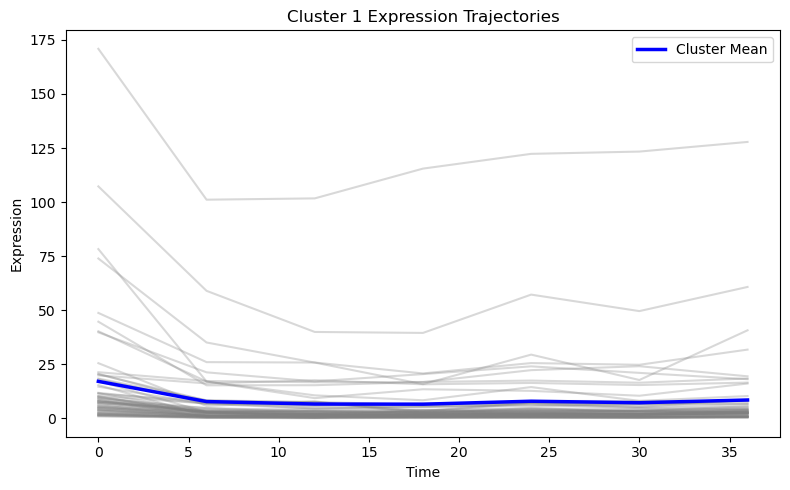

In [44]:
def plot_clust_DE_rpkm(clust_num, clust_ids, time, data):
    data_clust = data.loc[clust_ids, :]
    data_clust = data_clust[[col for col in data_clust.columns if 'Mean' in col and '-' in col or 'Mean' in col and 'A' in col]]
    plt.figure(figsize=(8, 5))
    # Plot individual gene trajectories
    for _, row in data_clust.iterrows():
        plt.plot(time, row.values, color='gray', alpha=0.3)
    # Plot cluster mean
    mean_trajectory = data_clust.mean()
    plt.plot(time, mean_trajectory, color='blue', linewidth=2.5, label='Cluster Mean')
    plt.title(f'Cluster {clust_num} Expression Trajectories')
    plt.xlabel('Time')
    plt.ylabel('Expression')
    plt.legend()
    plt.tight_layout()
    plt.show()

clust_ids = DEGs_pr['AGI'][DEGs_pr['cluster_id'] == clust_num]
plot_clust_DE_rpkm(clust_num, clust_ids, time, rpkm_pr)

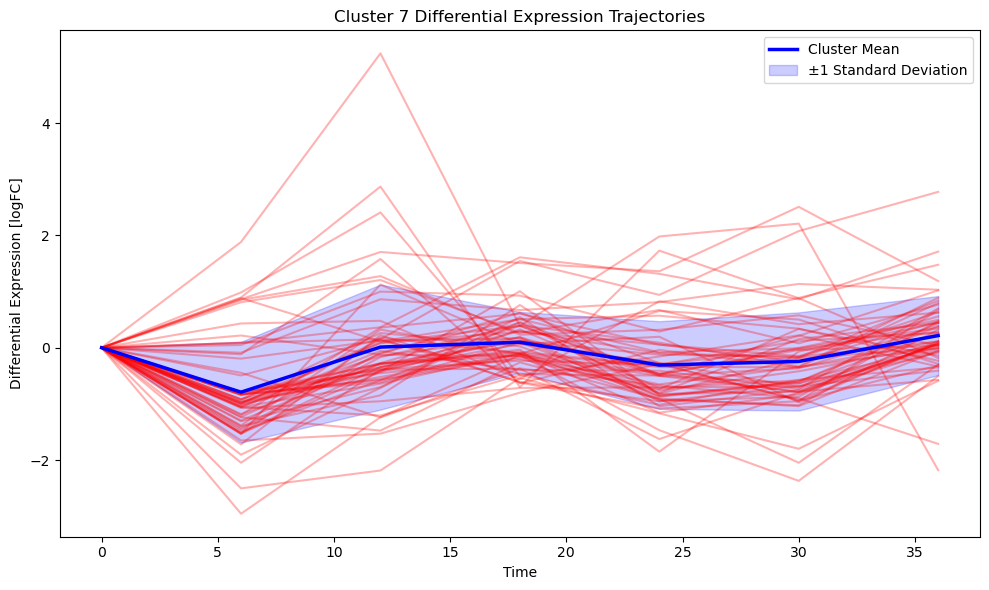

In [7]:
clust_ids = DEGs_pr['AGI'][DEGs_pr['cluster_id'] == clust_num]

def plot_clust_DE_logfc(clust_num, clust_ids, time, data):
    # Select data for the specific cluster
    data_clust = data.loc[clust_ids, :]

    # Add a column for time zero
    zero_col = pd.Series(0, index=data_clust.index)
    data_clust.insert(0, 'time_0', zero_col)

    plt.figure(figsize=(10, 6))

    # Calculate the mean and standard deviation across genes
    mean_trajectory = data_clust.mean(axis=0)
    std_trajectory = data_clust.std(axis=0)

    # Plot individual gene trajectories with transparency
    for _, row in data_clust.iterrows():
        plt.plot(time, row.values, color='red', alpha=0.3)

    # Plot the cluster mean trajectory
    plt.plot(time, mean_trajectory, color='blue', linewidth=2.5, label='Cluster Mean')

    # Add shaded area around the mean (±1 std deviation)
    plt.fill_between(time, mean_trajectory - std_trajectory, mean_trajectory + std_trajectory,
                     color='blue', alpha=0.2, label='±1 Standard Deviation')

    # Customize plot
    plt.title(f'Cluster {clust_num} Differential Expression Trajectories')
    plt.xlabel('Time')
    plt.ylabel('Differential Expression [logFC]')
    plt.legend()
    plt.tight_layout()

    # Display the plot
    plt.show()

plot_clust_DE_logfc(7, clust_ids, time, logfc_df)